<a href="https://colab.research.google.com/github/przemektutur/AirRNBinR/blob/main/Projekt_Przemyslaw_Tutur_R_Lang_Zaliczenie.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ZALICZENIE JEZYK R - PRZEMYSŁAW TUTUR - PROJEKT ZALICZNIOWY - MIASTO TORONTO

#### Zadania do wykoniania:
1. Poprawne załadowanie danych ze źródła internetowego do ramki danych, z uwzględnieniem
nagłówków, kodowania zbioru, separatorów itd.;
2. Poznanie rozmiaru zbioru danych (liczby obserwacji i liczby zmiennych, które je opisują)
i oszacowanie czasochłonności procesu analizy;
3. Wyświetlenie próbki surowych danych w celu wyrobienia sobie wyobrażenia o nich – poznania
struktury danych i wstępnej oceny przydatności poszczególnych zmiennych;
4. Weryfikacja typów poszczególnych zmiennych (całkowite, zmiennoprzecinkowe, kategoryczne
porządkowe, kategoryczne nominalne, zmienne typu logicznego, daty) i ich ewentualna korekta
(zamiana typu string na float, interpretacja zmiennych numerycznych jako kategorii itp.);
5. Zbudowanie podsumowania zmiennych numerycznych opisujących zbiór, w postaci jednej tabelki,
zawierającej podstawowe informacje, takie jak:
a. wartości minimalne,
b. wartości maksymalne,
c. średnia,
d. mediana,
e. drugi (dolny) kwartyl,
f. trzeci (górny) kwartyl,
g. odchylenie standardowe,
h. liczba danych brakujących lub nienumerycznych.
W tym kroku należy również dokonać analogicznej analizy zmiennych kategorycznych, dającej dla
każdej z nich informacje m.in. takie jak:
a. liczby poszczególnych kategorii i ich liczności,
b. wartości najczęściej występującej i częstości jej występowania,
c. liczba wartości unikalnych,
d. liczba braków danych.
6. Sprawdzenie, czy w zbiorze występują braki danych. Należy sporządzić odrębne podsumowanie,
skupiając się na poszukiwaniu brakujących wartości w zbiorze – Pozwoli to Państwu odpowiedzieć
na pytanie, jakie zmienne zawierają braki i jaka jest ich liczba, z czego mogą one wynikać itd.
Etap ten (wraz z poprzednim) pozwoli Państwu odnaleźć błędy w danych – brakujące wartości,
błędne interpretacje rodzaju zmiennych itp. Da również wskazówki, które atrybuty wybrać do
analizy (pod kątem ich istotności dla przewidywań modelu), czy i jak uzupełnić brakujące dane
(ewentualnie usunąć wiersze/kolumny, zawierające zbyt wiele braków danych), dokonać ich
transformacji itd.
7. Wizualizacja rozkładu (wybranych) zmiennych (zarówno numerycznych, jak i kategorycznych)
poprzez histogramy i próba ich scharakteryzowania (np. poprzez ich skośność i kurtozę) – będzie to
pomocne np. w procesie imputacji (uzupełniania) zmiennych numerycznych;
8. Przeprowadzenie czyszczenia danych, obejmujące m.in.:
a. uzupełnienie brakujących danych (np. wartością stałą, średnią/medianą/modą dla całego
zbioru lub dla podzbiorów według kategorii, poprzez interpolację itp.), usunięcie
wierszy/kolumn, zawierających zbyt wiele braków danych,
b. przycięcie odstających wartości (ang. outliers) – pomocne będą m.in. takie techniki, jak
wykres punktowy (gdzie nanosimy na obu osiach ten sam atrybut) lub wykres pudełkowy
i ewentualna normalizacja danych numerycznych (metodą min-max lub Z-score) – niektóre
algorytmy modelowania danych są wrażliwe na punkty odstające (np. metody regresji
liniowej, korelacja Pearsona) czy różnice w zakresie zmienności poszczególnych atrybutów
(niektóre algorytmy klasyfikacji bądź grupowania);
9. Zbadanie zależności pomiędzy zmiennymi – krok ten pozwoli odkryć związki pomiędzy
poszczególnymi zmiennymi; informacje te mogą także zostać użyte, np. na etapie transformacji
zmiennych lub do podjęcia decyzji, które zmienne wybrać do budowy modelu:
a. obliczenie macierzy korelacji (można użyć współczynnika korelacji rang Spearmana lub
współczynnika Pearsona) pomiędzy zmiennymi numerycznymi i zwizualizowanie ich za
pomocą wykresów punktowych (ang. scatter plots) lub tzw. wykresów par zmiennych
(ang. pairplots),
b. ewentualne zbadanie zależności pomiędzy zmiennymi kategorycznymi (współczynnik
V Cramméra) i zależności pomiędzy zmiennymi kategorycznymi i numerycznymi
(współczynnik R modelu liniowego z jedną zmienną kategoryczną, która objaśnia zmienną
numeryczną) oraz (podobnie jak powyżej) zwizualizowanie tych zależności w formie
wykresów

#### INSTALACJA SRODOWISKA URUCHOMIENIOWEGO

In [ ]:
# !apt-get install r-base

In [ ]:
# !R -e 'install.packages("IRkernel")'
# !R -e 'IRkernel::installspec(user = FALSE)'

In [ ]:
install.packages("caret")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [ ]:
install.packages("corrplot")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [ ]:
install.packages("combinat")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [ ]:
install.packages("DescTools")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



## ANALIZA

DODANIE POTRZEBNYCH BIBLIOTEK R'OWYCH

In [ ]:
# Załadowanie potrzebnych bibliotek
library(readr)      # Wczytywanie danych
library(dplyr)      # Przetwarzanie danych
library(ggplot2)    # Wizualizacja danych
library(lubridate)  # Praca z datami
library(jsonlite)   # Praca z plikami JSON
library(caret)      # Preprocessing i modelowanie
library(scales)     # Skalowanie danych
library(corrplot)   # Wykresy korelacji
library(e1071)      # Miary skośności i kurtozy
library(stats)      # Statystyki
library(tidyr)      # Manipulacja danymi
library(combinat)   # Kombinacje
library(DescTools)  # Asocjacje i inne narzędzia statystyczne

# Ustawienia dla ggplot2
theme_set(theme_minimal())


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘lubridate’


The following objects are masked from ‘package:base’:

    date, intersect, setdiff, union


Loading required package: lattice


Attaching package: ‘scales’


The following object is masked from ‘package:readr’:

    col_factor


corrplot 0.92 loaded


Attaching package: ‘combinat’


The following object is masked from ‘package:utils’:

    combn



Attaching package: ‘DescTools’


The following objects are masked from ‘package:caret’:

    MAE, RMSE




DEFINICJA FUNKCJI UPLOADUJĄCEJ DANE

ZAŁADOWANIE DANYCH PRZY POMOCY FUNKCJI ŁADUJĄCEJ

In [ ]:
load_housing_data <- function(
  url = 'http://data.insideairbnb.com/canada/on/toronto/2023-12-12/data/listings.csv.gz'
) {
  tarball_path <- 'datasets/listings.csv.gz'

  if (!file.exists(tarball_path)) {
    if (!dir.exists('datasets')) {
      dir.create('datasets', recursive = TRUE)
    }
    download.file(url, tarball_path)
  }

  df <- read.csv(gzfile(tarball_path))
  return(df)
}

# Przykład użycia funkcji
df <- load_housing_data()
print(head(df))

            id                                      listing_url    scrape_id
1 1.002737e+18 https://www.airbnb.com/rooms/1002736951366032648 2.023121e+13
2 7.161336e+17  https://www.airbnb.com/rooms/716133555965651038 2.023121e+13
3 2.727879e+07            https://www.airbnb.com/rooms/27278791 2.023121e+13
4 5.352633e+07            https://www.airbnb.com/rooms/53526328 2.023121e+13
5 1.012551e+18 https://www.airbnb.com/rooms/1012550920875154828 2.023121e+13
6 6.840411e+17  https://www.airbnb.com/rooms/684041130828663144 2.023121e+13
  last_scraped      source
1   2023-12-12 city scrape
2   2023-12-12 city scrape
3   2023-12-12 city scrape
4   2023-12-12 city scrape
5   2023-12-12 city scrape
6   2023-12-12 city scrape
                                                           name description
1       Bungalow in Toronto · ★New · 1 bedroom · 1 bed · 1 bath          NA
2 Townhouse in North York · 1 bedroom · 2 beds · 1 private bath          NA
3 Home in Toronto · ★4.91 · 1 bedroom · 2 be

WYŚWIETLENIE PRÓBKI SUROWYCH DANYCH W CELU WYROBIENIA SOBIE WYOBRAŻENIA O NICH - POZNANIA STRUKTURY DANYCH I WSTĘPNEJ OCENY PRZYDATNOŚCI POSZCZEGÓLNYCH ZMIENNYCH

In [ ]:
data_frame <- load_housing_data()

In [ ]:
# Wyświetlenie pierwszych kilku wierszy ramki danych
head(data_frame)

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,⋯,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>,<lgl>,<chr>,<chr>,<int>,⋯,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>
1,1.002737e+18,https://www.airbnb.com/rooms/1002736951366032648,2.023121e+13,2023-12-12,city scrape,Bungalow in Toronto · ★New · 1 bedroom · 1 bed · 1 bath,NA,,https://a0.muscache.com/pictures/8c0a277f-2ce5-447f-bc12-7ddc81eb2da4.jpg,273730029,⋯,NA,NA,NA,,f,3,0,3,0,NA
2,7.161336e+17,https://www.airbnb.com/rooms/716133555965651038,2.023121e+13,2023-12-12,city scrape,Townhouse in North York · 1 bedroom · 2 beds · 1 private bath,NA,,https://a0.muscache.com/pictures/miso/Hosting-716133555965651038/original/a3982ee1-fd08-4479-b659-46d880d65895.jpeg,474878080,⋯,5.00,5.00,5.00,STR-2208-FWRHHD,t,4,0,4,0,0.08
3,2.727879e+07,https://www.airbnb.com/rooms/27278791,2.023121e+13,2023-12-12,city scrape,Home in Toronto · ★4.91 · 1 bedroom · 2 beds · 1 private bath,NA,"This house is on a very quiet street of the Central Etobicoke. There is a park behind the house, with a pathway 3 houses away.",https://a0.muscache.com/pictures/miso/Hosting-27278791/original/f2fe0ab7-9d56-44d1-83ca-e88b49007cfa.jpeg,141166875,⋯,4.97,4.90,4.87,STR-2009-GQYXPG,f,3,0,3,0,8.02
4,5.352633e+07,https://www.airbnb.com/rooms/53526328,2.023121e+13,2023-12-12,city scrape,Home in Toronto · ★4.67 · 1 bedroom · 1 private bath,NA,"Leaside community, one of the best communities in Toronto, guests can enjoy free lawn bowling, tennis, and jogging in the neighborhood.",https://a0.muscache.com/pictures/5739d988-a2d5-4383-b275-de1980a655c4.jpg,8569918,⋯,4.89,4.78,4.44,,t,36,10,26,0,0.40
5,1.012551e+18,https://www.airbnb.com/rooms/1012550920875154828,2.023121e+13,2023-12-12,city scrape,Home in Toronto · ★New · 2 bedrooms · 2 beds · 1 private bath,NA,,https://a0.muscache.com/pictures/miso/Hosting-982834000316554967/original/07c58025-b93a-4927-8bd5-c9dea006f0ee.jpeg,537627593,⋯,NA,NA,NA,STR-2307-FQQVHQ,f,4,0,4,0,NA
6,6.840411e+17,https://www.airbnb.com/rooms/684041130828663144,2.023121e+13,2023-12-12,city scrape,Home in Toronto · 2 bedrooms · 2 beds · 1 shared bath,NA,"Beautiful Toronto uptown (North York) living with mall, grocery stores, university colleges, subway, buses, restaurants, park, community centre, places of worship and schools.",https://a0.muscache.com/pictures/miso/Hosting-684041130828663144/original/01491f01-3648-498f-a435-f475cf32cd1d.jpeg,80583803,⋯,NA,NA,NA,,f,3,0,3,0,NA


In [ ]:
# Wyświetlenie całej ramki danych
data_frame

id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,⋯,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>,<lgl>,<chr>,<chr>,<int>,⋯,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>
1.002737e+18,https://www.airbnb.com/rooms/1002736951366032648,2.023121e+13,2023-12-12,city scrape,Bungalow in Toronto · ★New · 1 bedroom · 1 bed · 1 bath,NA,,https://a0.muscache.com/pictures/8c0a277f-2ce5-447f-bc12-7ddc81eb2da4.jpg,273730029,⋯,NA,NA,NA,,f,3,0,3,0,NA
7.161336e+17,https://www.airbnb.com/rooms/716133555965651038,2.023121e+13,2023-12-12,city scrape,Townhouse in North York · 1 bedroom · 2 beds · 1 private bath,NA,,https://a0.muscache.com/pictures/miso/Hosting-716133555965651038/original/a3982ee1-fd08-4479-b659-46d880d65895.jpeg,474878080,⋯,5.00,5.00,5.00,STR-2208-FWRHHD,t,4,0,4,0,0.08
2.727879e+07,https://www.airbnb.com/rooms/27278791,2.023121e+13,2023-12-12,city scrape,Home in Toronto · ★4.91 · 1 bedroom · 2 beds · 1 private bath,NA,"This house is on a very quiet street of the Central Etobicoke. There is a park behind the house, with a pathway 3 houses away.",https://a0.muscache.com/pictures/miso/Hosting-27278791/original/f2fe0ab7-9d56-44d1-83ca-e88b49007cfa.jpeg,141166875,⋯,4.97,4.90,4.87,STR-2009-GQYXPG,f,3,0,3,0,8.02
5.352633e+07,https://www.airbnb.com/rooms/53526328,2.023121e+13,2023-12-12,city scrape,Home in Toronto · ★4.67 · 1 bedroom · 1 private bath,NA,"Leaside community, one of the best communities in Toronto, guests can enjoy free lawn bowling, tennis, and jogging in the neighborhood.",https://a0.muscache.com/pictures/5739d988-a2d5-4383-b275-de1980a655c4.jpg,8569918,⋯,4.89,4.78,4.44,,t,36,10,26,0,0.40
1.012551e+18,https://www.airbnb.com/rooms/1012550920875154828,2.023121e+13,2023-12-12,city scrape,Home in Toronto · ★New · 2 bedrooms · 2 beds · 1 private bath,NA,,https://a0.muscache.com/pictures/miso/Hosting-982834000316554967/original/07c58025-b93a-4927-8bd5-c9dea006f0ee.jpeg,537627593,⋯,NA,NA,NA,STR-2307-FQQVHQ,f,4,0,4,0,NA
6.840411e+17,https://www.airbnb.com/rooms/684041130828663144,2.023121e+13,2023-12-12,city scrape,Home in Toronto · 2 bedrooms · 2 beds · 1 shared bath,NA,"Beautiful Toronto uptown (North York) living with mall, grocery stores, university colleges, subway, buses, restaurants, park, community centre, places of worship and schools.",https://a0.muscache.com/pictures/miso/Hosting-684041130828663144/original/01491f01-3648-498f-a435-f475cf32cd1d.jpeg,80583803,⋯,NA,NA,NA,,f,3,0,3,0,NA
1.822729e+07,https://www.airbnb.com/rooms/18227287,2.023121e+13,2023-12-13,previous scrape,Bungalow in Toronto · 1 bedroom · 1 bed · 1.5 baths,NA,,https://a0.muscache.com/pictures/5df1b2f9-9e45-4e80-b3c5-d73d24bec23c.jpg,52132032,⋯,NA,NA,NA,,f,2,0,2,0,NA
5.303255e+07,https://www.airbnb.com/rooms/53032551,2.023121e+13,2023-12-13,city scrape,Rental unit in Toronto · ★4.75 · 1 bedroom · 1 bed · 1 bath,NA,"Walking distance to Kensington Market, Little Italy and China Town.",https://a0.muscache.com/pictures/7c4abbe1-b750-445d-8d6d-70e17159ff6a.jpg,429311030,⋯,4.80,4.95,4.71,STR-2111-JCZKVM,t,1,1,0,0,2.27
1.040578e+07,https://www.airbnb.com/rooms/10405775,2.023121e+13,2023-12-13,previous scrape,Home in Toronto · 1 bedroom · 1 bed · 1 bath,NA,,https://a0.muscache.com/pictures/b4b27a99-99a5-4a62-97a8-f909e1b7ad28.jpg,53581248,⋯,NA,NA,NA,,f,1,0,1,0,NA


POZNANIE ROZMIARU ZBIORU DANYCH (LICZBY OBSERWACJI I LICZBY ZMIENNYCH, KTÓRE JE OPISUJĄ)

In [ ]:
# Wyświetlenie liczby elementów (komórek) w ramce danych
num_elements <- nrow(data_frame) * ncol(data_frame)
print(num_elements)

[1] 1499550


POZNANIE WYSTĘPUJĄCYCH TYPÓW DANYCH W ZBIORZE

In [ ]:
# Wyświetlenie unikalnych typów danych kolumn w ramce danych
unique_types <- unique(sapply(data_frame, class))
print(unique_types)

[1] "numeric"   "character" "logical"   "integer"  


POZNANIE CECH DANYCH

In [ ]:
# Wyświetlenie nazw kolumn w ramce danych
column_names <- colnames(data_frame)
print(column_names)

 [1] "id"                                          
 [2] "listing_url"                                 
 [3] "scrape_id"                                   
 [4] "last_scraped"                                
 [5] "source"                                      
 [6] "name"                                        
 [7] "description"                                 
 [8] "neighborhood_overview"                       
 [9] "picture_url"                                 
[10] "host_id"                                     
[11] "host_url"                                    
[12] "host_name"                                   
[13] "host_since"                                  
[14] "host_location"                               
[15] "host_about"                                  
[16] "host_response_time"                          
[17] "host_response_rate"                          
[18] "host_acceptance_rate"                        
[19] "host_is_superhost"                           
[20] "host_t

WERYFIKACJA TYPÓW POSZCZEGÓLNYCH ZMIENNYCH (CAŁKOWITE, ZMIENNOPRZECINKOWE, KATEGORYCZNE PORZĄDKOWE, KATEGORYCZNE NOMINALNE, ZMIENNE TYPU LOGICZNEGO, DATY) I ICH EWENTUALNA KOREKTA (ZAMIANA TYPU STRING NA FLOAT, INTERPRETACJA ZMIENNYCH NUMERYCZNYCH JAKO KATEGORII ITP.)

In [ ]:
# Informacje o ramce danych w R

# Wyświetlenie struktury ramki danych
str(data_frame)

# Podsumowanie danych w każdej kolumnie
summary(data_frame)

# Liczba brakujących wartości w każdej kolumnie
missing_values <- sapply(data_frame, function(x) sum(is.na(x)))
print(missing_values)

# Typy danych w każdej kolumnie
data_types <- sapply(data_frame, class)
print(data_types)

'data.frame':	19994 obs. of  75 variables:
 $ id                                          : num  1.00e+18 7.16e+17 2.73e+07 5.35e+07 1.01e+18 ...
 $ listing_url                                 : chr  "https://www.airbnb.com/rooms/1002736951366032648" "https://www.airbnb.com/rooms/716133555965651038" "https://www.airbnb.com/rooms/27278791" "https://www.airbnb.com/rooms/53526328" ...
 $ scrape_id                                   : num  2.02e+13 2.02e+13 2.02e+13 2.02e+13 2.02e+13 ...
 $ last_scraped                                : chr  "2023-12-12" "2023-12-12" "2023-12-12" "2023-12-12" ...
 $ source                                      : chr  "city scrape" "city scrape" "city scrape" "city scrape" ...
 $ name                                        : chr  "Bungalow in Toronto · ★New · 1 bedroom · 1 bed · 1 bath" "Townhouse in North York · 1 bedroom · 2 beds · 1 private bath" "Home in Toronto · ★4.91 · 1 bedroom · 2 beds · 1 private bath" "Home in Toronto · ★4.67 · 1 bedroom · 1 private

       id            listing_url          scrape_id         last_scraped      
 Min.   :1.419e+03   Length:19994       Min.   :2.023e+13   Length:19994      
 1st Qu.:2.755e+07   Class :character   1st Qu.:2.023e+13   Class :character  
 Median :5.372e+07   Mode  :character   Median :2.023e+13   Mode  :character  
 Mean   :4.198e+17                      Mean   :2.023e+13                     
 3rd Qu.:8.731e+17                      3rd Qu.:2.023e+13                     
 Max.   :1.044e+18                      Max.   :2.023e+13                     
                                                                              
    source              name           description    neighborhood_overview
 Length:19994       Length:19994       Mode:logical   Length:19994         
 Class :character   Class :character   NA's:19994     Class :character     
 Mode  :character   Mode  :character                  Mode  :character     
                                                                

                                          id 
                                           0 
                                 listing_url 
                                           0 
                                   scrape_id 
                                           0 
                                last_scraped 
                                           0 
                                      source 
                                           0 
                                        name 
                                           0 
                                 description 
                                       19994 
                       neighborhood_overview 
                                           0 
                                 picture_url 
                                           0 
                                     host_id 
                                           0 
                                    host_url 
                                  

WARTOŚCI MINIMALNE, WARTOŚCI MAKSYMALNE, ŚREDNIA, MEDIANA, DRUGI (DOLNY) KWARTYL, TRZECI (GÓRNY) KWARTYL, ODCHYLENIE STANDARDOWE

In [ ]:
# Podsumowanie statystyczne kolumn numerycznych w ramce danych
numeric_summary <- summary(data_frame)
print(numeric_summary)

       id            listing_url          scrape_id         last_scraped      
 Min.   :1.419e+03   Length:19994       Min.   :2.023e+13   Length:19994      
 1st Qu.:2.755e+07   Class :character   1st Qu.:2.023e+13   Class :character  
 Median :5.372e+07   Mode  :character   Median :2.023e+13   Mode  :character  
 Mean   :4.198e+17                      Mean   :2.023e+13                     
 3rd Qu.:8.731e+17                      3rd Qu.:2.023e+13                     
 Max.   :1.044e+18                      Max.   :2.023e+13                     
                                                                              
    source              name           description    neighborhood_overview
 Length:19994       Length:19994       Mode:logical   Length:19994         
 Class :character   Class :character   NA's:19994     Class :character     
 Mode  :character   Mode  :character                  Mode  :character     
                                                                

In [ ]:
# Podsumowanie statystyczne tylko dla kolumn numerycznych
numeric_cols <- sapply(data_frame, is.numeric)
numeric_summary <- summary(data_frame[, numeric_cols])
print(numeric_summary)

       id              scrape_id            host_id         
 Min.   :1.419e+03   Min.   :2.023e+13   Min.   :     1565  
 1st Qu.:2.755e+07   1st Qu.:2.023e+13   1st Qu.: 33694686  
 Median :5.372e+07   Median :2.023e+13   Median :130961982  
 Mean   :4.198e+17   Mean   :2.023e+13   Mean   :196706897  
 3rd Qu.:8.731e+17   3rd Qu.:2.023e+13   3rd Qu.:353139240  
 Max.   :1.044e+18   Max.   :2.023e+13   Max.   :550286214  
                                                            
 host_listings_count host_total_listings_count    latitude       longitude     
 Min.   :   1.000    Min.   :   1.00           Min.   :43.59   Min.   :-79.62  
 1st Qu.:   1.000    1st Qu.:   1.00           1st Qu.:43.65   1st Qu.:-79.43  
 Median :   2.000    Median :   3.00           Median :43.67   Median :-79.40  
 Mean   :   7.676    Mean   :  13.17           Mean   :43.68   Mean   :-79.40  
 3rd Qu.:   4.000    3rd Qu.:   6.00           3rd Qu.:43.71   3rd Qu.:-79.37  
 Max.   :2662.000    Max.   :886

SPRAWDZENIE WARTOŚCI UNIKALNYCH, KATEGORII ORAZ SPOSOBU ZAPISU DLA DANYCH W KAŻDEJ Z KOLUMN

In [ ]:
# Iteracja przez kolumny ramki danych i wyświetlanie nazw kolumn oraz unikalnych wartości
for (column in colnames(data_frame)) {
  cat("---", column, "---\n")
  print(unique(data_frame[[column]]))
}

In [ ]:
options(width = 100)  # Ustawienie szerokości wyświetlania w konsoli

SPRAWDZENIE WARTOSCI NAN

In [ ]:
# Liczba brakujących wartości w każdej kolumnie
missing_values <- sapply(data_frame, function(x) sum(is.na(x)))

# Sortowanie brakujących wartości rosnąco
sorted_missing_values <- sort(missing_values)
print(sorted_missing_values)

UTWORZENIE FILTRU DLA WARTOSCI NAN

In [ ]:
# Sprawdzenie, które kolumny mają brakujące wartości
missing_values <- sapply(data_frame, function(x) sum(is.na(x)) > 0)

# Wyświetlenie wyników
print(missing_values)

                                 listing_url                                 last_scraped 
                                       FALSE                                        FALSE 
                                      source                                         name 
                                       FALSE                                        FALSE 
                                 picture_url                                      host_id 
                                       FALSE                                        FALSE 
                                    host_url                                    host_name 
                                       FALSE                                        FALSE 
                                  host_since                                host_location 
                                       FALSE                                        FALSE 
                          host_response_time                           host_response_rate 

WYLISTOWANIE WIERSZY Z WARTOŚCIAMI NAN

In [ ]:
# Wybór wszystkich kolumn, które mają brakujące wartości
data_frame_with_na <- data_frame[, missing_values]

# Wyświetlenie wyników
print(data_frame_with_na)

                    host_response_rate host_acceptance_rate host_listings_count
1002736951366032640               1.00                 0.98                   5
716133555965651072                1.00                 0.95                   4
27278791                          1.00                 0.99                   3
53526328                          0.90                 0.88                  37
1012550920875154816               1.00                   NA                   4
684041130828663168                1.00                 0.75                   3
18227287                            NA                   NA                   2
53032551                            NA                 1.00                   1
10405775                            NA                   NA                   1
19198250                            NA                   NA                   1
13712972                            NA                   NA                   2
13660723                            NA  

WYSORTOWANIE SUMY WARTOSCI NAN

In [ ]:
# Wybór wszystkich kolumn, które mają brakujące wartości
data_frame_with_na <- data_frame[, missing_values]

# Liczba brakujących wartości w każdej z tych kolumn
na_counts <- sapply(data_frame_with_na, function(x) sum(is.na(x)))

# Sortowanie brakujących wartości rosnąco
sorted_na_counts <- sort(na_counts)

# Wyświetlenie wyników
print(sorted_na_counts)

        host_listings_count   host_total_listings_count                        beds 
                          2                           2                         179 
       review_scores_rating   review_scores_cleanliness      review_scores_accuracy 
                       5128                        5129                        5131 
review_scores_communication         review_scores_value       review_scores_checkin 
                       5131                        5131                        5132 
     review_scores_location           reviews_per_month        host_acceptance_rate 
                       5132                        5138                        5395 
         host_response_rate 
                       6517 


PROCENTOWY UDZIAŁ BRAKÓW W KOLUMNACH DANYCH

In [ ]:
# Wybór wszystkich kolumn, które mają brakujące wartości
data_frame_with_na <- data_frame[, missing_values]

# Liczba brakujących wartości w każdej z tych kolumn
na_counts <- sapply(data_frame_with_na, function(x) sum(is.na(x)))

# Obliczenie procentu brakujących wartości dla każdej kolumny
percent_na <- (na_counts / nrow(data_frame)) * 100

# Sortowanie procentu brakujących wartości rosnąco
sorted_percent_na <- sort(percent_na)

# Wyświetlenie wyników
print(sorted_percent_na)

        host_listings_count   host_total_listings_count                        beds 
                  0.0100030                   0.0100030                   0.8952686 
       review_scores_rating   review_scores_cleanliness      review_scores_accuracy 
                 25.6476943                  25.6526958                  25.6626988 
review_scores_communication         review_scores_value       review_scores_checkin 
                 25.6626988                  25.6626988                  25.6677003 
     review_scores_location           reviews_per_month        host_acceptance_rate 
                 25.6677003                  25.6977093                  26.9830949 
         host_response_rate 
                 32.5947784 


OSZACOWANIE CZASOCHŁONNOŚCI

RELATYWNIE DUŻO DANYCH ORAZ BRAKUJĄCYCH WARTOŚCI (NAN) WYMAGAĆ BEDZIE WIĘCEJ CZASOCHŁONNOŚCI - SZACOWANY CZAS OBRÓBKI DANYCH - 8 DO 12 GODZIN (OKOŁO 1,5 DZNIA ROBOCZEGO).

WARTOŚCI BRAKUJĄCE W DUŻYM PROCENCIE ZOSTANĄ USUNIĘTE JEŚLI NIE MOŻNA ICH WYWNIOSKOWAĆ Z INNYCH ZMIENNYCH.

## PRZYGOTOWANIE DANYCH

WSTĘPNE USUNIĘCIE KOLUMN Z BRAKUJĄCYMI DANYMI, KTÓRYCH NIE MOŻNA UZYSKAĆ LUB ZASTĄPIĆ

In [ ]:
# Usuwanie kolumn 'neighbourhood_group_cleansed' i 'calendar_updated'
data_frame <- data_frame[, !colnames(data_frame) %in% c('neighbourhood_group_cleansed', 'calendar_updated')]

# Wyświetlenie wyników, aby upewnić się, że kolumny zostały usunięte
print(colnames(data_frame))

 [1] "listing_url"                                  "last_scraped"                                
 [3] "source"                                       "name"                                        
 [5] "picture_url"                                  "host_id"                                     
 [7] "host_url"                                     "host_name"                                   
 [9] "host_since"                                   "host_location"                               
[11] "host_response_time"                           "host_response_rate"                          
[13] "host_acceptance_rate"                         "host_is_superhost"                           
[15] "host_thumbnail_url"                           "host_picture_url"                            
[17] "host_listings_count"                          "host_total_listings_count"                   
[19] "host_verifications"                           "host_has_profile_pic"                        
[21] "host

ZAMIANA TEKSTU CENY WYNAJMU NA WARTOŚCI ZMIENNOPRZECINKOWE

In [ ]:
# Usuwanie symboli dolara i przecinków oraz konwersja na typ numeric
data_frame$price <- gsub("\\$", "", data_frame$price)  # Usuwanie symboli dolara
data_frame$price <- gsub(",", "", data_frame$price)    # Usuwanie przecinków
data_frame$price <- as.numeric(data_frame$price)       # Konwersja na typ numeric

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame$price))

[1]  72 110 104 120 120  85


ILOŚĆ BRAKUJĄCYCH DANYCH W KOLUMNIE 'price'

In [ ]:
# Liczba brakujących wartości w kolumnie 'price'
na_count_price <- sum(is.na(data_frame$price))

# Wyświetlenie wyniku
print(na_count_price)

[1] 0


MEDIANA DLA WARTOSCI NOT NAN W KOLUMNIE 'price'

In [ ]:
# Mediana kolumny 'price', ignorując brakujące wartości
median_price <- median(data_frame$price, na.rm = TRUE)

# Wyświetlenie wyniku
print(median_price)

[1] 120


UZUPEŁNIENIE BRAKÓW

In [ ]:
# Zastąpienie brakujących wartości w kolumnie 'price' wartością 120.0
data_frame$price[is.na(data_frame$price)] <- 120.0

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame$price))

[1]  72 110 104 120 120  85


SPRAWDZENIE DANYCH

In [ ]:
# Sprawdzenie, czy wszystkie wartości w kolumnie 'price' są prawdziwe (różne od zera i niepuste)
all_prices_nonzero <- all(data_frame$price)

# Wyświetlenie wyniku
print(all_prices_nonzero)

Warning message in all(data_frame$price):
“coercing argument of type 'double' to logical”


[1] TRUE


WIZUALIZACJA CEN WYNAJMU DLA TORONTO W ZALEZNOSCI OD POLOZENIA

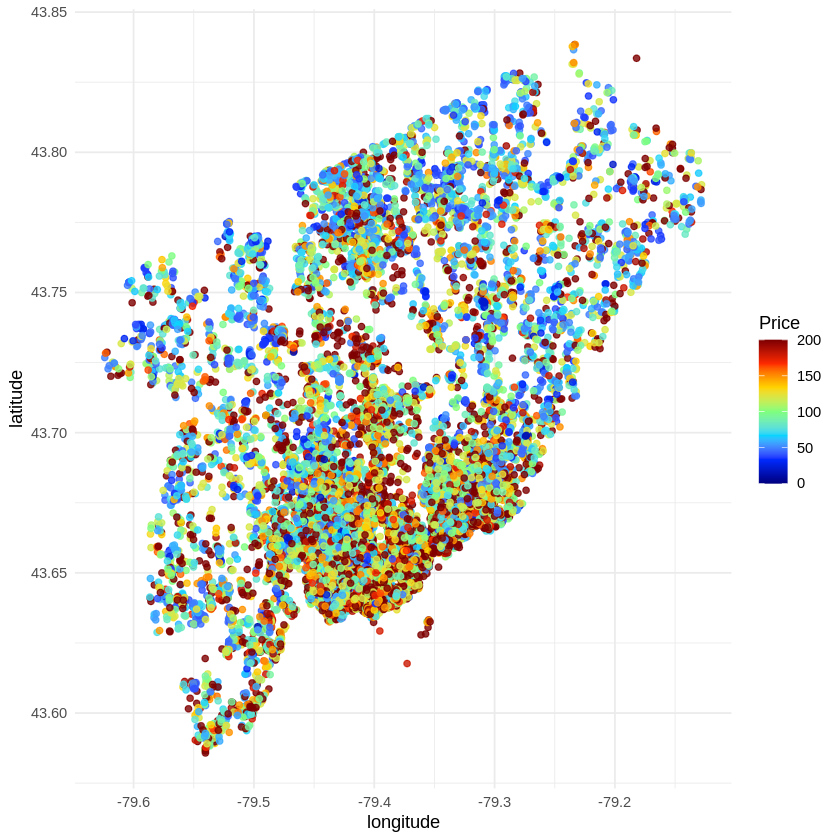

In [ ]:
# Załadowanie potrzebnych bibliotek
library(ggplot2)

# Funkcja generująca kolory mapy kolorów 'jet'
jet.colors <- function(n) {
  colorRampPalette(c("#00007F", "blue", "#007FFF", "cyan", "#7FFF7F", "yellow", "#FF7F00", "red", "#7F0000"))(n)
}

# Załadowanie potrzebnych bibliotek
library(ggplot2)

# Tworzenie wykresu rozrzutu z kolorowaniem punktów na podstawie ceny
ggplot(data_frame, aes(x = longitude, y = latitude, color = price)) +
  geom_point(alpha = 0.8) +
  scale_color_gradientn(colors = jet.colors(7), limits = c(0, 200), oob = scales::squish) +
  theme_minimal() +
  labs(color = 'Price') +
  theme(legend.position = "right")



SPRAWDZENIE PROCENTOWEJ ZAWARTOSCI REKORDOW BEZ WARTOŚCI

In [ ]:
# Ustawienie kolumny 'id' jako wiersze indeksu
rownames(data_frame) <- data_frame$id

# Usunięcie kolumny 'id' jeśli jest już ustawiona jako wiersze indeksu
data_frame$id <- NULL

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame))

                                       listing_url last_scraped      source
1 https://www.airbnb.com/rooms/1002736951366032648   2023-12-12 city scrape
2  https://www.airbnb.com/rooms/716133555965651038   2023-12-12 city scrape
3            https://www.airbnb.com/rooms/27278791   2023-12-12 city scrape
4            https://www.airbnb.com/rooms/53526328   2023-12-12 city scrape
5 https://www.airbnb.com/rooms/1012550920875154828   2023-12-12 city scrape
6  https://www.airbnb.com/rooms/684041130828663144   2023-12-12 city scrape
                                                           name
1       Bungalow in Toronto · ★New · 1 bedroom · 1 bed · 1 bath
2 Townhouse in North York · 1 bedroom · 2 beds · 1 private bath
3 Home in Toronto · ★4.91 · 1 bedroom · 2 beds · 1 private bath
4          Home in Toronto · ★4.67 · 1 bedroom · 1 private bath
5 Home in Toronto · ★New · 2 bedrooms · 2 beds · 1 private bath
6         Home in Toronto · 2 bedrooms · 2 beds · 1 shared bath
                    

In [ ]:
# Sprawdzenie, które kolumny mają brakujące wartości
missing_values <- sapply(data_frame, function(x) sum(is.na(x)) > 0)

# Wybór wszystkich kolumn, które mają brakujące wartości
data_frame_with_na <- data_frame[, missing_values]

# Liczba brakujących wartości w każdej z tych kolumn
na_counts <- sapply(data_frame_with_na, function(x) sum(is.na(x)))

# Obliczenie procentu brakujących wartości dla każdej kolumny
percent_na <- (na_counts / nrow(data_frame)) * 100

# Sortowanie procentu brakujących wartości malejąco
sorted_percent_na <- sort(percent_na, decreasing = TRUE)

# Wyświetlenie wyników
print(sorted_percent_na)

         host_response_rate        host_acceptance_rate           reviews_per_month 
                 32.5947784                  26.9830949                  25.6977093 
      review_scores_checkin      review_scores_location      review_scores_accuracy 
                 25.6677003                  25.6677003                  25.6626988 
review_scores_communication         review_scores_value   review_scores_cleanliness 
                 25.6626988                  25.6626988                  25.6526958 
       review_scores_rating                        beds         host_listings_count 
                 25.6476943                   0.8952686                   0.0100030 
  host_total_listings_count 
                  0.0100030 


USUNIĘCIE DODATKOWYCH KOLUMN DANYCH Z BRAKUJĄCYMI DANYMI

In [ ]:
library(dplyr)

# Lista kolumn do usunięcia
columns_to_remove <- c('host_about', 'neighbourhood', 'neighborhood_overview', 'host_neighbourhood')

# Usuwanie kolumn, które istnieją w data_frame
existing_columns_to_remove <- columns_to_remove[columns_to_remove %in% colnames(data_frame)]
data_frame <- data_frame %>% select(-one_of(existing_columns_to_remove))

# Wyświetlenie nazw kolumn, aby upewnić się, że operacja się powiodła
print(colnames(data_frame))

 [1] "listing_url"                                  "last_scraped"                                
 [3] "source"                                       "name"                                        
 [5] "picture_url"                                  "host_id"                                     
 [7] "host_url"                                     "host_name"                                   
 [9] "host_since"                                   "host_location"                               
[11] "host_response_time"                           "host_response_rate"                          
[13] "host_acceptance_rate"                         "host_is_superhost"                           
[15] "host_thumbnail_url"                           "host_picture_url"                            
[17] "host_listings_count"                          "host_total_listings_count"                   
[19] "host_verifications"                           "host_has_profile_pic"                        
[21] "host

USUNIĘCIE scrape_id JAK KOLUMNY NIE WNOSZĄCEJ UŻYTECZNEJ INFORMACJI DO ANALIZY

In [ ]:
# Wyświetlenie unikalnych wartości w kolumnie 'scrape_id'
unique_scrape_id <- unique(data_frame$scrape_id)

# Wyświetlenie wyników
print(unique_scrape_id)

NULL


In [ ]:
library(dplyr)

# Sprawdzenie, czy kolumna 'scrape_id' istnieje, zanim ją usuniemy
if ("scrape_id" %in% colnames(data_frame)) {
  data_frame <- data_frame %>%
    select(-scrape_id)
}

# Wyświetlenie nazw kolumn, aby upewnić się, że operacja się powiodła
print(colnames(data_frame))

 [1] "listing_url"                                  "last_scraped"                                
 [3] "source"                                       "name"                                        
 [5] "picture_url"                                  "host_id"                                     
 [7] "host_url"                                     "host_name"                                   
 [9] "host_since"                                   "host_location"                               
[11] "host_response_time"                           "host_response_rate"                          
[13] "host_acceptance_rate"                         "host_is_superhost"                           
[15] "host_thumbnail_url"                           "host_picture_url"                            
[17] "host_listings_count"                          "host_total_listings_count"                   
[19] "host_verifications"                           "host_has_profile_pic"                        
[21] "host

OBRÓBKA DANYCH TYPU DATETIME

In [ ]:
# Konwersja kolumn na typ daty i wyświetlenie unikalnych wartości
date_columns <- c('last_scraped', 'last_review', 'first_review')

for (column in date_columns) {
  data_frame[[column]] <- as.Date(data_frame[[column]])
  unique_dates <- unique(data_frame[[column]])
  cat("---", column, "---\n")
  print(unique_dates)
}

--- last_scraped ---
[1] "2023-12-12" "2023-12-13"
--- last_review ---
   [1] "2023-12-12" "2022-11-24" "2023-12-11" "2023-11-01" "2023-01-01" "2018-01-21" "2016-07-31"
   [8] "2016-08-21" "2022-12-16" "2023-12-09" "2016-08-02" "2019-10-14" "2023-11-03" "2018-01-01"
  [15] "2023-10-29" "2023-09-15" "2023-10-11" "2023-11-06" "2023-09-30" "2019-09-02" "2020-01-27"
  [22] "2023-07-04" "2021-10-25" "2023-10-15" "2023-09-03" "2023-09-16" "2023-08-26" "2023-10-18"
  [29] "2023-11-30" "2023-11-21" "2023-09-24" "2023-11-19" "2023-11-29" "2022-10-31" "2023-04-01"
  [36] "2017-09-18" "2017-08-20" "2023-10-26" "2023-08-03" "2022-08-19" "2023-10-20" "2022-12-31"
  [43] "2019-08-28" "2023-11-11" "2020-03-17" "2023-12-10" "2023-12-05" "2023-12-03" "2023-08-05"
  [50] "2023-11-22" "2022-10-24" "2019-05-26" "2023-08-07" "2023-07-23" "2023-09-17" "2017-10-31"
  [57] "2023-11-12" "2023-10-16" "2023-05-26" "2023-06-29" "2023-12-01" "2020-06-03" "2023-06-08"
  [64] "2023-11-05" "2023-06-25" "2023-09-11" "

UZUPEŁNIENIE WARTOŚCI 'NAT'

In [ ]:
# Ustawienie domyślnych dat
default_date_last_review <- as.Date('2023-12-12')
default_date_first_review <- as.Date('2018-10-19')

# Wypełnianie brakujących wartości w kolumnie 'last_review' domyślną datą
data_frame$last_review[is.na(data_frame$last_review)] <- default_date_last_review

# Wypełnianie brakujących wartości w kolumnie 'first_review' domyślną datą
data_frame$first_review[is.na(data_frame$first_review)] <- default_date_first_review

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame[c('last_review', 'first_review')]))

  last_review first_review
1  2023-12-12   2018-10-19
2  2022-11-24   2022-11-24
3  2023-12-11   2018-10-19
4  2023-11-01   2022-02-12
5  2023-12-12   2018-10-19
6  2023-12-12   2018-10-19


SPRAWDZENIE UZUPEŁNIENIA

In [ ]:
# Konwersja kolumn na typ daty i wyświetlenie unikalnych wartości
date_columns <- c('last_scraped', 'last_review', 'first_review')

for (column in date_columns) {
  data_frame[[column]] <- as.Date(data_frame[[column]])
  unique_dates <- unique(data_frame[[column]])
  cat("---", column, "---\n")
  print(unique_dates)
}

--- last_scraped ---
[1] "2023-12-12" "2023-12-13"
--- last_review ---
   [1] "2023-12-12" "2022-11-24" "2023-12-11" "2023-11-01" "2023-01-01" "2018-01-21" "2016-07-31"
   [8] "2016-08-21" "2022-12-16" "2023-12-09" "2016-08-02" "2019-10-14" "2023-11-03" "2018-01-01"
  [15] "2023-10-29" "2023-09-15" "2023-10-11" "2023-11-06" "2023-09-30" "2019-09-02" "2020-01-27"
  [22] "2023-07-04" "2021-10-25" "2023-10-15" "2023-09-03" "2023-09-16" "2023-08-26" "2023-10-18"
  [29] "2023-11-30" "2023-11-21" "2023-09-24" "2023-11-19" "2023-11-29" "2022-10-31" "2023-04-01"
  [36] "2017-09-18" "2017-08-20" "2023-10-26" "2023-08-03" "2022-08-19" "2023-10-20" "2022-12-31"
  [43] "2019-08-28" "2023-11-11" "2020-03-17" "2023-12-10" "2023-12-05" "2023-12-03" "2023-08-05"
  [50] "2023-11-22" "2022-10-24" "2019-05-26" "2023-08-07" "2023-07-23" "2023-09-17" "2017-10-31"
  [57] "2023-11-12" "2023-10-16" "2023-05-26" "2023-06-29" "2023-12-01" "2020-06-03" "2023-06-08"
  [64] "2023-11-05" "2023-06-25" "2023-09-11" "

OBRÓBKA DANYCH TYPU BOOLEEN

In [ ]:
# Wybieranie kolumn, które zawierają wartości 't' lub 'f'
data_true_false <- colnames(data_frame)[sapply(data_frame, function(col) any(col %in% c('t', 'f')))]

# Wyświetlenie wyników
print(data_true_false)

character(0)


MAPOWANIE DANYCH NA WARTOŚCI BOOLEAN

In [ ]:
# Iteracja przez kolumny z wartościami 't' i 'f' oraz ich konwersja
for (column in data_true_false) {
  data_frame[[column]] <- ifelse(data_frame[[column]] == 't', TRUE,
                                 ifelse(data_frame[[column]] == 'f', FALSE, FALSE))
}

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame[, data_true_false]))

data frame with 0 columns and 6 rows


SPRAWDZENIE ZMAPOWANYCH DANYCH

In [ ]:
# Iteracja przez kolumny z wartościami 't' i 'f' oraz drukowanie unikalnych wartości
for (column in data_true_false) {
  unique_values <- unique(data_frame[[column]])
  cat(column, ":", unique_values, "\n")
}

OBRÓBKA KOLUMN 'host_response_rate' i 'host_acceptance_rate'


ZAMIANA CENY NA WARTOŚĆ ZMIENNOPRZECINKOWA ZAMIANA host_* NA WARTOŚCI ZMIENNOPRZECINKOWE DOZWIERCIEDLAJĄCE PROCENTY

In [ ]:
# Usuwanie znaków procenta, konwersja na typ numeric i dzielenie przez 100
data_frame$host_response_rate <- as.numeric(gsub('%', '', data_frame$host_response_rate)) / 100.0
data_frame$host_acceptance_rate <- as.numeric(gsub('%', '', data_frame$host_acceptance_rate)) / 100.0

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame[c('host_response_rate', 'host_acceptance_rate')]))

  host_response_rate host_acceptance_rate
1              0.010               0.0098
2              0.010               0.0095
3              0.010               0.0099
4              0.009               0.0088
5              0.010                   NA
6              0.010               0.0075


In [ ]:
# Sprawdzenie, czy jakiekolwiek wartości w kolumnie 'host_response_rate' są prawdziwe (różne od zera i niepuste)
any_host_response_rate <- any(data_frame$host_response_rate)

# Wyświetlenie wyniku
print(any_host_response_rate)

Warning message in any(data_frame$host_response_rate):
“coercing argument of type 'double' to logical”


[1] TRUE


In [ ]:
# Sprawdzenie, czy jakiekolwiek wartości w kolumnie 'host_acceptance_rate' są prawdziwe (różne od zera i niepuste)
any_host_acceptance_rate <- any(data_frame$host_acceptance_rate)

# Wyświetlenie wyniku
print(any_host_acceptance_rate)

Warning message in any(data_frame$host_acceptance_rate):
“coercing argument of type 'double' to logical”


[1] TRUE


ROZSZYCIE WARTOŚCI LISTOWYCH W KOLUMNIE 'host_verifications' - JSON

In [ ]:
# Wyświetlenie unikalnych wartości w kolumnie 'host_verifications'
unique_host_verifications <- unique(data_frame$host_verifications)

# Wyświetlenie wyników
print(unique_host_verifications)

[1] "['email', 'phone']"               "['email', 'phone', 'work_email']"
[3] "['phone']"                        "['email']"                       
[5] "['email', 'work_email']"          "['phone', 'work_email']"         
[7] "[]"                               "None"                            
[9] "['work_email']"                  


SPLIT PRZY UŻYCIU REGEXP

In [ ]:
# Usuwanie określonych znaków i dzielenie ciągów na listy słów w kolumnie 'host_verifications'
data_frame$host_verifications_1 <- lapply(data_frame$host_verifications, function(x) {
  x <- as.character(x)  # Konwersja x do ciągu znaków
  if (x == "[]" || x == "None") {
    return(character(0))  # Zwraca pustą listę dla "[]" lub "None"
  }
  # Usunięcie nawiasów i podział ciągu na elementy listy
  x_clean <- gsub("\\[|\\]|'", "", x)
  strsplit(x_clean, ",\\s*")[[1]]
})

# Wyświetlenie wyników
print(head(data_frame$host_verifications_1))

# Wyświetlenie unikalnych wartości w kolumnie 'host_verifications'
unique_host_verifications_1 <- unique(data_frame$host_verifications_1)
print(unique_host_verifications_1)

[[1]]
[1] "email" "phone"

[[2]]
[1] "email" "phone"

[[3]]
[1] "email" "phone"

[[4]]
[1] "email" "phone"

[[5]]
[1] "email" "phone"

[[6]]
[1] "email" "phone"

[[1]]
[1] "email" "phone"

[[2]]
[1] "email"      "phone"      "work_email"

[[3]]
[1] "phone"

[[4]]
[1] "email"

[[5]]
[1] "email"      "work_email"

[[6]]
[1] "phone"      "work_email"

[[7]]
character(0)

[[8]]
[1] "work_email"



PROCENTOWY UDZIAŁ WARTOŚCI W KOLUMNIE

In [ ]:
# Obliczenie rozkładu częstości wartości w kolumnie 'host_verifications'
# Używamy funkcji table() do stworzenia tabeli częstości, a następnie prop.table() do znormalizowania wartości

# Ponieważ `data_frame$host_verifications` jest listą, musimy najpierw unlistować i skonwertować na faktor
host_verifications_flat <- unlist(data_frame$host_verifications_1)

# Utworzenie tabeli częstości i znormalizowanie wartości
verification_counts <- table(host_verifications_flat)
normalized_counts <- prop.table(verification_counts)

# Wyświetlenie wyników
print(normalized_counts)

host_verifications_flat
     email      phone work_email 
0.45120947 0.49689208 0.05189845 


In [ ]:
# Wyświetlenie struktury ramki danych
str(data_frame)

# Podsumowanie danych w każdej kolumnie
summary(data_frame)

# Liczba brakujących wartości w każdej kolumnie
missing_values <- sapply(data_frame, function(x) sum(is.na(x)))
print(missing_values)

# Typy danych w każdej kolumnie
data_types <- sapply(data_frame, class)
print(data_types)

'data.frame':	19994 obs. of  69 variables:
 $ listing_url                                 : chr  "https://www.airbnb.com/rooms/1002736951366032648" "https://www.airbnb.com/rooms/716133555965651038" "https://www.airbnb.com/rooms/27278791" "https://www.airbnb.com/rooms/53526328" ...
 $ last_scraped                                : Date, format: "2023-12-12" "2023-12-12" "2023-12-12" ...
 $ source                                      : chr  "city scrape" "city scrape" "city scrape" "city scrape" ...
 $ name                                        : chr  "Bungalow in Toronto · ★New · 1 bedroom · 1 bed · 1 bath" "Townhouse in North York · 1 bedroom · 2 beds · 1 private bath" "Home in Toronto · ★4.91 · 1 bedroom · 2 beds · 1 private bath" "Home in Toronto · ★4.67 · 1 bedroom · 1 private bath" ...
 $ picture_url                                 : chr  "https://a0.muscache.com/pictures/8c0a277f-2ce5-447f-bc12-7ddc81eb2da4.jpg" "https://a0.muscache.com/pictures/miso/Hosting-716133555965651038/ori

 listing_url         last_scraped           source              name           picture_url       
 Length:19994       Min.   :2023-12-12   Length:19994       Length:19994       Length:19994      
 Class :character   1st Qu.:2023-12-12   Class :character   Class :character   Class :character  
 Mode  :character   Median :2023-12-12   Mode  :character   Mode  :character   Mode  :character  
                    Mean   :2023-12-12                                                           
                    3rd Qu.:2023-12-13                                                           
                    Max.   :2023-12-13                                                           
                                                                                                 
                                                                                                 
                                                                                                 
                    

                                 listing_url                                 last_scraped 
                                           0                                            0 
                                      source                                         name 
                                           0                                            0 
                                 picture_url                                      host_id 
                                           0                                            0 
                                    host_url                                    host_name 
                                           0                                            0 
                                  host_since                                host_location 
                                           0                                            0 
                          host_response_time                           host_response_rate 

USUNIĘCIE KOLUMNY 'amenities' - BRAK JAKICHKOLWIEK DANYCH I MOŻLIWOŚCI ICH UZUPEŁNIENIA

In [ ]:
# Wyświetlenie unikalnych wartości w kolumnie 'amenities'
unique_amenities <- unique(data_frame$amenities)

# Wyświetlenie wyników
print(unique_amenities)

NULL


In [ ]:
library(dplyr)

# Sprawdzenie, czy kolumna 'amenities' istnieje, zanim ją usuniemy
if ("amenities" %in% colnames(data_frame)) {
  data_frame <- data_frame %>%
    select(-amenities)
}

# Wyświetlenie nazw kolumn, aby upewnić się, że operacja się powiodła
print(colnames(data_frame))

 [1] "listing_url"                                  "last_scraped"                                
 [3] "source"                                       "name"                                        
 [5] "picture_url"                                  "host_id"                                     
 [7] "host_url"                                     "host_name"                                   
 [9] "host_since"                                   "host_location"                               
[11] "host_response_time"                           "host_response_rate"                          
[13] "host_acceptance_rate"                         "host_is_superhost"                           
[15] "host_thumbnail_url"                           "host_picture_url"                            
[17] "host_listings_count"                          "host_total_listings_count"                   
[19] "host_verifications"                           "host_has_profile_pic"                        
[21] "host

OBRÓBKA KOLUMNY 'room_type' I 'host_response_time' - KATEGORYCZNE DANE

In [ ]:
# Wyświetlenie unikalnych wartości w kolumnie 'room_type'
unique_room_type <- unique(data_frame$room_type)

# Wyświetlenie wyników
print(unique_room_type)

[1] Private room    Entire home/apt Shared room     Hotel room     
Levels: Entire home/apt Hotel room Private room Shared room


In [ ]:
# Konwersja kolumny 'room_type' na typ faktor (kategoria)
data_frame$room_type <- as.factor(data_frame$room_type)

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame$room_type))

[1] Private room Private room Private room Private room Private room Private room
Levels: Entire home/apt Hotel room Private room Shared room


In [ ]:
# Wyświetlenie zawartości kolumny 'room_type'
room_type_content <- data_frame$room_type

# Wyświetlenie wyników
print(room_type_content)

    [1] Private room    Private room    Private room    Private room    Private room   
    [6] Private room    Private room    Entire home/apt Private room    Entire home/apt
   [11] Entire home/apt Private room    Entire home/apt Shared room     Entire home/apt
   [16] Private room    Entire home/apt Entire home/apt Entire home/apt Entire home/apt
   [21] Entire home/apt Private room    Private room    Entire home/apt Private room   
   [26] Private room    Private room    Entire home/apt Entire home/apt Entire home/apt
   [31] Entire home/apt Private room    Entire home/apt Private room    Entire home/apt
   [36] Private room    Private room    Entire home/apt Entire home/apt Entire home/apt
   [41] Entire home/apt Entire home/apt Entire home/apt Entire home/apt Entire home/apt
   [46] Entire home/apt Entire home/apt Entire home/apt Entire home/apt Entire home/apt
   [51] Entire home/apt Entire home/apt Entire home/apt Entire home/apt Entire home/apt
   [56] Private room    Entire h

SPRAWDZENIE DANYCH UNIKALNYCH - WIDAC WARTOSCI NAN

In [ ]:
# Wyświetlenie unikalnych wartości w kolumnie 'host_response_time'
unique_host_response_time <- unique(data_frame$host_response_time)

# Wyświetlenie wyników
print(unique_host_response_time)

[1] within an hour     within a few hours N/A                within a day       a few days or more
[6]                   
Levels:  a few days or more N/A within a day within a few hours within an hour


In [ ]:
# Wyświetlenie podsumowania statystycznego kolumny 'host_response_time'
host_response_time_summary <- summary(data_frame$host_response_time)

# Wyświetlenie wyników
print(host_response_time_summary)

                   a few days or more                N/A       within a day within a few hours 
                 2                404               6515               1098               2410 
    within an hour 
              9565 


In [ ]:
# Zastąpienie brakujących wartości w kolumnie 'host_response_time' wartością 'within an hour'
data_frame$host_response_time[is.na(data_frame$host_response_time)] <- 'within an hour'

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame$host_response_time))

[1] within an hour     within an hour     within an hour     within an hour     within a few hours
[6] within a few hours
Levels:  a few days or more N/A within a day within a few hours within an hour


UDZIAŁ PROCENTOWY DANYCH KATEGORYCZNYCH W KOLUMNIE

In [ ]:
# Obliczenie rozkładu częstości wartości w kolumnie 'room_type' i znormalizowanie do sumy 1
room_type_counts <- prop.table(table(data_frame$room_type))

# Wyświetlenie wyników
print(room_type_counts)


Entire home/apt      Hotel room    Private room     Shared room 
    0.648244473     0.000050015     0.342502751     0.009202761 


ZAMIANA NA ZMIENNĄ KATEGORYCZNĄ

In [ ]:
# Konwersja kolumny 'host_response_time' na typ faktor (kategoria)
data_frame$host_response_time <- as.factor(data_frame$host_response_time)

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame$host_response_time))

[1] within an hour     within an hour     within an hour     within an hour     within a few hours
[6] within a few hours
Levels:  a few days or more N/A within a day within a few hours within an hour


SPRAWDZENIE ZMIENNYCH DLA KOLUMNY 'host_response_time'

In [ ]:
# Obliczenie rozkładu częstości wartości w kolumnie 'host_response_time' i znormalizowanie do sumy 1
host_response_time_counts <- prop.table(table(data_frame$host_response_time))

# Wyświetlenie wyników
print(host_response_time_counts)


                   a few days or more                N/A       within a day within a few hours 
        0.00010003         0.02020606         0.32584775         0.05491647         0.12053616 
    within an hour 
        0.47839352 


WYPEŁNIENIE KOLUMNY 'bathrooms' PRZY UŻYCIU DANYCH Z KOLUMNY 'bathrooms_text'

In [ ]:
# Wyświetlenie unikalnych wartości w kolumnie 'bathrooms_text'
unique_bathrooms_text <- unique(data_frame$bathrooms_text)

# Wyświetlenie wyników
print(unique_bathrooms_text)

 [1] "1 bath"            "1 private bath"    "1 shared bath"     "1.5 baths"        
 [5] "2 shared baths"    "2.5 shared baths"  "2 baths"           "0 baths"          
 [9] "1.5 shared baths"  "2.5 baths"         "4 baths"           "3.5 baths"        
[13] "3 shared baths"    "3 baths"           "5.5 baths"         "5 baths"          
[17] "Private half-bath" "Shared half-bath"  "0 shared baths"    "4.5 baths"        
[21] ""                  "Half-bath"         "6.5 baths"         "6 baths"          
[25] "3.5 shared baths"  "8 baths"           "7 baths"           "4 shared baths"   
[29] "8.5 baths"         "4.5 shared baths"  "10.5 baths"       


In [ ]:
# Usunięcie wartości NA z kolumny 'bathrooms_text'
bathrooms_text_non_na <- data_frame$bathrooms_text[!is.na(data_frame$bathrooms_text)]

# Sprawdzenie, czy ciągi w kolumnie 'bathrooms_text' zawierają słowo 'half' (ignorując wielkość liter)
contains_half <- grepl('half', bathrooms_text_non_na, ignore.case = TRUE)

# Wyświetlenie unikalnych wartości wyników
unique_contains_half <- unique(contains_half)

# Wyświetlenie wyników
print(unique_contains_half)

[1] FALSE  TRUE


PODSTAWIENIE DANYCH PRZY POMOCY np.where - IF half -> 0.5 ELSE WARTOŚĆ WYCIĘTA Z POCZĄTKU TEKSTU

In [ ]:
# Funkcja pomocnicza do sprawdzenia, czy wartość jest liczbą
is_number <- function(x) {
  !is.na(suppressWarnings(as.numeric(x)))
}

# Zamiana wartości w kolumnie 'bathrooms_text' na 0.5, jeśli zawierają słowo 'half'
# W przeciwnym razie użycie pierwszego słowa z ciągu jako liczby
bathrooms_numeric <- ifelse(
  is.na(data_frame$bathrooms_text), NA,  # Obsługa wartości NA
  ifelse(
    grepl('half', data_frame$bathrooms_text, ignore.case = TRUE),
    0.5,
    as.numeric(sapply(strsplit(data_frame$bathrooms_text, " "), function(x) ifelse(is_number(x[1]), x[1], NA)))
  )
)

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(bathrooms_numeric))

[1] 1 1 1 1 1 1


UŻYCIE METODY UNIQUE DO SPRAWDZENIA ZAMIANY

In [ ]:
# Funkcja pomocnicza do sprawdzenia, czy wartość jest liczbą
is_number <- function(x) {
  !is.na(suppressWarnings(as.numeric(x)))
}

# Zamiana wartości w kolumnie 'bathrooms_text' na 0.5, jeśli zawierają słowo 'half'
# W przeciwnym razie użycie pierwszego słowa z ciągu jako liczby
bathrooms_numeric <- ifelse(
  is.na(data_frame$bathrooms_text), NA,  # Obsługa wartości NA
  ifelse(
    grepl('half', data_frame$bathrooms_text, ignore.case = TRUE),
    0.5,
    sapply(strsplit(data_frame$bathrooms_text, " "), function(x) {
      first_word <- x[1]
      if (is_number(first_word)) {
        as.numeric(first_word)
      } else {
        NA
      }
    })
  )
)

# Wyświetlenie unikalnych wartości po przekształceniach
unique_bathrooms_numeric <- unique(bathrooms_numeric)

# Wyświetlenie wyników
print(unique_bathrooms_numeric)

 [1]  1.0  1.5  2.0  2.5  0.0  4.0  3.5  3.0  5.5  5.0  0.5  4.5   NA  6.5  6.0  8.0  7.0  8.5 10.5


PRZYPISANIE DANYCH

In [ ]:
# Funkcja pomocnicza do sprawdzenia, czy wartość jest liczbą
is_number <- function(x) {
  !is.na(suppressWarnings(as.numeric(x)))
}

# Zamiana wartości w kolumnie 'bathrooms_text' na 0.5, jeśli zawierają słowo 'half'
# W przeciwnym razie użycie pierwszego słowa z ciągu jako liczby
data_frame$bathrooms <- ifelse(
  is.na(data_frame$bathrooms_text), NA,  # Obsługa wartości NA
  ifelse(
    grepl('half', data_frame$bathrooms_text, ignore.case = TRUE),
    0.5,
    sapply(strsplit(data_frame$bathrooms_text, " "), function(x) {
      first_word <- x[1]
      if (is_number(first_word)) {
        as.numeric(first_word)
      } else {
        NA
      }
    })
  )
)

# Wyświetlenie pierwszych kilku wierszy nowej kolumny, aby upewnić się, że operacja się powiodła
print(head(data_frame$bathrooms))

[1] 1 1 1 1 1 1


In [ ]:
# Wyświetlenie unikalnych wartości w kolumnie 'bathrooms'
unique_bathrooms <- unique(data_frame$bathrooms)

# Wyświetlenie wyników
print(unique_bathrooms)


 [1]  1.0  1.5  2.0  2.5  0.0  4.0  3.5  3.0  5.5  5.0  0.5  4.5   NA  6.5  6.0  8.0  7.0  8.5 10.5


In [ ]:
# Liczba wystąpień brakujących wartości w kolumnie 'bathrooms'
na_counts_bathrooms <- table(is.na(data_frame$bathrooms))

# Wyświetlenie wyników
print(na_counts_bathrooms)


FALSE  TRUE 
19988     6 


WYLICZANIE MEDIANY (BEZ BRANIA POD UWAGE NAN)

In [ ]:
# Mediana kolumny 'bathrooms', ignorując brakujące wartości
median_bathrooms <- median(data_frame$bathrooms, na.rm = TRUE)

# Wyświetlenie wyniku
print(median_bathrooms)

[1] 1


In [ ]:
# Obliczenie mediany kolumny 'bathrooms', ignorując brakujące wartości
median_bathrooms <- median(data_frame$bathrooms, na.rm = TRUE)

# Wypełnienie brakujących wartości w kolumnie 'bathrooms' medianą
data_frame$bathrooms <- ifelse(is.na(data_frame$bathrooms), median_bathrooms, data_frame$bathrooms)

# Alternatywnie, można użyć `replace` z pakietu `dplyr`
# library(dplyr)
# data_frame <- data_frame %>%
#   mutate(bathrooms = replace(bathrooms, is.na(bathrooms), median_bathrooms))

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame$bathrooms))

[1] 1 1 1 1 1 1


In [ ]:
# Obliczenie rozkładu częstości wartości w kolumnie 'bathrooms'
bathrooms_counts <- table(data_frame$bathrooms)

# Wyświetlenie wyników
print(bathrooms_counts)


    0   0.5     1   1.5     2   2.5     3   3.5     4   4.5     5   5.5     6   6.5     7     8 
   47    38 14668  1306  2825   479   270   189    65    62    16    15     5     4     1     2 
  8.5  10.5 
    1     1 


In [ ]:
# Obliczenie rozkładu częstości wartości w kolumnie 'bathrooms' i znormalizowanie do sumy 1
bathrooms_counts_normalized <- prop.table(table(data_frame$bathrooms))

# Wyświetlenie wyników
print(bathrooms_counts_normalized)


           0          0.5            1          1.5            2          2.5            3 
0.0023507052 0.0019005702 0.7336200860 0.0653195959 0.1412923877 0.0239571872 0.0135040512 
         3.5            4          4.5            5          5.5            6          6.5 
0.0094528359 0.0032509753 0.0031009303 0.0008002401 0.0007502251 0.0002500750 0.0002000600 
           7            8          8.5         10.5 
0.0000500150 0.0001000300 0.0000500150 0.0000500150 


In [ ]:
# Liczba brakujących wartości w kolumnie 'bedrooms'
na_count_bedrooms <- sum(is.na(data_frame$bedrooms))

# Wyświetlenie wyniku
print(na_count_bedrooms)


[1] 0


In [ ]:
# Wyświetlenie unikalnych wartości w kolumnie 'bedrooms'
unique_bedrooms <- unique(data_frame$bedrooms)

# Wyświetlenie wyników
print(unique_bedrooms)

NULL


OBRÓBKA DANYCH Z KOLUMNY 'bedrooms'

In [ ]:
# Wybranie wierszy, w których kolumna 'bedrooms' ma wartość NA, oraz zliczenie wartości w kolumnie 'room_type'
room_type_counts_for_na_bedrooms <- table(data_frame$room_type[is.na(data_frame$bedrooms)])

# Wyświetlenie wyników
print(room_type_counts_for_na_bedrooms)


Entire home/apt      Hotel room    Private room     Shared room 
              0               0               0               0 


In [ ]:
# Wyświetlanie unikalnych wartości w kolumnie 'bedrooms'
unique_bedrooms <- unique(data_frame$bedrooms)
print(unique_bedrooms)

# Wyświetlanie liczby wystąpień wartości w kolumnie 'room_type', gdzie 'bedrooms' jest NA
room_type_counts <- table(data_frame$room_type[is.na(data_frame$bedrooms)])
print(room_type_counts)

# Usuwanie kolumny 'bedrooms'
data_frame <- data_frame[, !colnames(data_frame) %in% 'bedrooms']

# Wyświetlenie nazwy kolumn, aby upewnić się, że operacja się powiodła
print(colnames(data_frame))

NULL

Entire home/apt      Hotel room    Private room     Shared room 
              0               0               0               0 
 [1] "listing_url"                                  "last_scraped"                                
 [3] "source"                                       "name"                                        
 [5] "picture_url"                                  "host_id"                                     
 [7] "host_url"                                     "host_name"                                   
 [9] "host_since"                                   "host_location"                               
[11] "host_response_time"                           "host_response_rate"                          
[13] "host_acceptance_rate"                         "host_is_superhost"                           
[15] "host_thumbnail_url"                           "host_picture_url"                            
[17] "host_listings_count"                          "host_total_listings

#### USUNIĘCIE PUSTEJ KOLUMNY 'description'

In [ ]:
# Wyświetlenie unikalnych wartości w kolumnie 'description'
unique_description <- unique(data_frame$description)

# Wyświetlenie wyników
print(unique_description)

NULL


In [ ]:
library(dplyr)
data_frame <- data_frame %>%
  select(-description)

# Wyświetlenie nazw kolumn, aby upewnić się, że operacja się powiodła
print(colnames(data_frame))

ERROR: [1m[33mError[39m in `select()`:[22m
[33m![39m Can't subset columns that don't exist.
[31m✖[39m Column `description` doesn't exist.


SPRAWDZENIE DANYCH TYPU OBIEKT

In [ ]:
# Generowanie podsumowania statystycznego dla kolumn znakowych i transponowanie wyniku
# Najpierw wyselekcjonujemy tylko kolumny znakowe, a następnie wygenerujemy podsumowanie

# Filtracja kolumn znakowych
char_cols <- sapply(data_frame, is.character)
data_frame_char <- data_frame[, char_cols]

# Generowanie podsumowania statystycznego
char_summary <- summary(data_frame_char)

# Transponowanie wyniku
char_summary_t <- t(char_summary)

# Wyświetlenie wyników
print(char_summary_t)

                                                                               
listing_url            Length:19994       Class :character   Mode  :character  
   source              Length:19994       Class :character   Mode  :character  
    name               Length:19994       Class :character   Mode  :character  
picture_url            Length:19994       Class :character   Mode  :character  
  host_url             Length:19994       Class :character   Mode  :character  
 host_name             Length:19994       Class :character   Mode  :character  
 host_since            Length:19994       Class :character   Mode  :character  
host_location          Length:19994       Class :character   Mode  :character  
host_thumbnail_url     Length:19994       Class :character   Mode  :character  
host_picture_url       Length:19994       Class :character   Mode  :character  
host_verifications     Length:19994       Class :character   Mode  :character  
neighbourhood_cleansed Length:19994     

SPRAWDZENIE DANYCH DATETIME

In [ ]:
# Generowanie podsumowania statystycznego dla kolumn nie będących liczbami i transponowanie wyniku
# Najpierw wyselekcjonujemy kolumny niebędące liczbami, a następnie wygenerujemy podsumowanie

# Filtracja kolumn nie będących liczbami (np. znakowe, daty)
non_numeric_cols <- sapply(data_frame, function(x) !is.numeric(x))
data_frame_non_numeric <- data_frame[, non_numeric_cols]

# Generowanie podsumowania statystycznego
non_numeric_summary <- summary(data_frame_non_numeric)

# Transponowanie wyniku
non_numeric_summary_t <- t(non_numeric_summary)

# Wyświetlenie wyników
print(non_numeric_summary_t)

KODOWANIE ZMIENNYCH KATEGORYCZNYCH

In [ ]:
# Kodowanie kategorycznych kolumn na wartości liczbowe za pomocą `as.integer(factor(x))`
data_frame$room_type_encoded <- as.integer(factor(data_frame$room_type))
data_frame$host_response_time_encoded <- as.integer(factor(data_frame$host_response_time))
data_frame$neighbourhood_cleansed_encoded <- as.integer(factor(data_frame$neighbourhood_cleansed))
data_frame$property_type_encoded <- as.integer(factor(data_frame$property_type))

# Wyświetlenie pierwszych kilku wierszy, aby upewnić się, że operacja się powiodła
print(head(data_frame[c('room_type_encoded', 'host_response_time_encoded', 'neighbourhood_cleansed_encoded', 'property_type_encoded')]))

  room_type_encoded host_response_time_encoded neighbourhood_cleansed_encoded property_type_encoded
1                 3                          6                             54                    25
2                 3                          6                             34                    43
3                 3                          6                             64                    35
4                 3                          6                             71                    35
5                 3                          5                              5                    35
6                 3                          5                             87                    35


SKOŚNOŚĆ I KURTOZA DLA DANYCH NUMERYCZNYCH

In [ ]:
# Załadowanie potrzebnych bibliotek
library(e1071)

# Iteracja przez wszystkie kolumny i obliczanie kurtozy oraz skośności dla kolumn numerycznych
for (column in colnames(data_frame)) {
  tryCatch({
    if (!is.factor(data_frame[[column]]) && !is.character(data_frame[[column]])) {
      # Wyliczenie kurtozy i skośności
      kurtoza <- kurtosis(data_frame[[column]], na.rm = TRUE)
      skosnosc <- skewness(data_frame[[column]], na.rm = TRUE)
      cat("\n\n")
      cat('NAZWA KOLUMNY:', column, "\n")
      cat('KURTOZA:', kurtoza, "\n")
      cat('SKOŚNOŚĆ:', skosnosc, "\n")
      cat('TYP DANYCH:', class(data_frame[[column]]), "\n")
    }
  }, error = function(e) {
    # Obsługa błędów
  })
}




NAZWA KOLUMNY: host_id 
KURTOZA: -1.076065 
SKOŚNOŚĆ: 0.6477626 
TYP DANYCH: integer 


NAZWA KOLUMNY: host_response_rate 
KURTOZA: 20.59696 
SKOŚNOŚĆ: -4.504541 
TYP DANYCH: numeric 


NAZWA KOLUMNY: host_acceptance_rate 
KURTOZA: 4.612371 
SKOŚNOŚĆ: -2.269825 
TYP DANYCH: numeric 


NAZWA KOLUMNY: host_is_superhost 
KURTOZA: -1.298492 
SKOŚNOŚĆ: 0.8375996 
TYP DANYCH: logical 


NAZWA KOLUMNY: host_listings_count 
KURTOZA: 1096.027 
SKOŚNOŚĆ: 24.54049 
TYP DANYCH: integer 


NAZWA KOLUMNY: host_total_listings_count 
KURTOZA: 3173.313 
SKOŚNOŚĆ: 43.50887 
TYP DANYCH: integer 


NAZWA KOLUMNY: host_has_profile_pic 
KURTOZA: 27.59214 
SKOŚNOŚĆ: -5.439739 
TYP DANYCH: logical 


NAZWA KOLUMNY: host_identity_verified 
KURTOZA: 4.829216 
SKOŚNOŚĆ: -2.613231 
TYP DANYCH: logical 


NAZWA KOLUMNY: latitude 
KURTOZA: -0.128429 
SKOŚNOŚĆ: 0.9923904 
TYP DANYCH: numeric 


NAZWA KOLUMNY: longitude 
KURTOZA: 1.272944 
SKOŚNOŚĆ: 0.2108927 
TYP DANYCH: numeric 


NAZWA KOLUMNY: accommodates 
KUR

Warning message in mean.default(x):
“argument is not numeric or logical: returning NA”




NAZWA KOLUMNY: room_type_encoded 
KURTOZA: -1.477472 
SKOŚNOŚĆ: 0.6598376 
TYP DANYCH: integer 


NAZWA KOLUMNY: host_response_time_encoded 
KURTOZA: -1.603449 
SKOŚNOŚĆ: -0.3824696 
TYP DANYCH: integer 


NAZWA KOLUMNY: neighbourhood_cleansed_encoded 
KURTOZA: -1.195219 
SKOŚNOŚĆ: -0.3945595 
TYP DANYCH: integer 


NAZWA KOLUMNY: property_type_encoded 
KURTOZA: -0.662714 
SKOŚNOŚĆ: 0.7508209 
TYP DANYCH: integer 


ZALEŻNOŚĆ 'review_scores_communication' ORAZ 'review_scores_checkin'

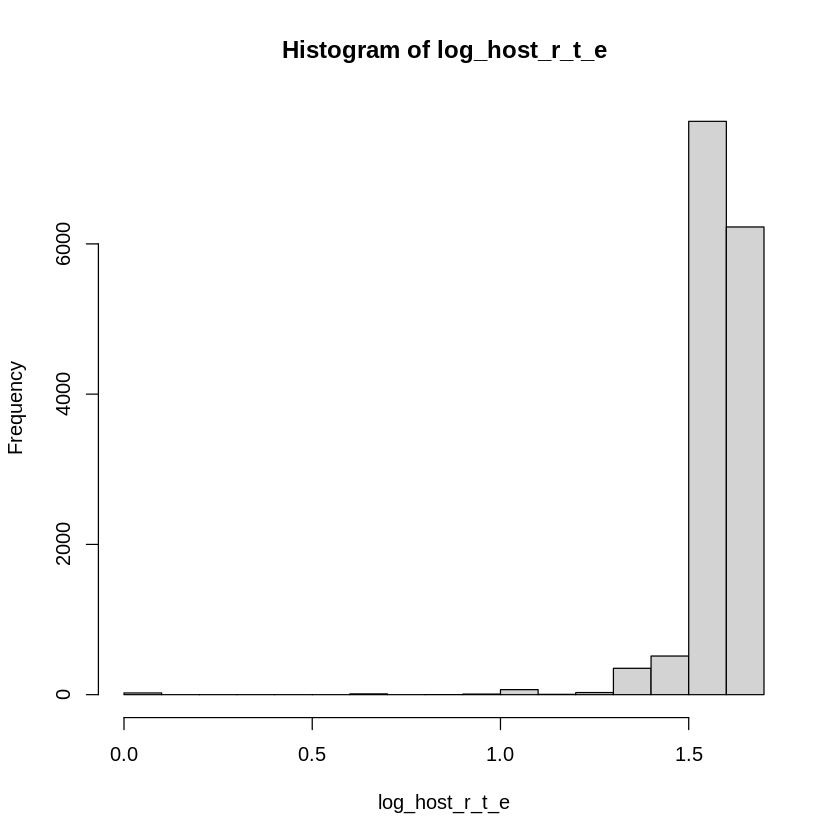

In [ ]:
# Usunięcie brakujących wartości w kolumnie 'review_scores_location'
review_scores_location_non_na <- data_frame$review_scores_location[!is.na(data_frame$review_scores_location)]

# Obliczenie logarytmu naturalnego dla kolumny 'review_scores_location'
log_host_r_t_e <- log(review_scores_location_non_na)

# Tworzenie histogramu
hist(log_host_r_t_e)

Warning message:
“Removed 5133 rows containing missing values or values outside the scale range (`geom_point()`).”


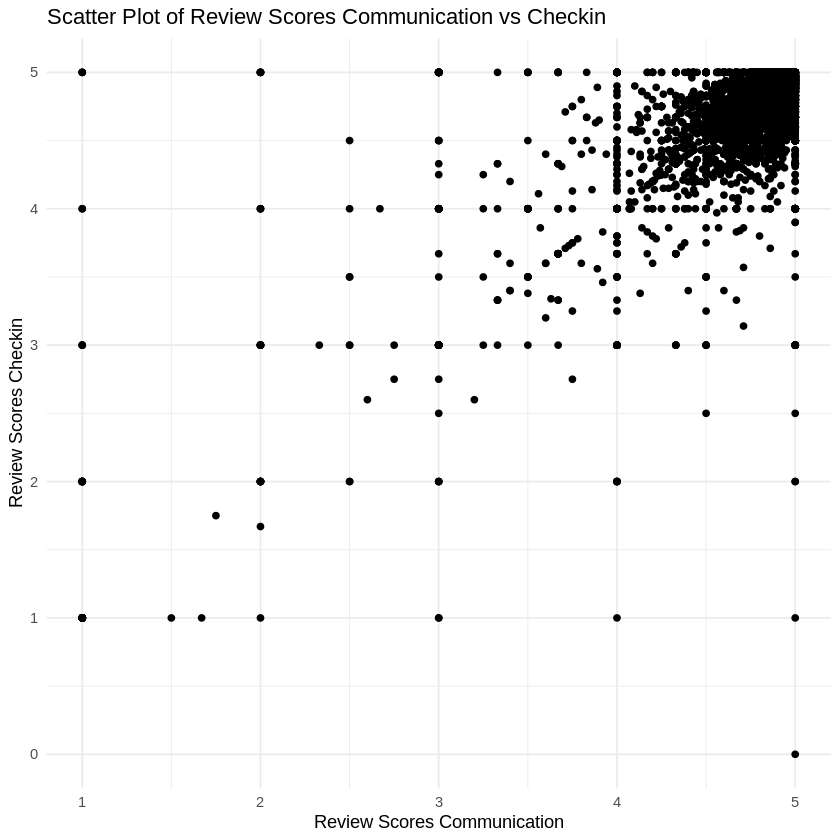

In [ ]:
library(ggplot2)

# Tworzenie wykresu punktowego (scatter plot)
ggplot(data = data_frame, aes(x = review_scores_communication, y = review_scores_checkin)) +
  geom_point() +
  labs(x = "Review Scores Communication", y = "Review Scores Checkin") +
  ggtitle("Scatter Plot of Review Scores Communication vs Checkin")

REVIEW SCORES RATING

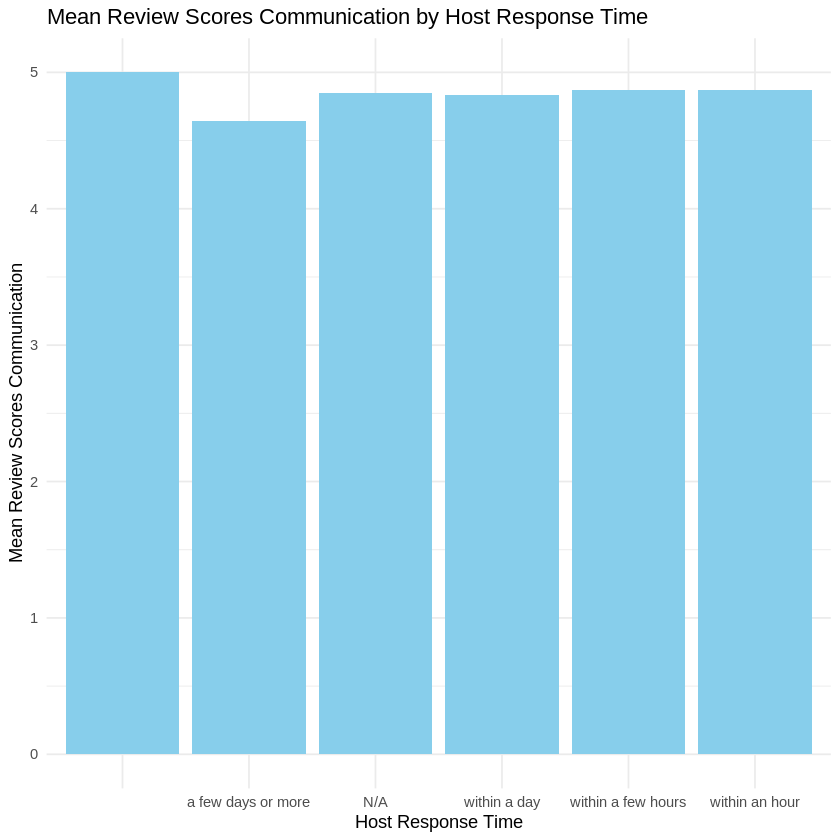

In [ ]:
library(dplyr)
library(ggplot2)

# Grupowanie po 'host_response_time' i obliczenie średniej 'review_scores_communication'
avg_review_scores <- data_frame %>%
  group_by(host_response_time) %>%
  summarise(mean_communication = mean(review_scores_communication, na.rm = TRUE))

# Tworzenie wykresu słupkowego
ggplot(data = avg_review_scores, aes(x = host_response_time, y = mean_communication)) +
  geom_bar(stat = "identity", fill = "skyblue") +
  labs(x = "Host Response Time", y = "Mean Review Scores Communication") +
  ggtitle("Mean Review Scores Communication by Host Response Time")

OCZYSZCZENIE DANYCH W KOLUMNIE 'review_scores_rating'

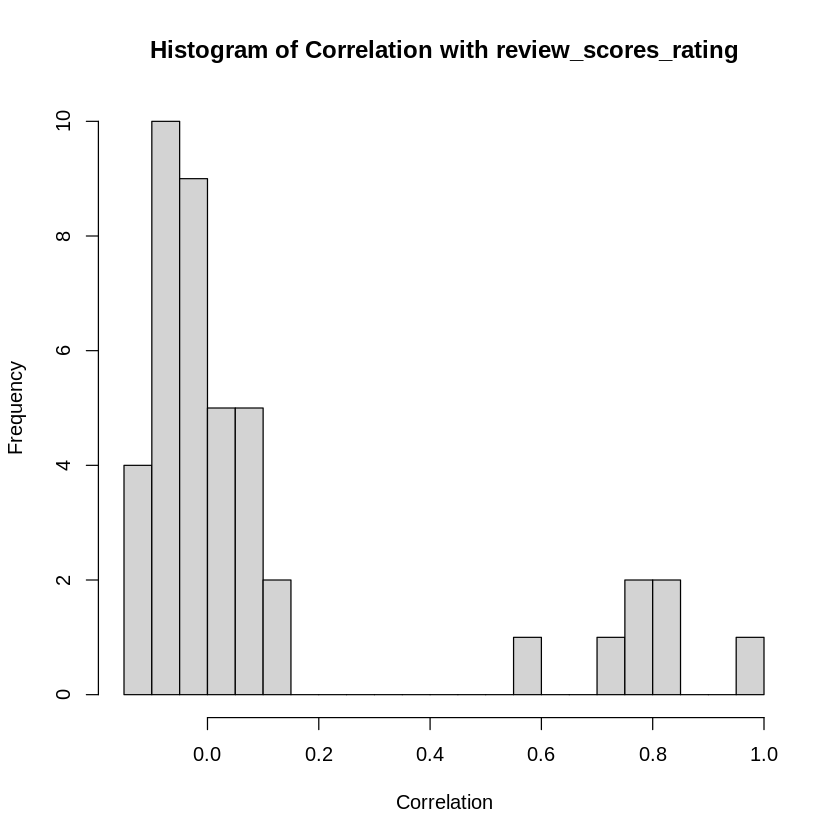

In [ ]:
# Wybieranie kolumn liczbowych i obliczanie macierzy korelacji
numeric_cols <- data_frame[sapply(data_frame, is.numeric)]
corr <- cor(numeric_cols, use = "complete.obs")

# Sprawdzenie, czy 'review_scores_rating' jest w macierzy korelacji
if ('review_scores_rating' %in% rownames(corr)) {
  # Tworzenie histogramu dla korelacji z 'review_scores_rating'
  hist(corr['review_scores_rating', ], breaks = 20,
       main = "Histogram of Correlation with review_scores_rating",
       xlab = "Correlation")
} else {
  print("Kolumna 'review_scores_rating' nie istnieje lub nie jest liczbową kolumną.")
}

# Usunięcie górnej i prawej ramki wykresu
par(lend = 1)

PODSTAWIENIE MODĄ

In [ ]:
# Wyświetlenie unikalnych wartości w kolumnie 'review_scores_rating', w tym NaN
unique_values <- unique(data_frame$review_scores_rating)

print(unique_values)

  [1]   NA 5.00 4.91 4.67 4.75 4.80 4.00 4.34 4.50 4.86 4.73 4.82 4.31 4.93 4.44 4.55 4.88 4.54 4.66
 [20] 4.83 1.00 4.96 4.89 4.79 4.98 4.71 4.90 4.81 2.00 4.94 4.87 4.95 4.85 4.76 4.77 3.33 4.84 4.60
 [39] 4.57 4.64 4.17 4.56 3.40 3.86 4.58 4.63 3.83 4.45 4.46 4.78 4.51 4.92 2.86 4.30 4.74 3.93 4.43
 [58] 4.47 4.97 4.48 4.33 4.29 4.62 3.00 4.52 4.42 4.68 3.67 4.53 4.09 4.69 4.20 4.72 4.18 4.59 4.65
 [77] 4.61 4.99 4.38 4.25 4.15 4.26 3.50 4.70 3.80 3.75 4.10 2.50 4.36 4.40 4.14 4.24 1.67 4.08 3.94
 [96] 4.39 4.41 4.23 4.13 3.90 4.32 4.22 4.27 4.37 4.35 3.87 4.21 3.78 4.28 2.67 3.60 3.63 4.16 3.43
[115] 3.17 4.49 1.50 4.11 3.89 4.04 3.56 3.25 3.88 2.60 4.05 4.19 3.71 2.83 2.75 3.55 3.20 4.07 3.47
[134] 4.02 4.12 3.38 3.95 3.57 3.99 3.70


In [ ]:
library(dplyr)

# Znalezienie modalnej wartości kolumny 'review_scores_rating'
mode_rsr <- data_frame %>%
  summarise(mode_rsr = names(which.max(table(review_scores_rating))))

print(mode_rsr$mode_rsr)

[1] "5"


In [ ]:
# Znajdź modalną wartość kolumny 'review_scores_rating'
mode_rsr <- names(which.max(table(data_frame$review_scores_rating)))

# Uzupełnij brakujące wartości w kolumnie 'review_scores_rating' wartością modalną
data_frame$review_scores_rating[is.na(data_frame$review_scores_rating)] <- mode_rsr


SPRAWDZENIE KOLUMNY 'reviews_per_month' - WARTOŚCI NAN

In [ ]:
review_scores_rating_column <- data_frame$review_scores_rating
print(review_scores_rating_column)


    [1] "5"    "5"    "4.91" "4.67" "5"    "5"    "5"    "4.75" "5"    "4.8"  "5"    "4"    "5"   
   [14] "4.34" "5"    "4.5"  "5"    "5"    "4.86" "5"    "5"    "5"    "4.73" "4.82" "4.31" "5"   
   [27] "5"    "5"    "4.86" "4.5"  "4.93" "5"    "4.67" "4.44" "5"    "4.55" "5"    "5"    "5"   
   [40] "5"    "5"    "4.67" "4.88" "5"    "5"    "4.54" "5"    "5"    "4.66" "5"    "5"    "5"   
   [53] "4.83" "5"    "1"    "5"    "4.82" "5"    "4.96" "4.89" "4.79" "4.98" "4.83" "5"    "4.71"
   [66] "5"    "5"    "5"    "4.9"  "5"    "4.81" "2"    "4.94" "4.87" "5"    "4.75" "5"    "5"   
   [79] "5"    "5"    "5"    "5"    "5"    "4.95" "4.86" "5"    "4.85" "5"    "5"    "5"    "5"   
   [92] "4.76" "4.77" "5"    "5"    "4.88" "4.5"  "5"    "5"    "5"    "4.83" "5"    "5"    "3.33"
  [105] "5"    "5"    "5"    "4.84" "5"    "5"    "4.6"  "5"    "5"    "4.57" "4.83" "5"    "5"   
  [118] "5"    "5"    "5"    "4.5"  "5"    "4.89" "4.73" "5"    "4"    "4"    "5"    "4.82" "4.73"
  [131] "5

SPRAWDZENIE KOLUMNY 'reviews_per_month' - PODSTAWIENIE

In [ ]:
# Filtracja ramki danych, usuwając wiersze, gdzie 'reviews_per_month' jest NA
filtered <- data_frame[!is.na(data_frame$reviews_per_month), ]$reviews_per_month

# Obliczenie percentyla 95
perc <- quantile(filtered, probs = 0.95, na.rm = TRUE)

# Znalezienie modalnej wartości 'reviews_per_month'
data_mode <- names(which.max(table(data_frame$reviews_per_month)))

# Uzupełnienie brakujących wartości w kolumnie 'reviews_per_month' wartością modalną
data_frame$reviews_per_month[is.na(data_frame$reviews_per_month)] <- data_mode

In [ ]:
# Obliczenie liczby brakujących wartości w kolumnie 'reviews_per_month'
num_na <- sum(is.na(data_frame$reviews_per_month))

print(num_na)


[1] 0


UZUPEŁNIENIE BRAKUJĄCYCH RATE'ÓW DLA HOSTA WARTOŚCIAMI ŚREDNIMI

In [ ]:
# Obliczenie średniej wartości kolumny 'host_response_rate'
mean_rates <- mean(data_frame$host_response_rate, na.rm = TRUE)

print(mean_rates)

[1] 0.009517051


In [ ]:
# Obliczenie średniej wartości kolumny 'host_acceptance_rate'
mean_rates2 <- mean(data_frame$host_acceptance_rate, na.rm = TRUE)

print(mean_rates2)


[1] 0.008548085


In [ ]:
# Obliczenie średnich wartości dla kolumn 'host_response_rate' i 'host_acceptance_rate'
mean_response_rate <- mean(data_frame$host_response_rate, na.rm = TRUE)
mean_acceptance_rate <- mean(data_frame$host_acceptance_rate, na.rm = TRUE)

# Wypełnienie brakujących wartości w kolumnie 'host_response_rate'
data_frame$host_response_rate[is.na(data_frame$host_response_rate)] <- round(mean_response_rate, 2)

# Wypełnienie brakujących wartości w kolumnie 'host_acceptance_rate'
data_frame$host_acceptance_rate[is.na(data_frame$host_acceptance_rate)] <- round(mean_acceptance_rate, 2)

In [ ]:
host_acceptance_rate_column <- data_frame$host_acceptance_rate
print(host_acceptance_rate_column)

    [1] 0.0098 0.0095 0.0099 0.0088 0.0100 0.0075 0.0100 0.0100 0.0100 0.0100 0.0100 0.0100 0.0069
   [14] 0.0098 0.0100 0.0100 0.0100 0.0100 0.0091 0.0100 0.0100 0.0097 0.0096 0.0099 0.0100 0.0100
   [27] 0.0000 0.0100 0.0100 0.0080 0.0100 0.0100 0.0100 0.0100 0.0078 0.0056 0.0100 0.0100 0.0100
   [40] 0.0100 0.0024 0.0090 0.0086 0.0100 0.0100 0.0096 0.0100 0.0090 0.0098 0.0100 0.0100 0.0091
   [53] 0.0089 0.0085 0.0025 0.0100 0.0100 0.0000 0.0100 0.0100 0.0099 0.0100 0.0100 0.0082 0.0097
   [66] 0.0080 0.0100 0.0076 0.0100 0.0100 0.0100 0.0100 0.0100 0.0100 0.0100 0.0100 0.0100 0.0097
   [79] 0.0100 0.0095 0.0100 0.0100 0.0060 0.0100 0.0090 0.0100 0.0100 0.0100 0.0100 0.0100 0.0100
   [92] 0.0100 0.0099 0.0100 0.0100 0.0033 0.0095 0.0098 0.0082 0.0100 0.0085 0.0100 0.0100 0.0100
  [105] 0.0100 0.0068 0.0100 0.0100 0.0100 0.0096 0.0100 0.0100 0.0100 0.0100 0.0075 0.0100 0.0100
  [118] 0.0100 0.0100 0.0100 0.0100 0.0025 0.0100 0.0049 0.0072 0.0079 0.0100 0.0000 0.0096 0.0042
  [131] 0.

SPRAWDZENIE PODSTAWIENIA

In [ ]:
unique_values <- unique(data_frame$host_response_rate)
print(unique_values)

 [1] 0.0100 0.0090 0.0091 0.0088 0.0099 0.0087 0.0086 0.0097 0.0095 0.0085 0.0073 0.0080 0.0064
[14] 0.0089 0.0000 0.0082 0.0050 0.0033 0.0072 0.0044 0.0075 0.0060 0.0098 0.0070 0.0020 0.0094
[27] 0.0011 0.0010 0.0093 0.0096 0.0040 0.0067 0.0071 0.0074 0.0083 0.0092 0.0053 0.0056 0.0018
[40] 0.0063 0.0017 0.0025 0.0052 0.0078 0.0059 0.0038 0.0009 0.0079 0.0030 0.0023 0.0081 0.0003
[53] 0.0066 0.0077 0.0065 0.0043 0.0041


In [ ]:
unique_values <- unique(data_frame$host_acceptance_rate)
print(unique_values)

 [1] 0.0098 0.0095 0.0099 0.0088 0.0100 0.0075 0.0069 0.0091 0.0097 0.0096 0.0000 0.0080 0.0078
[14] 0.0056 0.0024 0.0090 0.0086 0.0089 0.0085 0.0025 0.0082 0.0076 0.0060 0.0033 0.0068 0.0049
[27] 0.0072 0.0079 0.0042 0.0067 0.0081 0.0034 0.0071 0.0087 0.0050 0.0063 0.0073 0.0077 0.0094
[40] 0.0040 0.0048 0.0093 0.0022 0.0066 0.0020 0.0061 0.0084 0.0014 0.0010 0.0092 0.0074 0.0065
[53] 0.0070 0.0043 0.0041 0.0029 0.0047 0.0083 0.0027 0.0038 0.0054 0.0017 0.0053 0.0039 0.0055
[66] 0.0064 0.0057 0.0006 0.0062 0.0058 0.0046 0.0018 0.0021 0.0035 0.0044 0.0032 0.0059 0.0045
[79] 0.0037 0.0052 0.0013 0.0030 0.0036 0.0009 0.0007 0.0015 0.0051 0.0026 0.0028 0.0011 0.0004
[92] 0.0031 0.0023 0.0019


OBRÓBKA KOLUMN ZWIĄZANYCH Z REVIEW SCORES

In [ ]:
library(dplyr)

# Wybrane kolumny do obliczenia statystyk
reviews <- c('review_scores_value',
             'review_scores_location',
             'review_scores_checkin',
             'review_scores_communication',
             'review_scores_accuracy',
             'review_scores_cleanliness')

# Obliczenie mediany i średniej dla wybranych kolumn
stats <- data_frame %>%
  summarise(across(all_of(reviews), list(median = median, mean = mean), na.rm = TRUE))

# Transpozycja wyników dla lepszej czytelności
stats <- t(stats)

print(stats)

Warning message:
“There was 1 warning in `summarise()`.
ℹ In argument: `across(all_of(reviews), list(median = median, mean = mean), na.rm = TRUE)`.
Caused by warning:
! The `...` argument of `across()` is deprecated as of dplyr 1.1.0.
Supply arguments directly to `.fns` through an anonymous function instead.

  # Previously
  across(a:b, mean, na.rm = TRUE)

  # Now
  across(a:b, \(x) mean(x, na.rm = TRUE))”


                                       [,1]
review_scores_value_median         4.790000
review_scores_value_mean           4.682781
review_scores_location_median      4.920000
review_scores_location_mean        4.823631
review_scores_checkin_median       4.960000
review_scores_checkin_mean         4.848282
review_scores_communication_median 4.980000
review_scores_communication_mean   4.860318
review_scores_accuracy_median      4.920000
review_scores_accuracy_mean        4.797990
review_scores_cleanliness_median   4.860000
review_scores_cleanliness_mean     4.722112


SPRAWDZENIE CZY ZOSTAŁY NIEOBSŁUŻONE WARTOŚCI NAN

In [ ]:
# Lista kolumn do uzupełnienia
reviews <- c('review_scores_value',
             'review_scores_location',
             'review_scores_checkin',
             'review_scores_communication',
             'review_scores_accuracy',
             'review_scores_cleanliness')

# Pętla for do uzupełnienia brakujących wartości w każdej kolumnie
for (column in reviews) {
  data_frame[[column]] <- ifelse(is.na(data_frame[[column]]),
                                 mean(data_frame[[column]], na.rm = TRUE),
                                 data_frame[[column]])
}

# Wyświetlenie zaktualizowanej ramki danych
print(data_frame)


                                          listing_url last_scraped          source
1    https://www.airbnb.com/rooms/1002736951366032648   2023-12-12     city scrape
2     https://www.airbnb.com/rooms/716133555965651038   2023-12-12     city scrape
3               https://www.airbnb.com/rooms/27278791   2023-12-12     city scrape
4               https://www.airbnb.com/rooms/53526328   2023-12-12     city scrape
5    https://www.airbnb.com/rooms/1012550920875154828   2023-12-12     city scrape
6     https://www.airbnb.com/rooms/684041130828663144   2023-12-12     city scrape
7               https://www.airbnb.com/rooms/18227287   2023-12-13 previous scrape
8               https://www.airbnb.com/rooms/53032551   2023-12-13     city scrape
9               https://www.airbnb.com/rooms/10405775   2023-12-13 previous scrape
10              https://www.airbnb.com/rooms/19198250   2023-12-13 previous scrape
11              https://www.airbnb.com/rooms/13712972   2023-12-13 previous scrape
12  

FILTR NA KOLUMNY Z WARTOŚCIAMI NUMERYCZNYMI - BEZ OBJEKTÓW, DATETIME

In [ ]:
# Wybrane kolumny do sprawdzenia
reviews <- c('review_scores_value',
             'review_scores_location',
             'review_scores_checkin',
             'review_scores_communication',
             'review_scores_accuracy',
             'review_scores_cleanliness')

# Obliczenie liczby brakujących wartości w wybranych kolumnach
num_na <- colSums(is.na(data_frame[reviews]))

print(num_na)


        review_scores_value      review_scores_location       review_scores_checkin 
                          0                           0                           0 
review_scores_communication      review_scores_accuracy   review_scores_cleanliness 
                          0                           0                           0 


In [ ]:
library(dplyr)

# Lista wszystkich nazw kolumn
all_columns <- names(data_frame)

# Filtrowanie kolumn na podstawie warunków
data_frame_check <- all_columns[!(all_columns %in% c("id", "price")) &
                                !grepl("id", all_columns) &
                                !grepl("price", all_columns) &
                                !(sapply(data_frame[, all_columns], class) %in% c("character", "POSIXct"))]

print(data_frame_check)


 [1] "last_scraped"                                 "host_response_time"                          
 [3] "host_response_rate"                           "host_acceptance_rate"                        
 [5] "host_is_superhost"                            "host_listings_count"                         
 [7] "host_total_listings_count"                    "host_has_profile_pic"                        
 [9] "latitude"                                     "longitude"                                   
[11] "room_type"                                    "accommodates"                                
[13] "bathrooms"                                    "beds"                                        
[15] "minimum_nights"                               "maximum_nights"                              
[17] "minimum_minimum_nights"                       "maximum_minimum_nights"                      
[19] "minimum_maximum_nights"                       "maximum_maximum_nights"                      
[21] "mini

TABELA Z WARTOŚCIAMI OPISUJĄCYMI DANE - ILOŚĆ, ŚREDNIA, ODCHYLENIE STANDARDOWE, WARTOŚCI MINIMALNA, PERCENTYLE, WARTOŚCI MAXYMALNE

In [ ]:
library(dplyr)

# Uzyskanie statystyk opisowych dla wybranych kolumn
summary_stats <- data_frame %>%
  select(all_of(data_frame_check)) %>%
  summary()

# Transpozycja wyników dla lepszej czytelności
summary_stats <- t(summary_stats)

print(summary_stats)

                                                                                                                  
 last_scraped                                                                      Min.   :2023-12-12             
         host_response_time                                                                          :   2        
host_response_rate                                                                 Min.   :0.000000               
host_acceptance_rate                                                               Min.   :0.00000                
host_is_superhost                                                                  Mode :logical                  
                                                                                                                  
 last_scraped                                                                      1st Qu.:2023-12-12             
         host_response_time                                                     

WYKRESY

SPRAWDZENIE OUTLAIER'ÓW

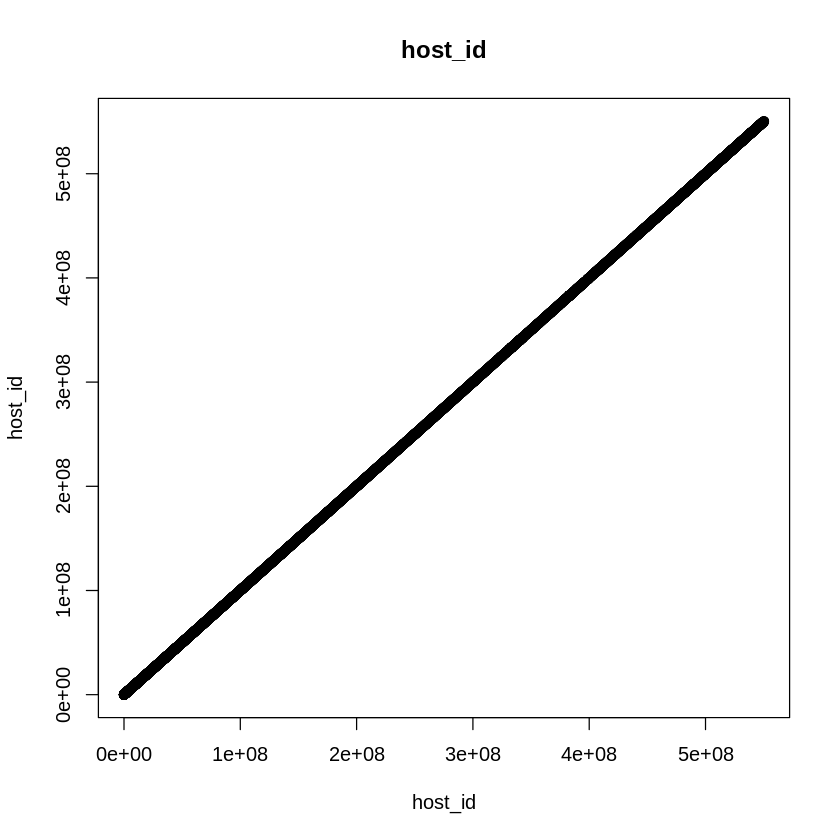

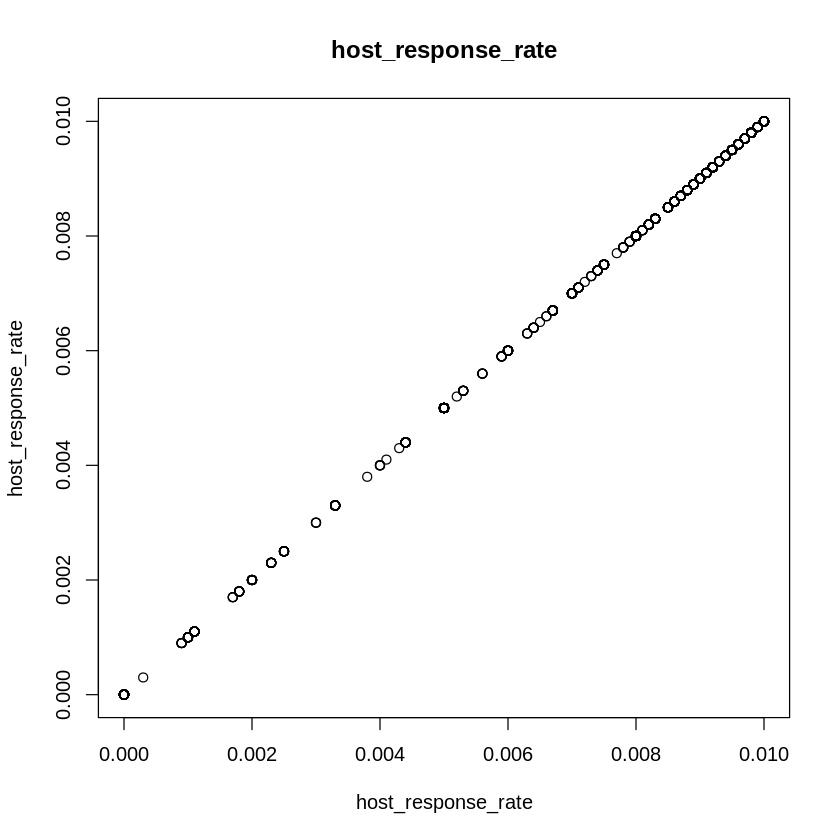

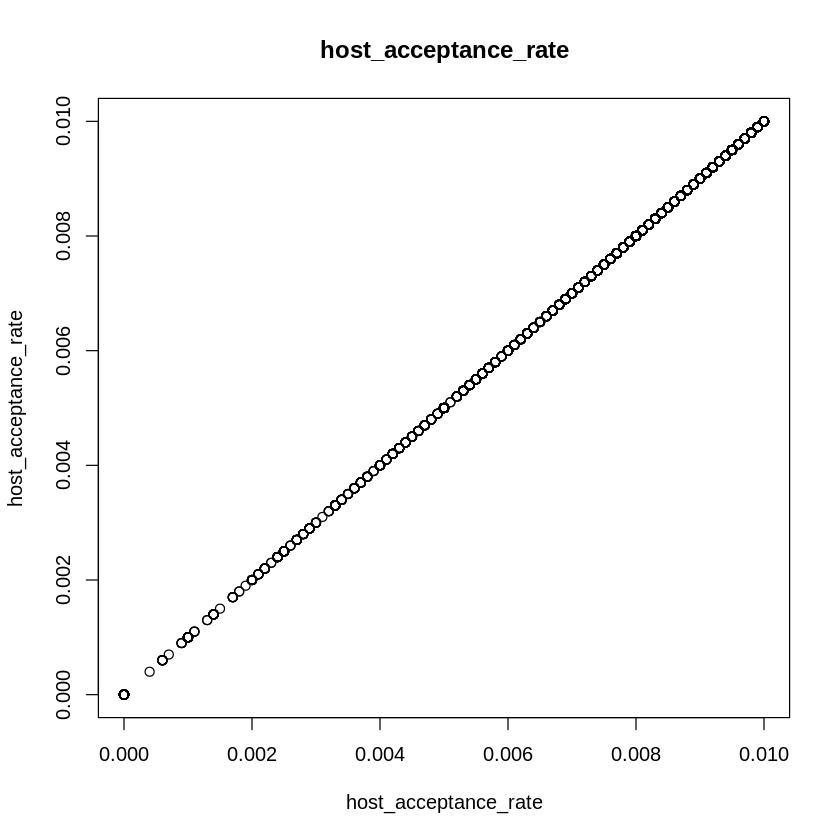

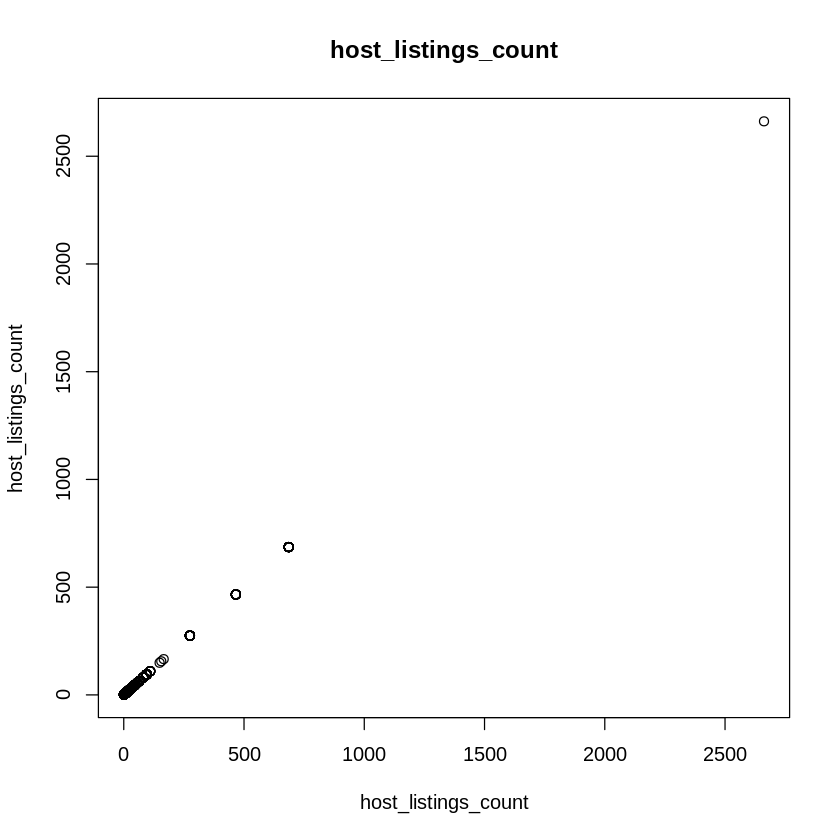

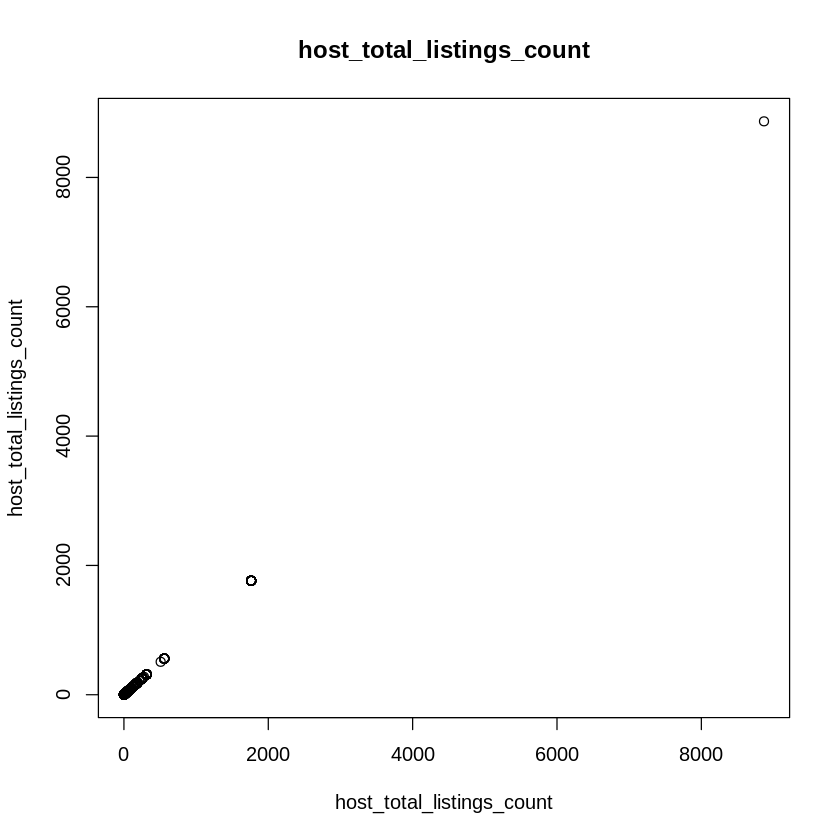

...

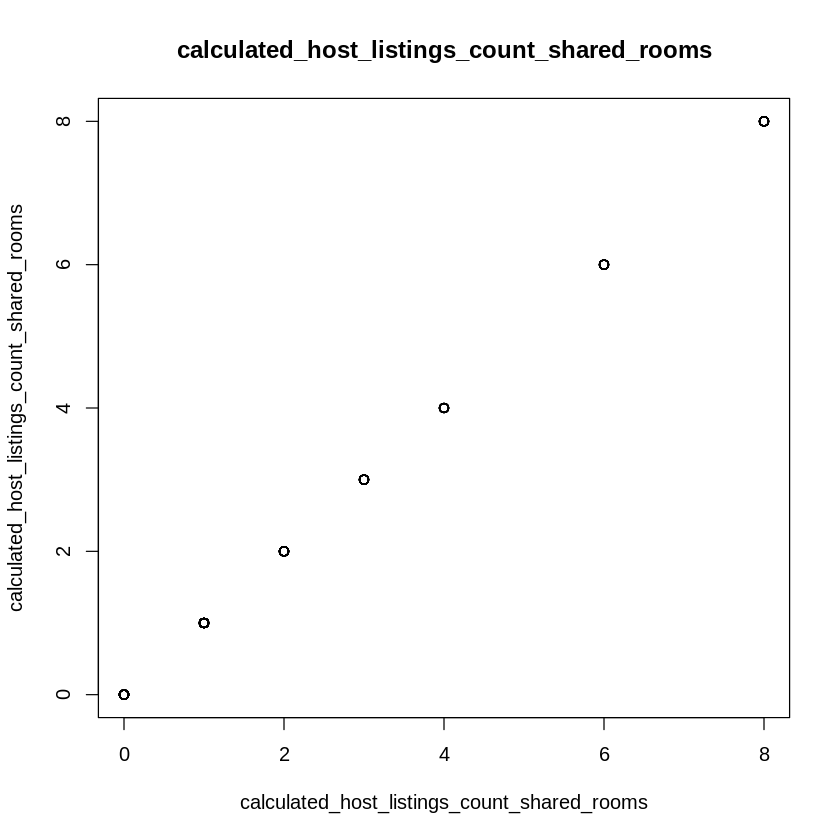

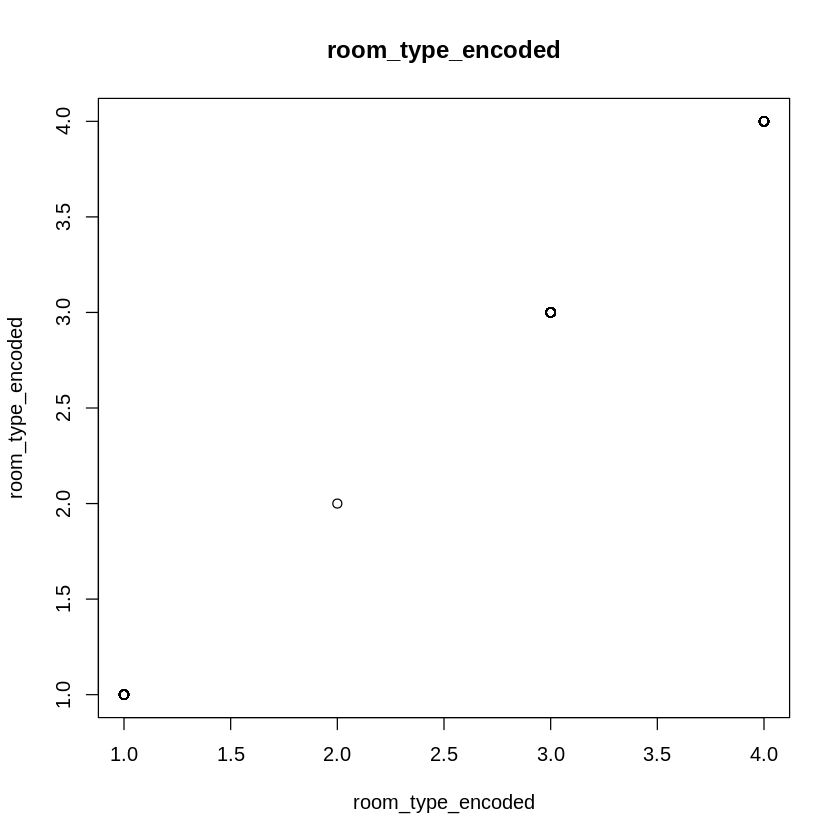

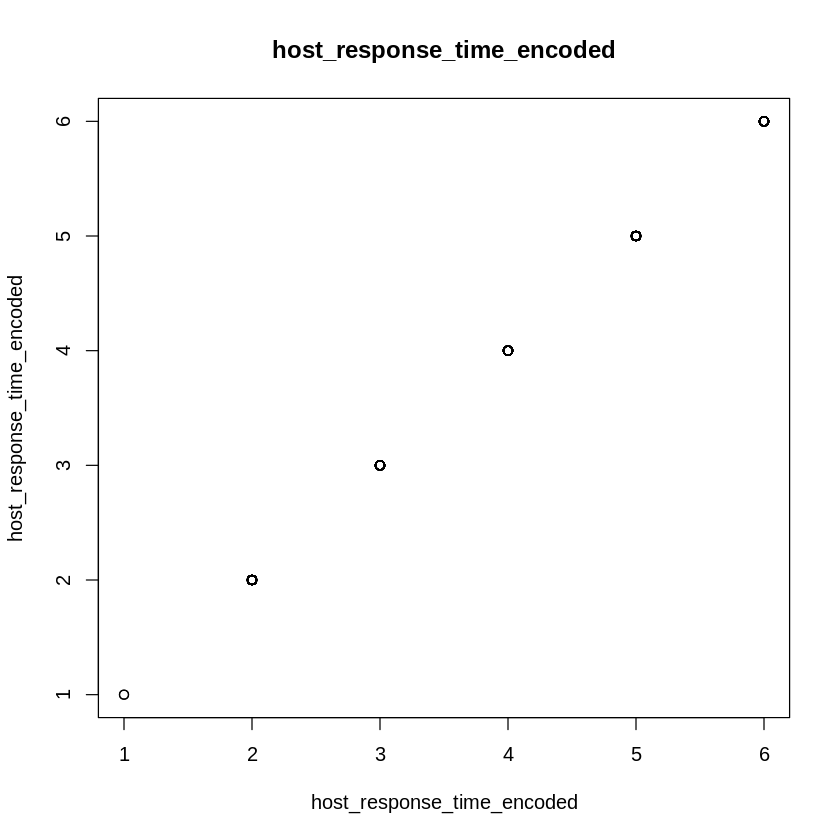

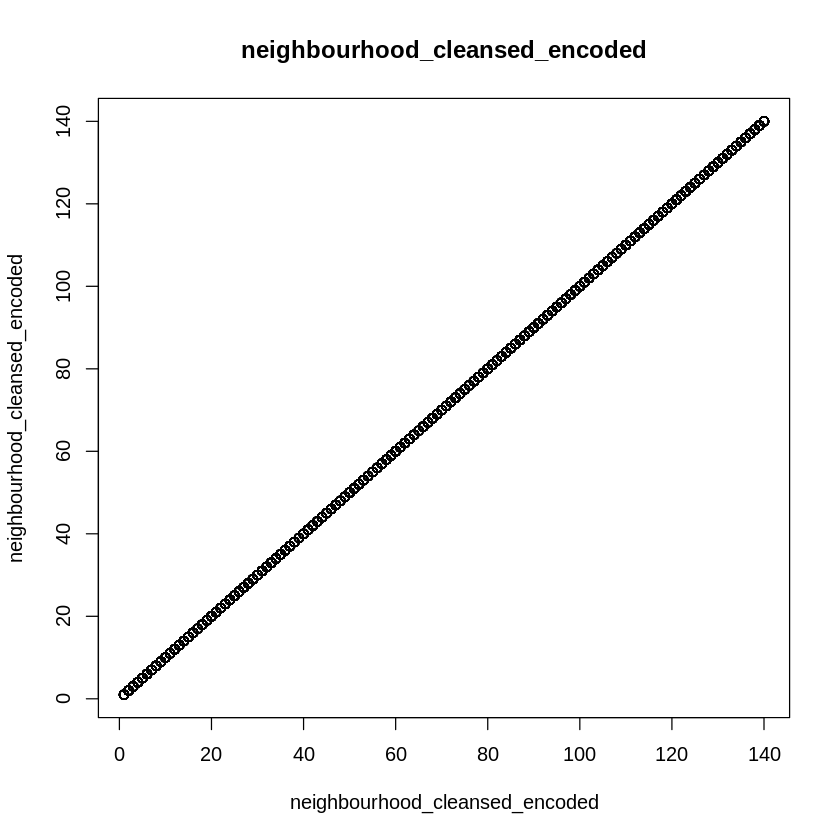

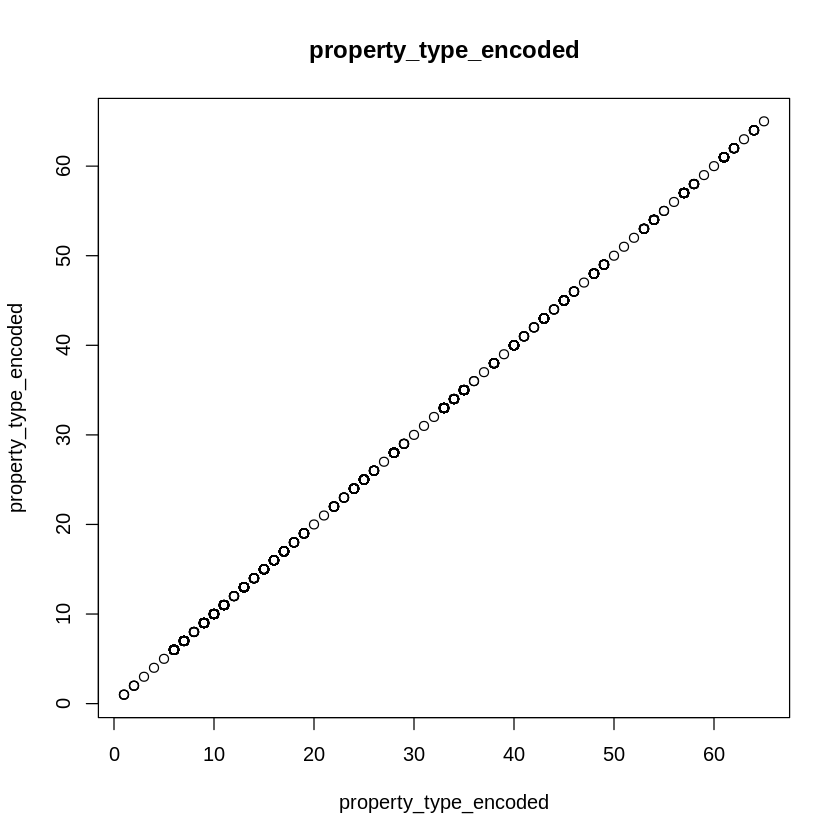

In [ ]:
# Wybierz tylko kolumny numeryczne
numeric_columns <- Filter(is.numeric, data_frame)

# Pętla for do tworzenia wykresów punktowych
for (column in names(numeric_columns)) {
  plot(x = numeric_columns[[column]], y = numeric_columns[[column]],
       main = column, xlab = column, ylab = column)
}

Skipping histogram for column: listing_url 
Skipping boxplot for column: listing_url 
Skipping histogram for column: last_scraped 
Skipping histogram for column: source 
Skipping boxplot for column: source 
Skipping histogram for column: name 
Skipping boxplot for column: name 
Skipping histogram for column: picture_url 
Skipping boxplot for column: picture_url 


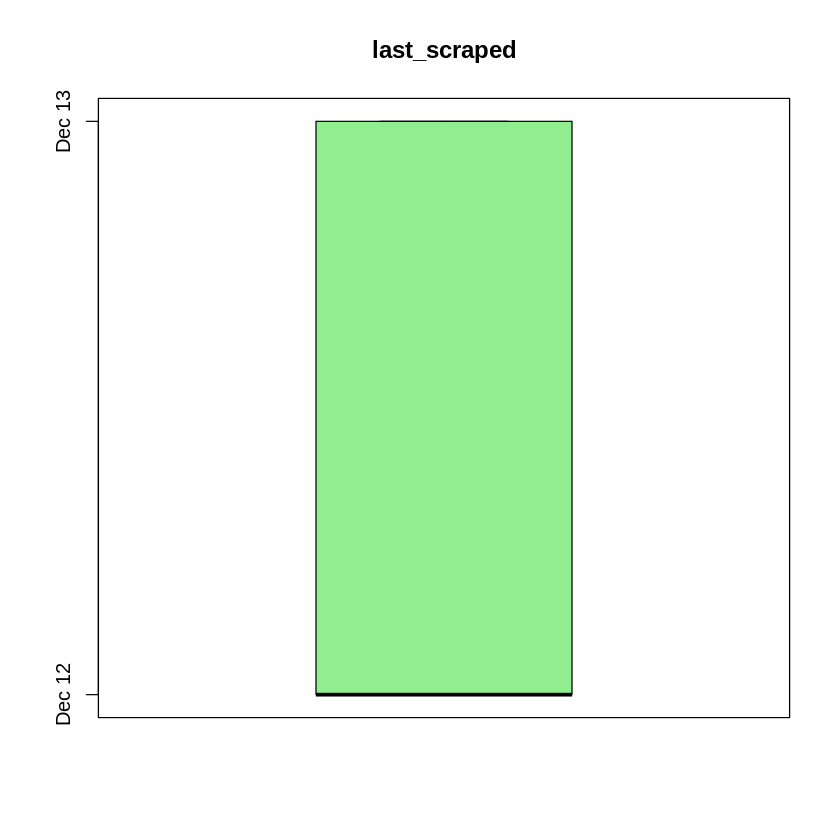

[1] "\n\n"


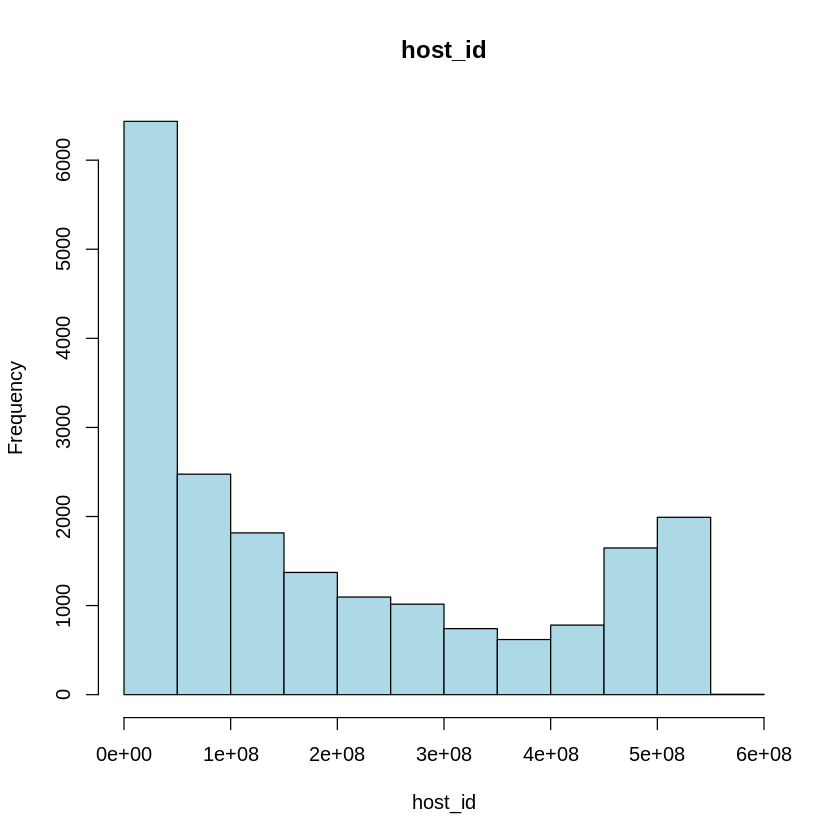

Skipping histogram for column: host_url 
Skipping boxplot for column: host_url 
Skipping histogram for column: host_name 
Skipping boxplot for column: host_name 
Skipping histogram for column: host_since 
Skipping boxplot for column: host_since 
Skipping histogram for column: host_location 
Skipping boxplot for column: host_location 
Skipping histogram for column: host_response_time 


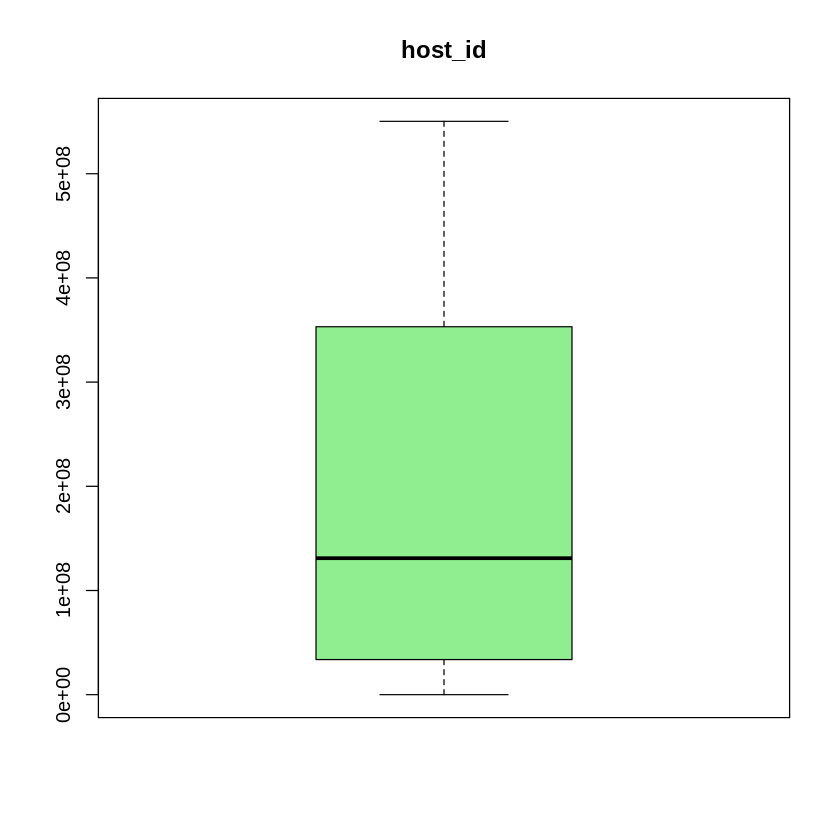

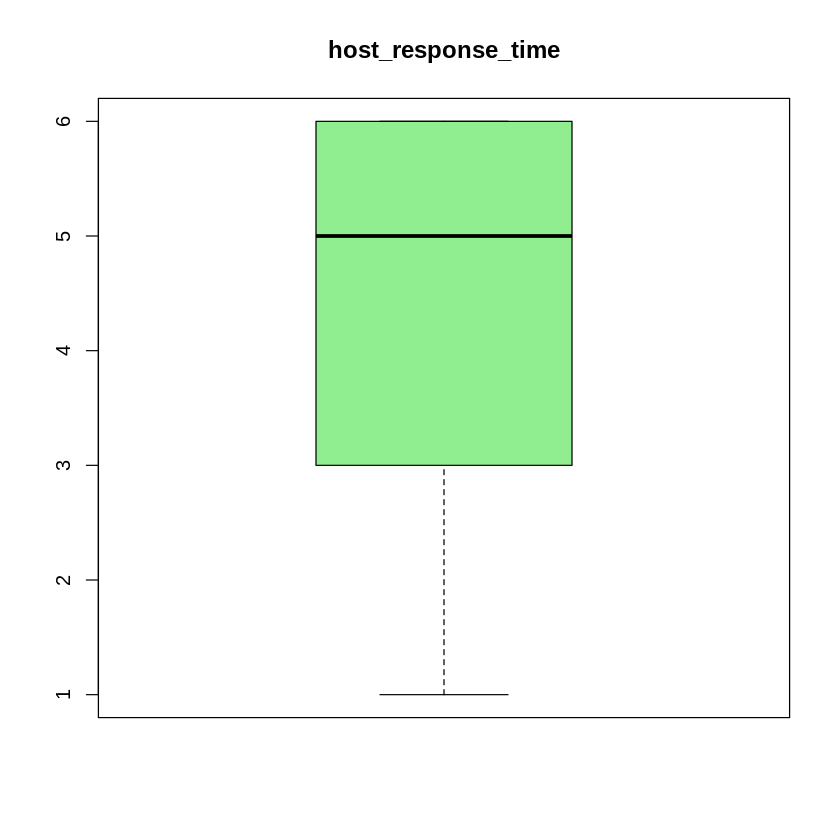

[1] "\n\n"


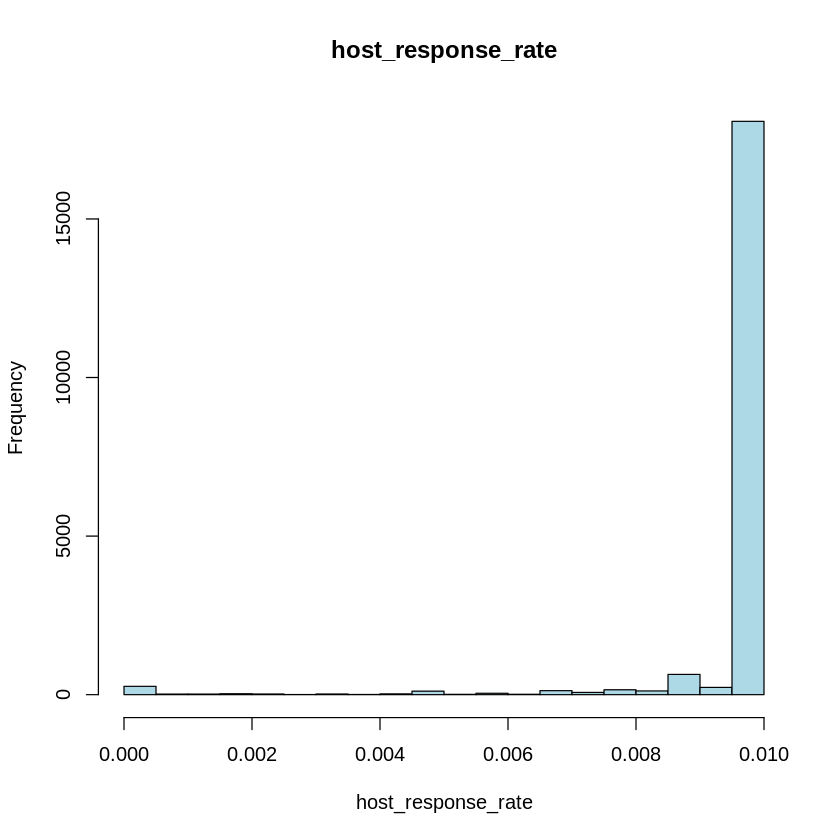

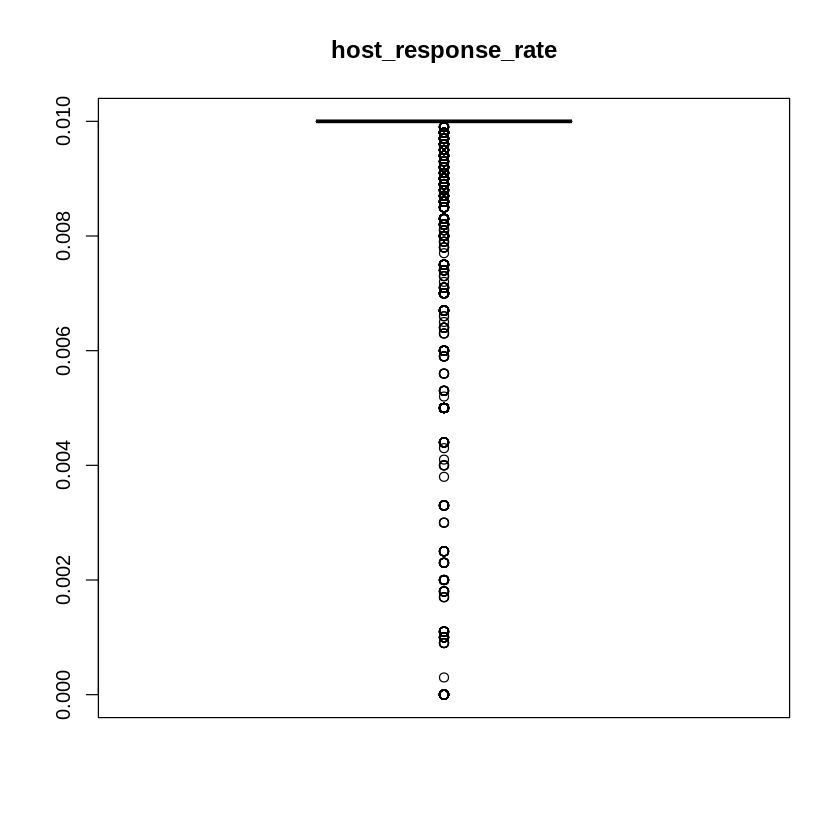

[1] "\n\n"


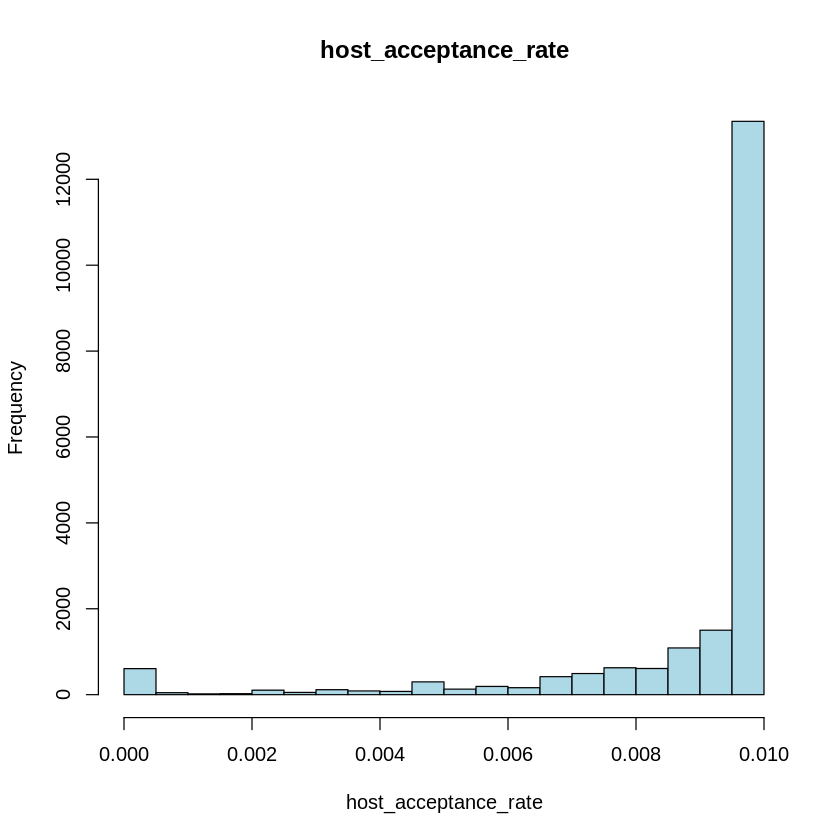

Skipping histogram for column: host_is_superhost 


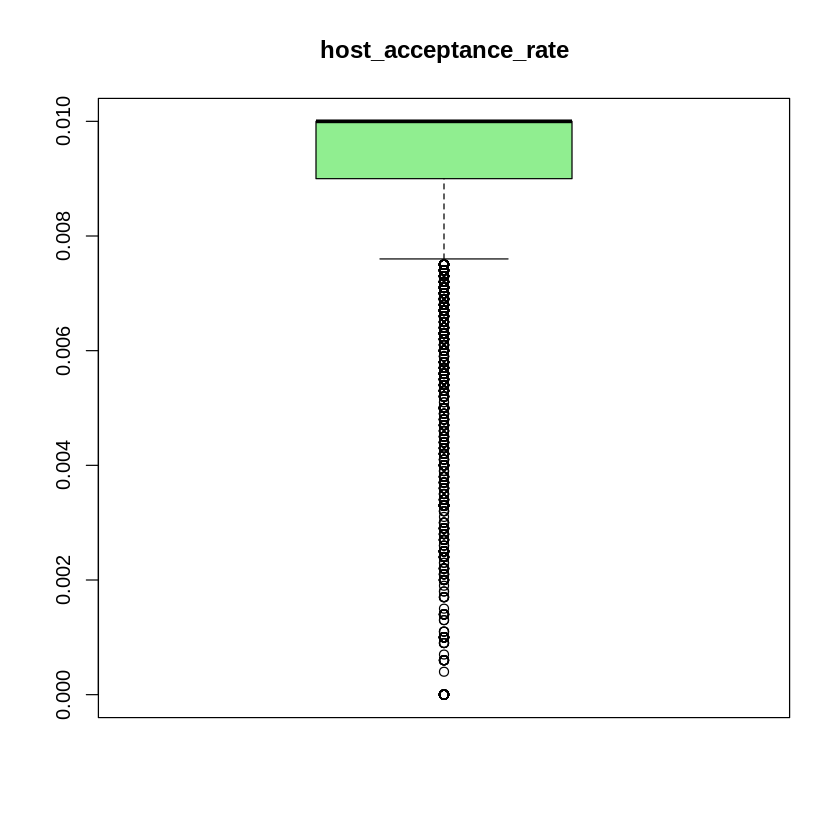

Skipping histogram for column: host_thumbnail_url 
Skipping boxplot for column: host_thumbnail_url 
Skipping histogram for column: host_picture_url 
Skipping boxplot for column: host_picture_url 


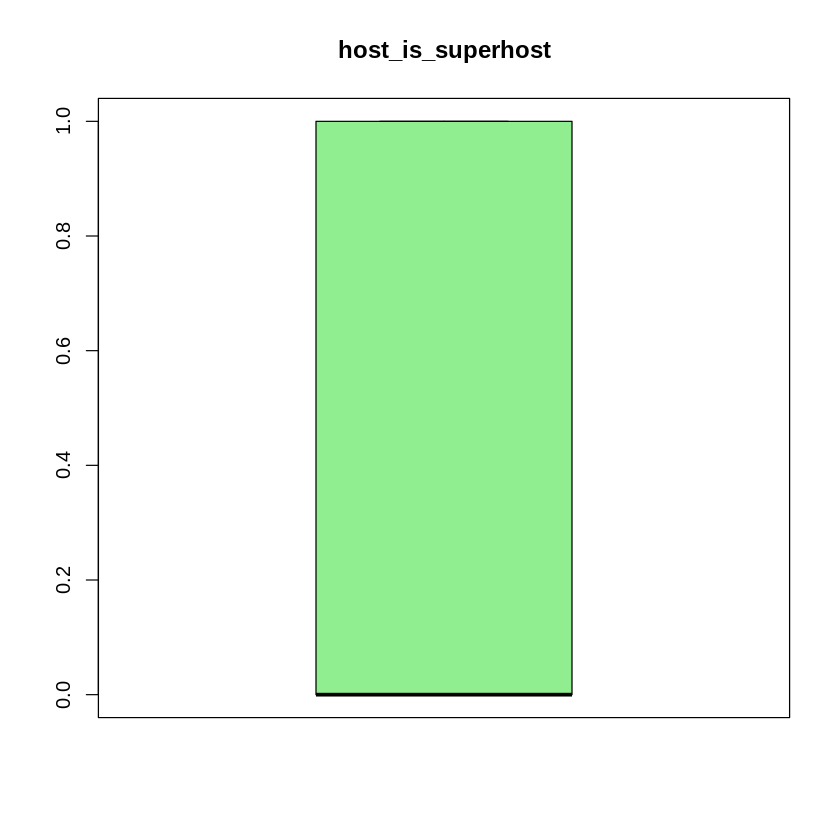

[1] "\n\n"


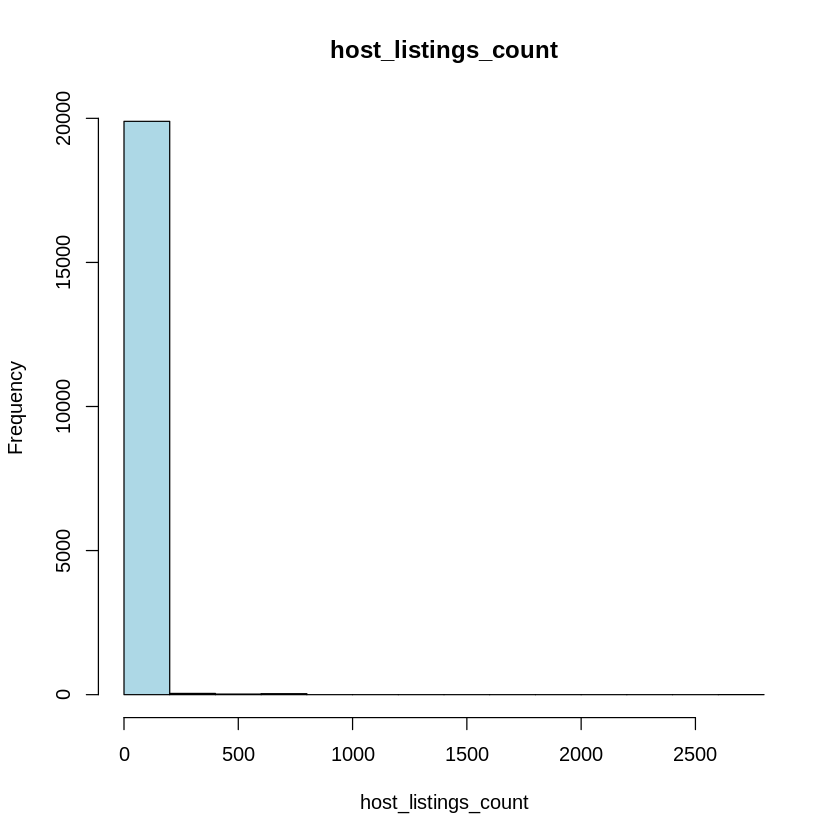

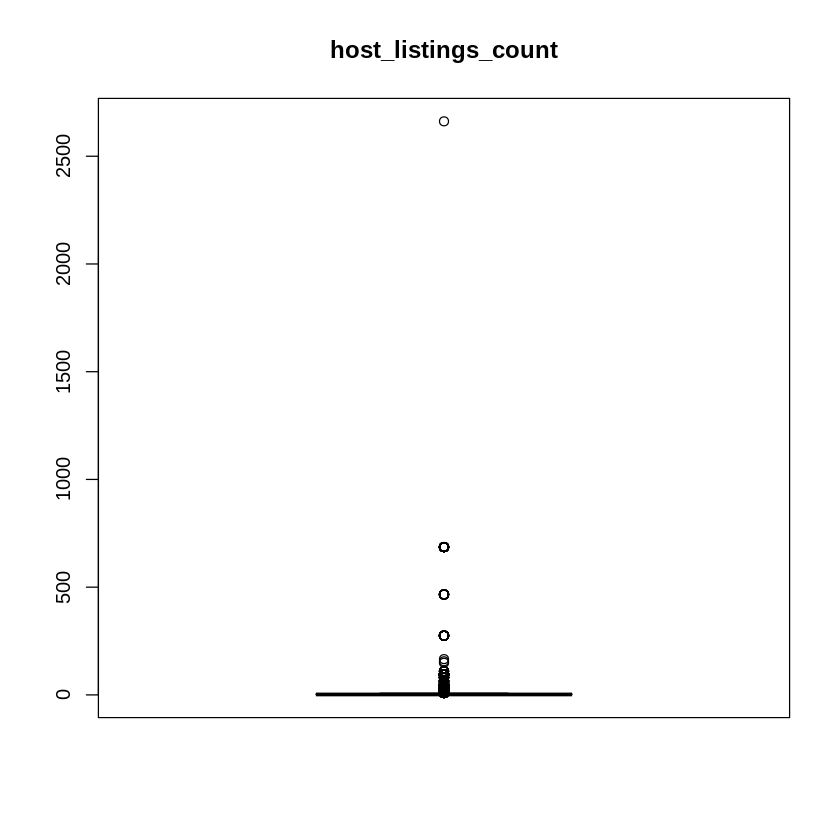

[1] "\n\n"


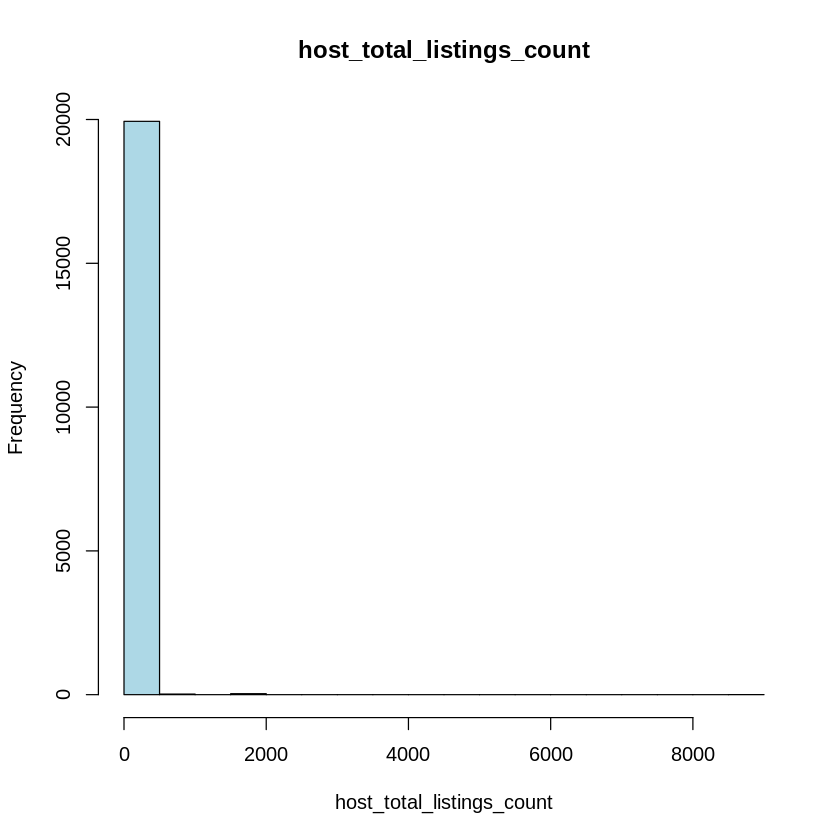

Skipping histogram for column: host_verifications 
Skipping boxplot for column: host_verifications 
Skipping histogram for column: host_has_profile_pic 


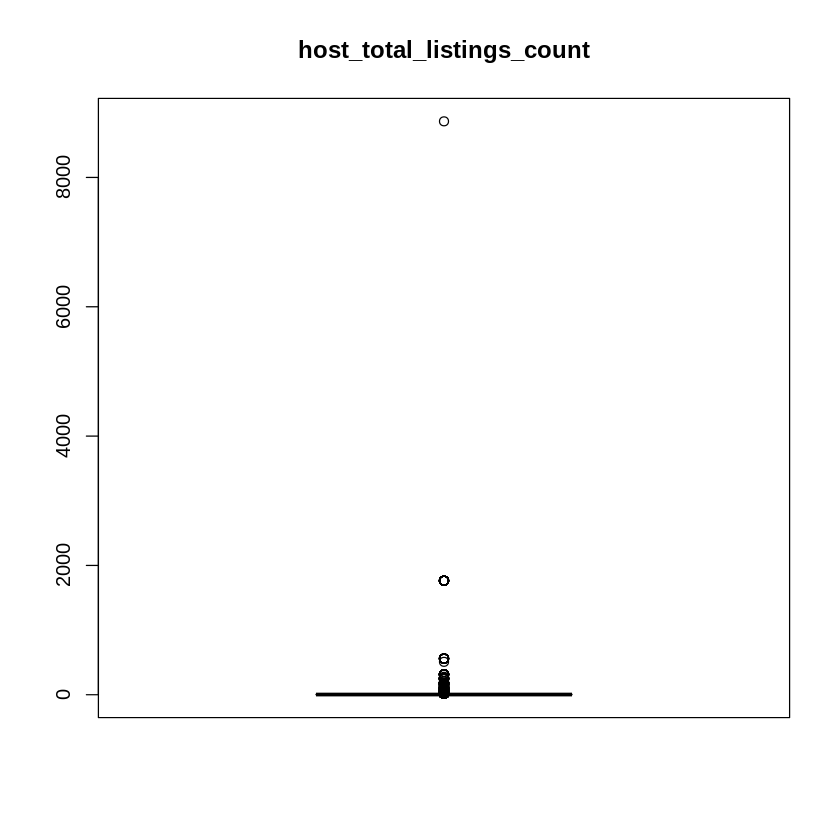

Skipping histogram for column: host_identity_verified 


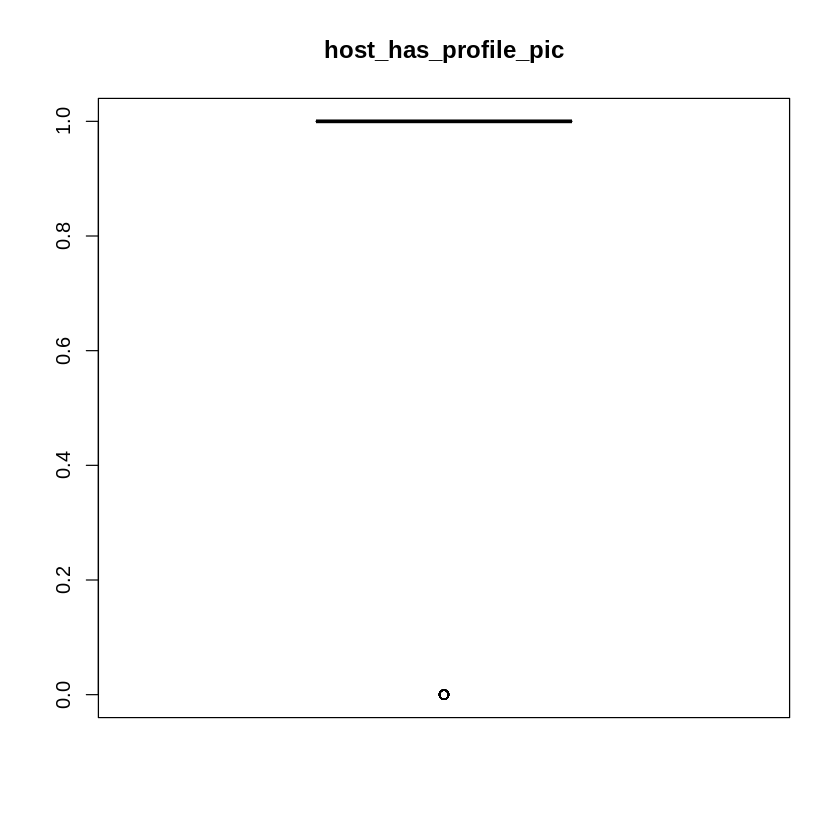

Skipping histogram for column: neighbourhood_cleansed 
Skipping boxplot for column: neighbourhood_cleansed 


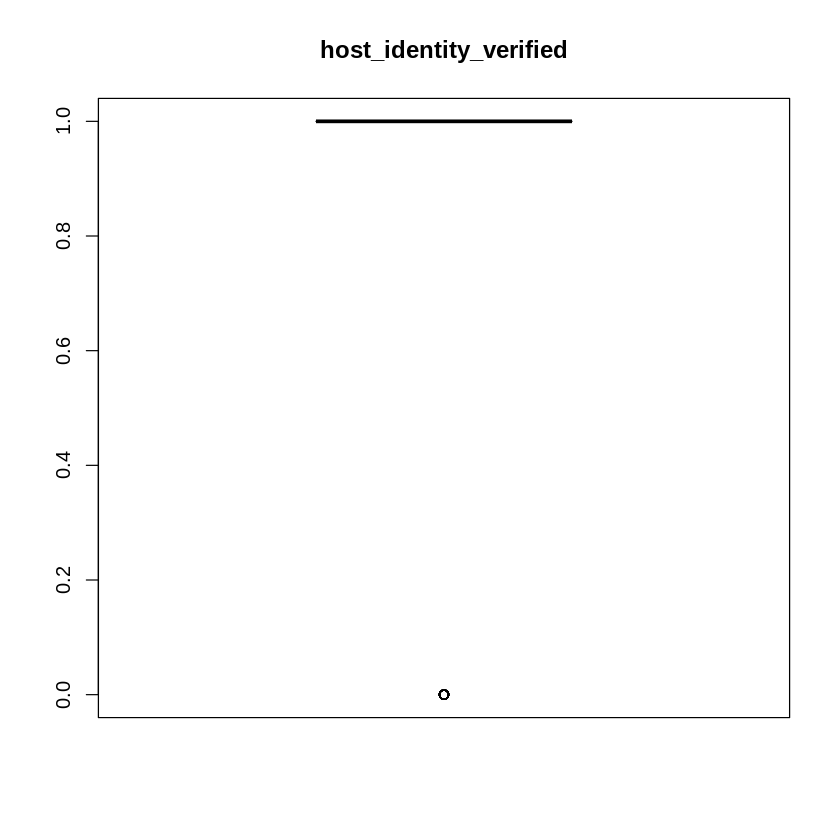

[1] "\n\n"


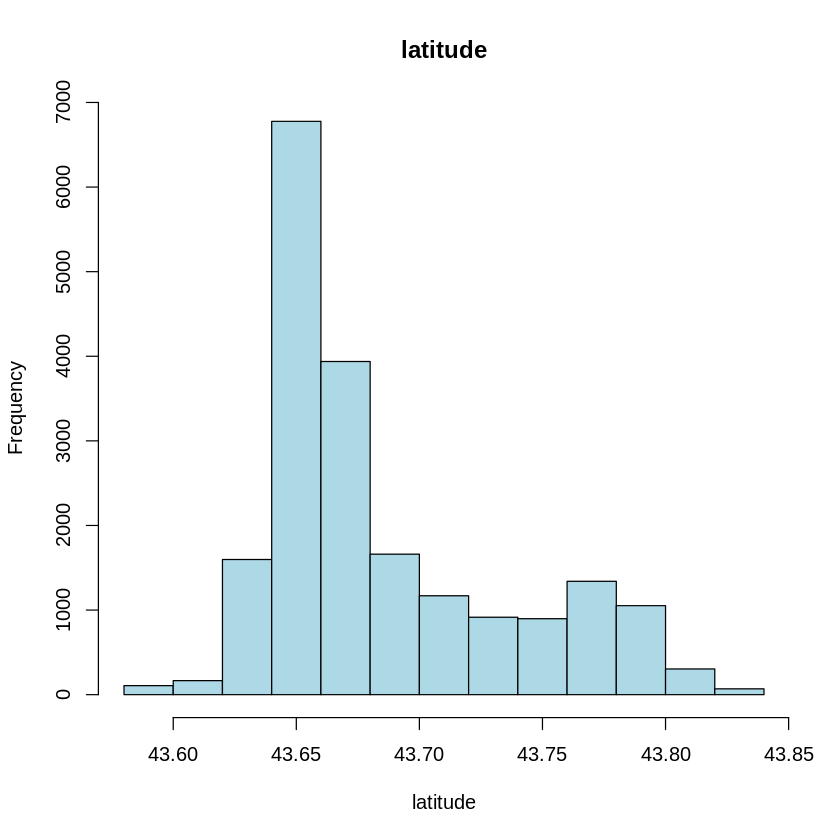

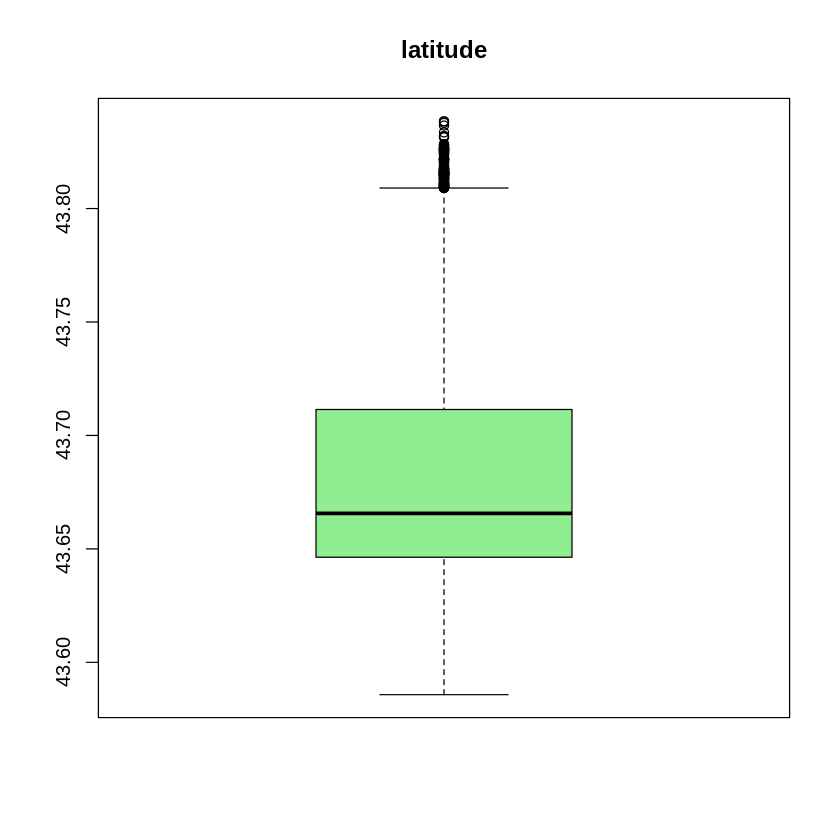

[1] "\n\n"


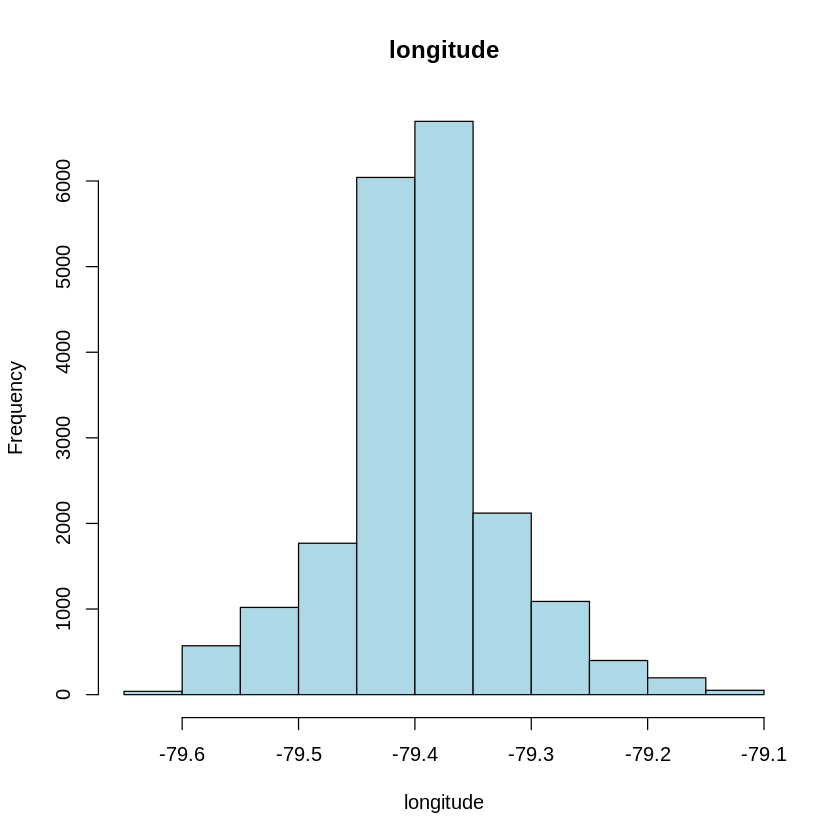

Skipping histogram for column: property_type 
Skipping boxplot for column: property_type 
Skipping histogram for column: room_type 


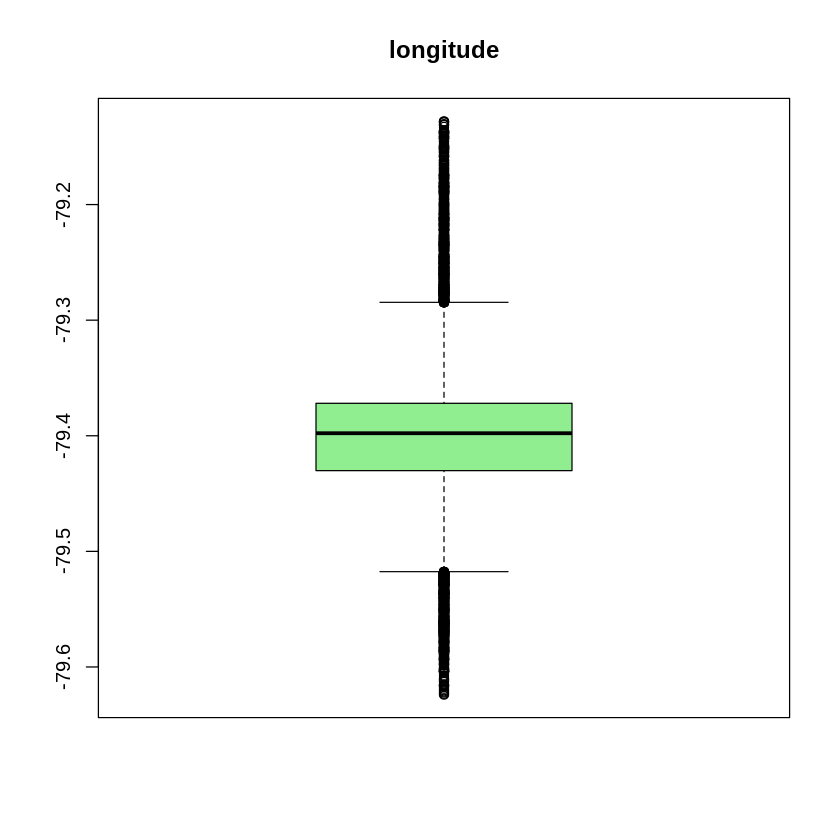

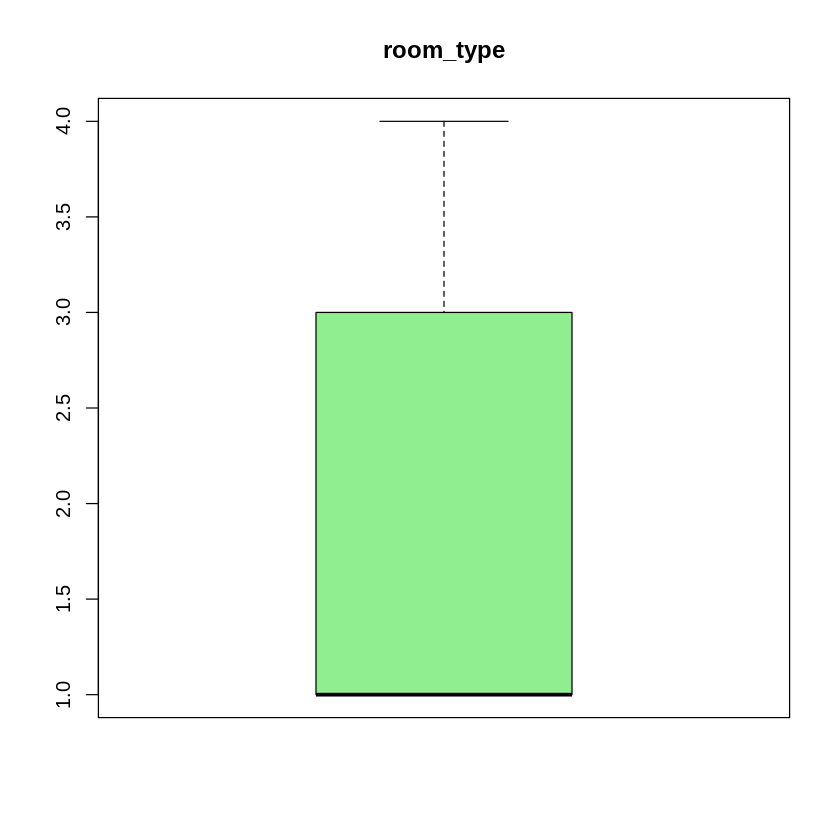

[1] "\n\n"


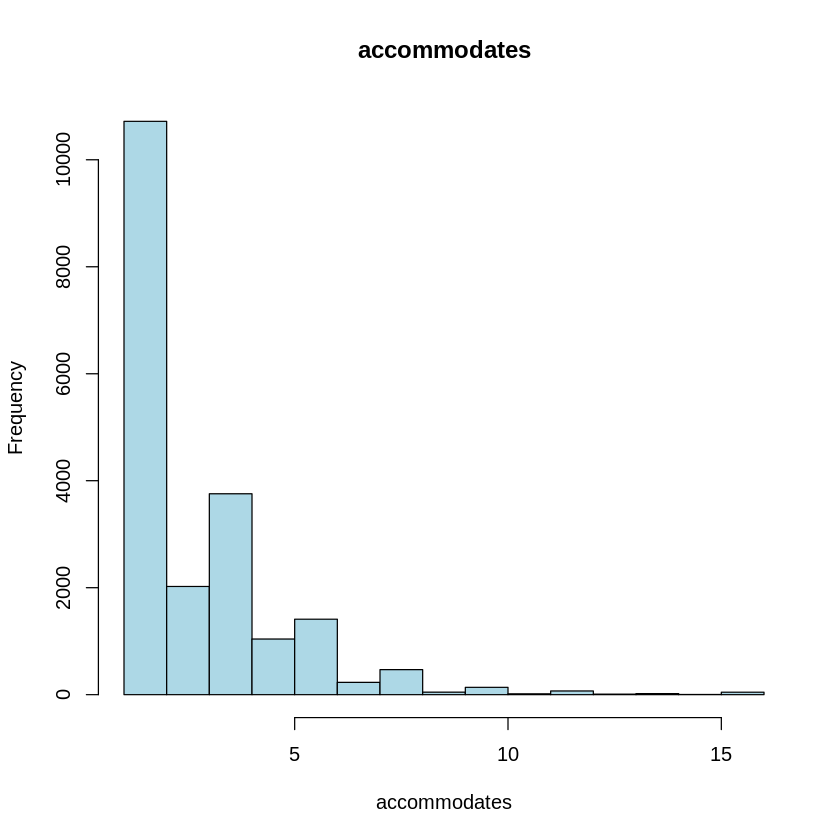

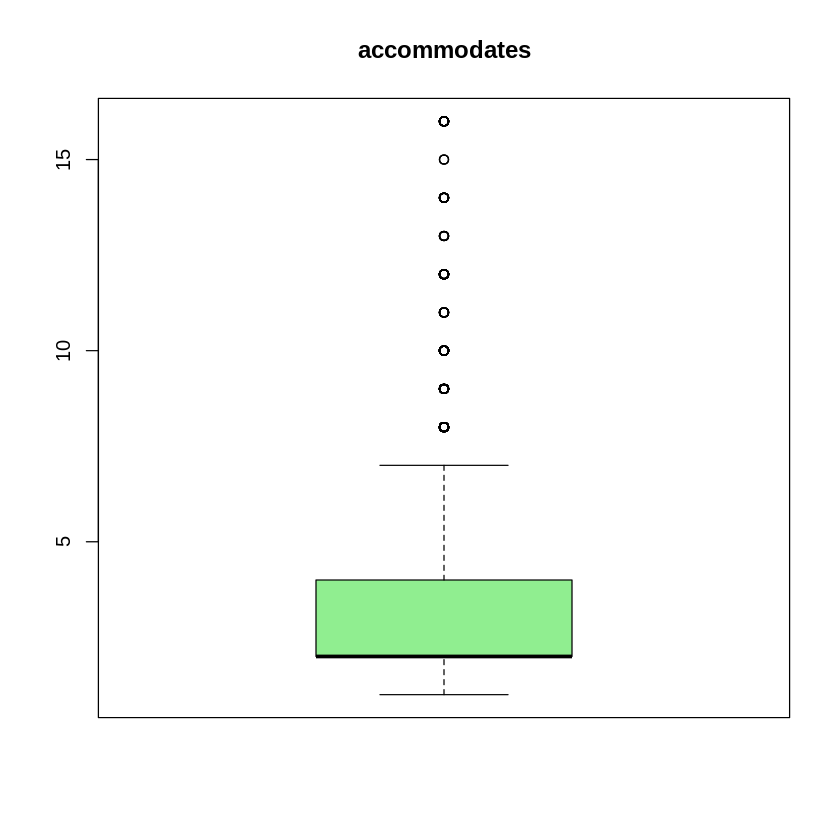

[1] "\n\n"


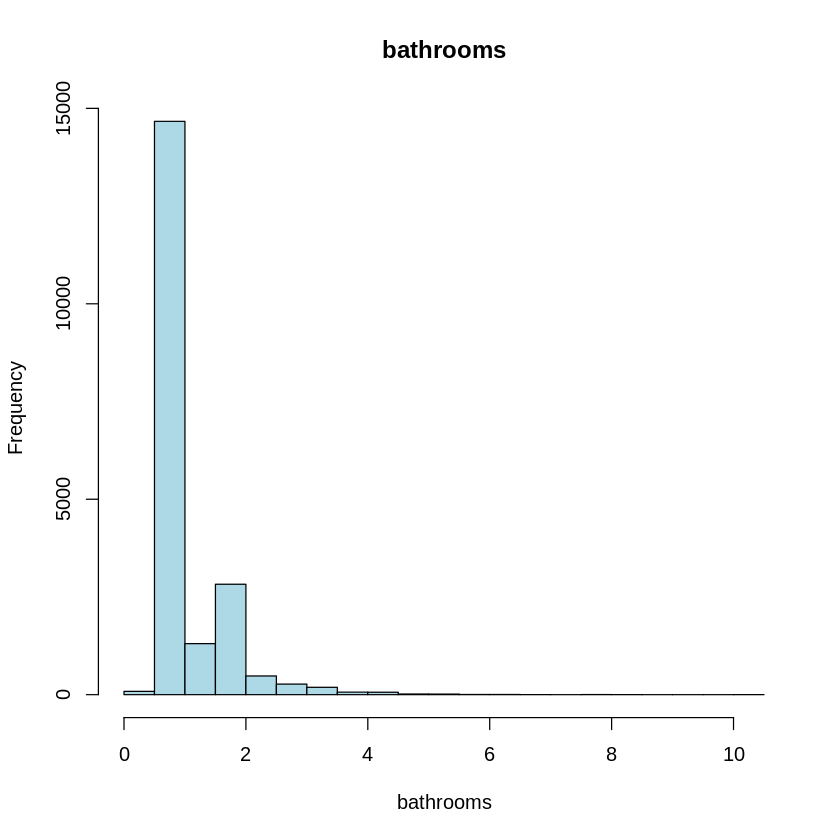

Skipping histogram for column: bathrooms_text 
Skipping boxplot for column: bathrooms_text 


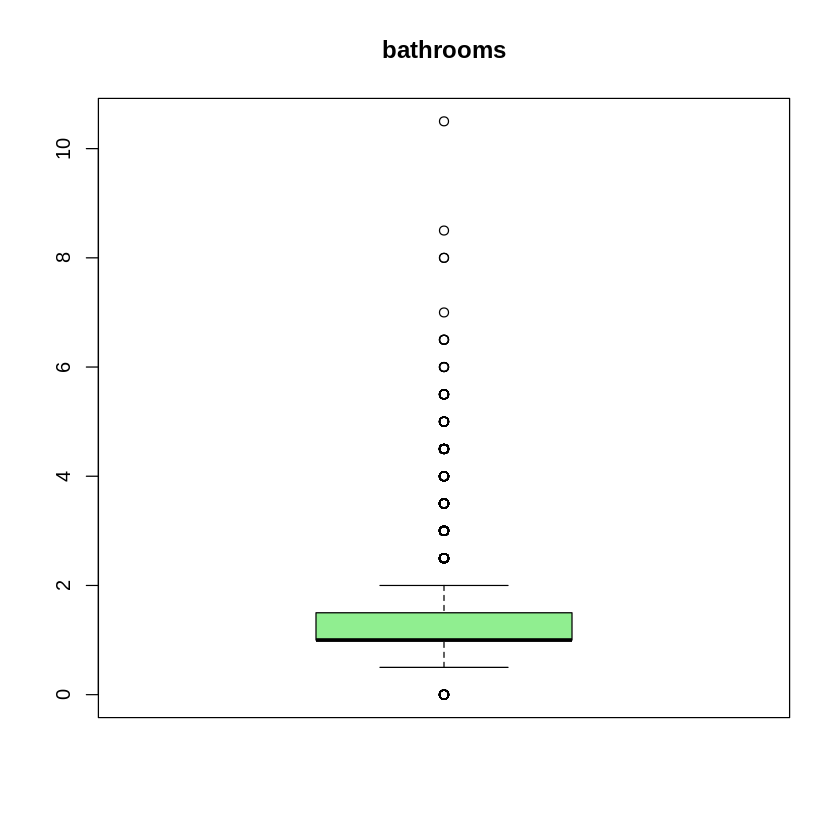

[1] "\n\n"


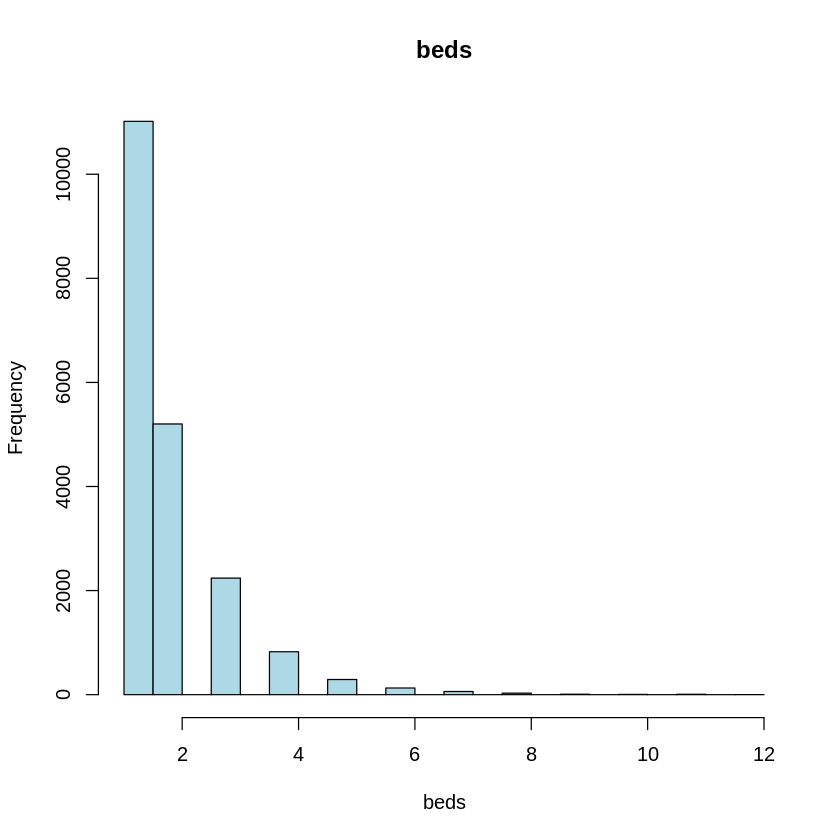

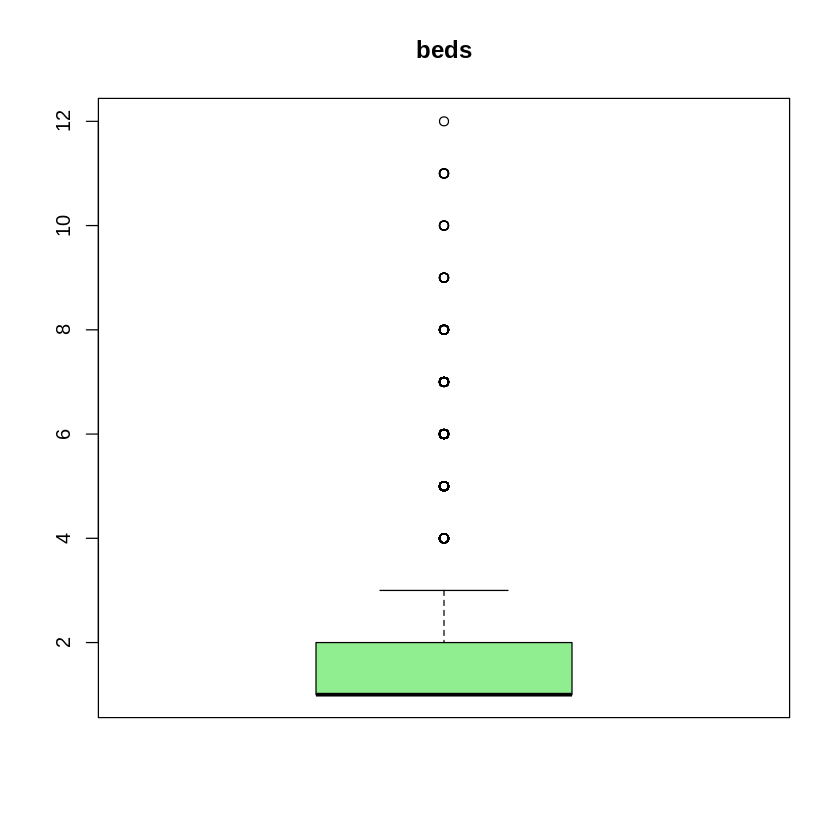

[1] "\n\n"


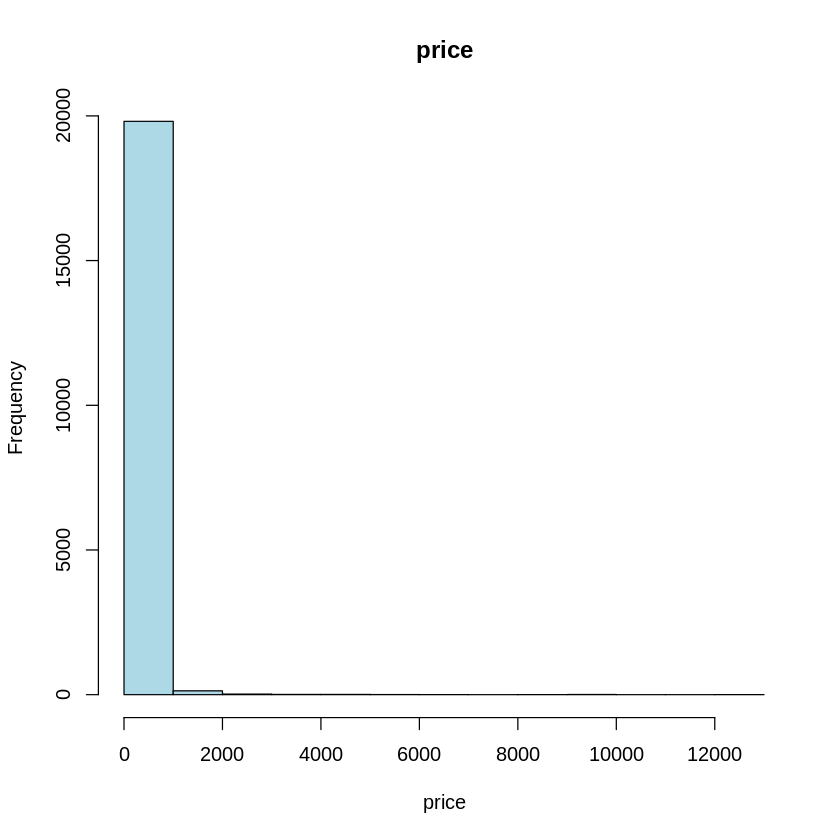

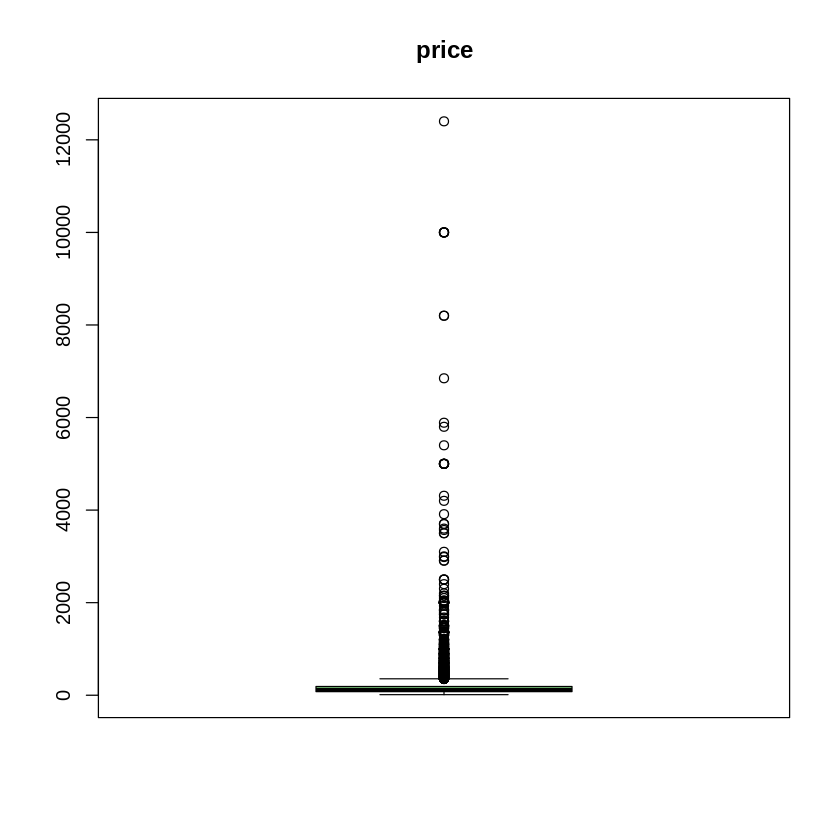

[1] "\n\n"


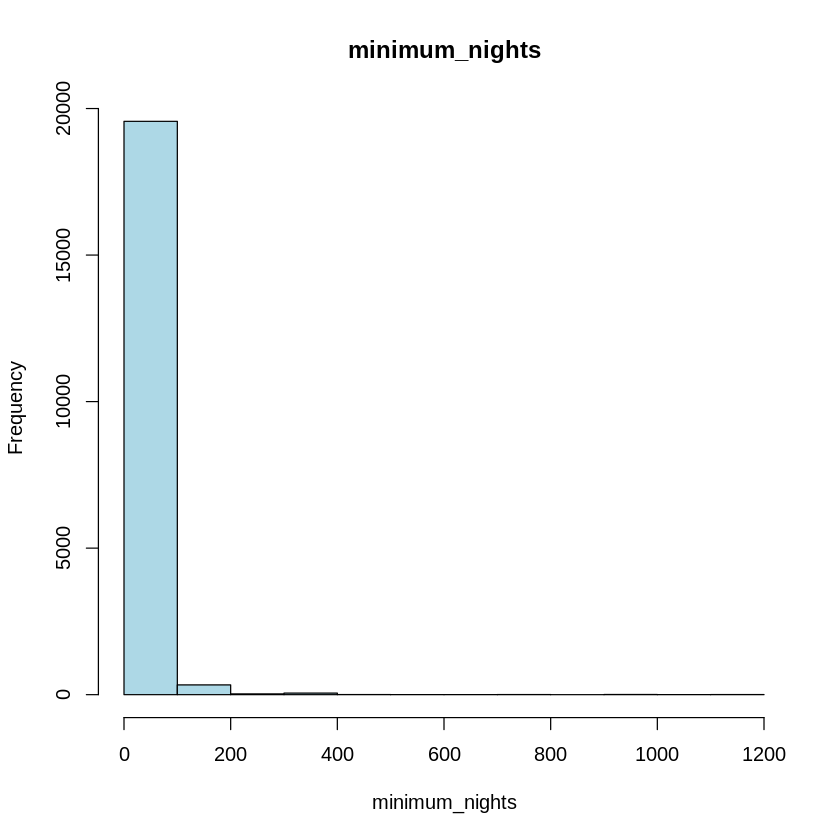

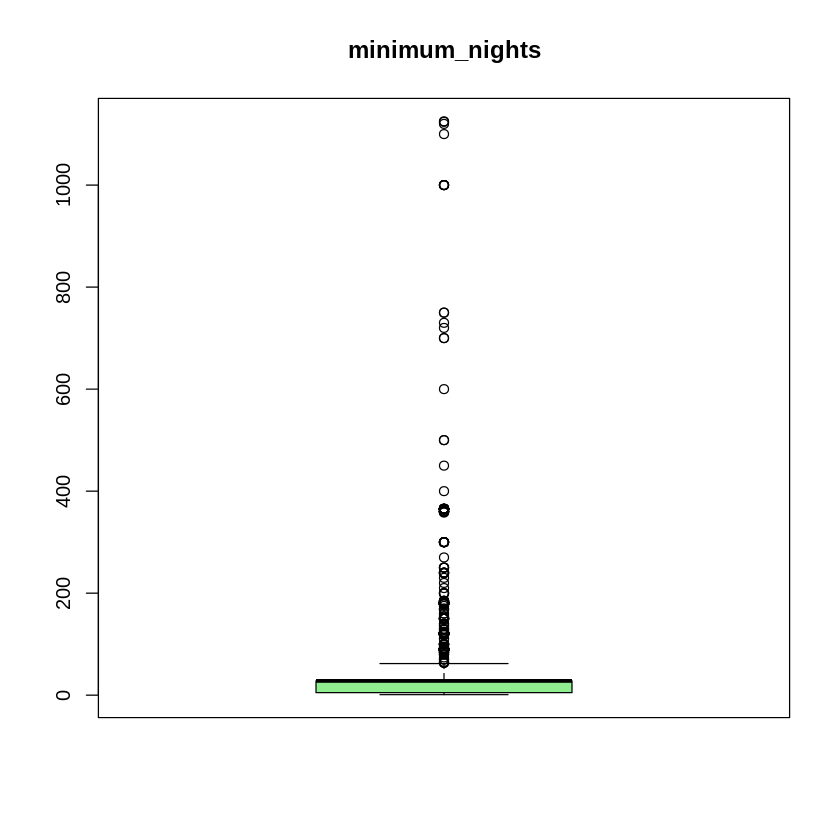

[1] "\n\n"


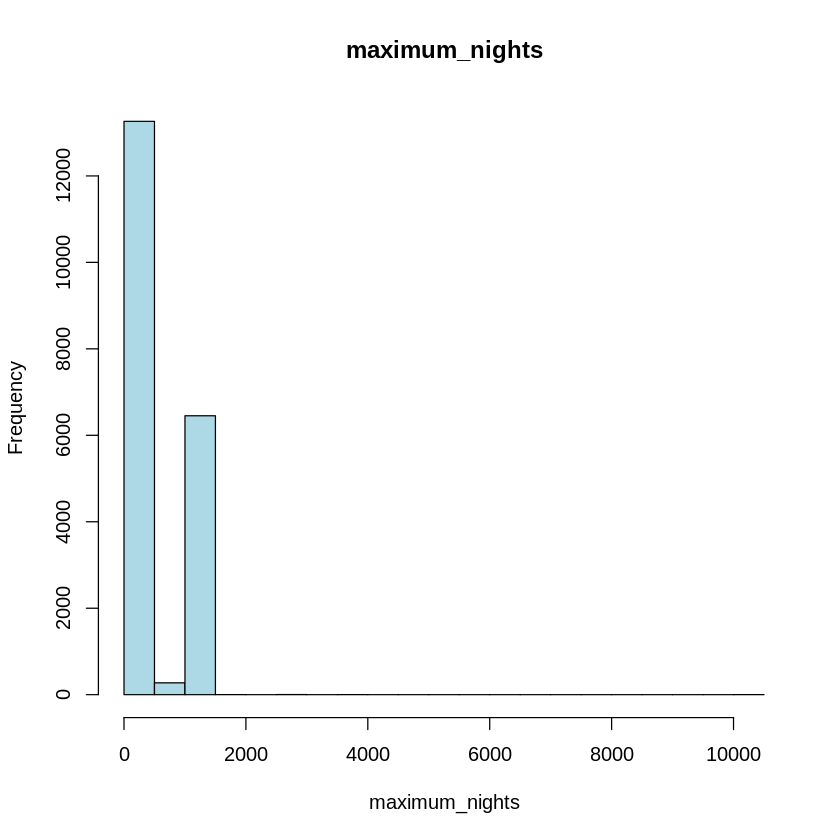

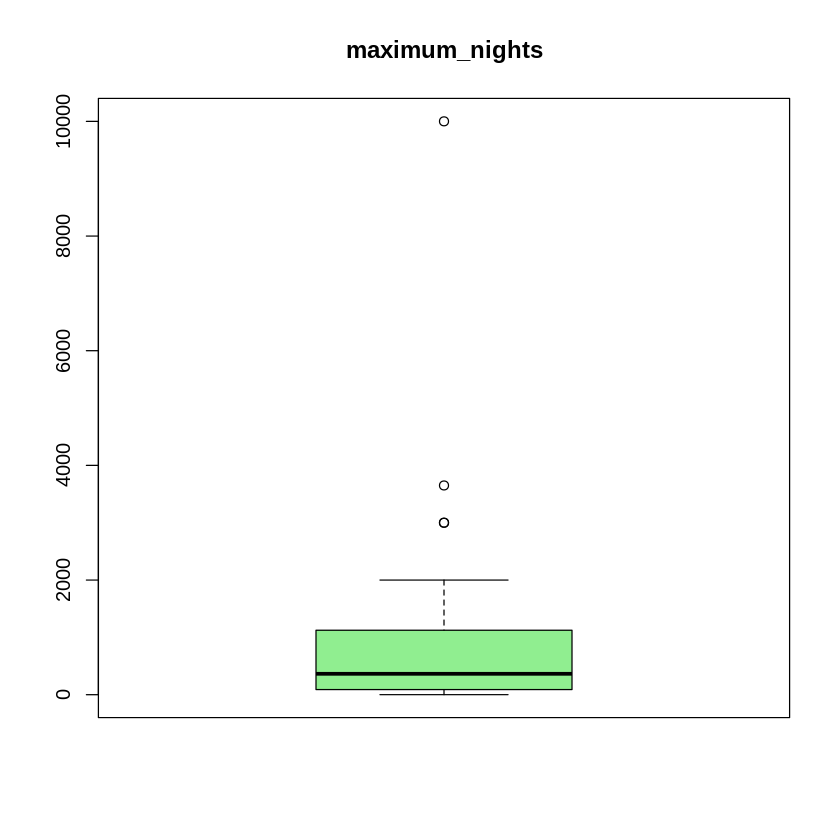

[1] "\n\n"


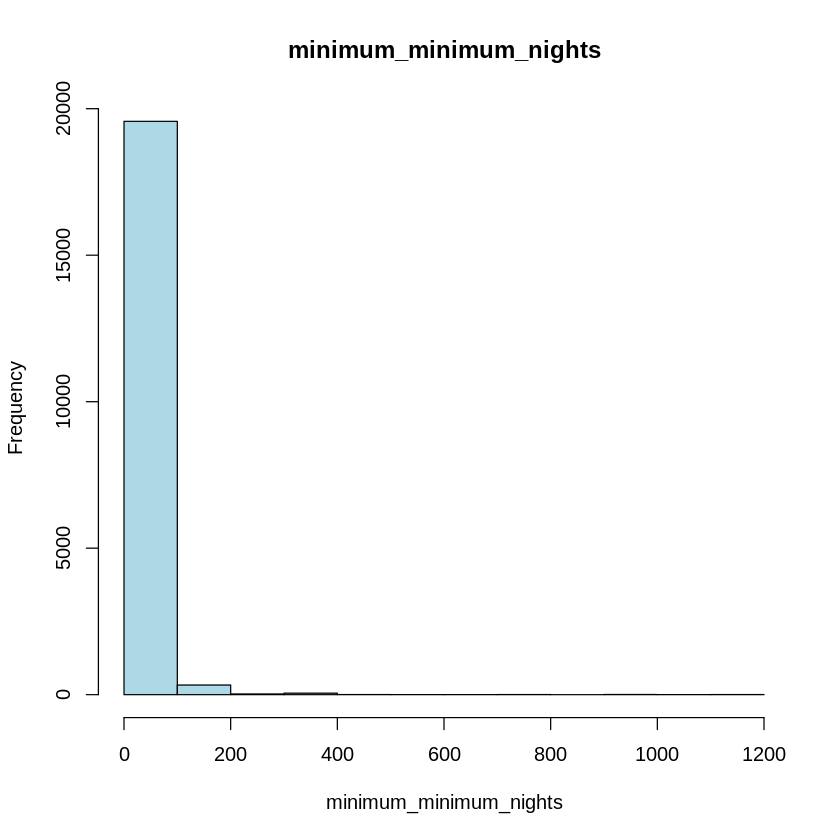

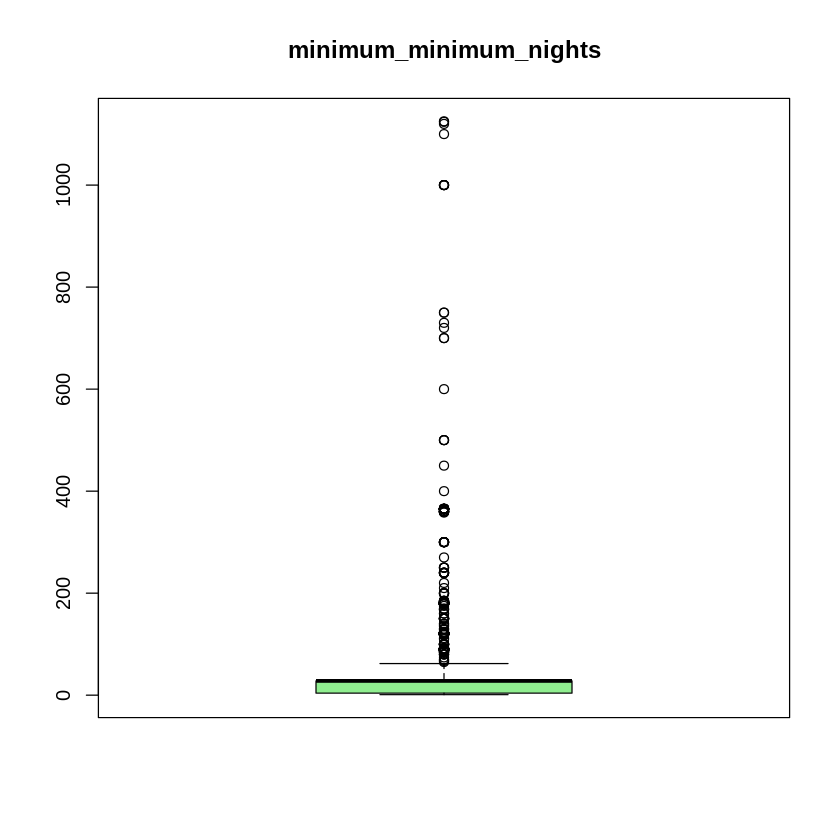

[1] "\n\n"


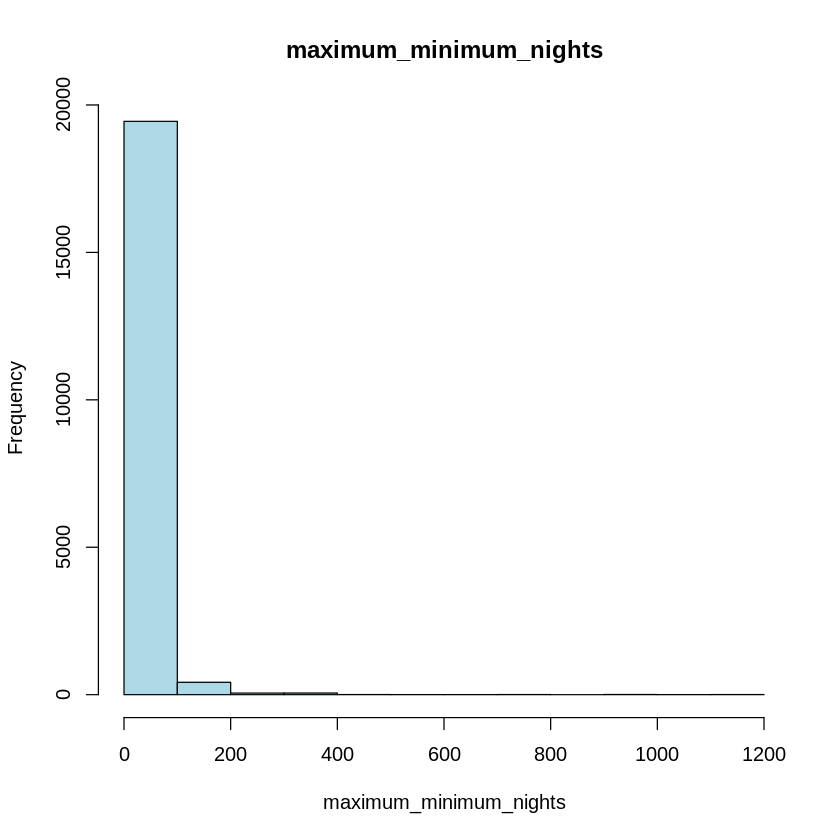

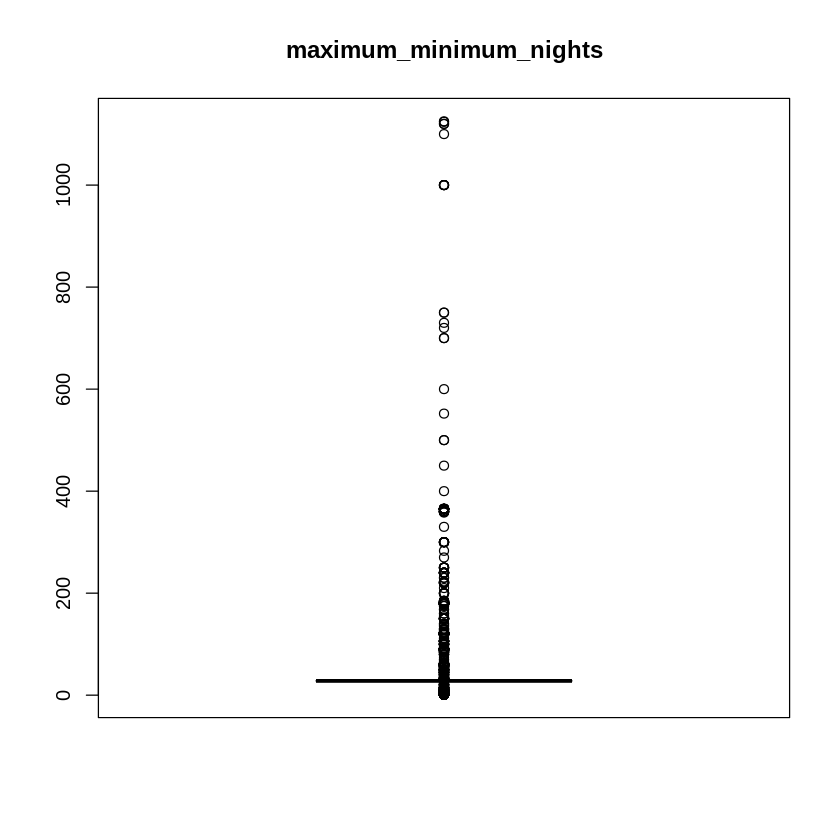

[1] "\n\n"


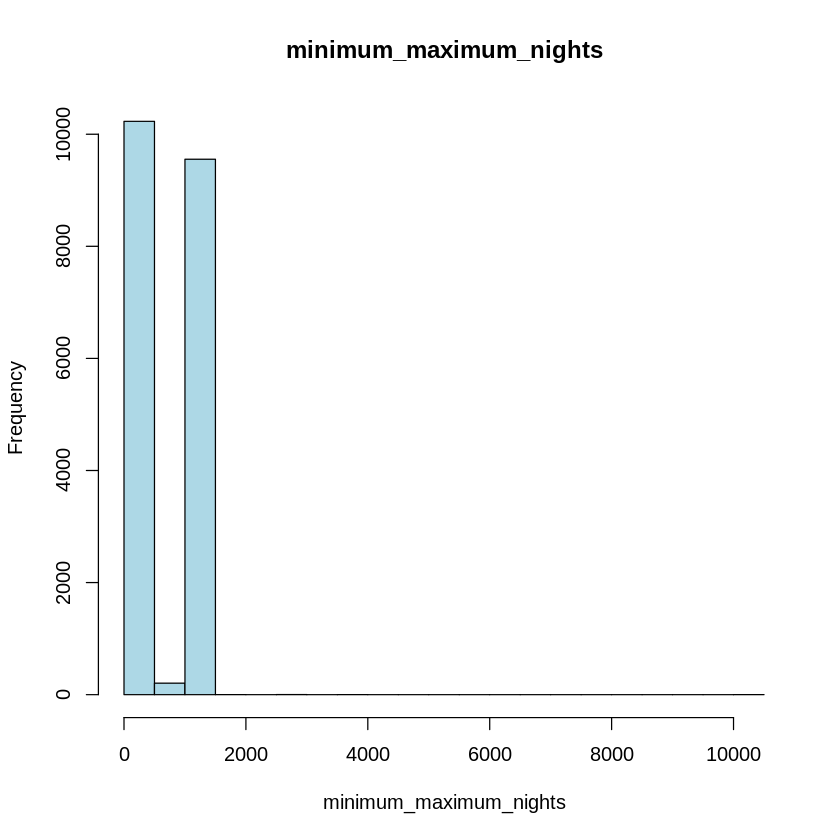

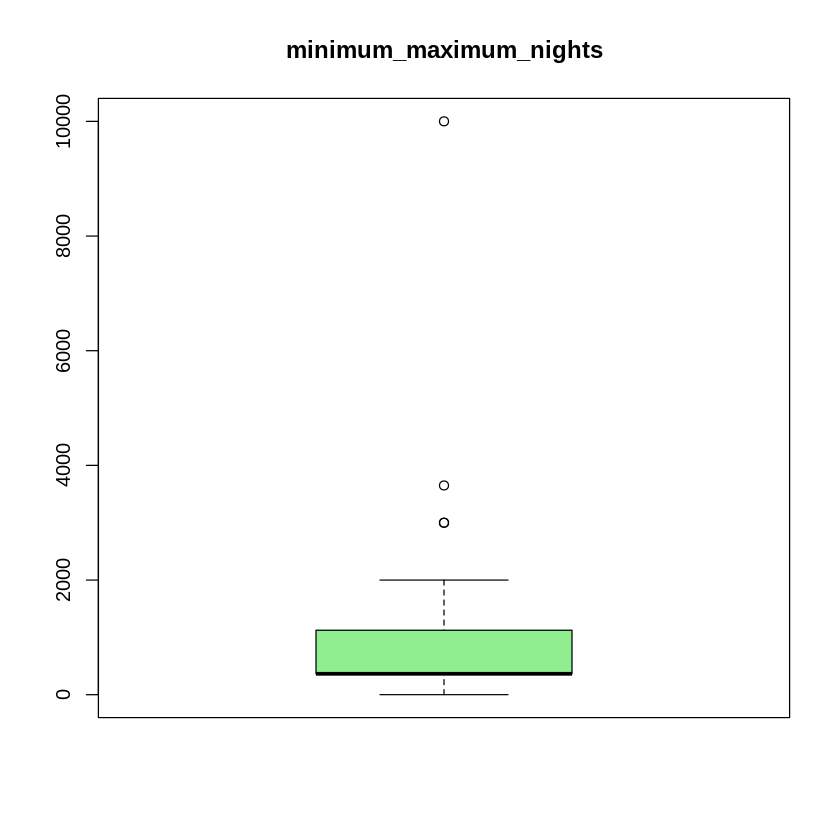

[1] "\n\n"


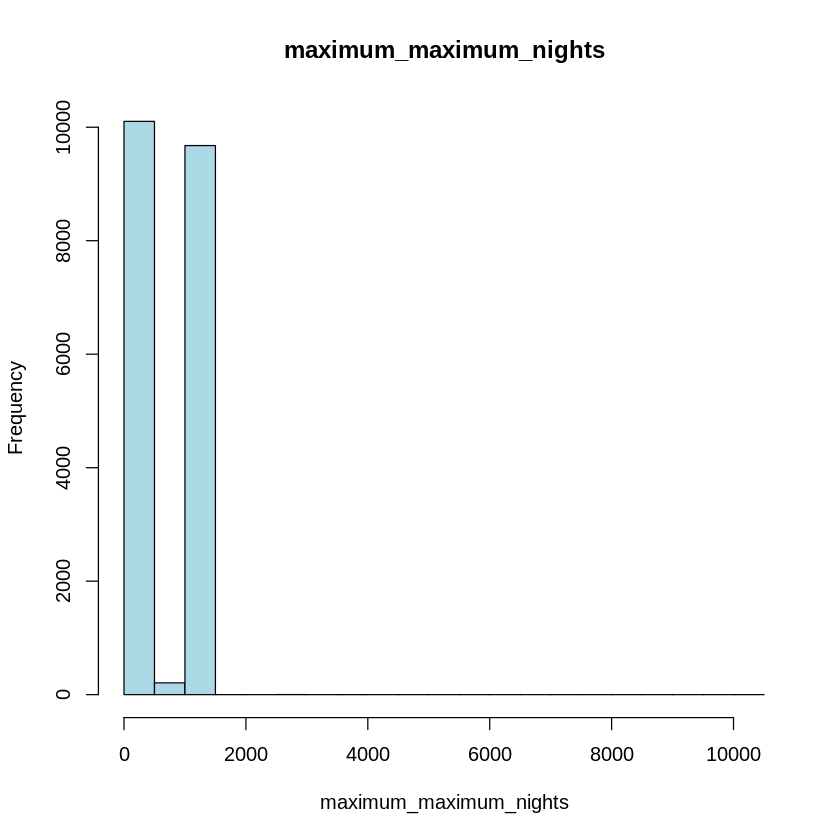

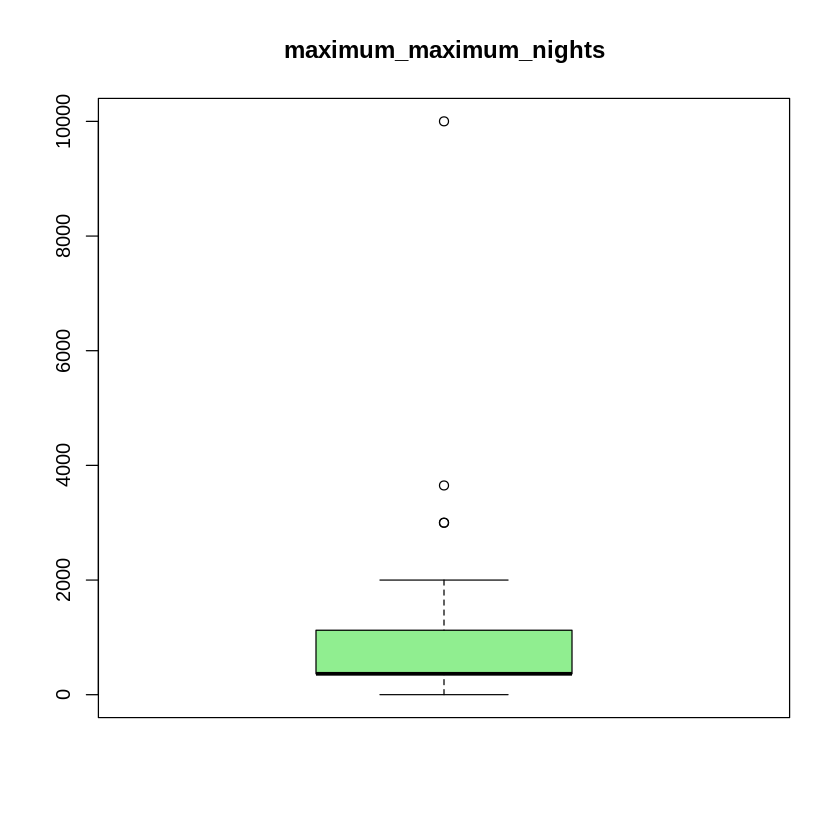

[1] "\n\n"


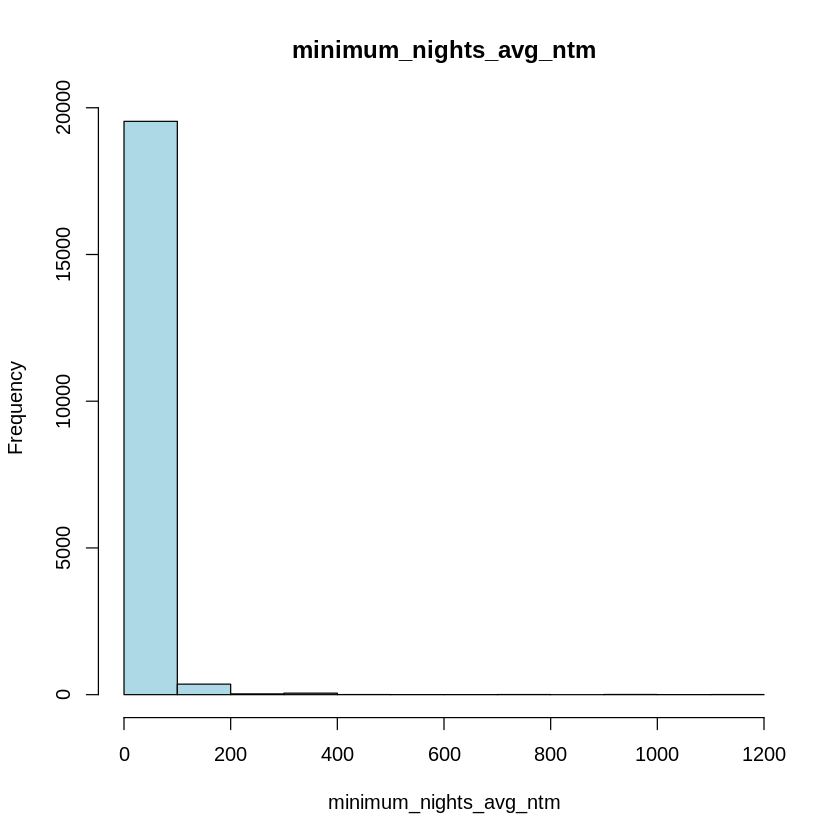

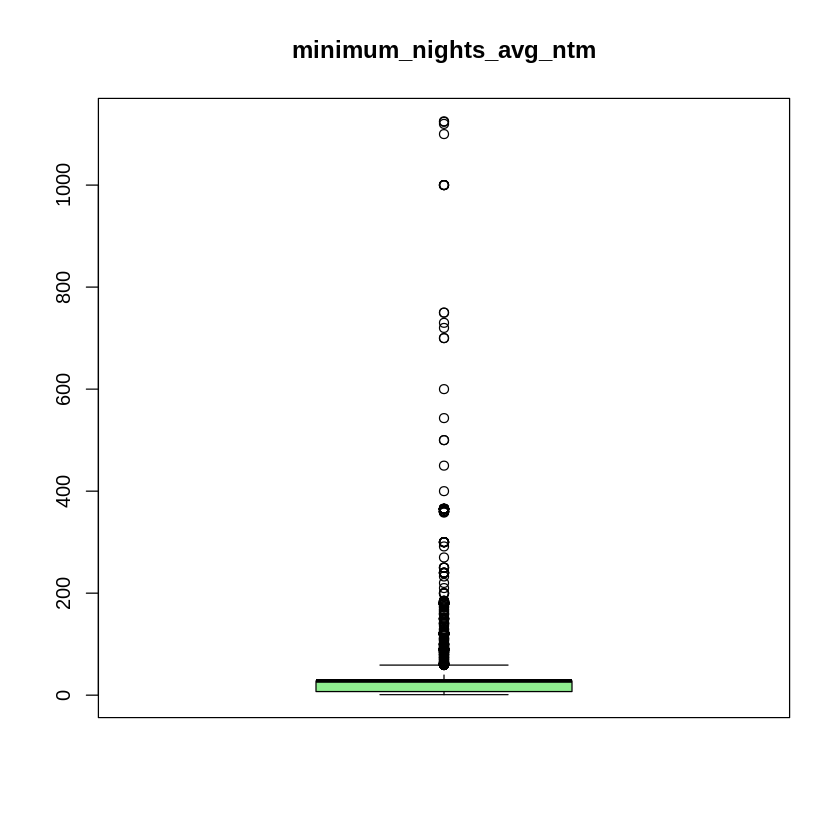

[1] "\n\n"


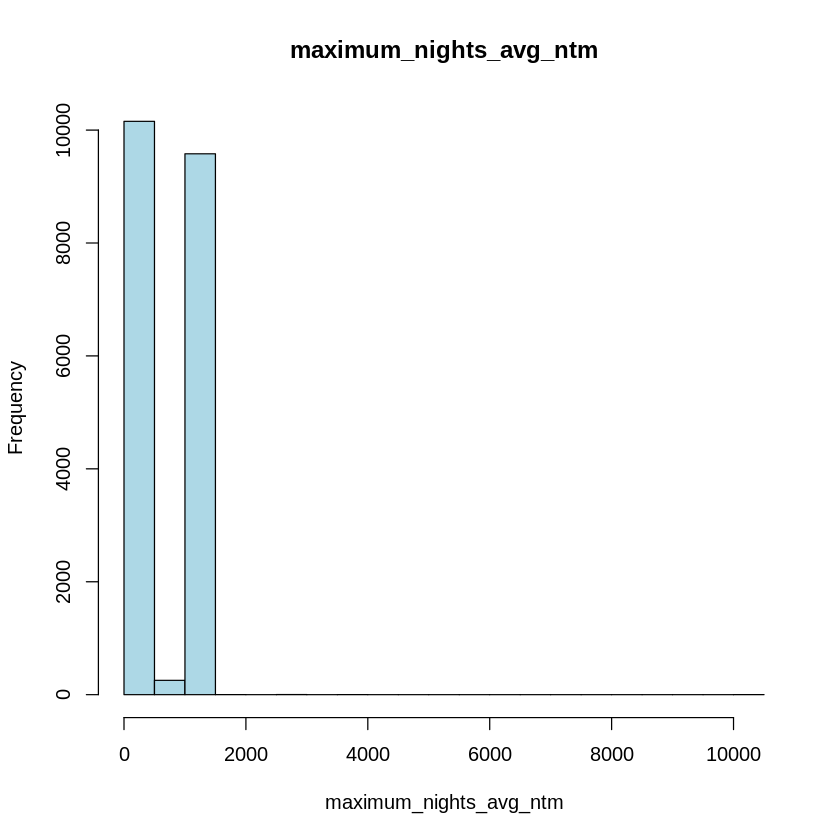

Skipping histogram for column: has_availability 


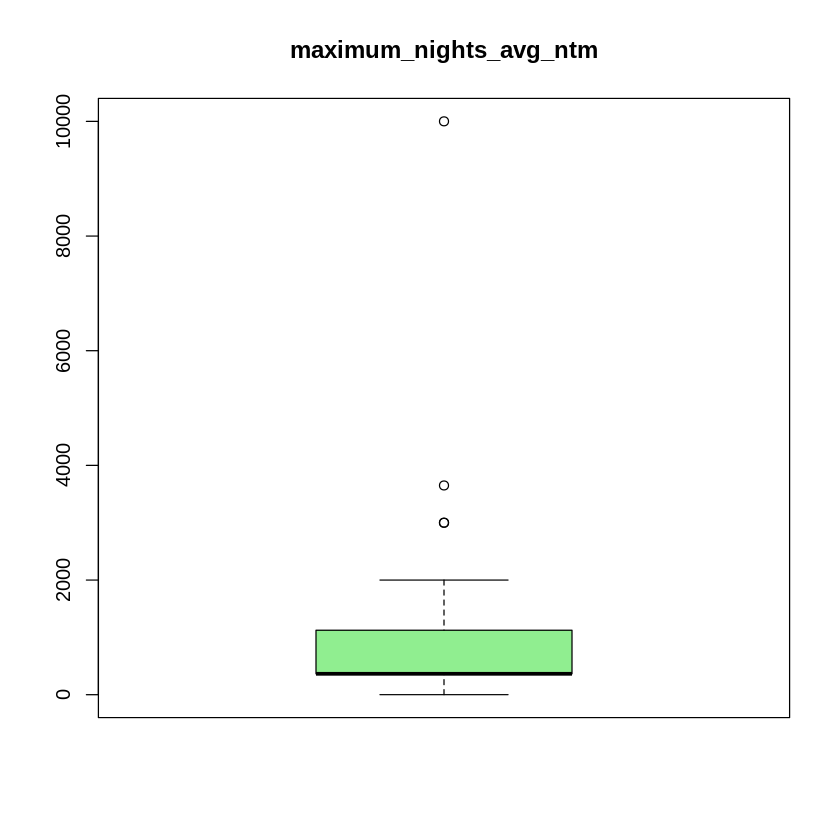

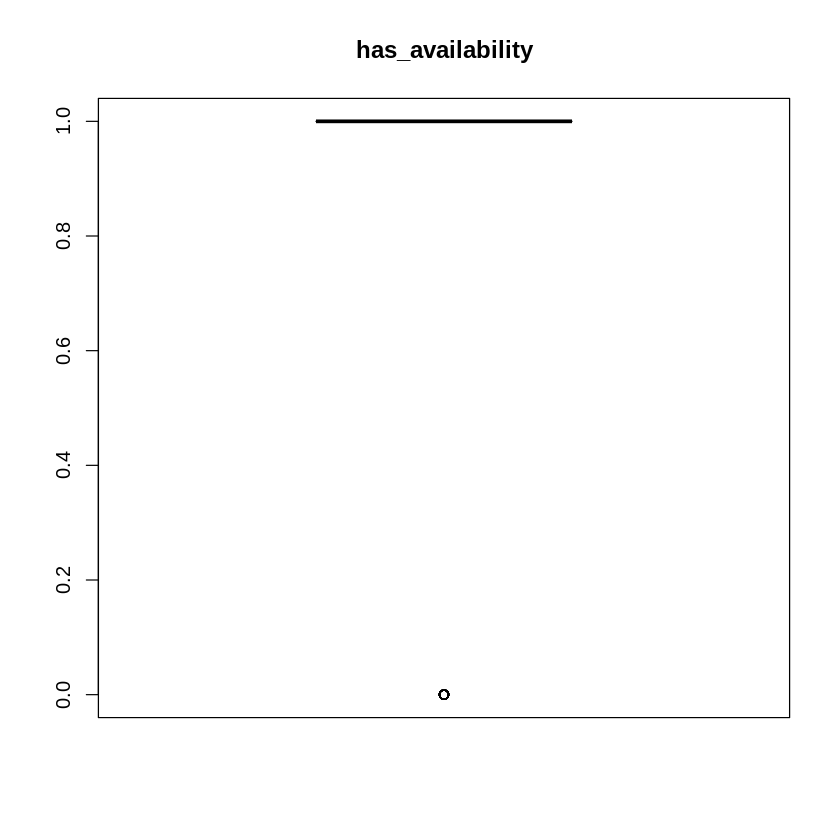

[1] "\n\n"


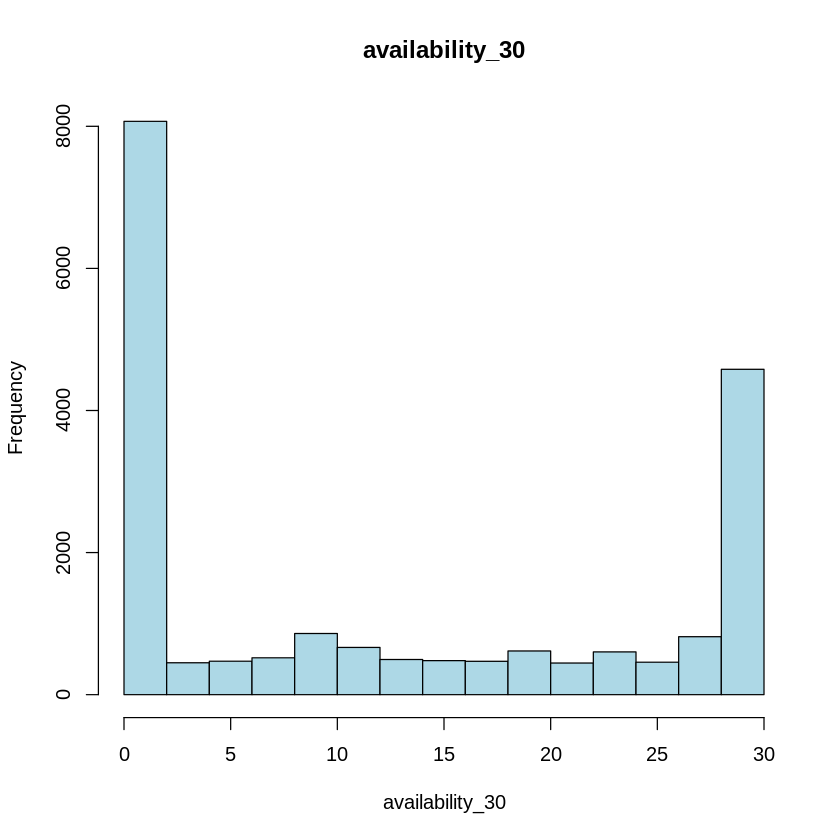

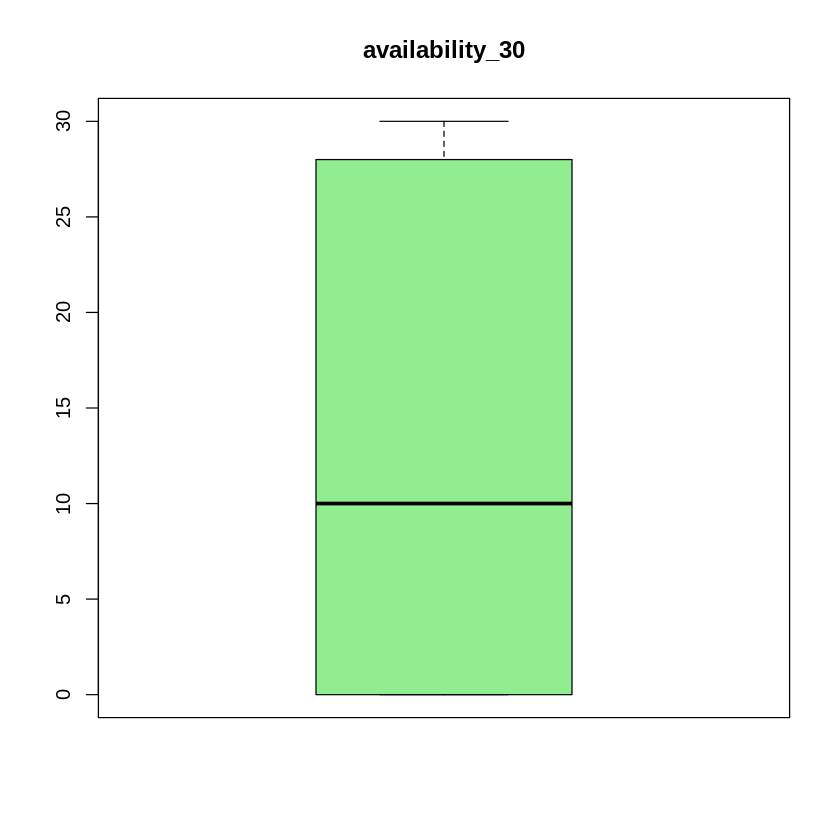

[1] "\n\n"


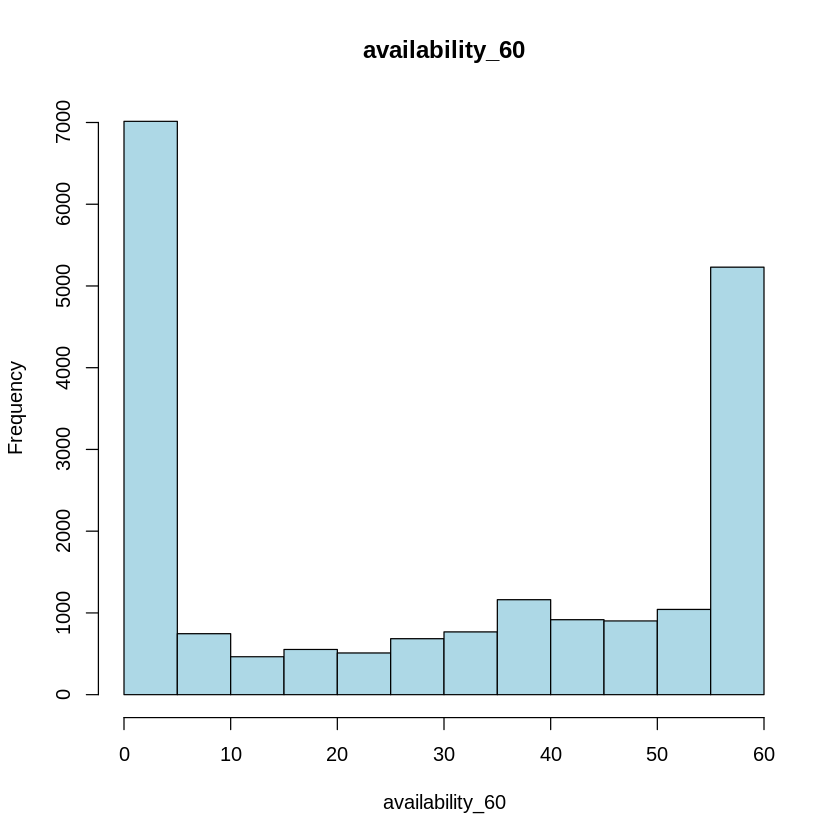

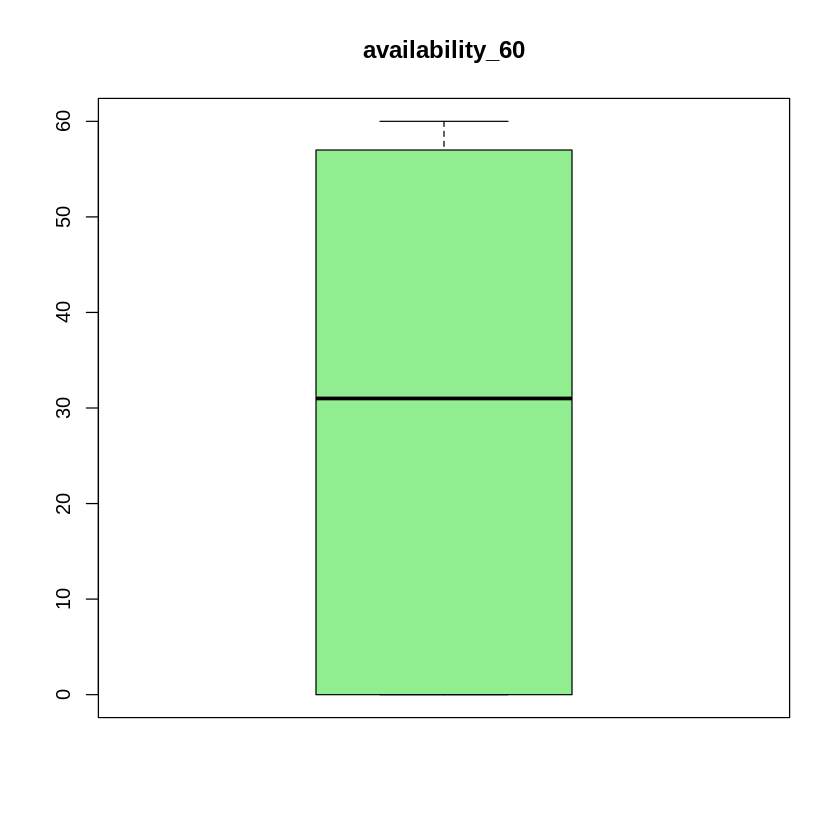

[1] "\n\n"


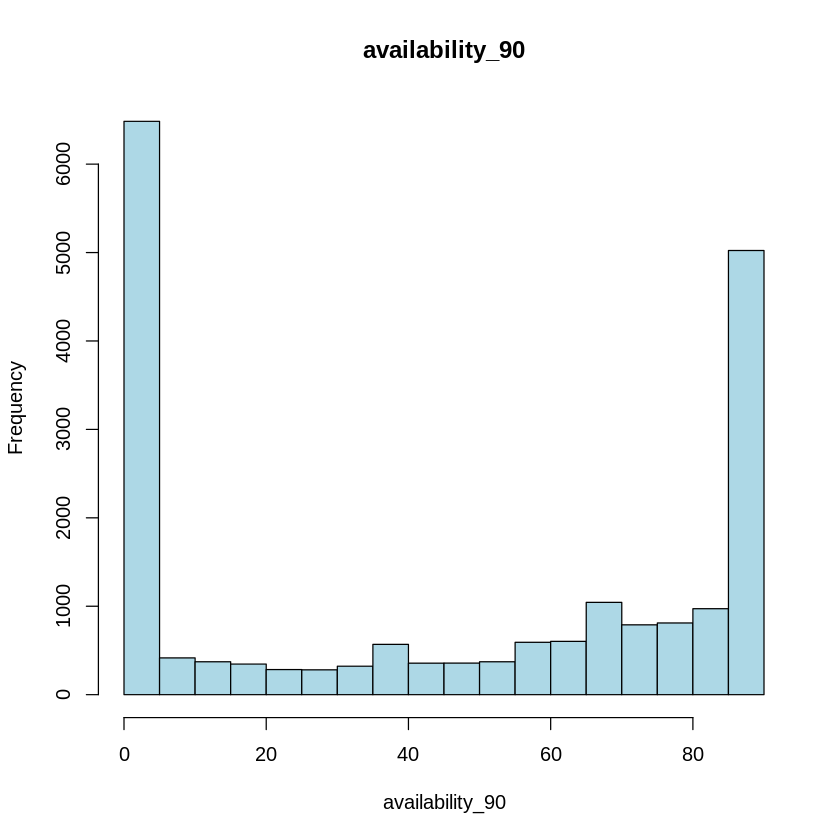

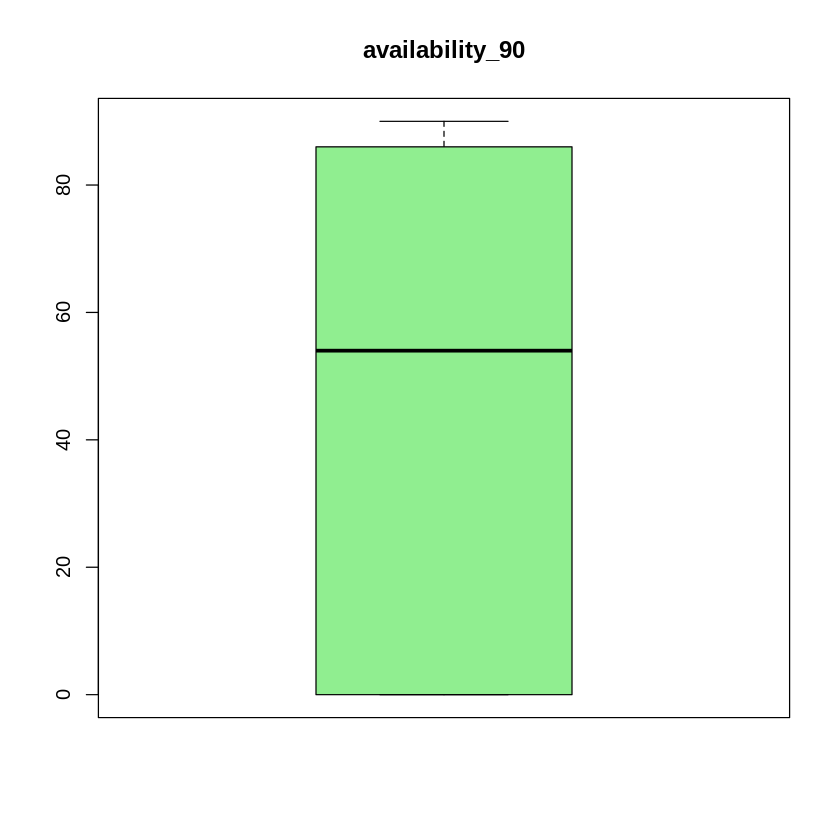

[1] "\n\n"


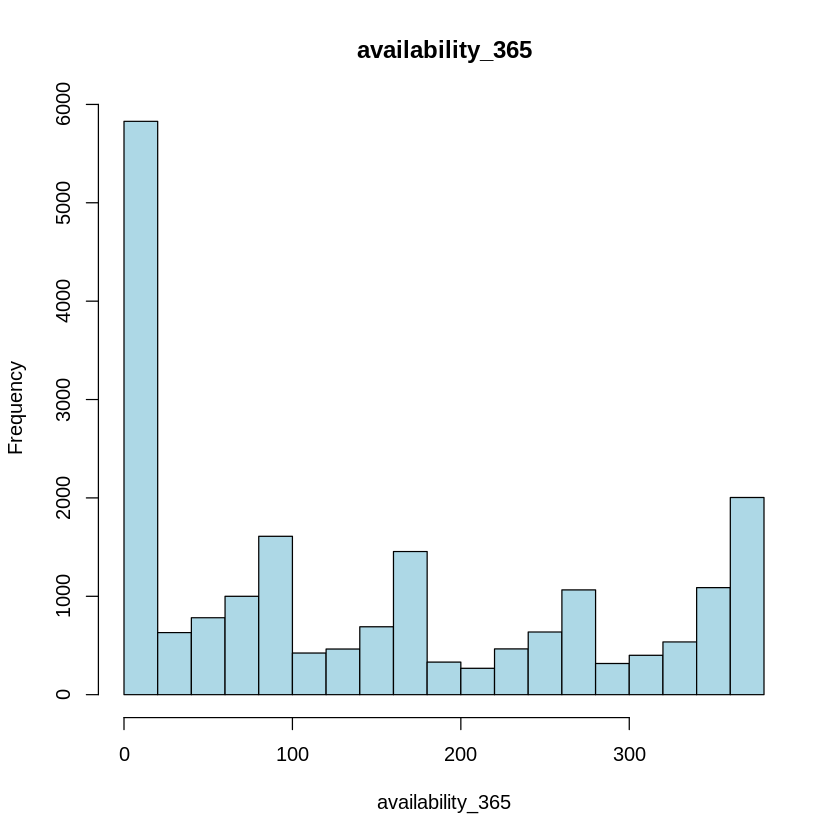

Skipping histogram for column: calendar_last_scraped 
Skipping boxplot for column: calendar_last_scraped 


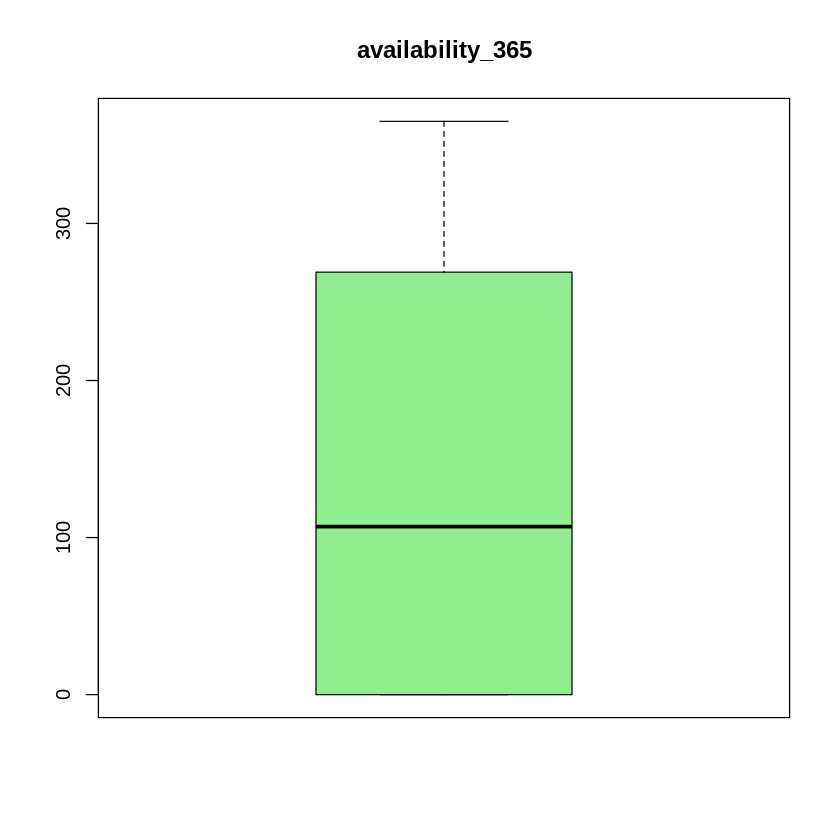

[1] "\n\n"


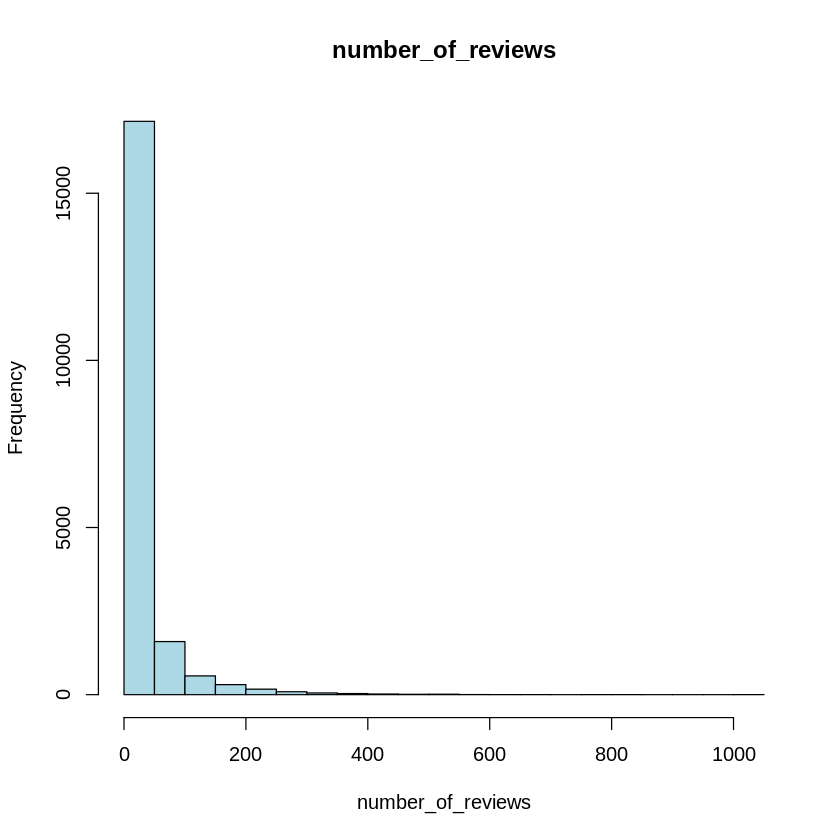

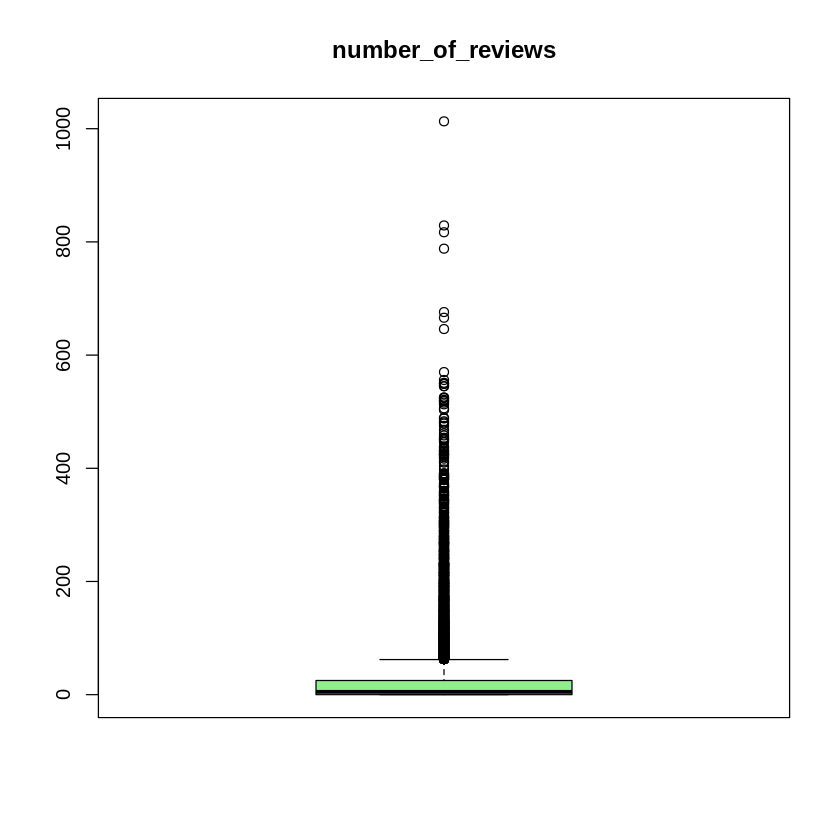

[1] "\n\n"


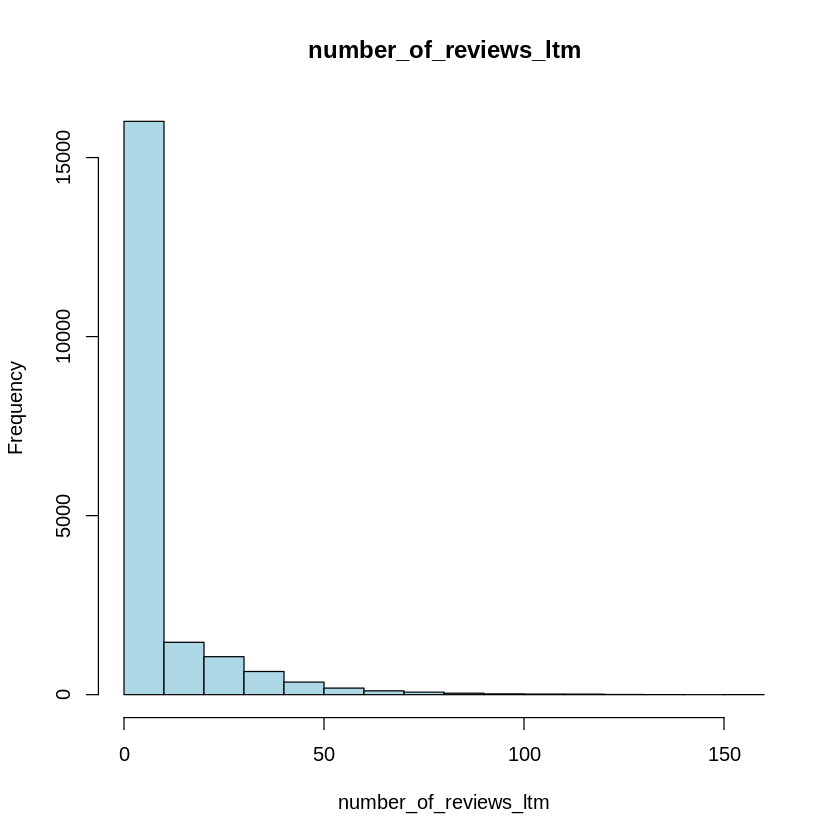

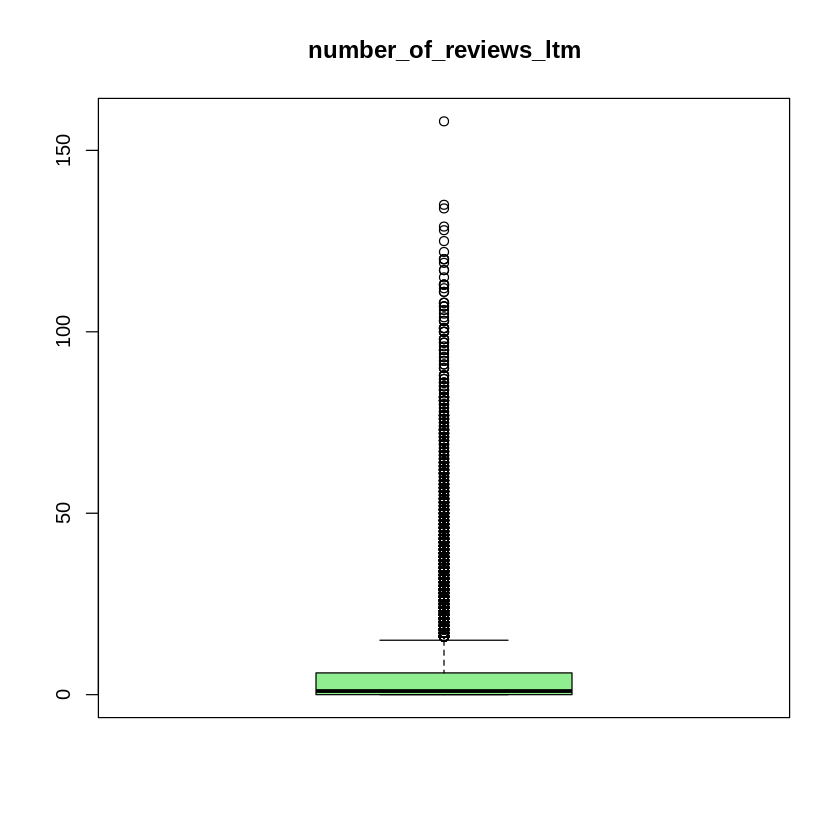

[1] "\n\n"


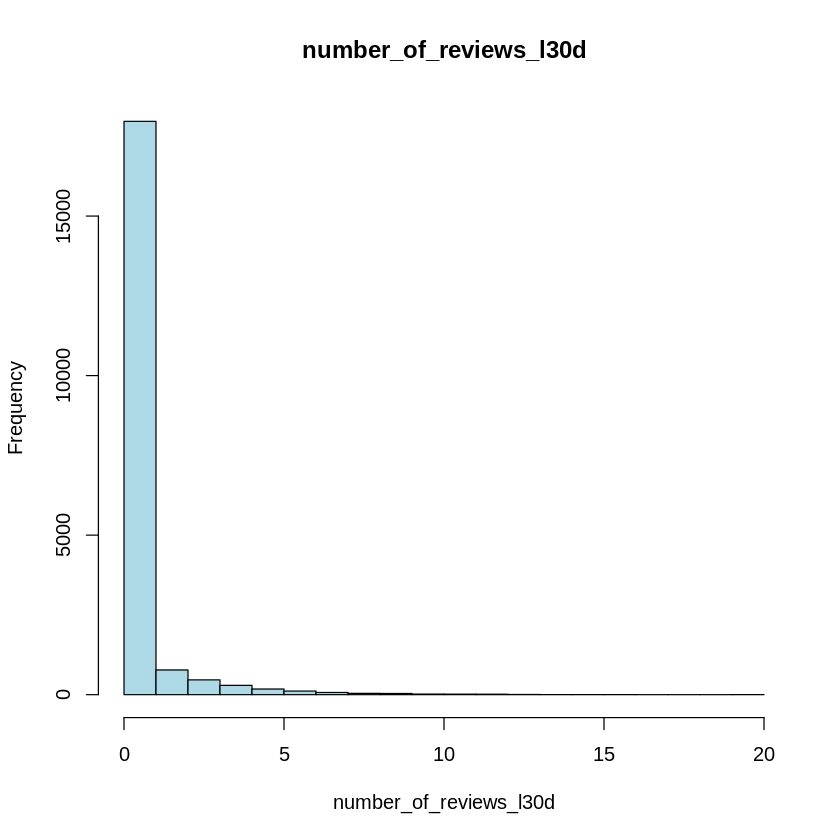

Skipping histogram for column: first_review 


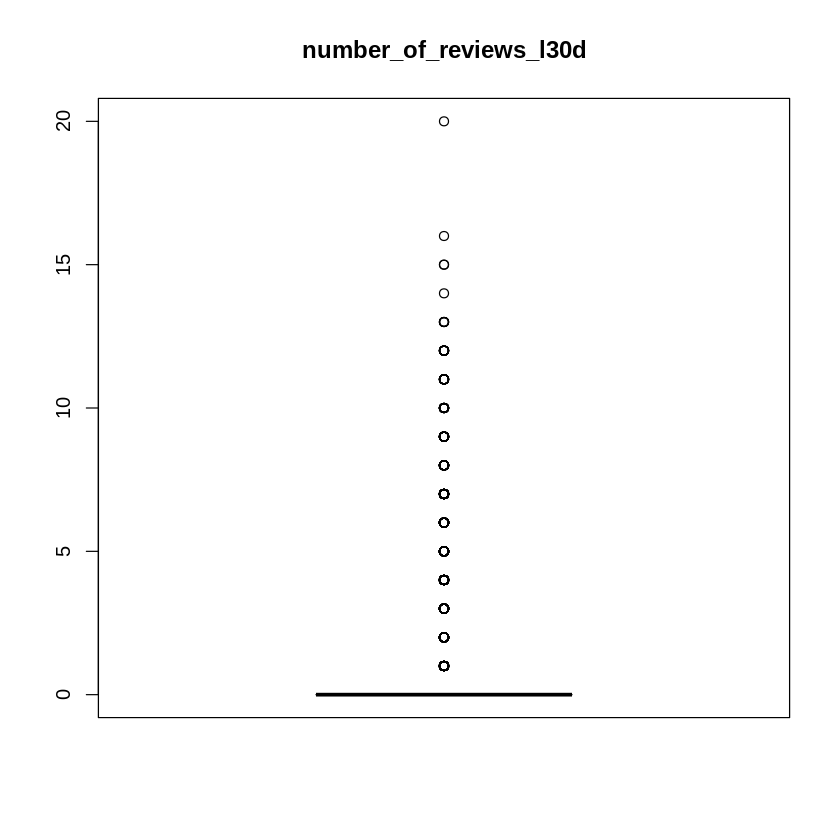

Skipping histogram for column: last_review 


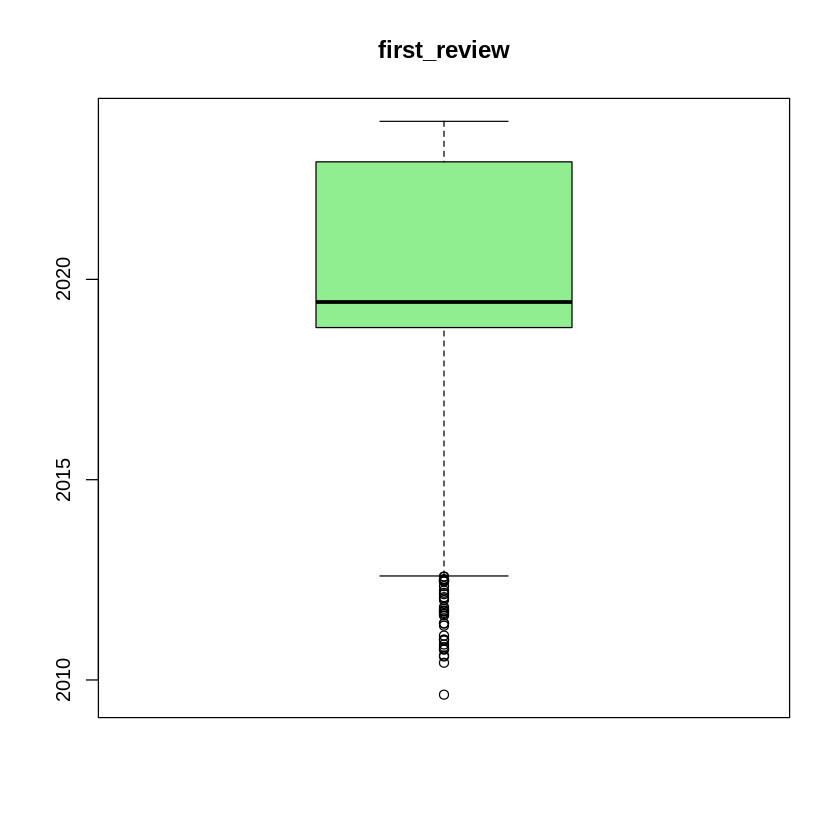

Skipping histogram for column: review_scores_rating 
Skipping boxplot for column: review_scores_rating 


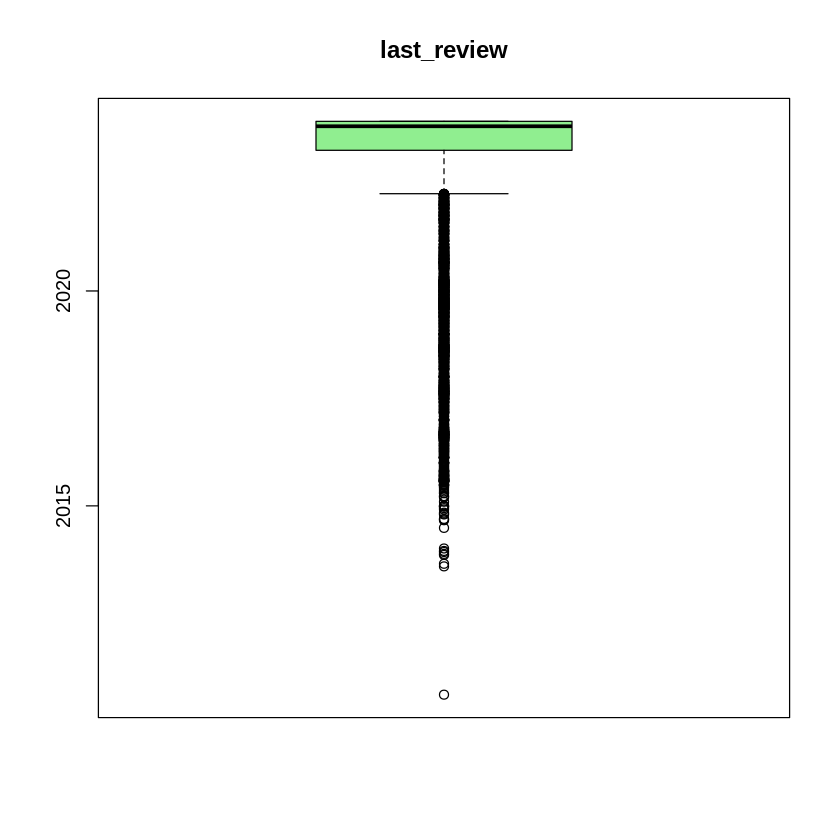

[1] "\n\n"


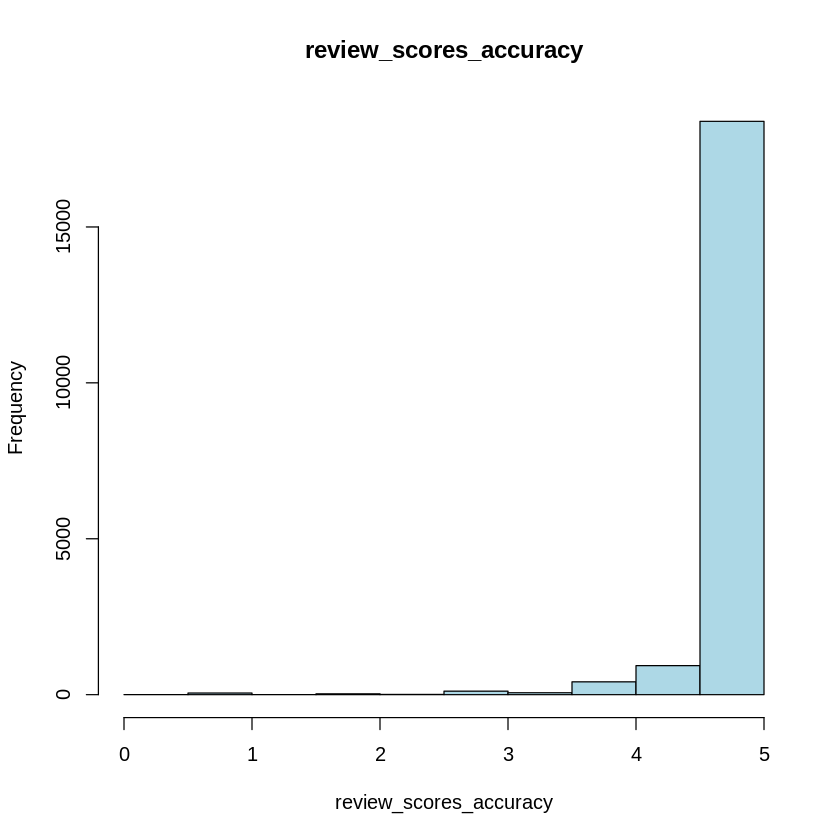

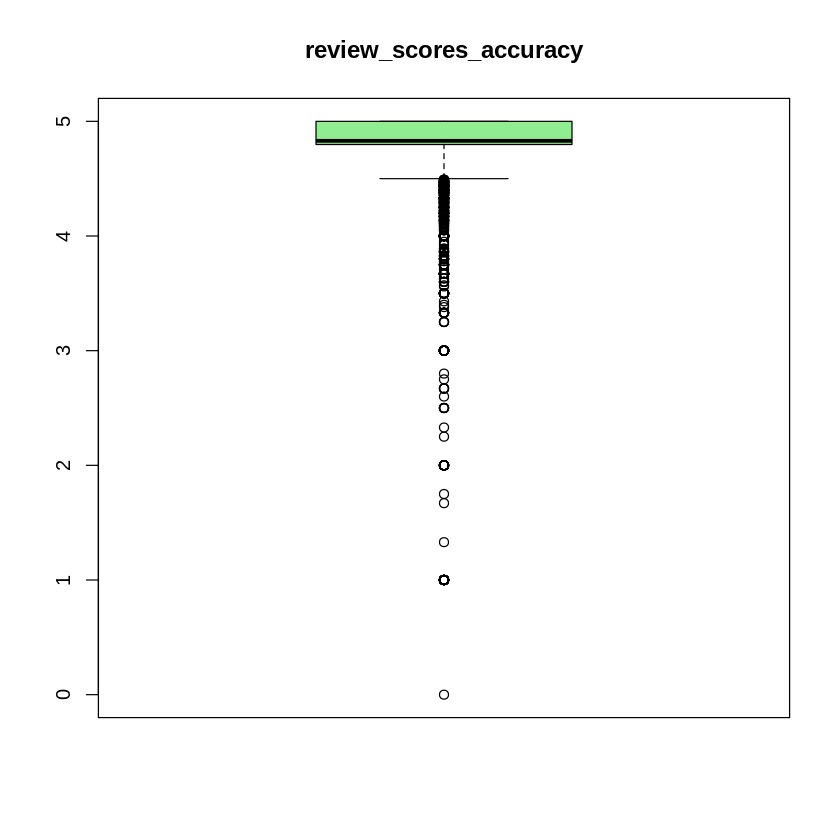

[1] "\n\n"


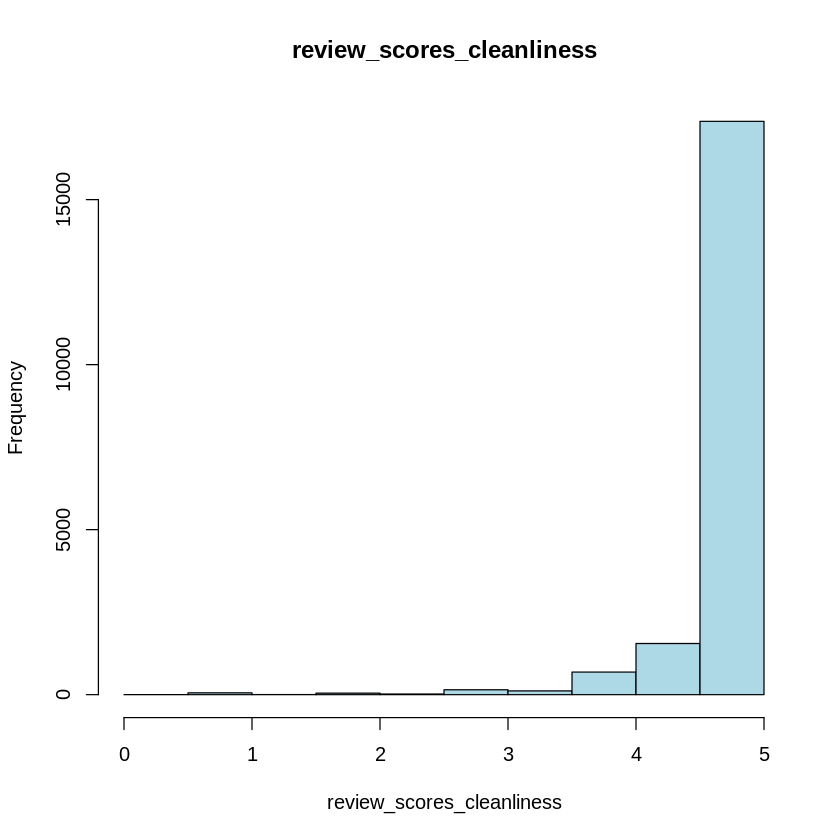

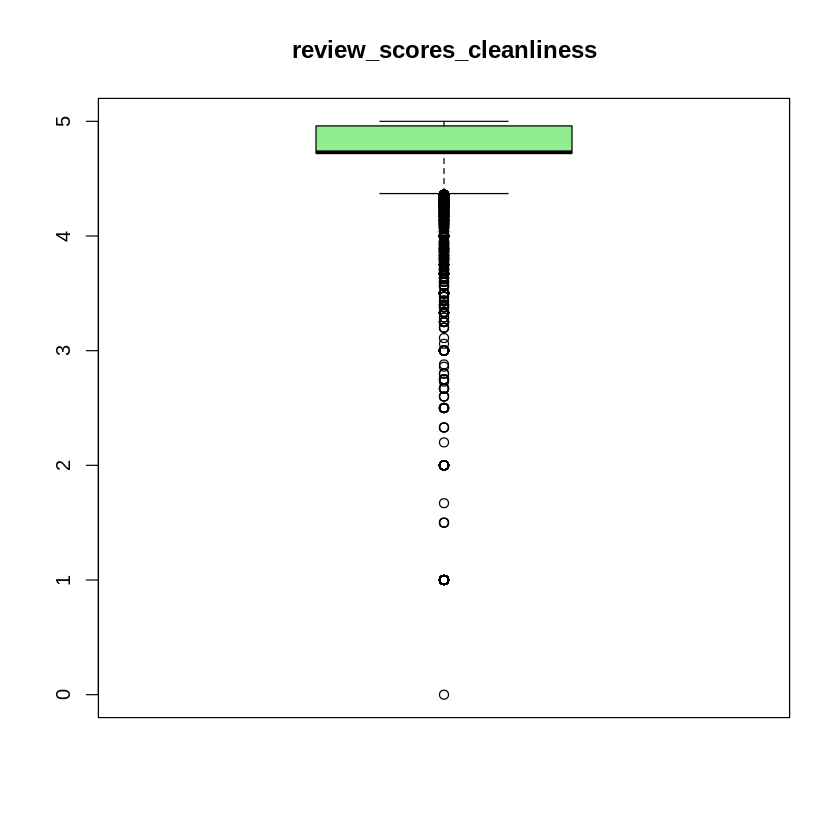

[1] "\n\n"


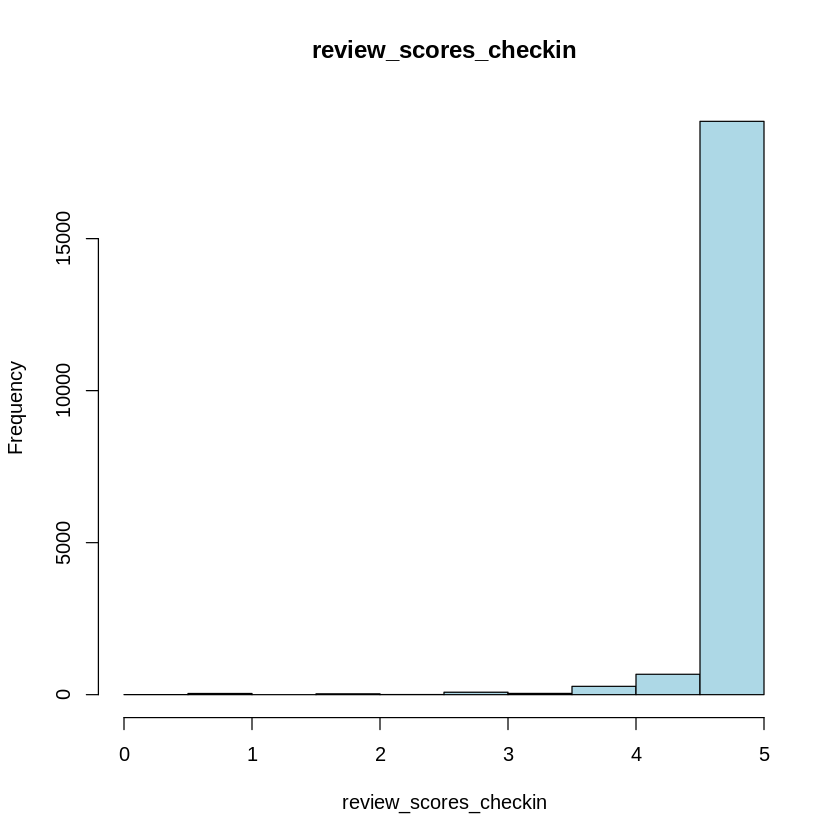

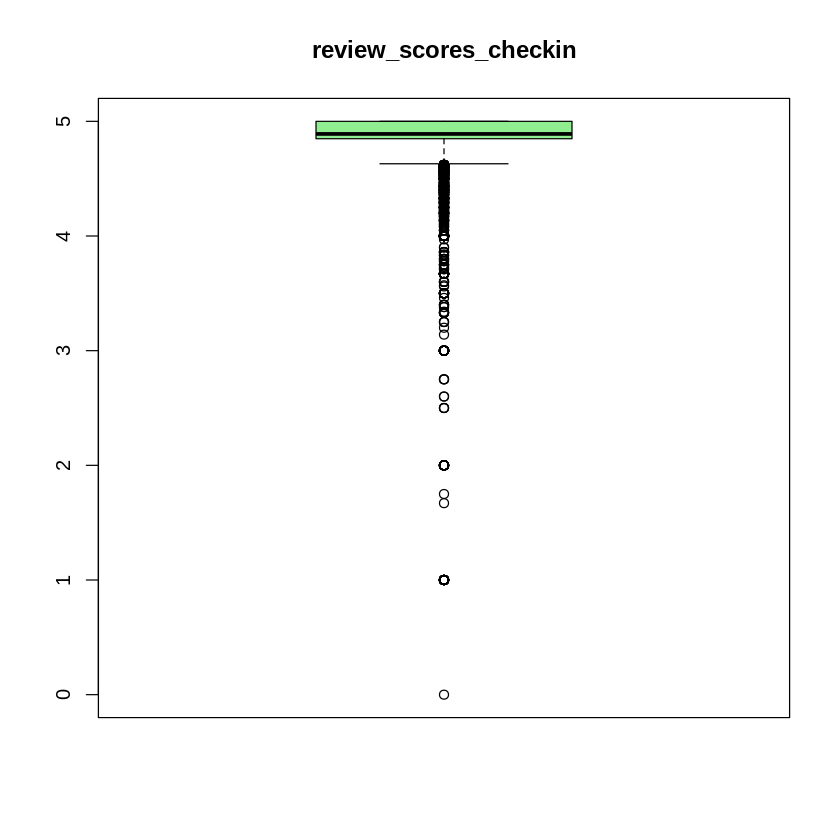

[1] "\n\n"


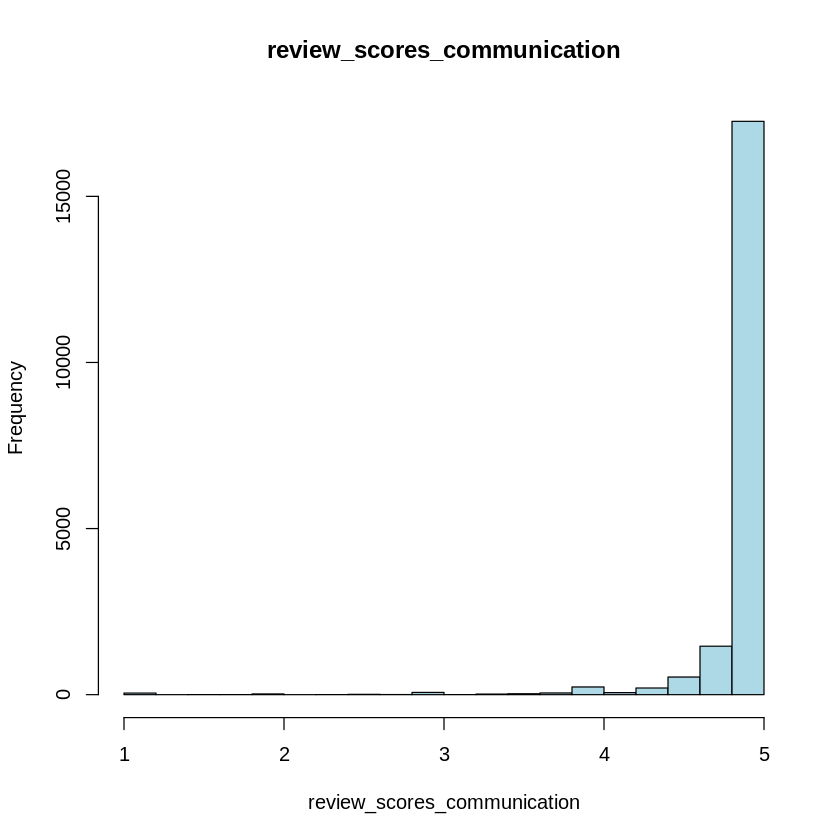

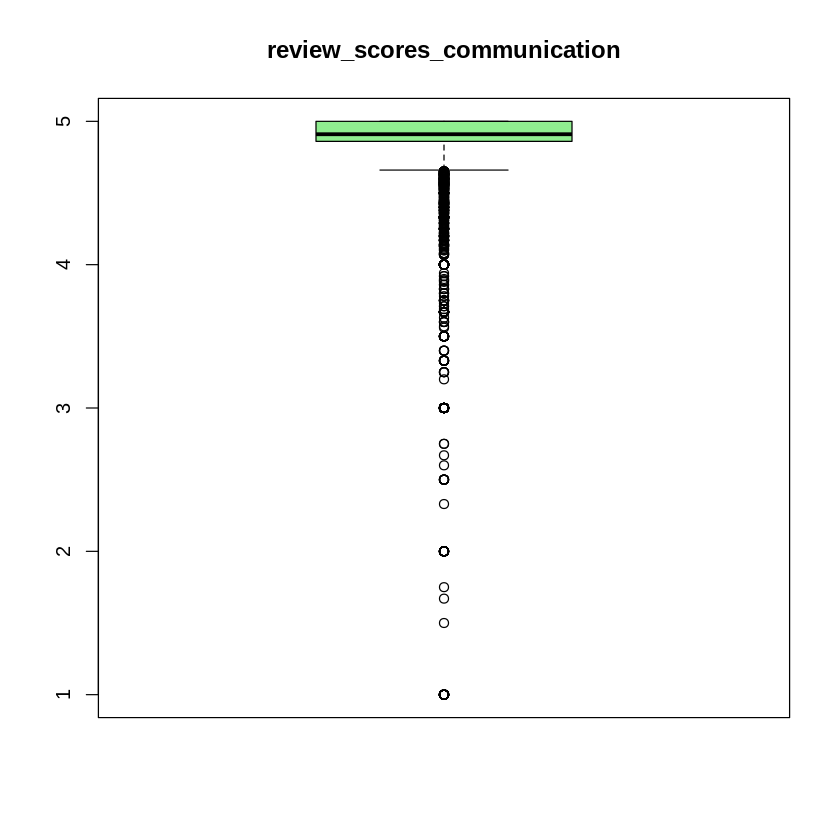

[1] "\n\n"


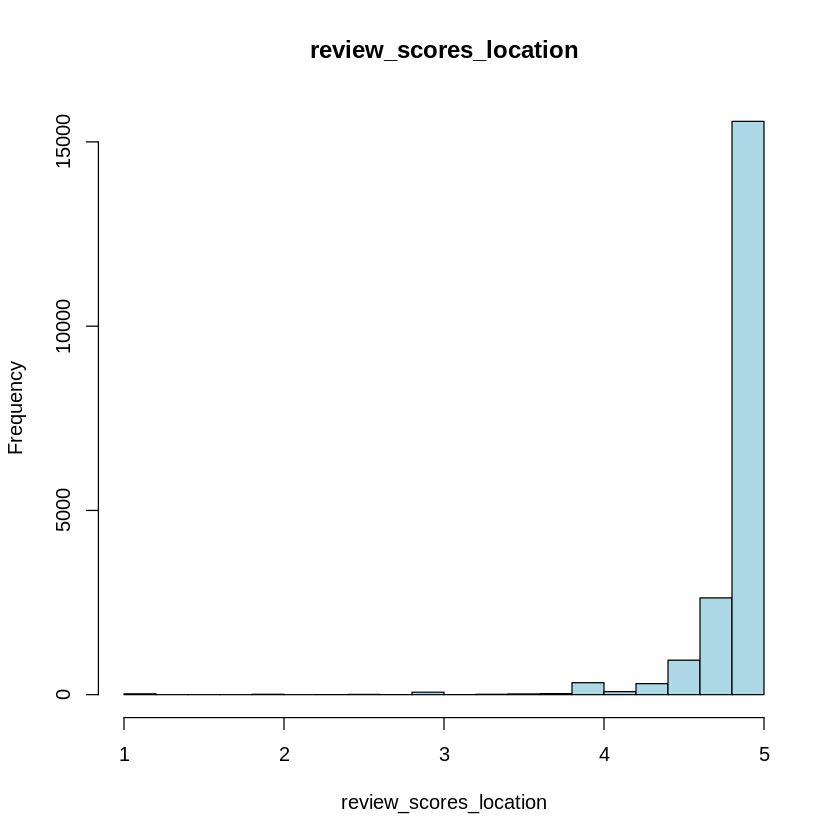

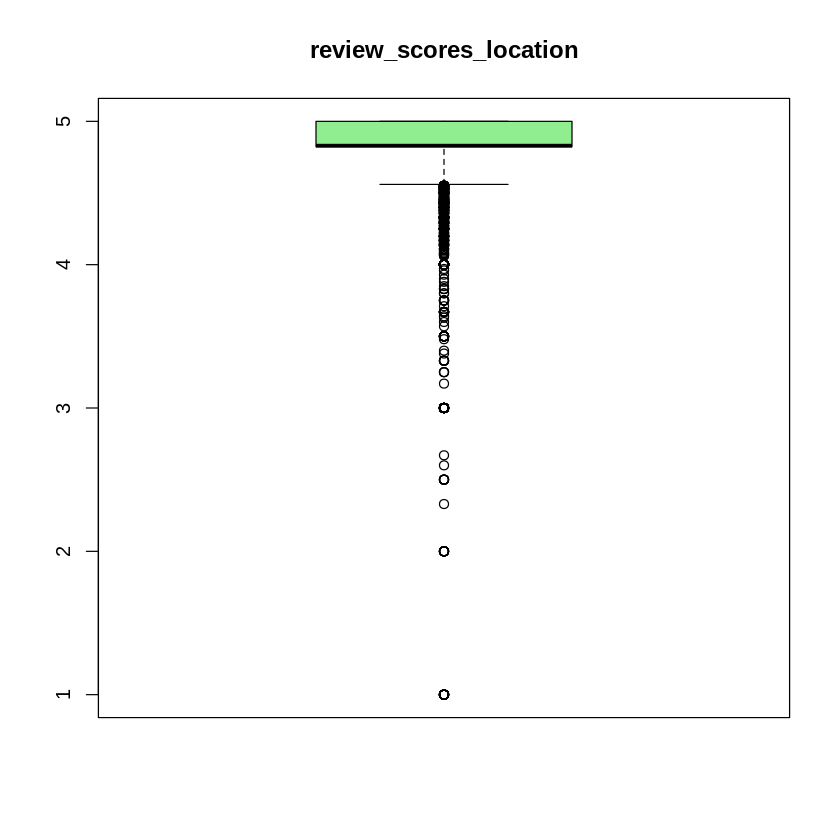

[1] "\n\n"


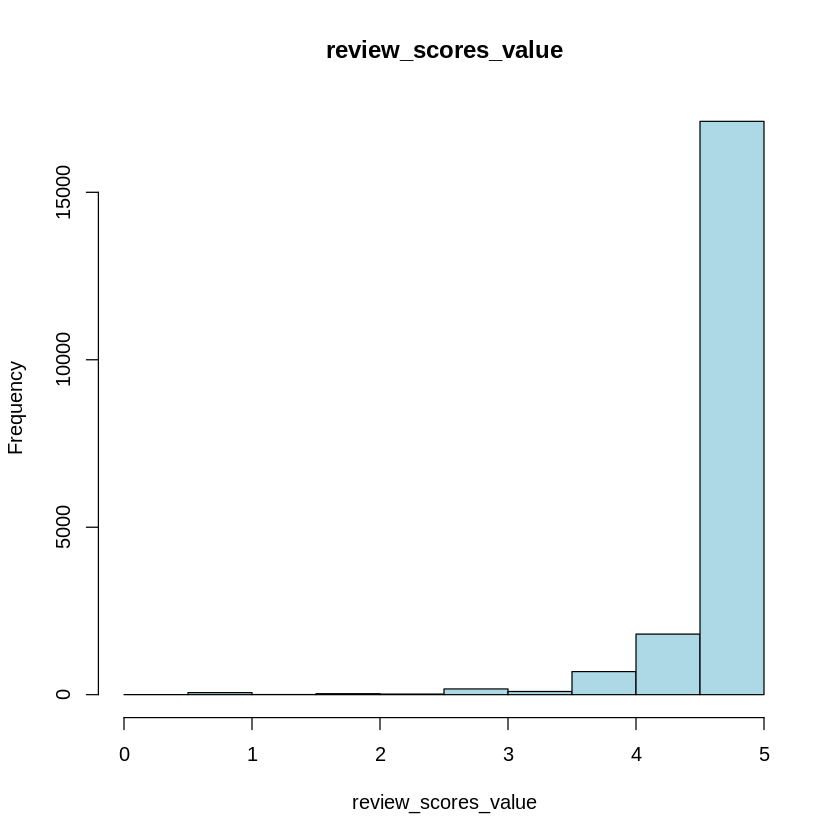

Skipping histogram for column: license 
Skipping boxplot for column: license 
Skipping histogram for column: instant_bookable 


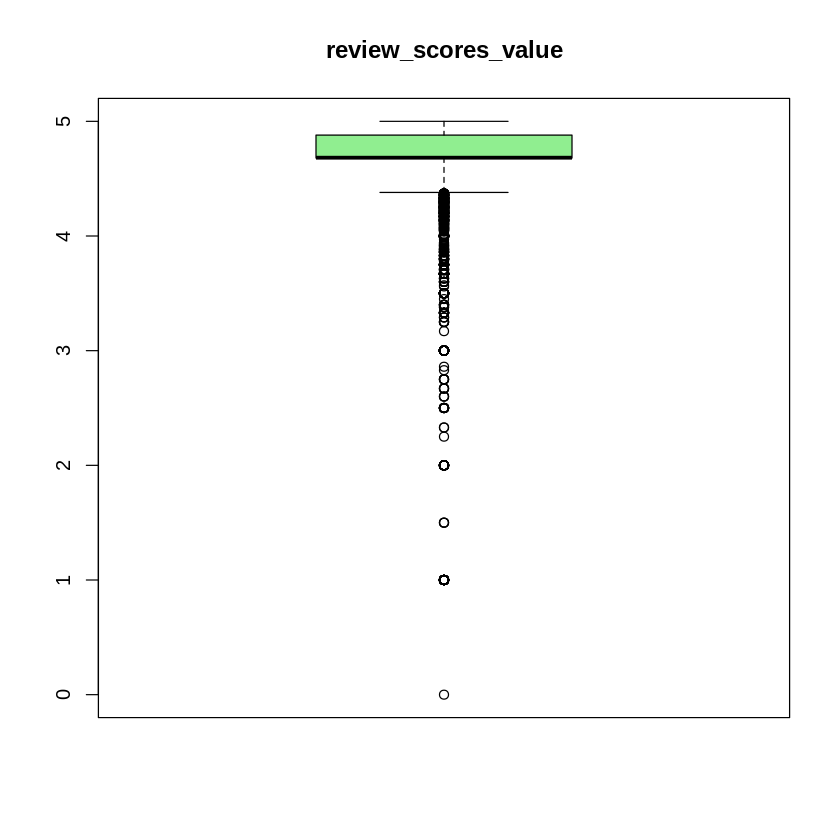

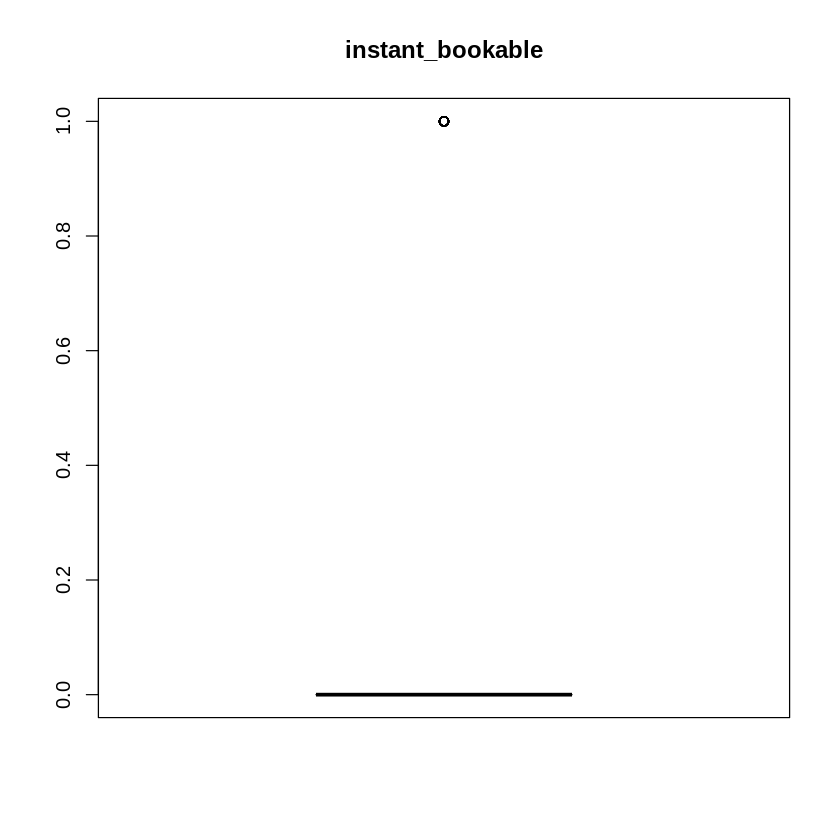

[1] "\n\n"


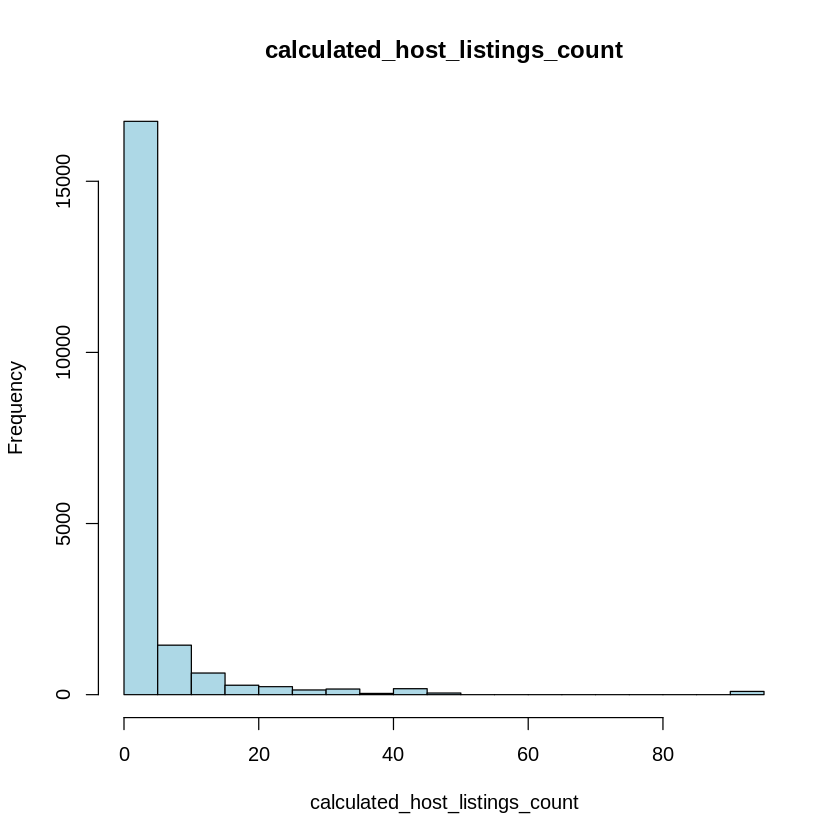

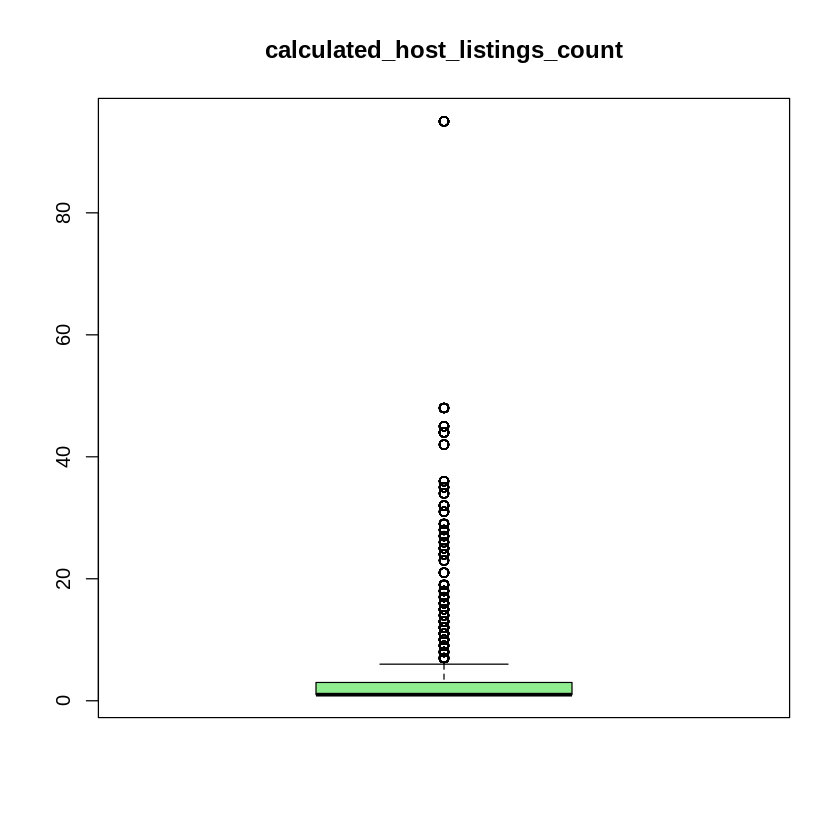

[1] "\n\n"


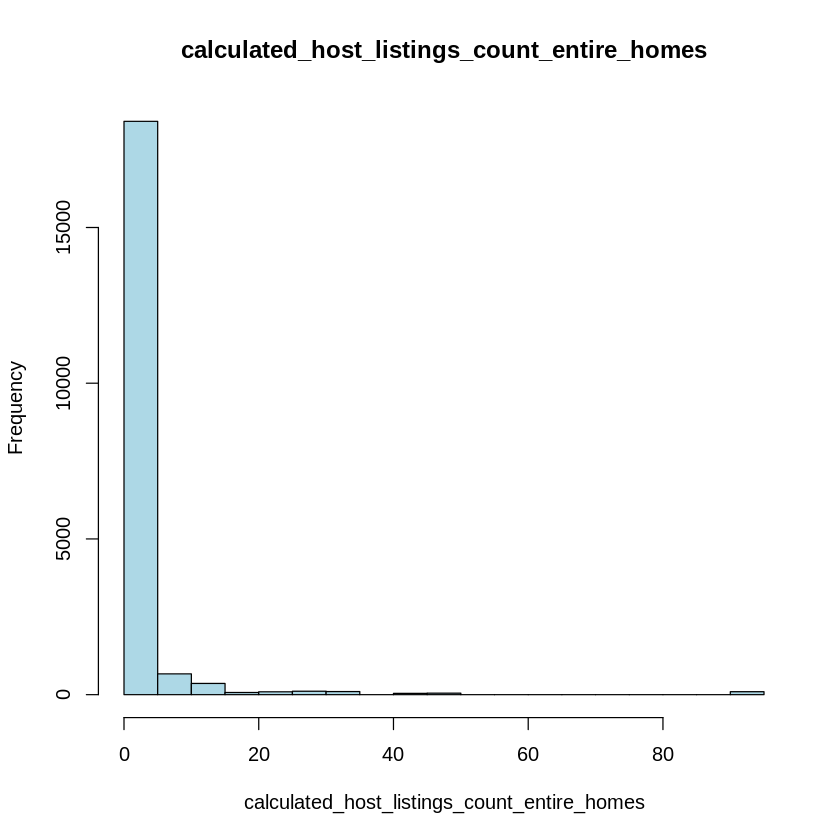

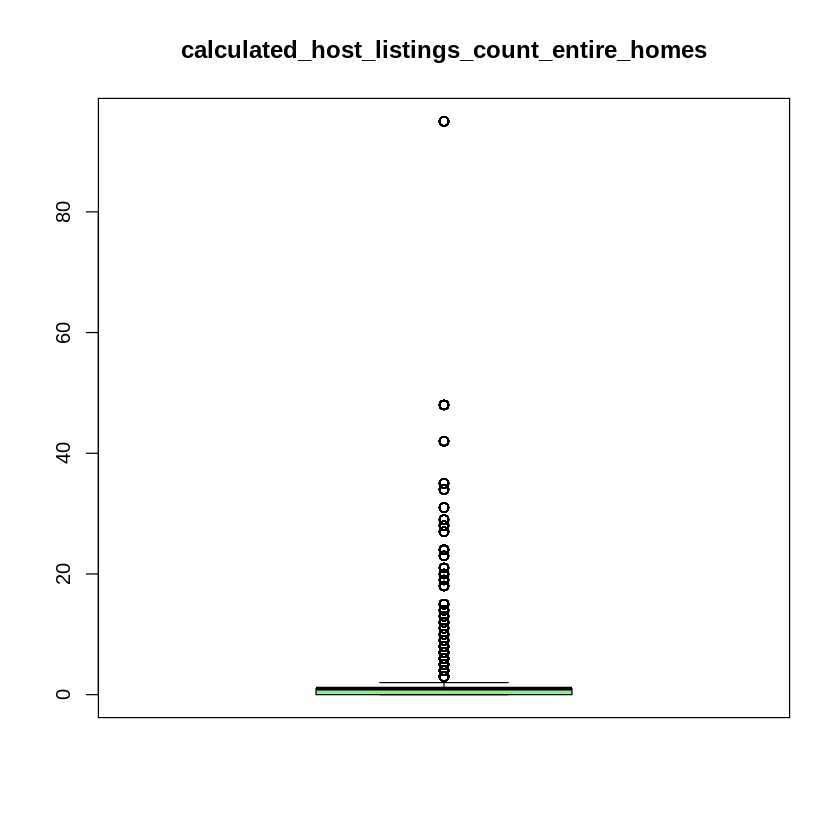

[1] "\n\n"


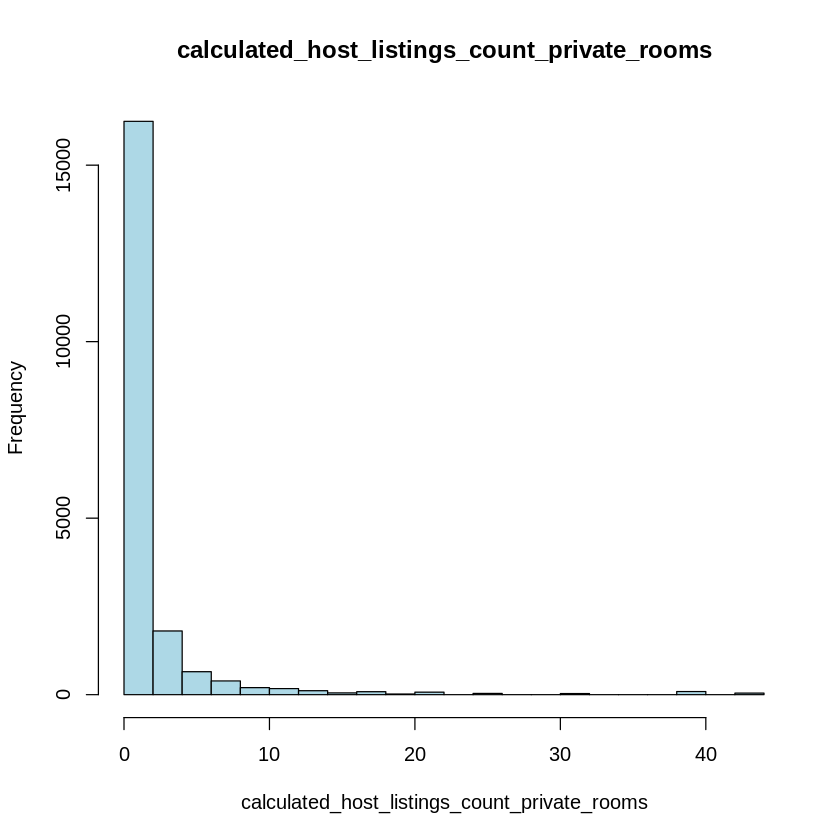

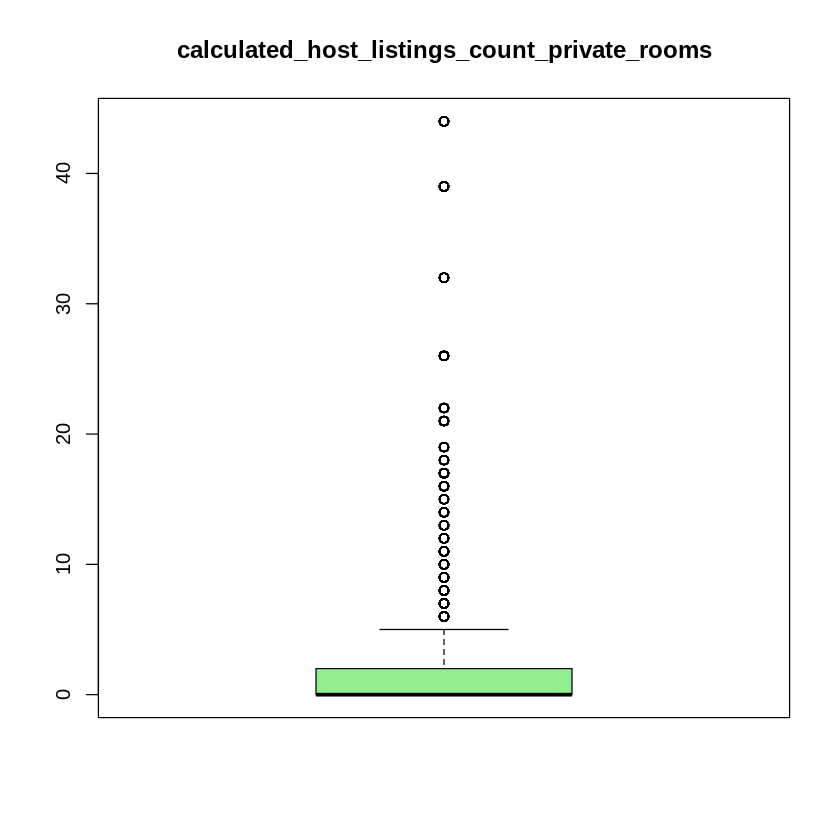

[1] "\n\n"


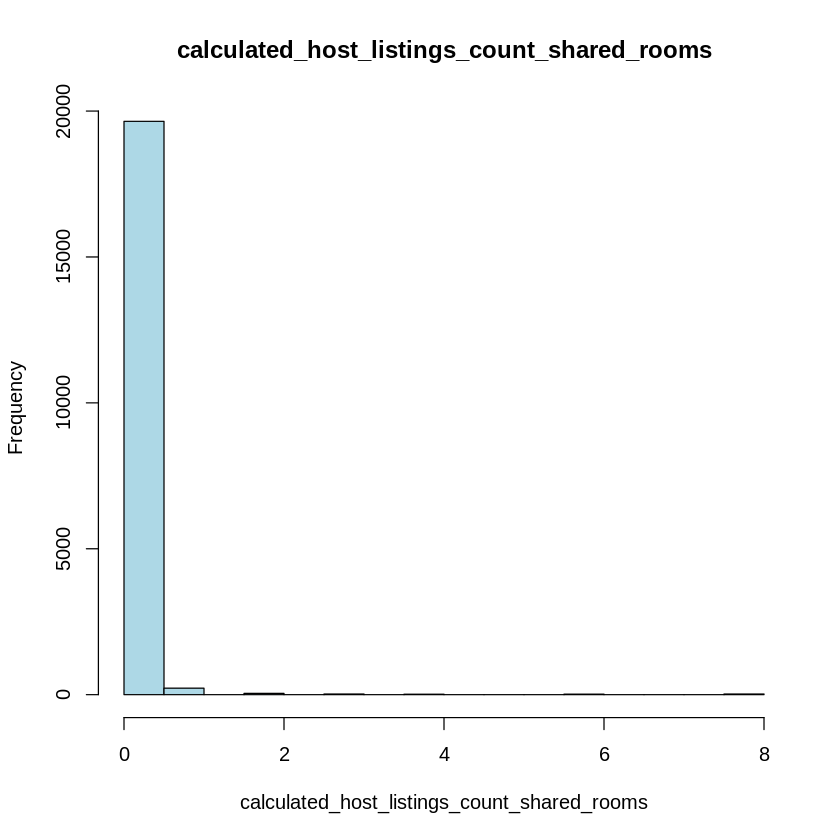

Skipping histogram for column: reviews_per_month 
Skipping boxplot for column: reviews_per_month 
Skipping histogram for column: host_verifications_1 
Skipping boxplot for column: host_verifications_1 


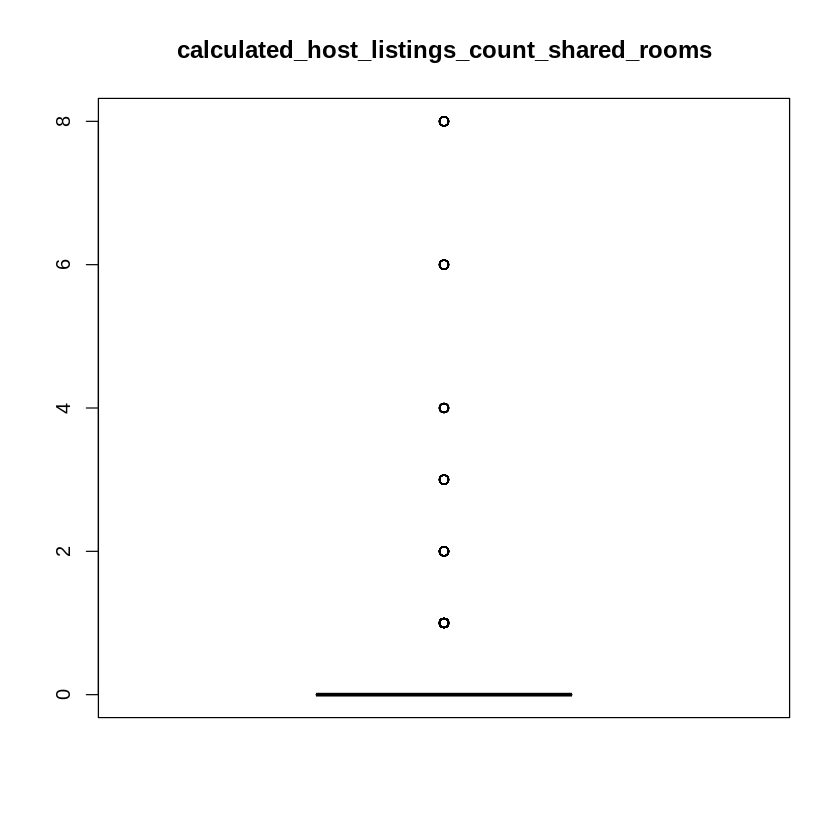

[1] "\n\n"


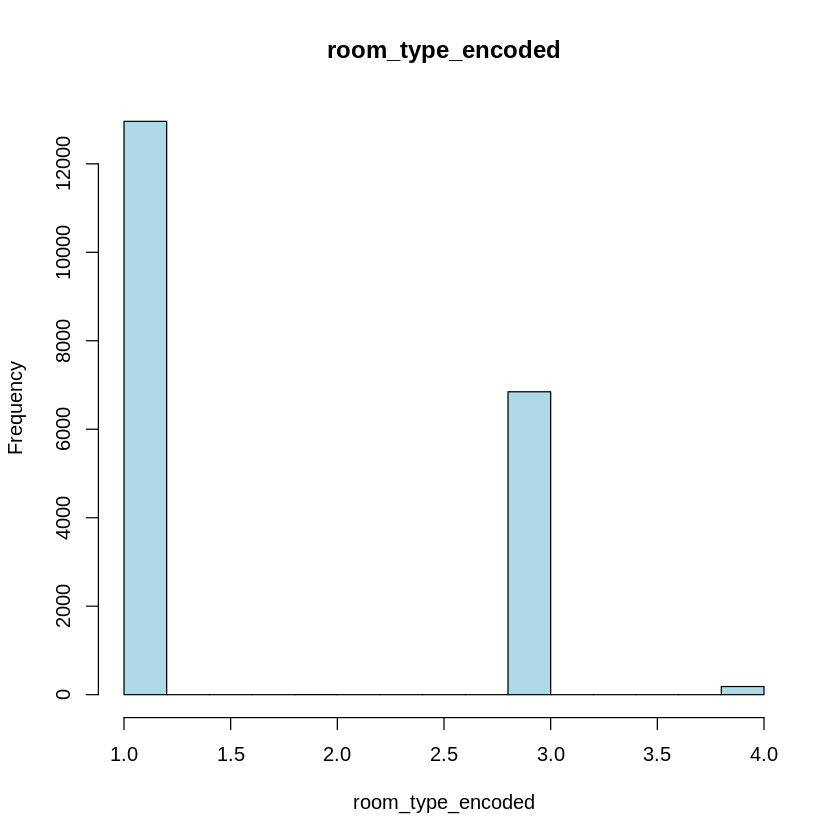

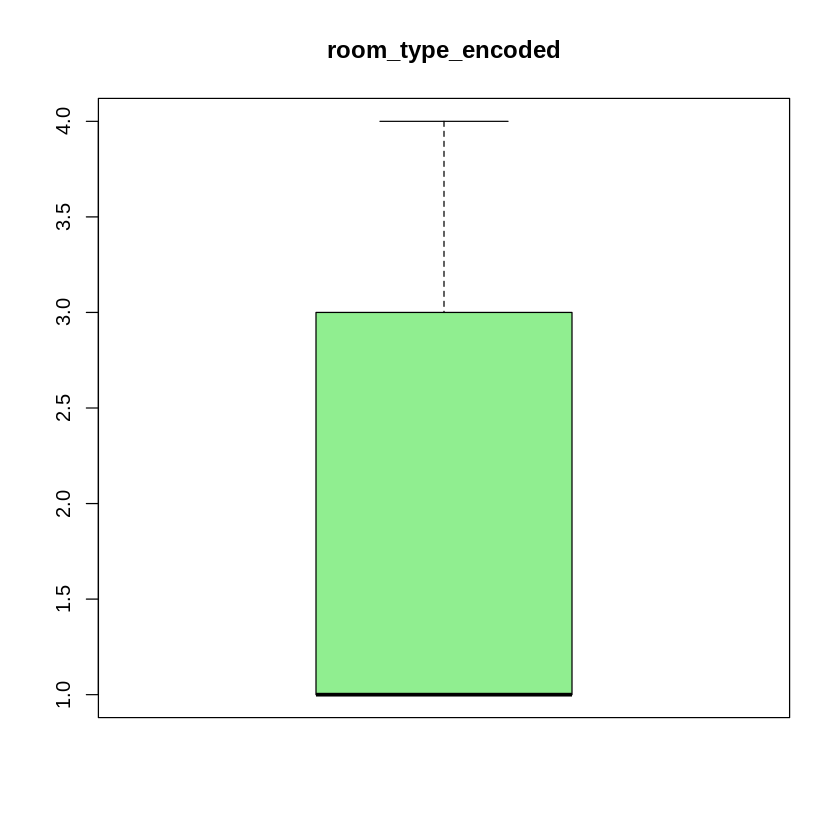

[1] "\n\n"


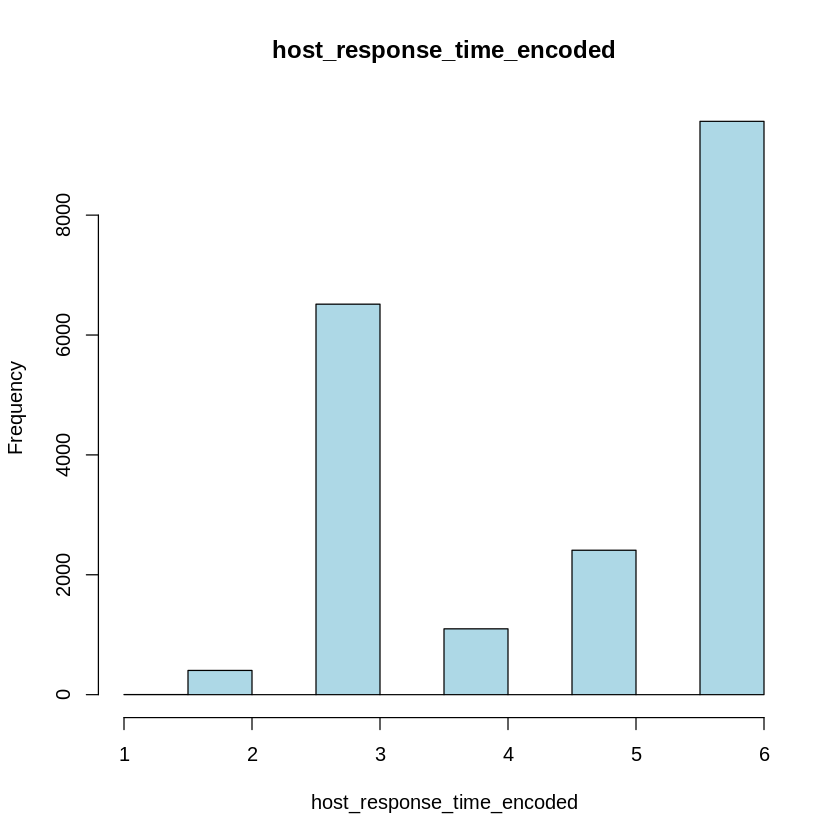

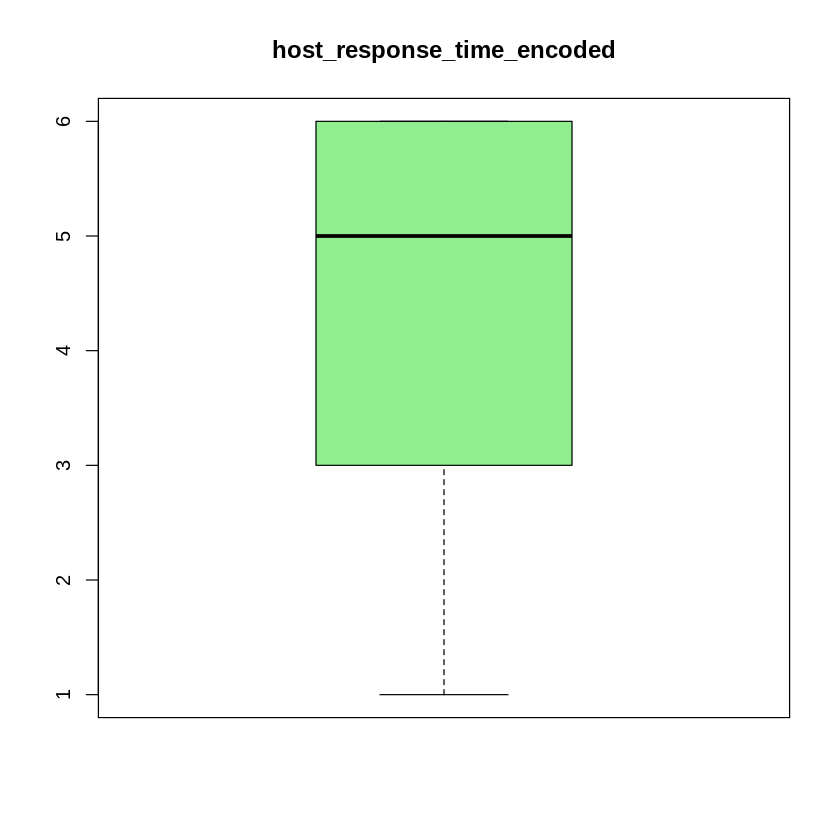

[1] "\n\n"


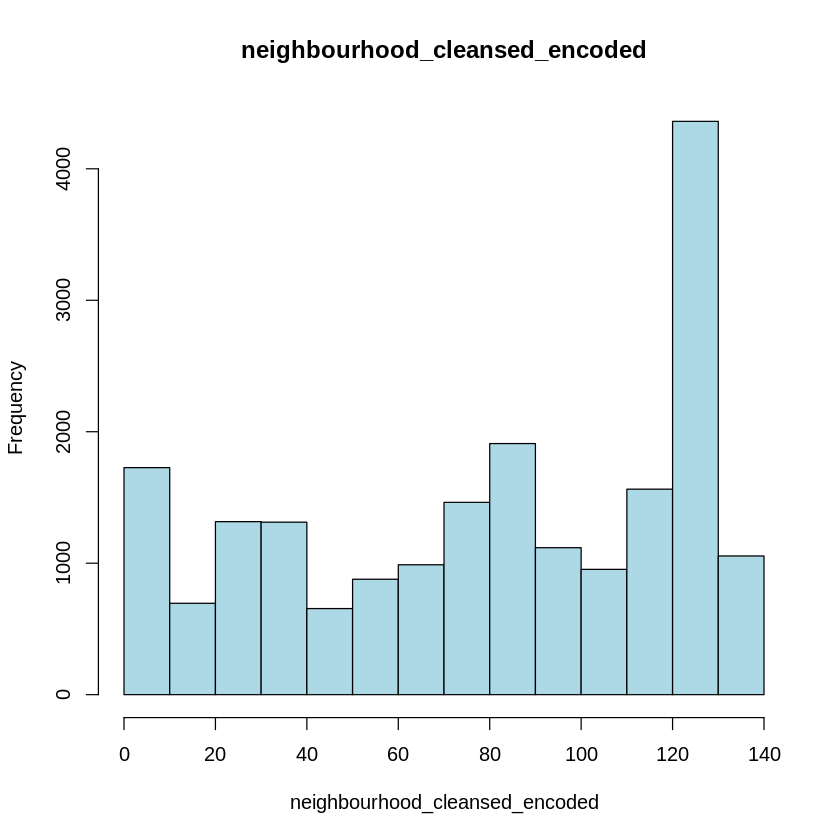

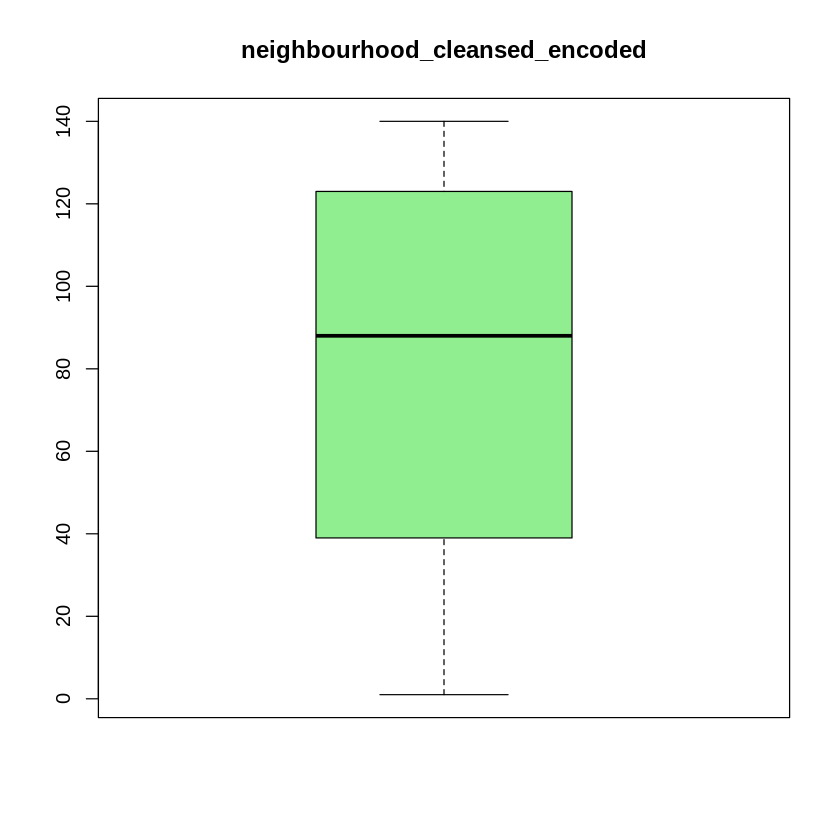

[1] "\n\n"


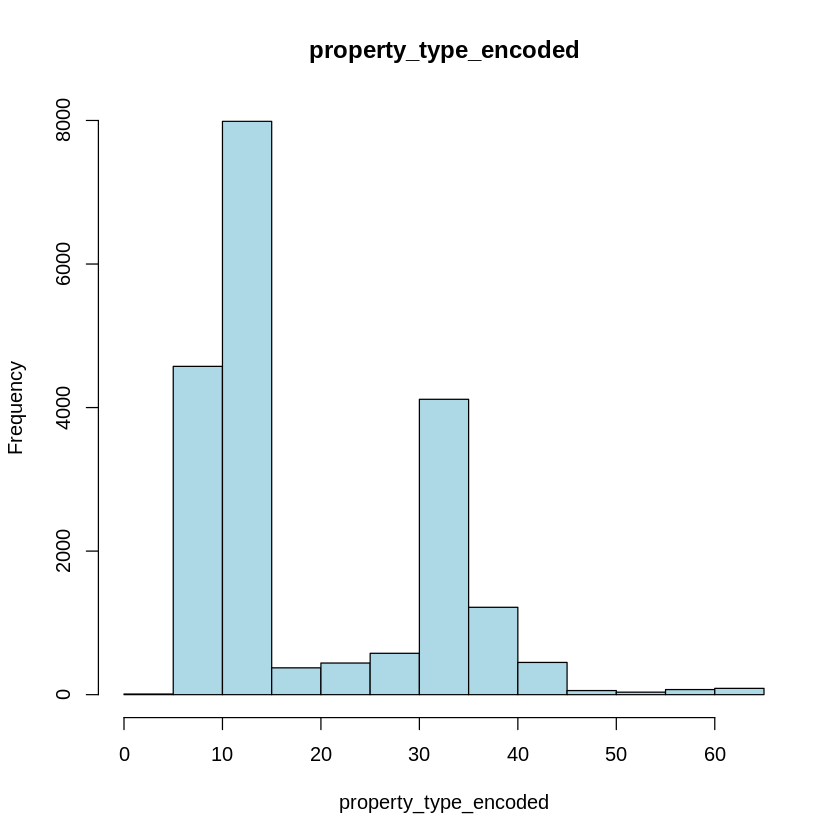

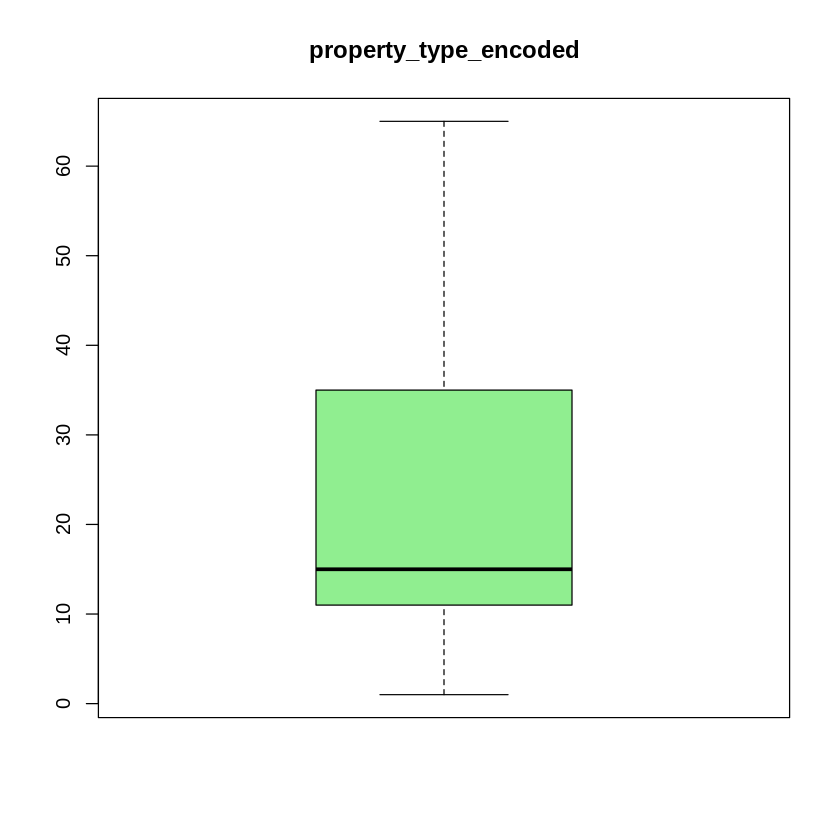

In [ ]:
# Pętla for do tworzenia wykresów
for (column in names(data_frame)) {
  tryCatch({
    # Tworzenie wykresu histogramu
    hist(data_frame[[column]], main = column, xlab = column, col = "lightblue")
    print("\n\n")
    Sys.sleep(1)  # Pauza dla lepszego rozróżnienia wykresów
  }, error = function(e) {
    # Obsługa błędów (np. gdy kolumna nie jest numeryczna)
    cat(paste("Skipping histogram for column:", column, "\n"))
  })

  tryCatch({
    # Tworzenie wykresu pudełkowego
    boxplot(data_frame[[column]], main = column, col = "lightgreen")
    Sys.sleep(1)  # Pauza dla lepszego rozróżnienia wykresów
  }, error = function(e) {
    # Obsługa błędów (np. gdy kolumna nie jest numeryczna)
    cat(paste("Skipping boxplot for column:", column, "\n"))
  })
}

FUNKCJA DO USUWANIA OUTLIER'ÓW

In [ ]:
identify_outliers <- function(df, column) {
  # Obliczenie kwartyli
  Q1 <- quantile(df[[column]], 0.10, na.rm = TRUE)
  Q3 <- quantile(df[[column]], 0.90, na.rm = TRUE)

  # Obliczenie szerokości przedziału międzykwartylowego (IQR)
  IQR <- Q3 - Q1

  # Dolna granica wartości odstających
  lower_bound <- Q1 - 1.5 * IQR

  # Górna granica wartości odstających
  upper_bound <- Q3 + 1.5 * IQR

  # Filtracja wartości odstających
  outliers <- df[df[[column]] < lower_bound | df[[column]] > upper_bound, ]

  return(outliers)
}

UŻYCIE FUNKCJI NA ZMIENNYCH NUMERYCZNYCH

In [ ]:
# Lista do przechowywania indeksów wierszy do usunięcia
indexes <- vector("list")

# Pętla for do przetwarzania kolumn
for (column in names(data_frame)) {
  # Sprawdzenie typu danych kolumny
  if (is.numeric(data_frame[[column]])) {
    # Identyfikacja wartości odstających
    outliers_df <- identify_outliers(data_frame, column)
    # Dodanie indeksów wierszy do listy
    indexes <- c(indexes, rownames(outliers_df))
  }
}

# Usunięcie wierszy zawierających wartości odstające
df_cleaned <- data_frame[setdiff(rownames(data_frame), unlist(indexes)), ]

# Wyświetlenie oczyszczonej ramki danych
print(df_cleaned)

                                          listing_url last_scraped          source
1    https://www.airbnb.com/rooms/1002736951366032648   2023-12-12     city scrape
2     https://www.airbnb.com/rooms/716133555965651038   2023-12-12     city scrape
5    https://www.airbnb.com/rooms/1012550920875154828   2023-12-12     city scrape
6     https://www.airbnb.com/rooms/684041130828663144   2023-12-12     city scrape
7               https://www.airbnb.com/rooms/18227287   2023-12-13 previous scrape
8               https://www.airbnb.com/rooms/53032551   2023-12-13     city scrape
9               https://www.airbnb.com/rooms/10405775   2023-12-13 previous scrape
10              https://www.airbnb.com/rooms/19198250   2023-12-13 previous scrape
11              https://www.airbnb.com/rooms/13712972   2023-12-13 previous scrape
12              https://www.airbnb.com/rooms/13660723   2023-12-13 previous scrape
15              https://www.airbnb.com/rooms/22185893   2023-12-13 previous scrape
16  

Skipping histogram for column: listing_url 
Skipping boxplot for column: listing_url 
Skipping histogram for column: last_scraped 
Skipping histogram for column: source 
Skipping boxplot for column: source 
Skipping histogram for column: name 
Skipping boxplot for column: name 
Skipping histogram for column: picture_url 
Skipping boxplot for column: picture_url 


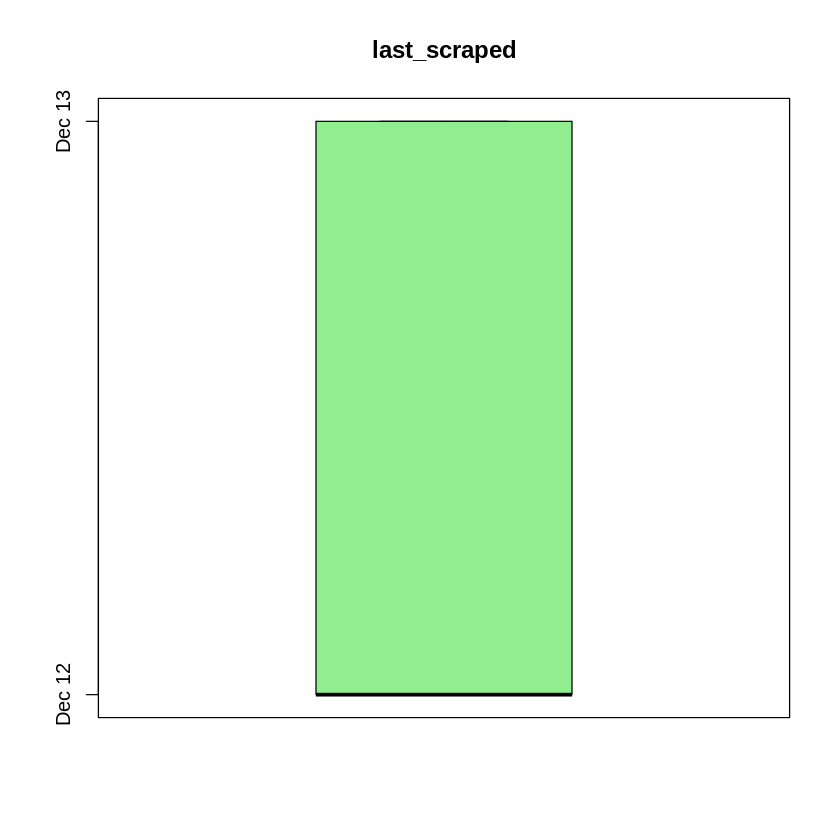

[1] "\n\n"


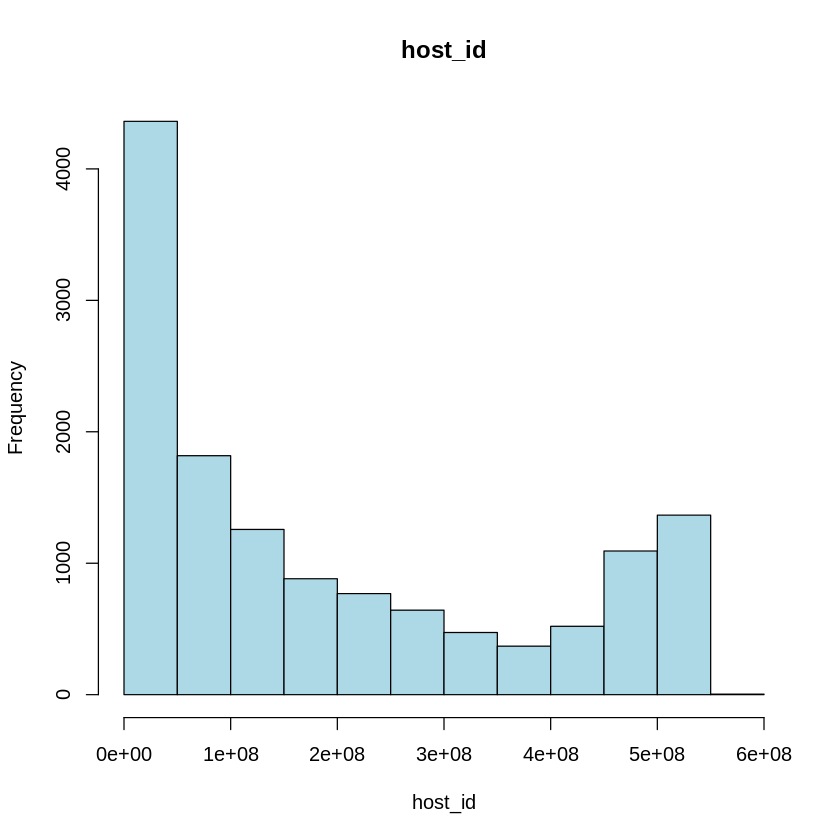

Skipping histogram for column: host_url 
Skipping boxplot for column: host_url 
Skipping histogram for column: host_name 
Skipping boxplot for column: host_name 
Skipping histogram for column: host_since 
Skipping boxplot for column: host_since 
Skipping histogram for column: host_location 
Skipping boxplot for column: host_location 
Skipping histogram for column: host_response_time 


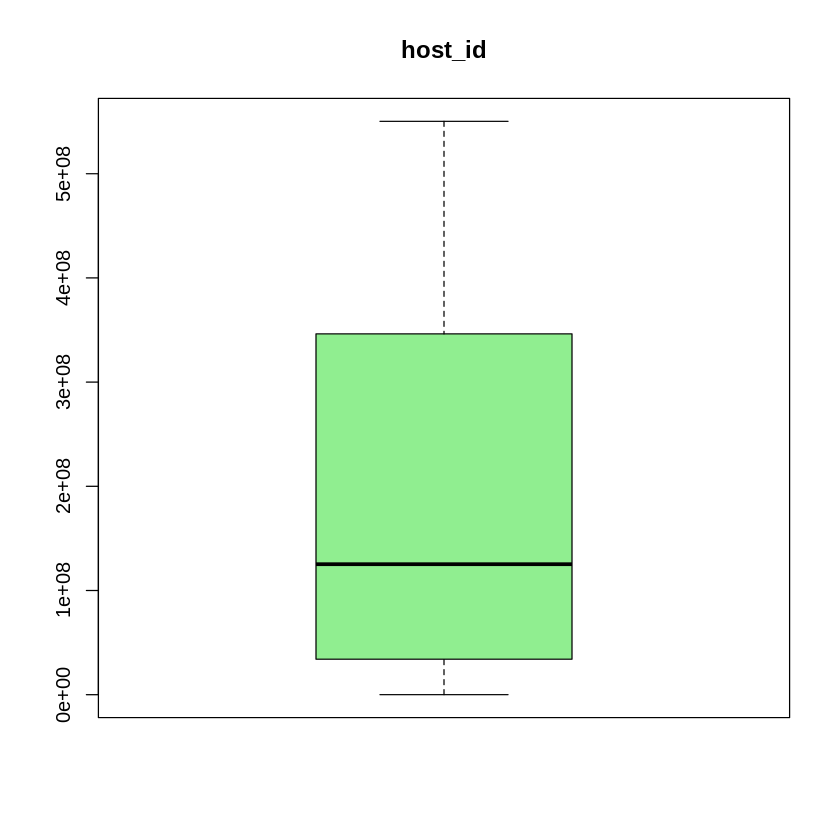

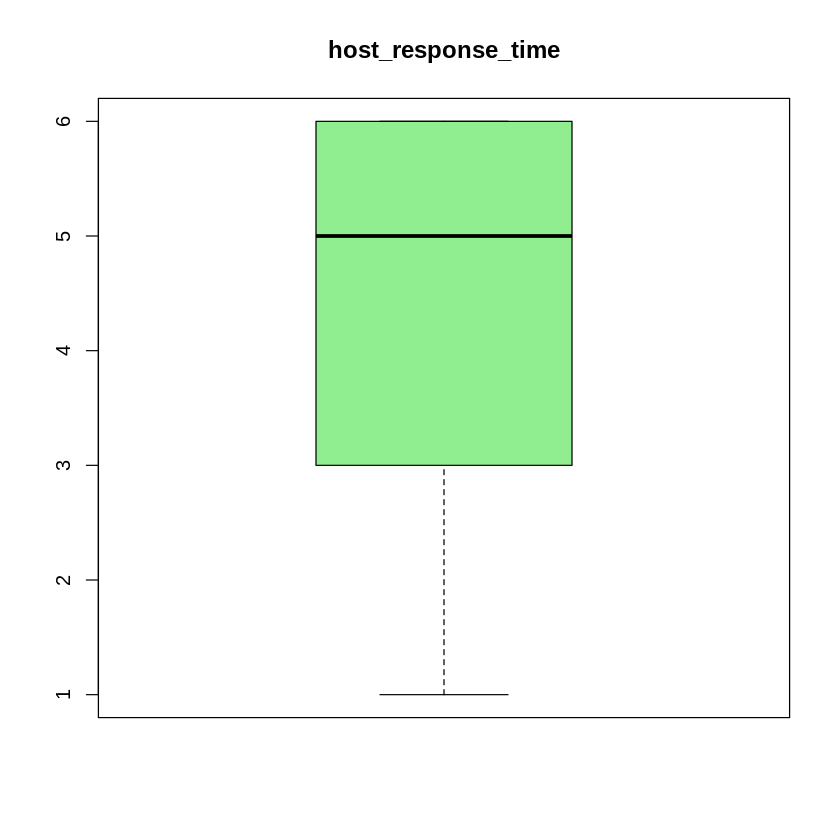

[1] "\n\n"


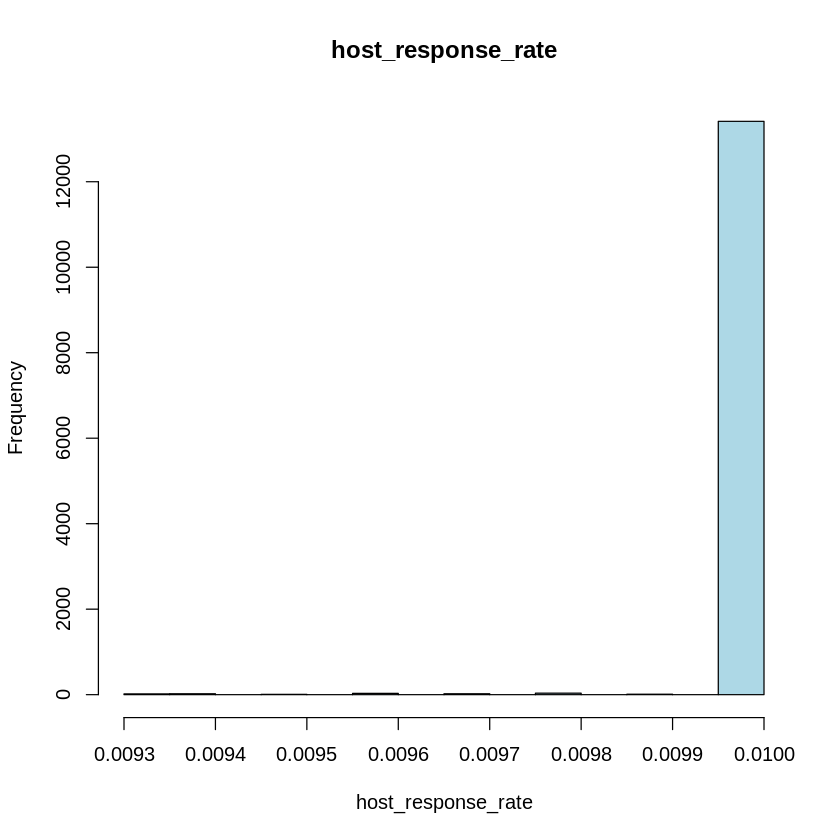

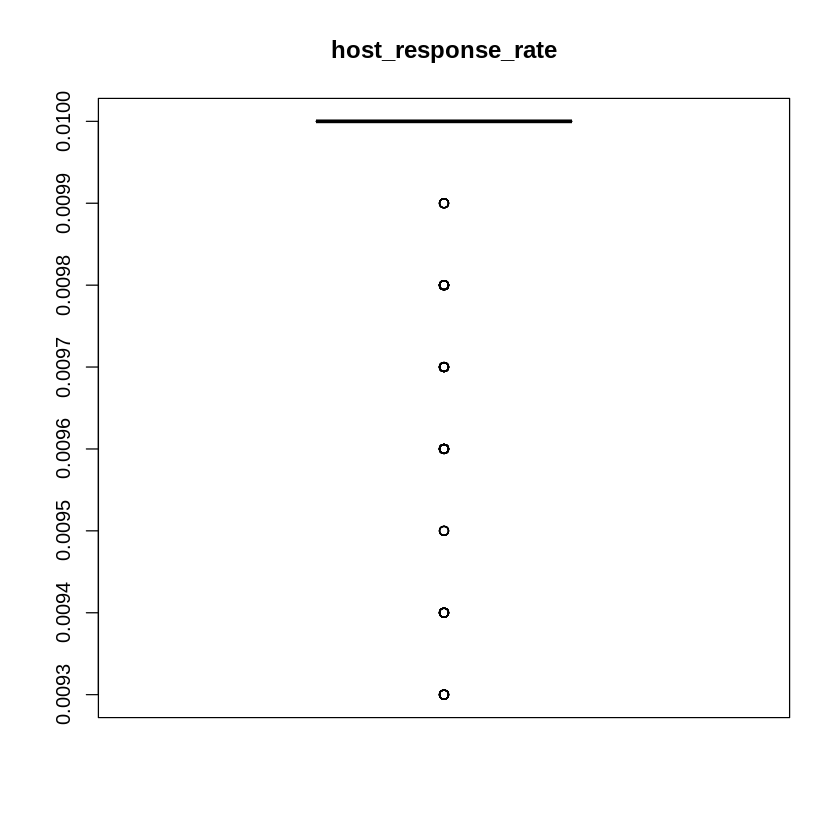

[1] "\n\n"


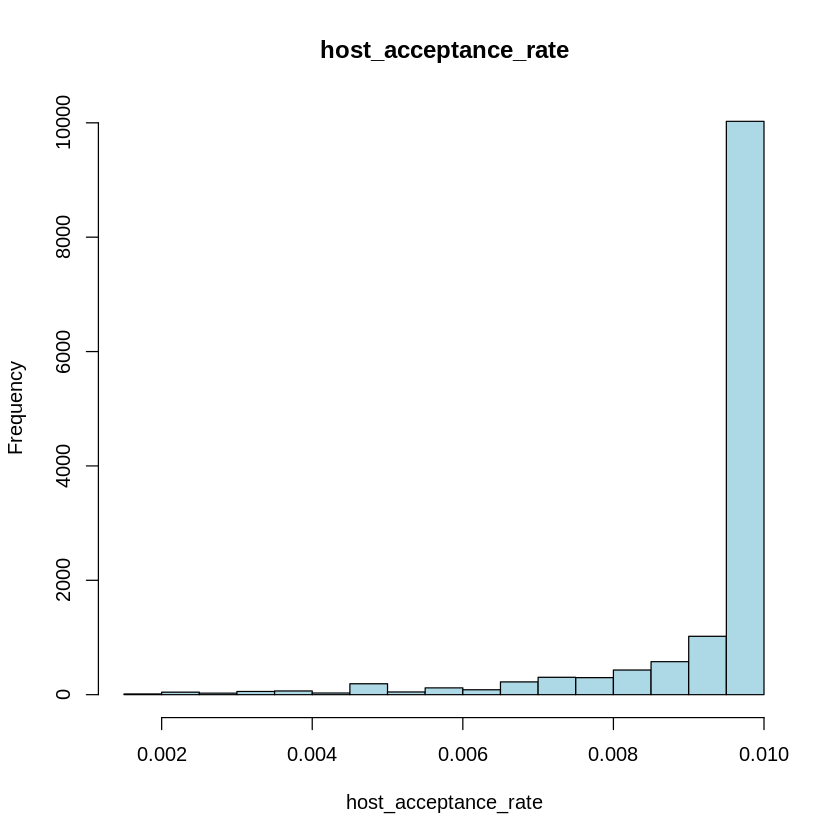

Skipping histogram for column: host_is_superhost 


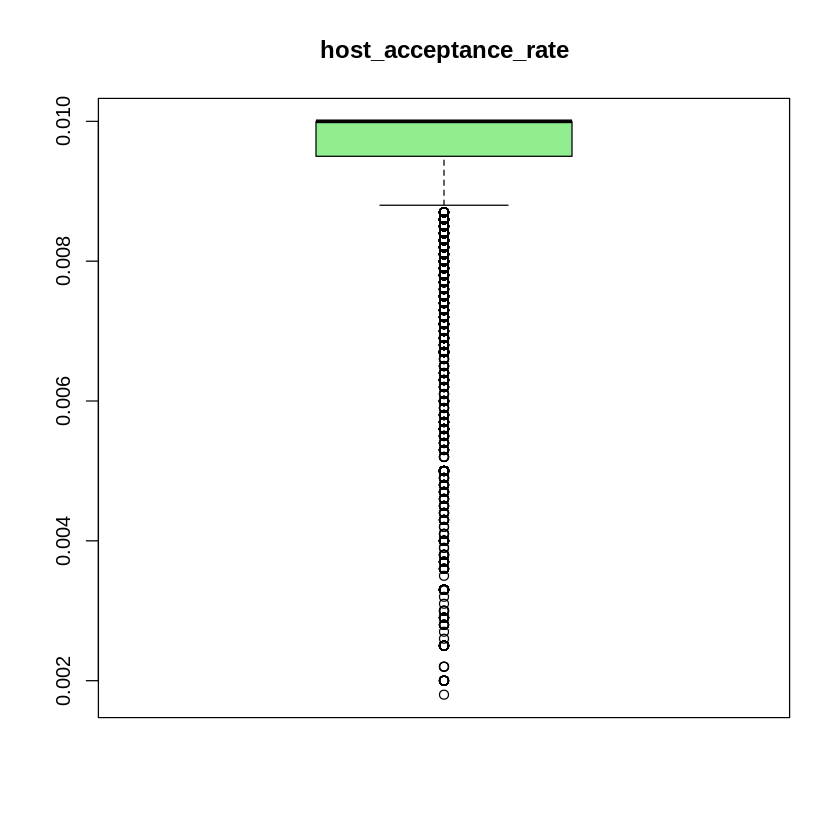

Skipping histogram for column: host_thumbnail_url 
Skipping boxplot for column: host_thumbnail_url 
Skipping histogram for column: host_picture_url 
Skipping boxplot for column: host_picture_url 


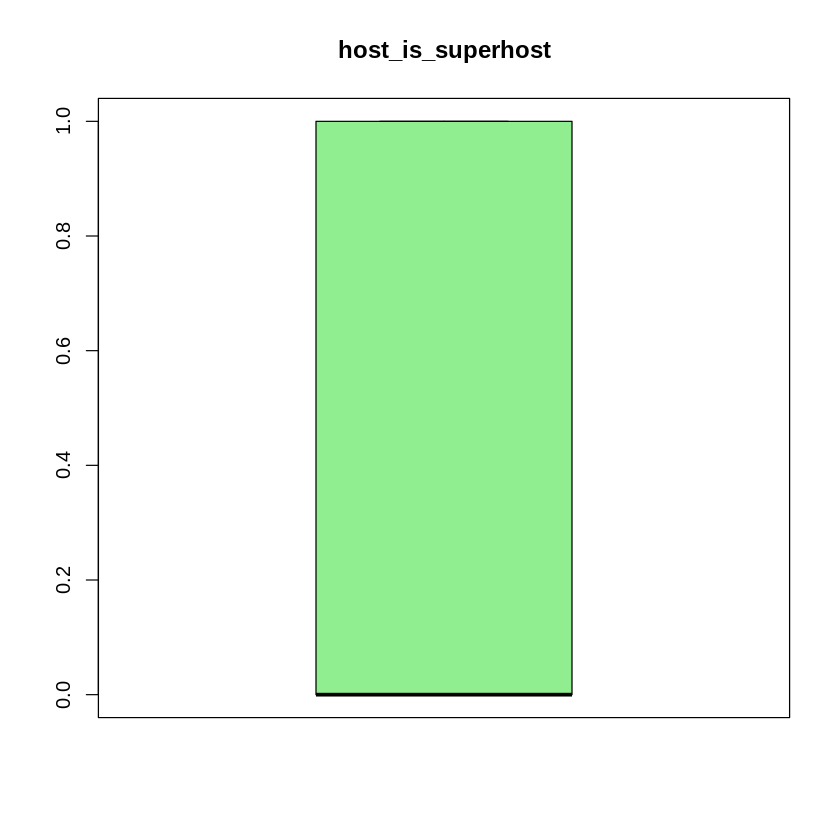

[1] "\n\n"


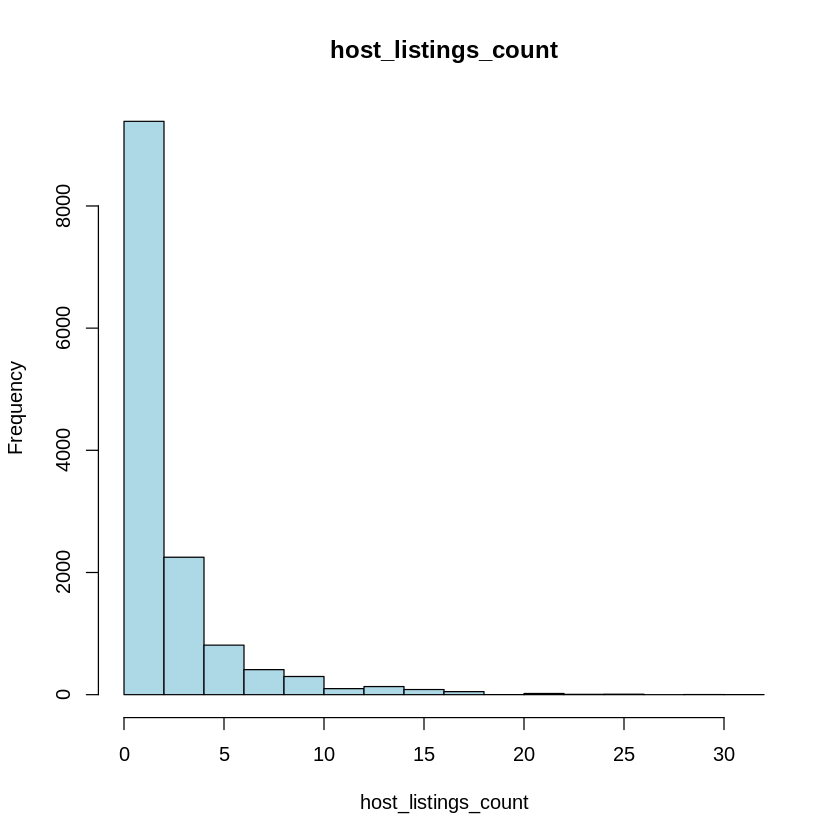

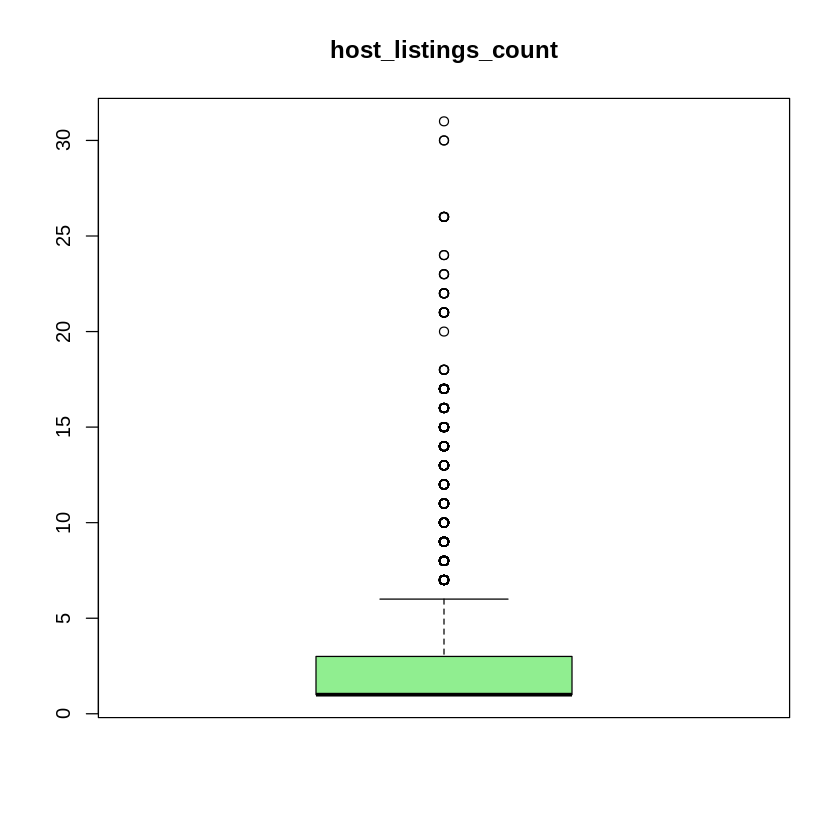

[1] "\n\n"


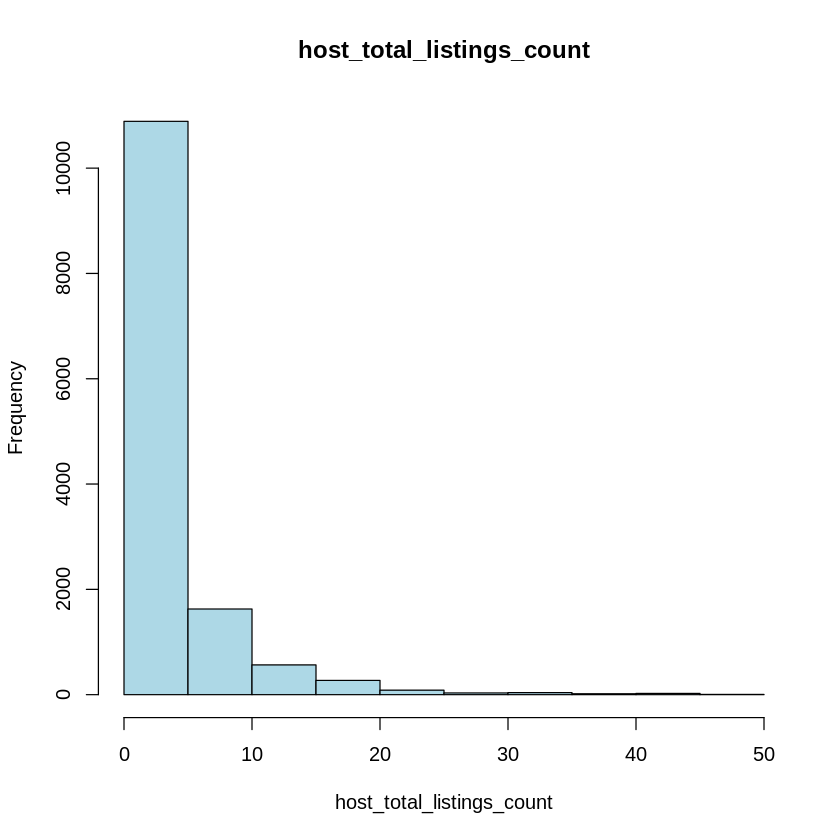

Skipping histogram for column: host_verifications 
Skipping boxplot for column: host_verifications 
Skipping histogram for column: host_has_profile_pic 


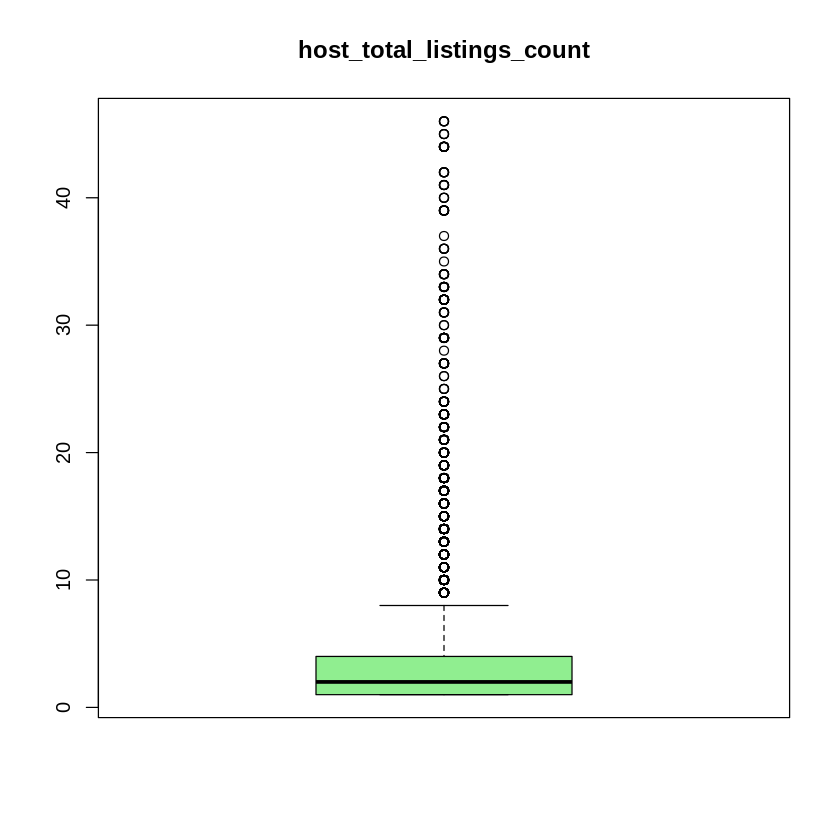

Skipping histogram for column: host_identity_verified 


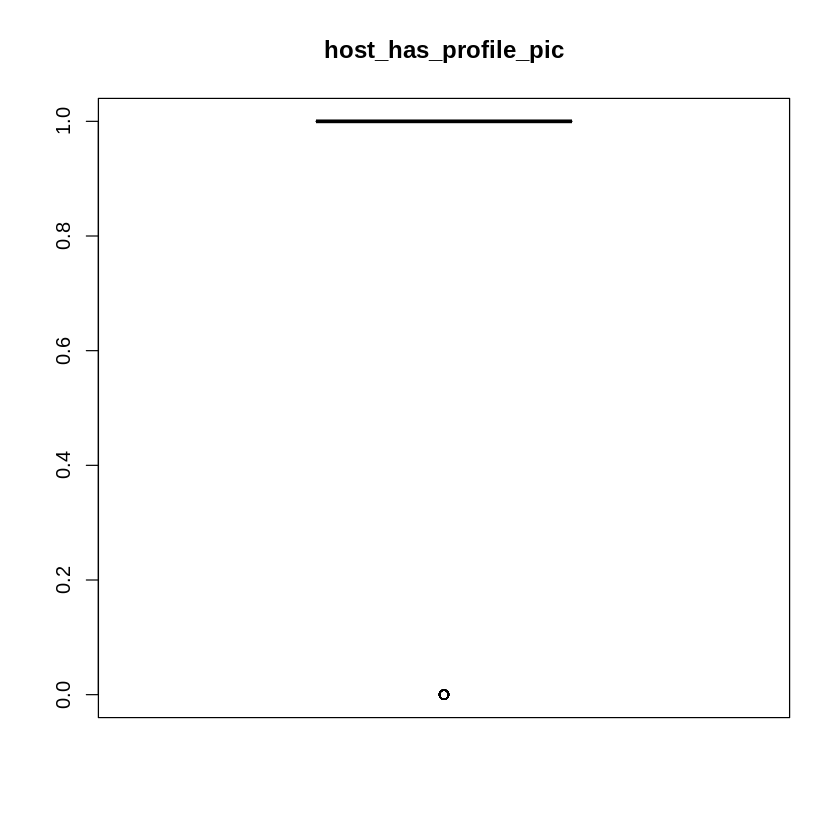

Skipping histogram for column: neighbourhood_cleansed 
Skipping boxplot for column: neighbourhood_cleansed 


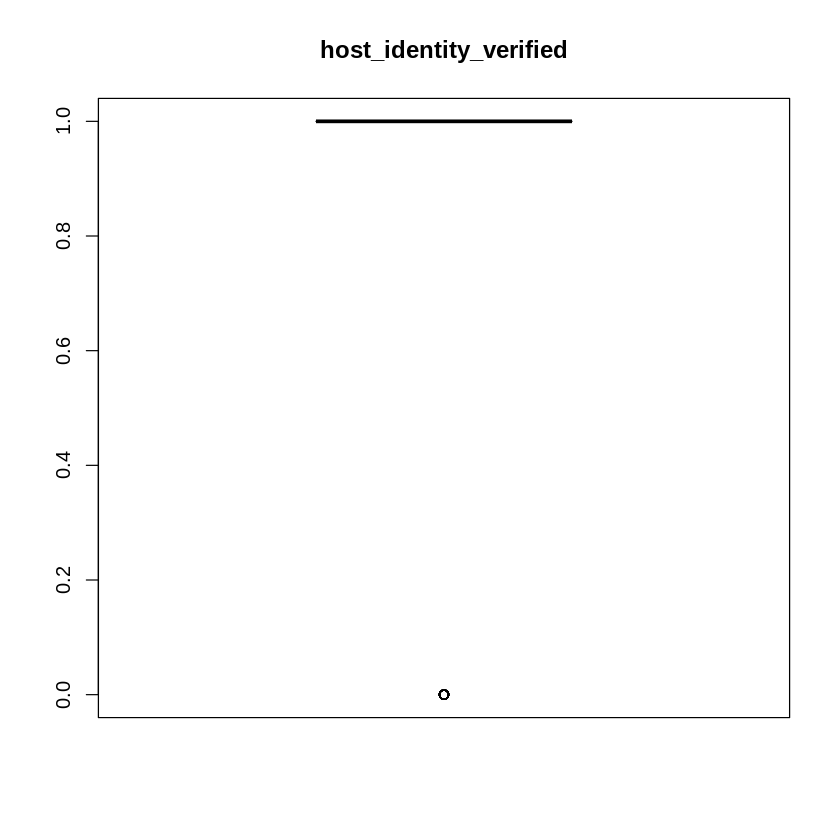

[1] "\n\n"


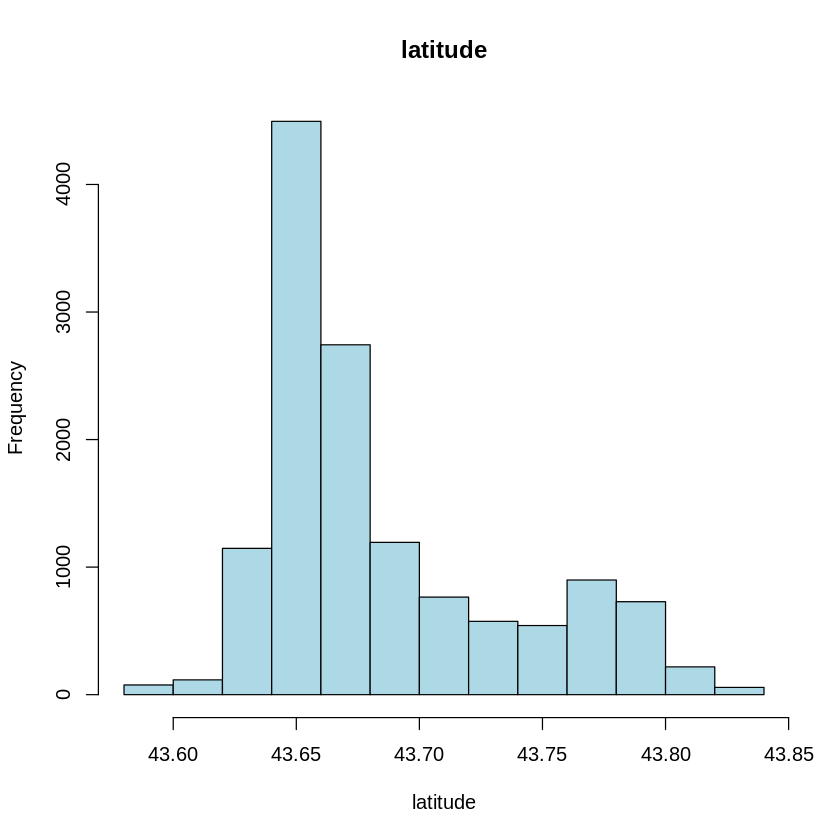

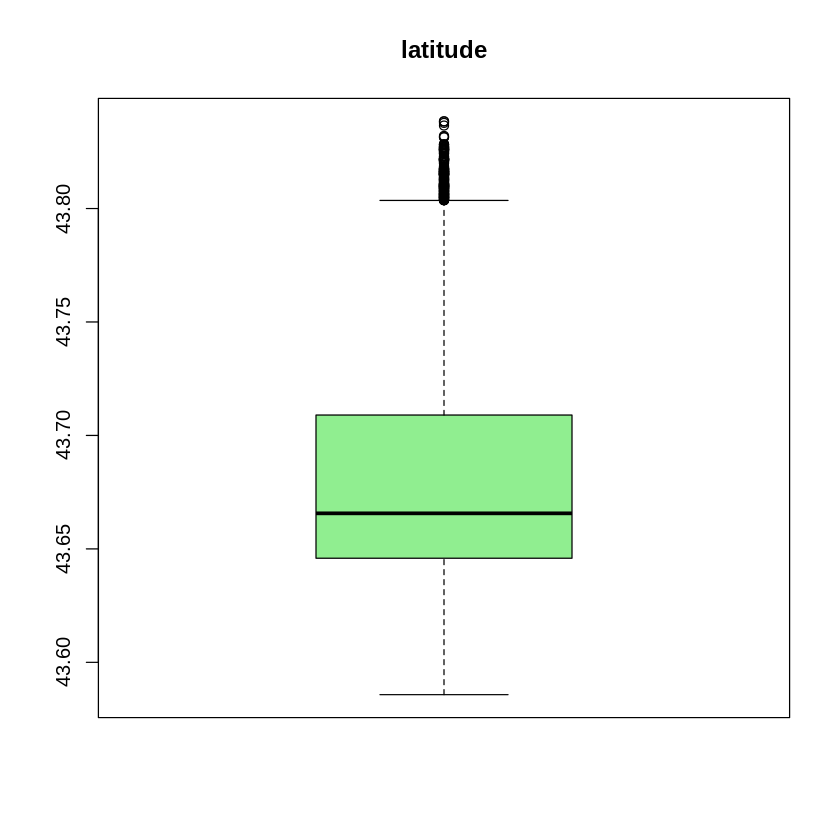

[1] "\n\n"


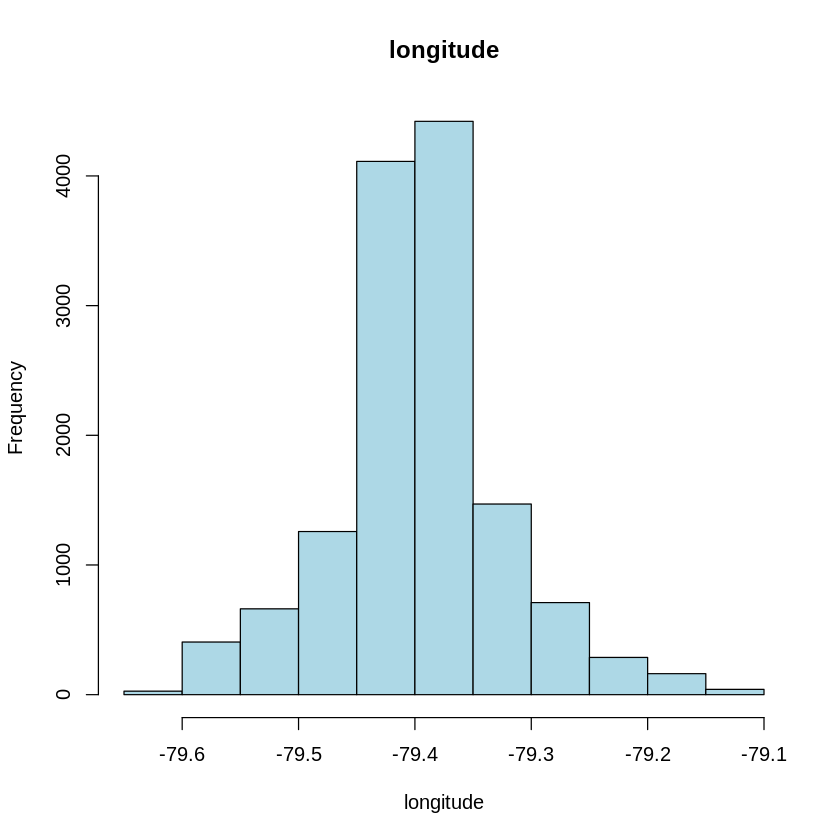

Skipping histogram for column: property_type 
Skipping boxplot for column: property_type 
Skipping histogram for column: room_type 


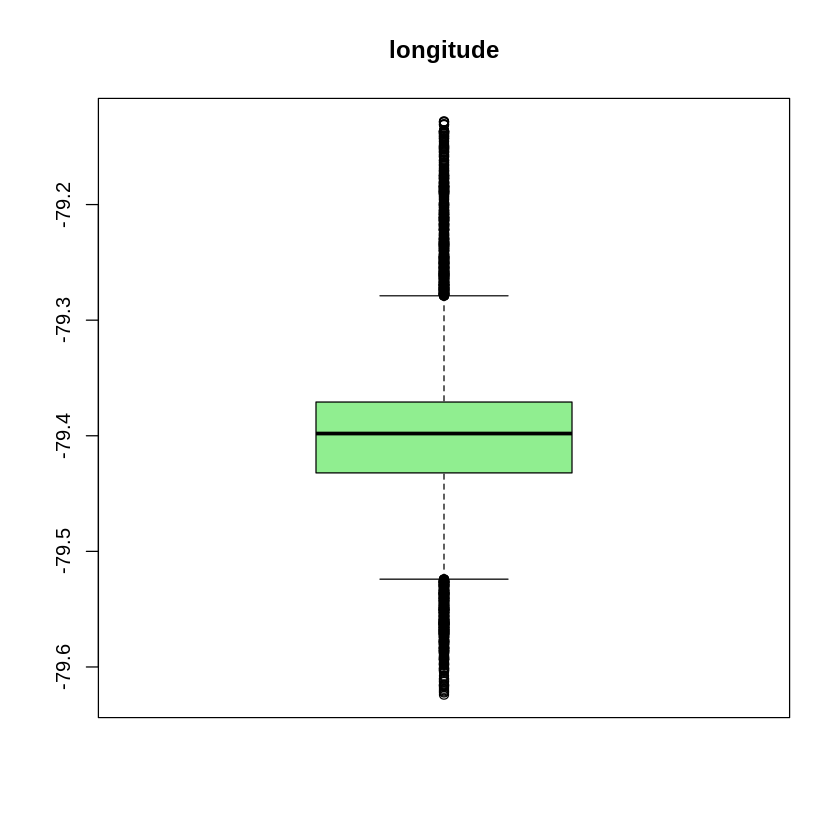

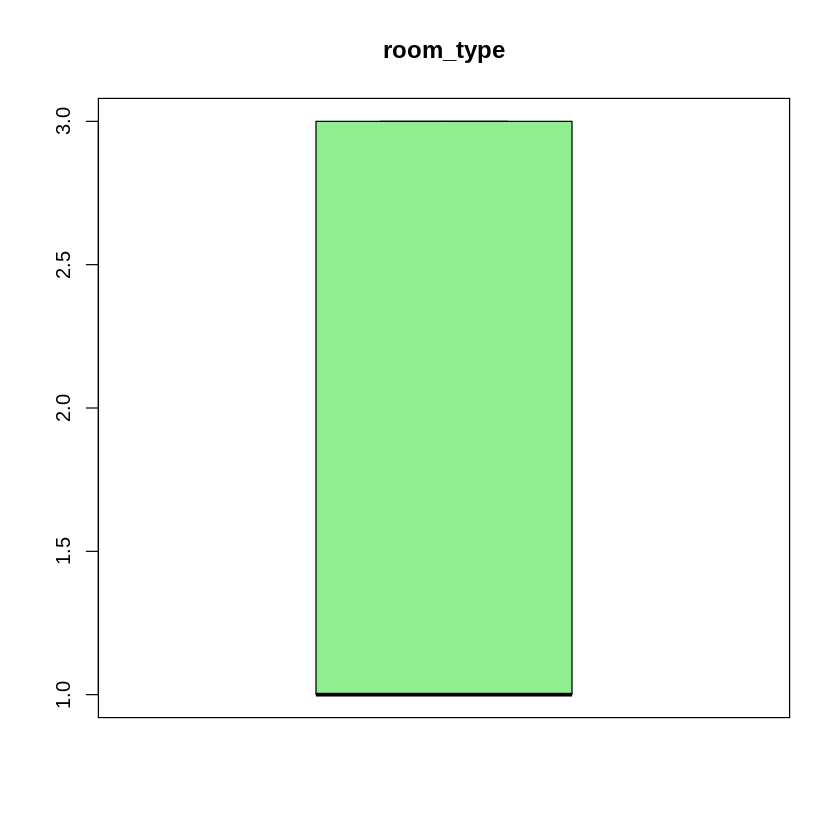

[1] "\n\n"


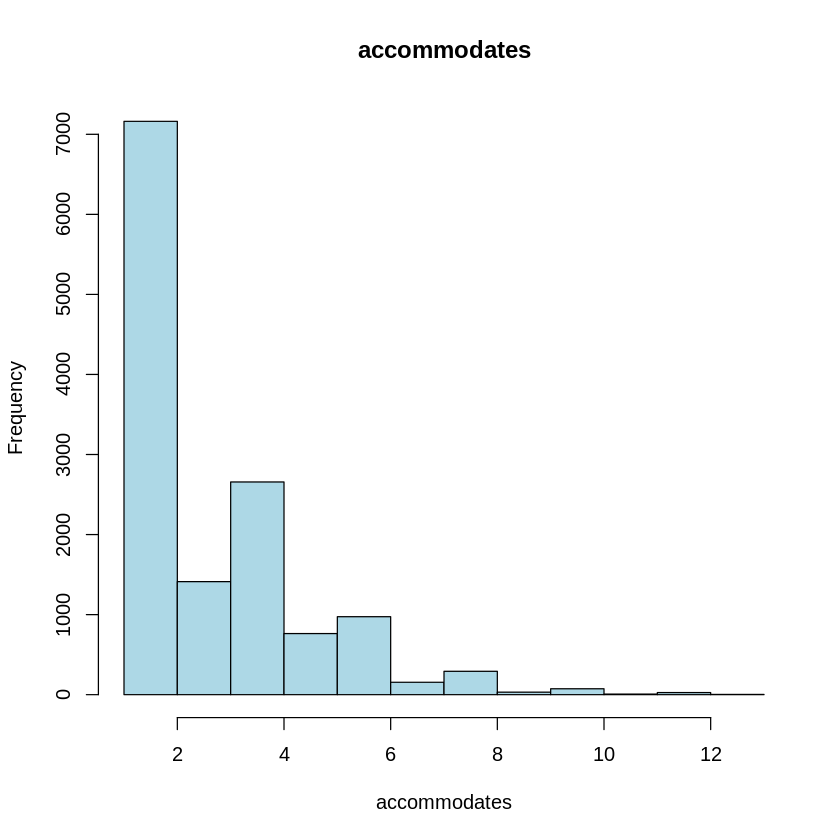

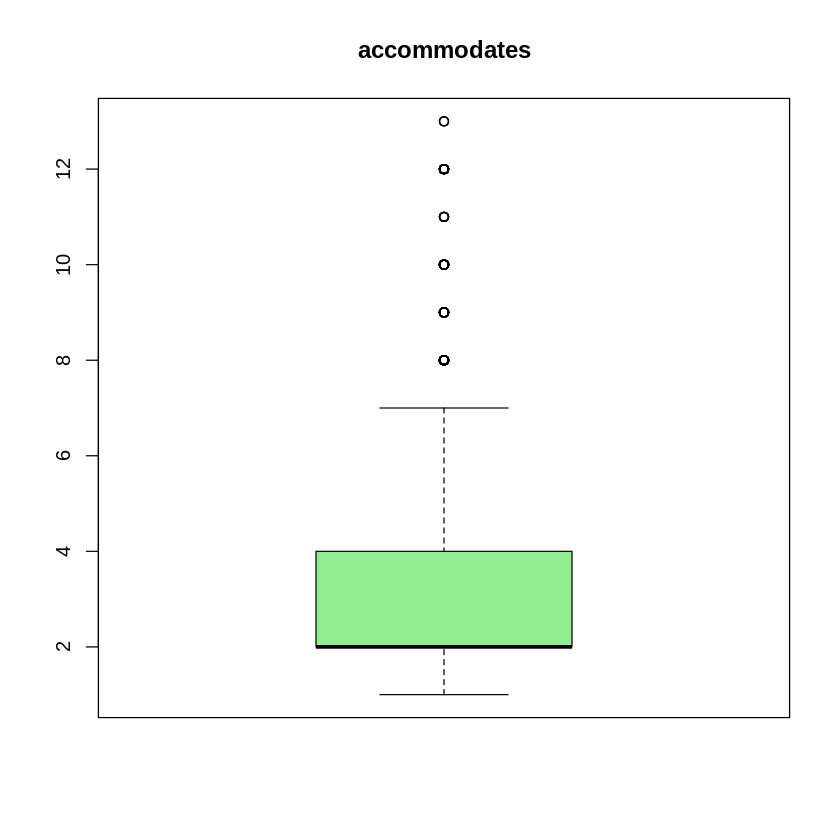

[1] "\n\n"


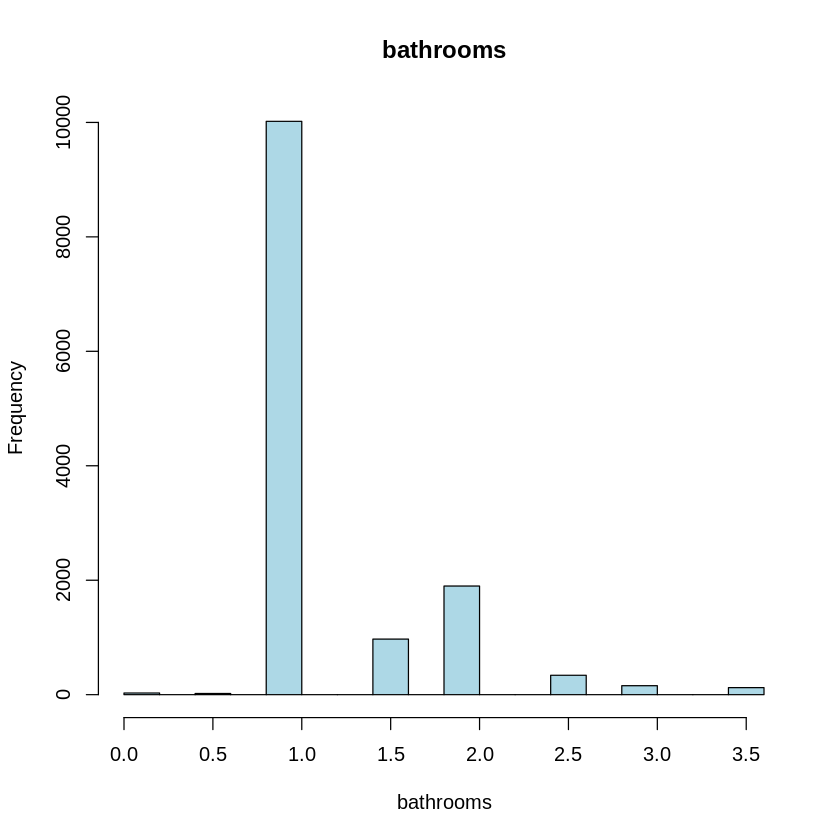

Skipping histogram for column: bathrooms_text 
Skipping boxplot for column: bathrooms_text 


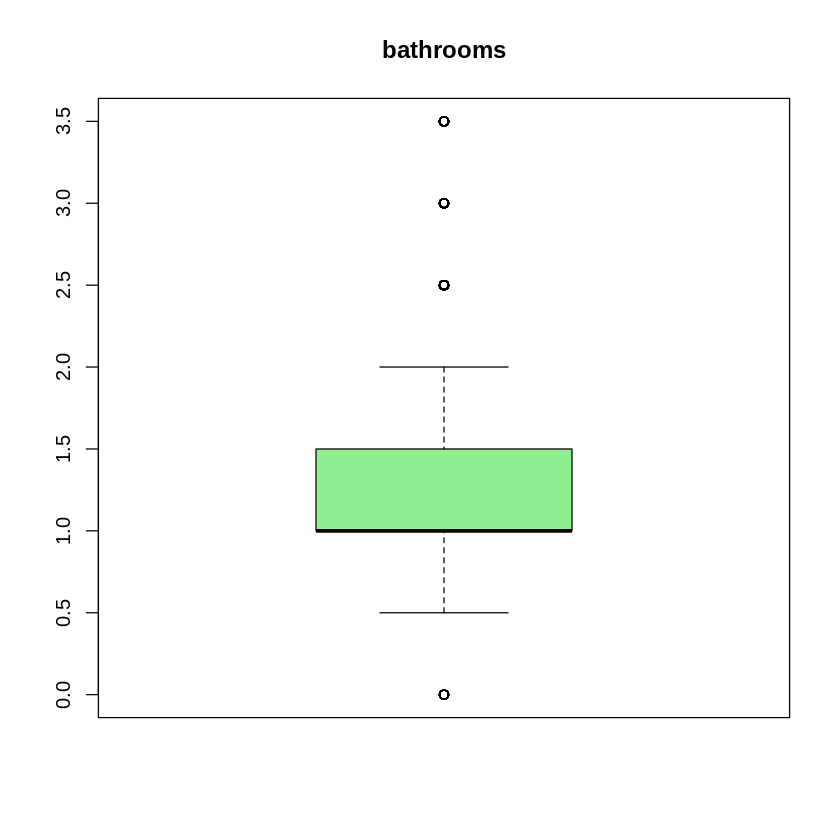

[1] "\n\n"


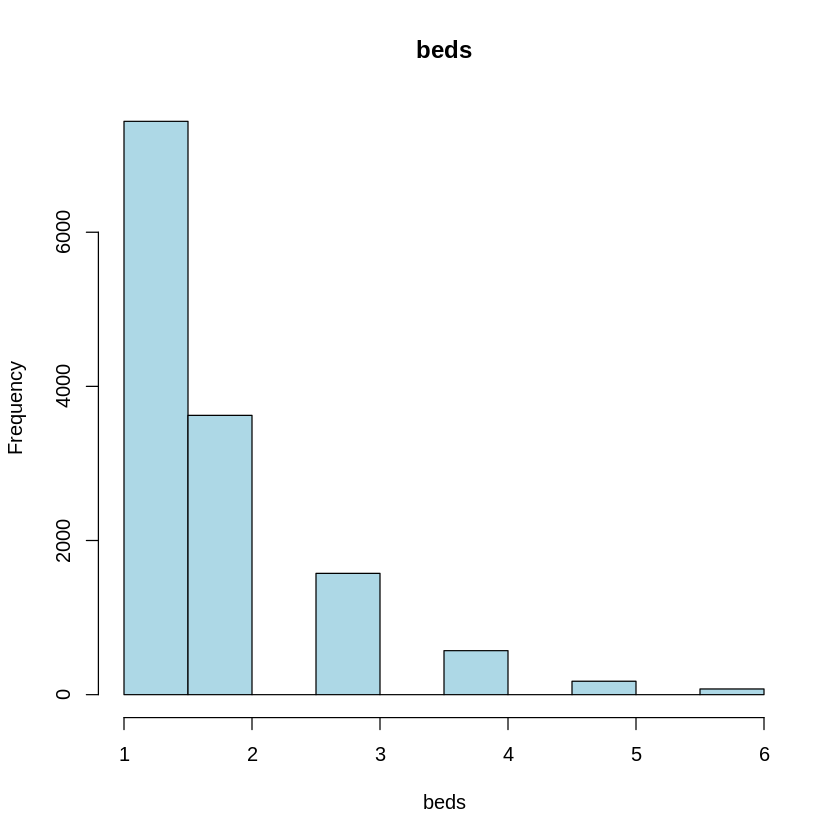

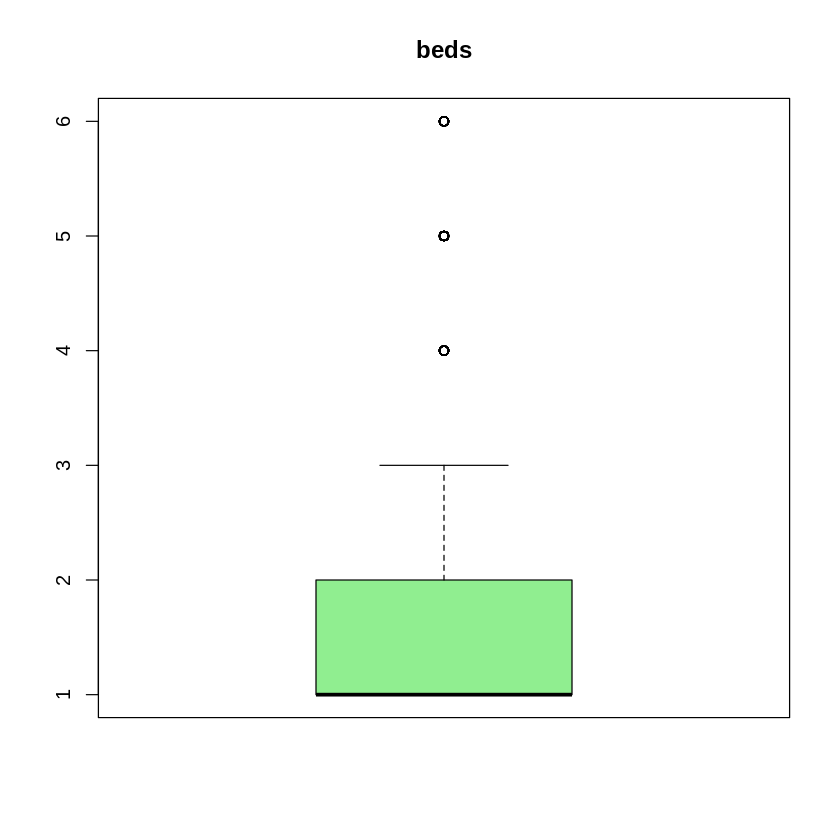

[1] "\n\n"


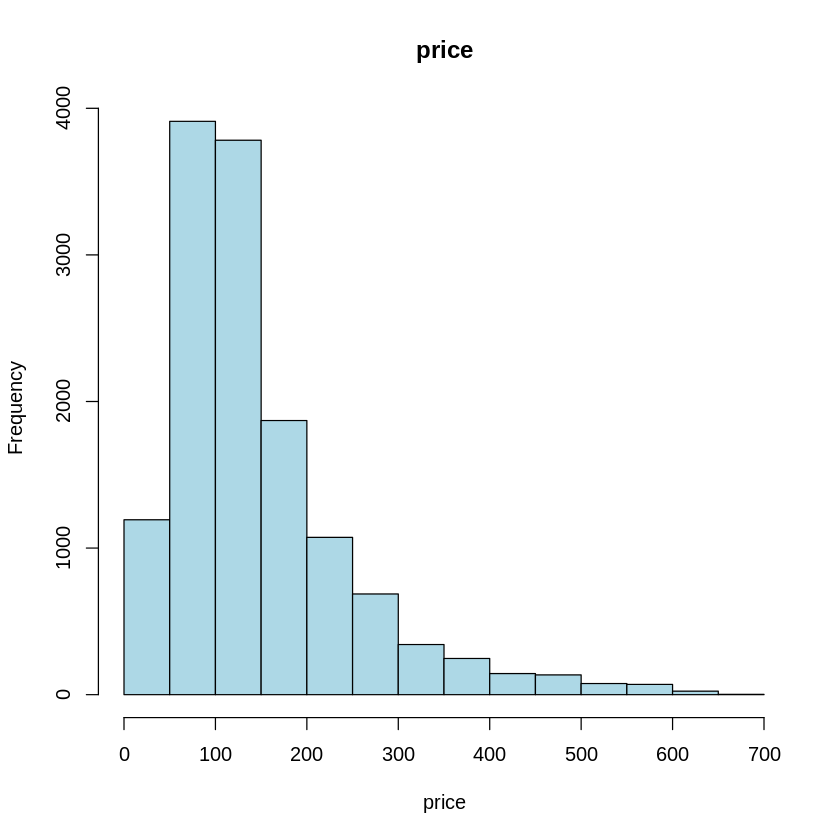

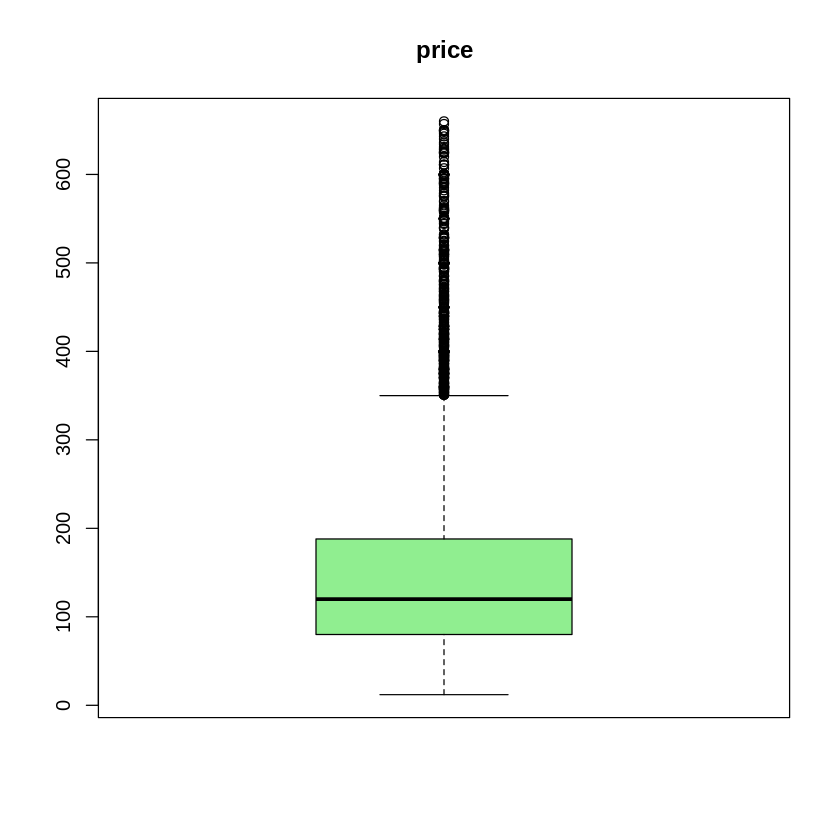

[1] "\n\n"


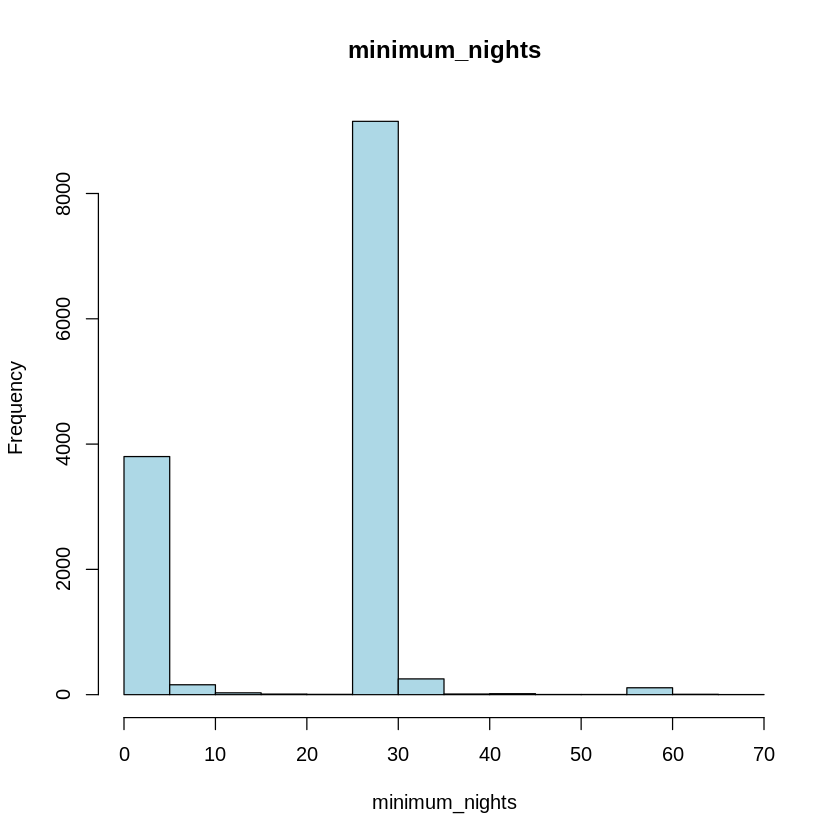

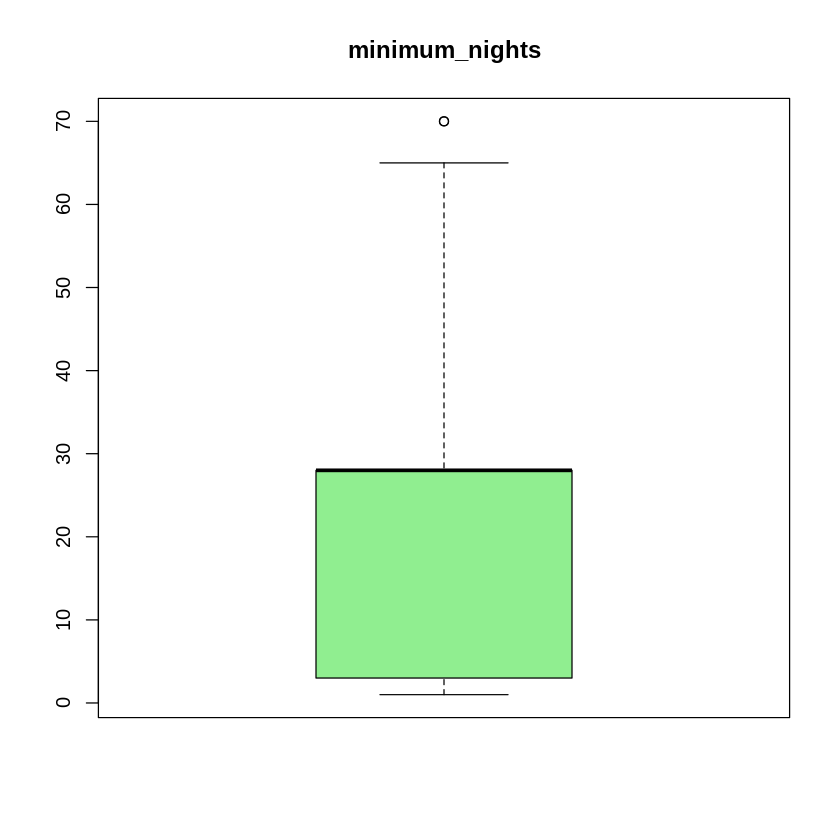

[1] "\n\n"


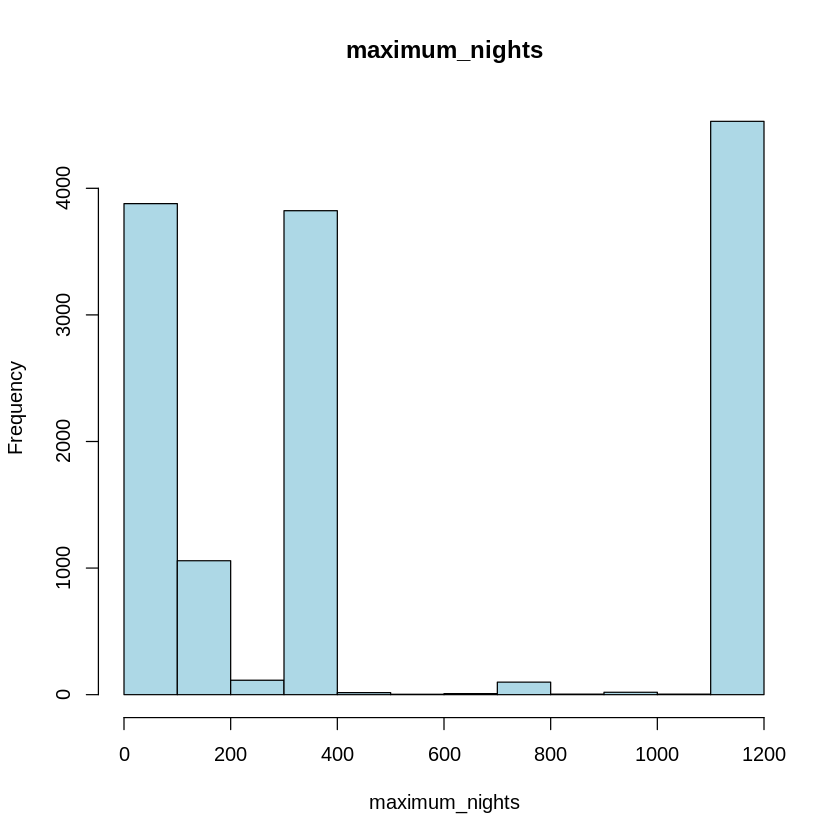

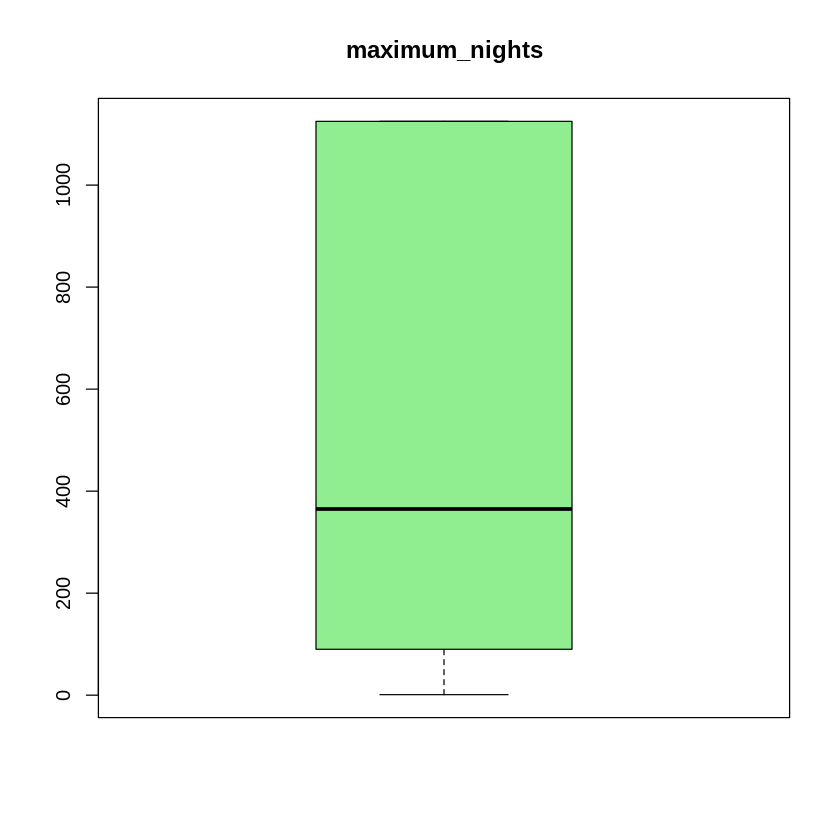

[1] "\n\n"


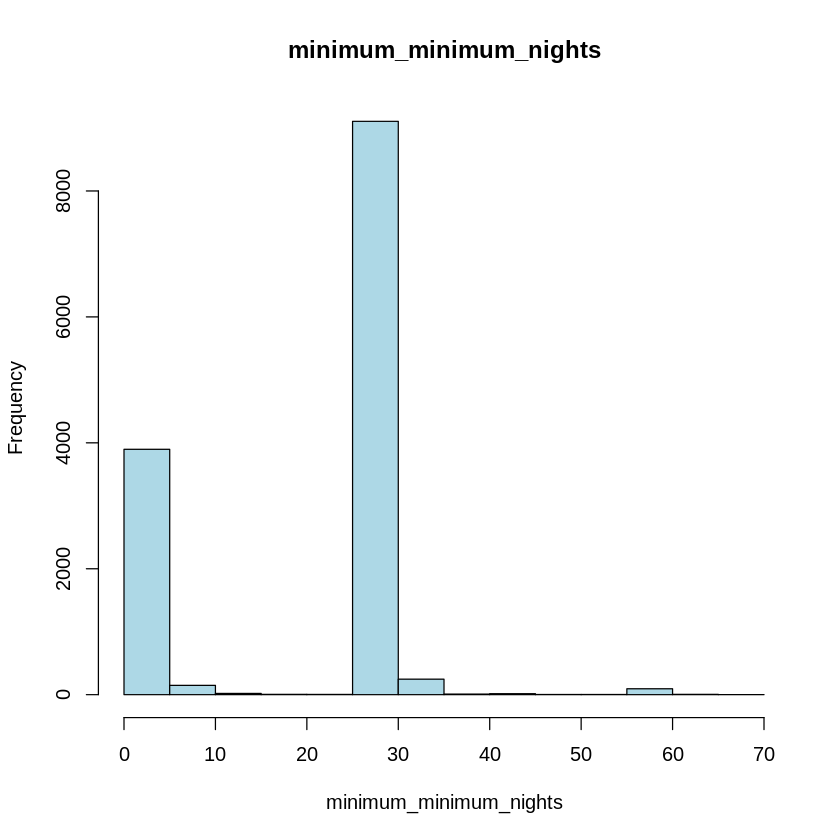

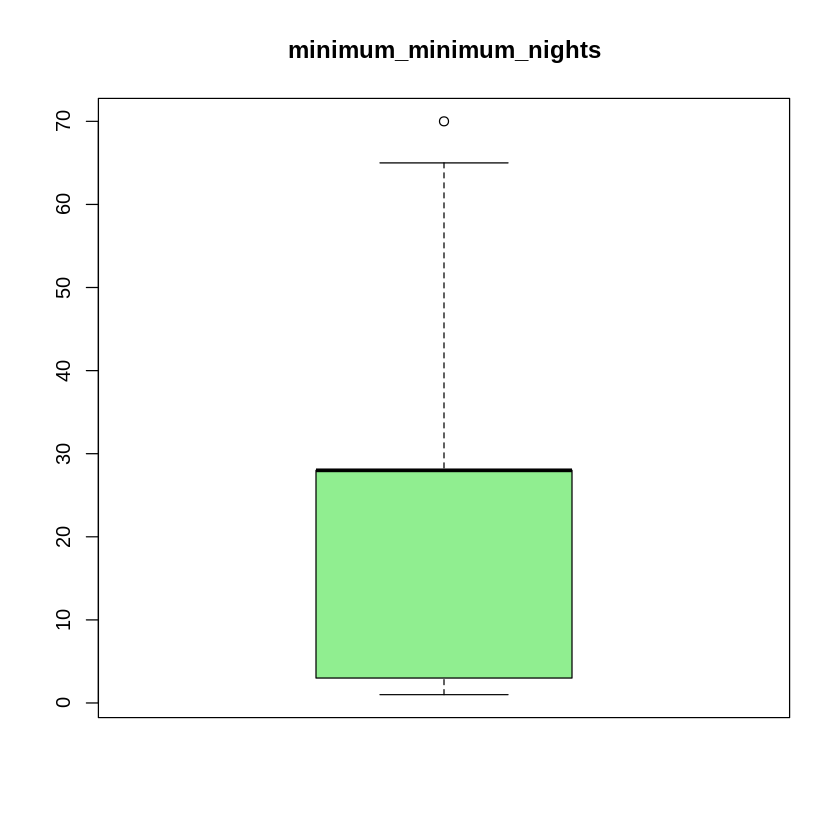

[1] "\n\n"


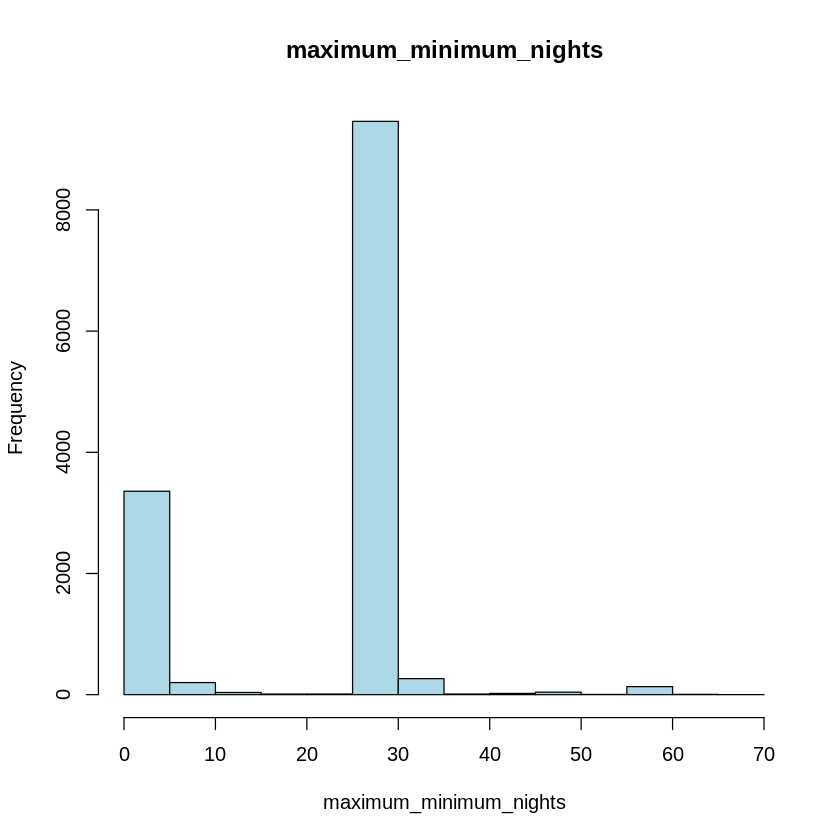

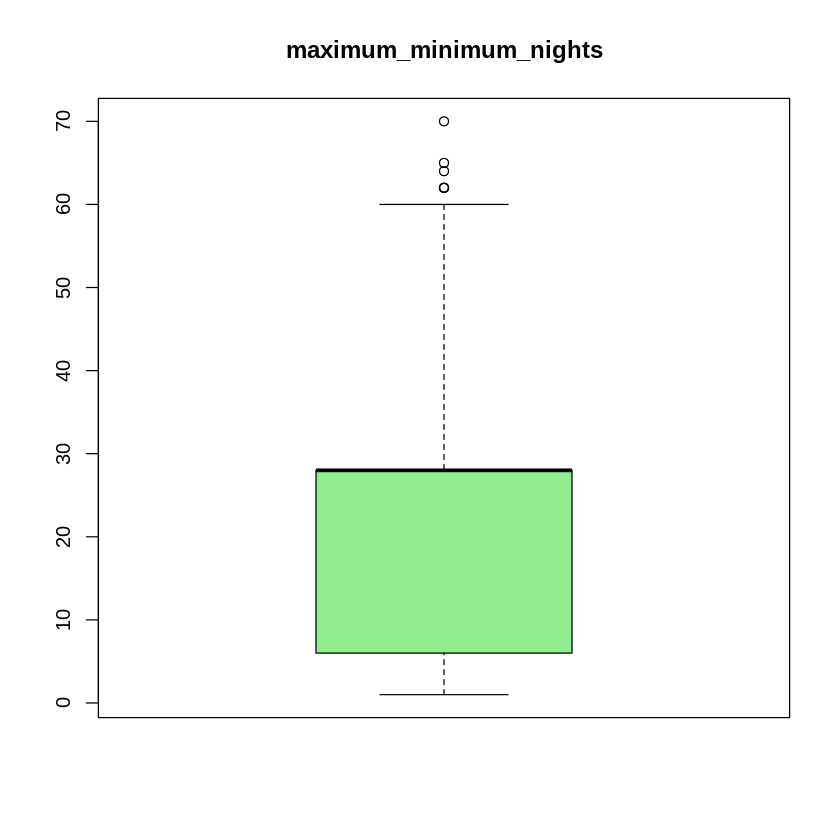

[1] "\n\n"


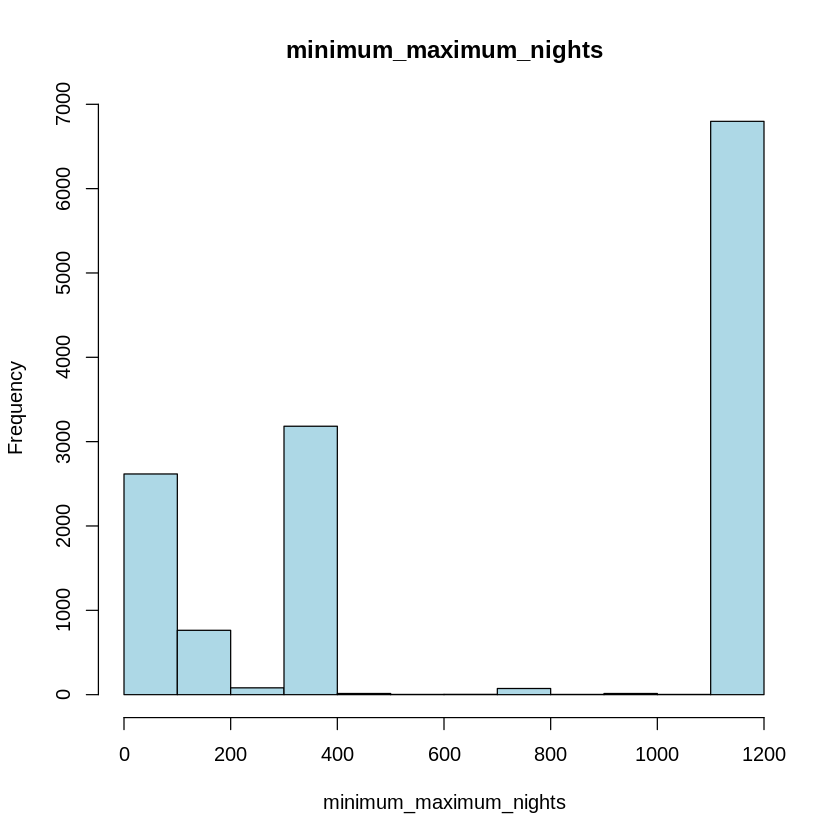

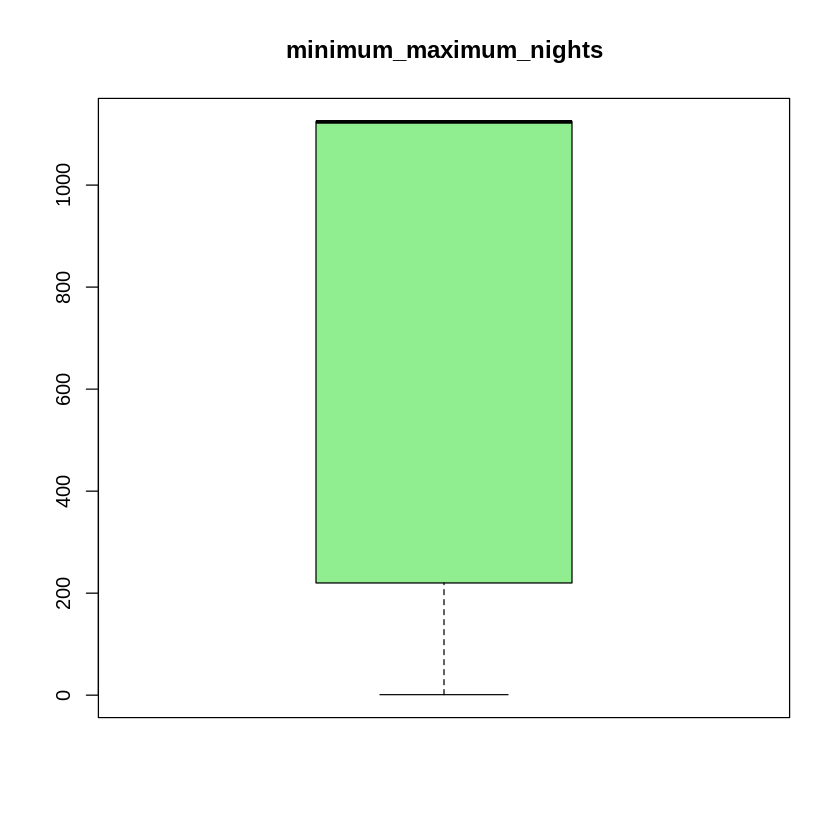

[1] "\n\n"


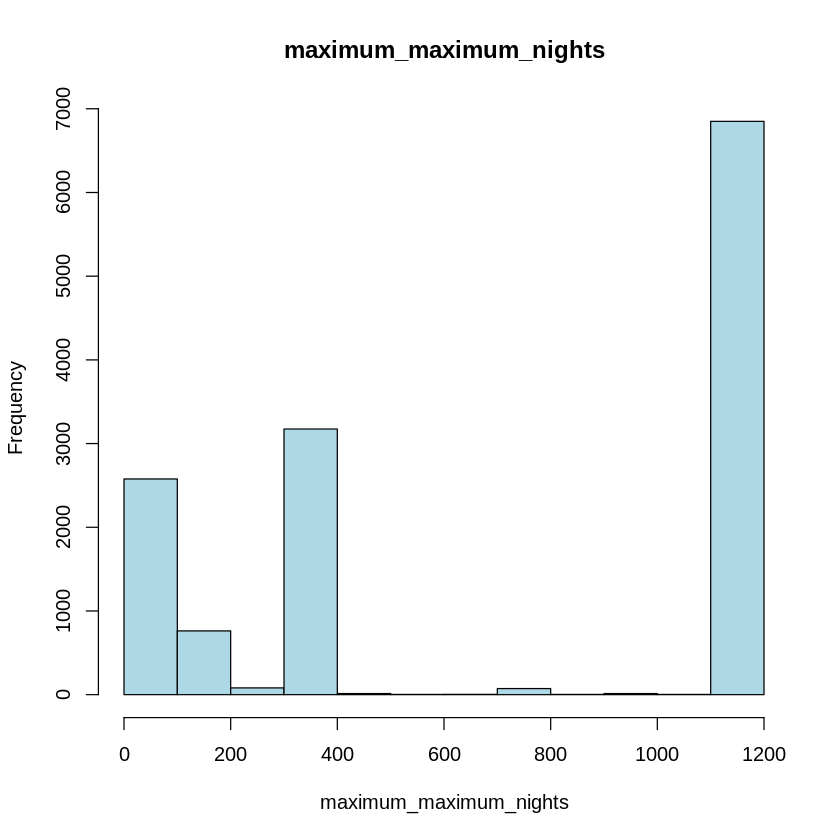

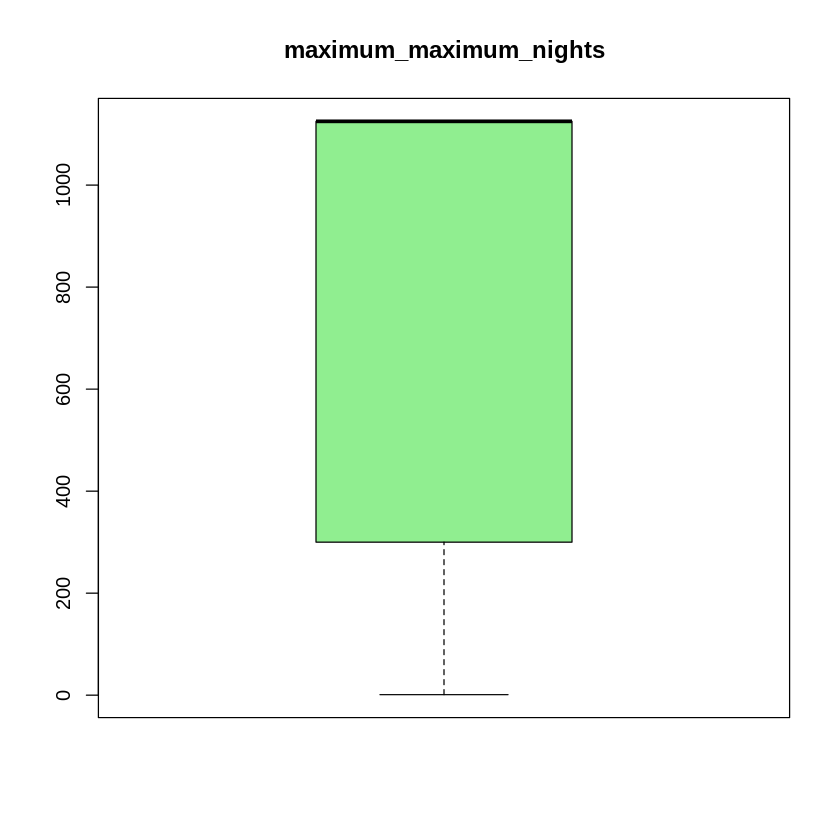

[1] "\n\n"


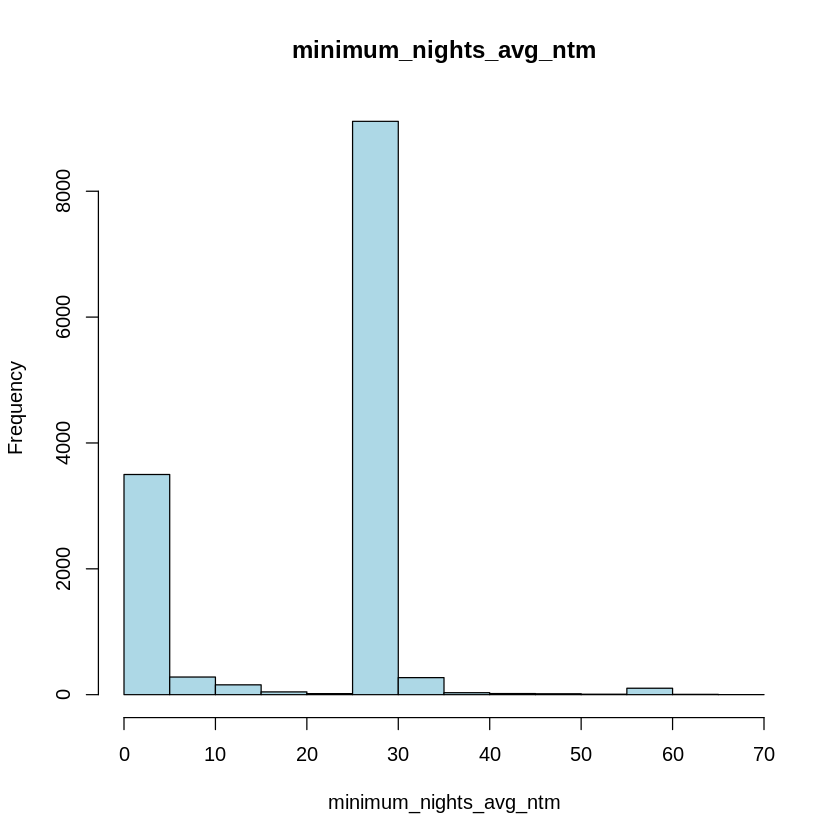

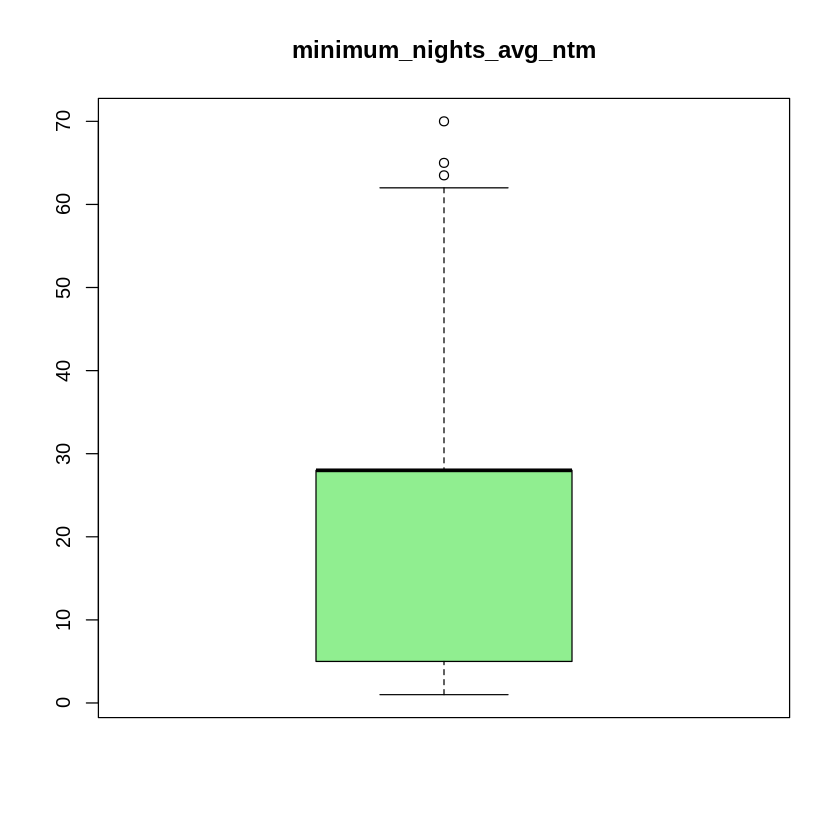

[1] "\n\n"


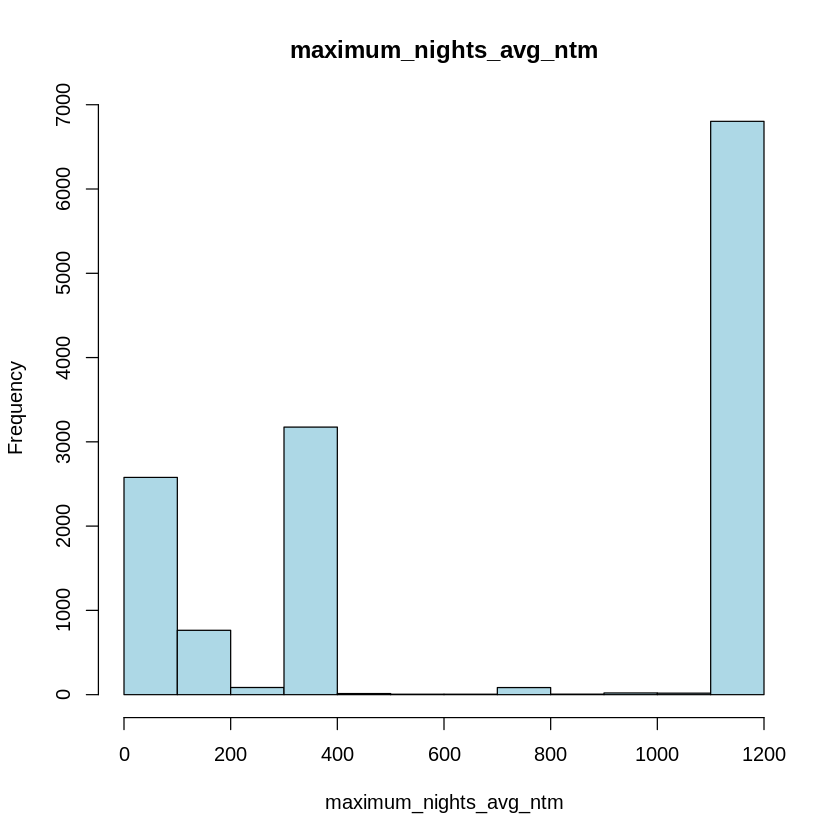

Skipping histogram for column: has_availability 


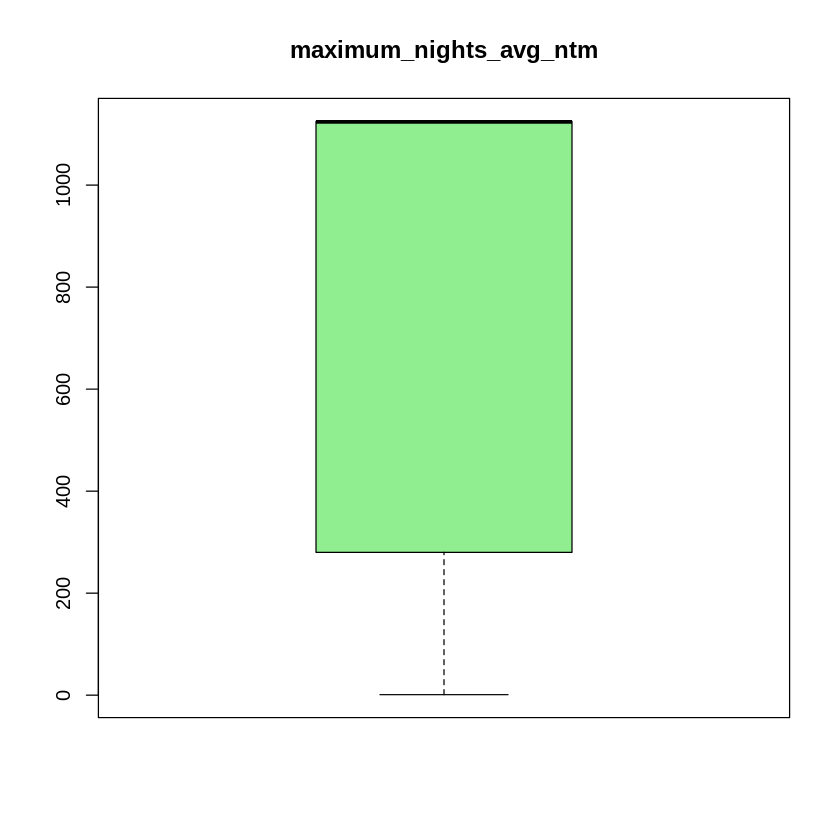

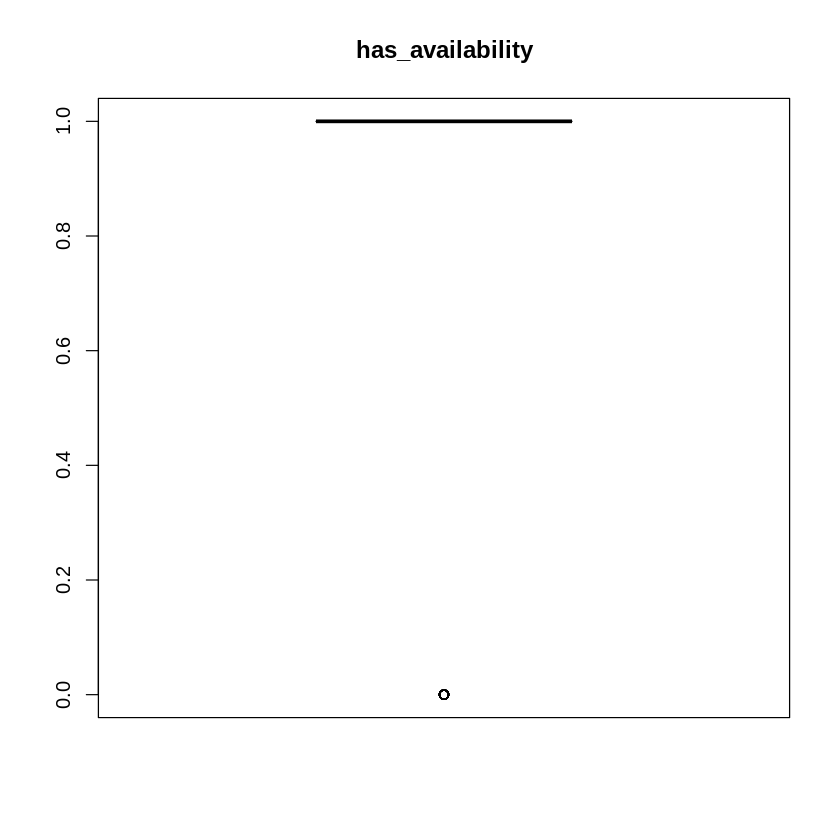

[1] "\n\n"


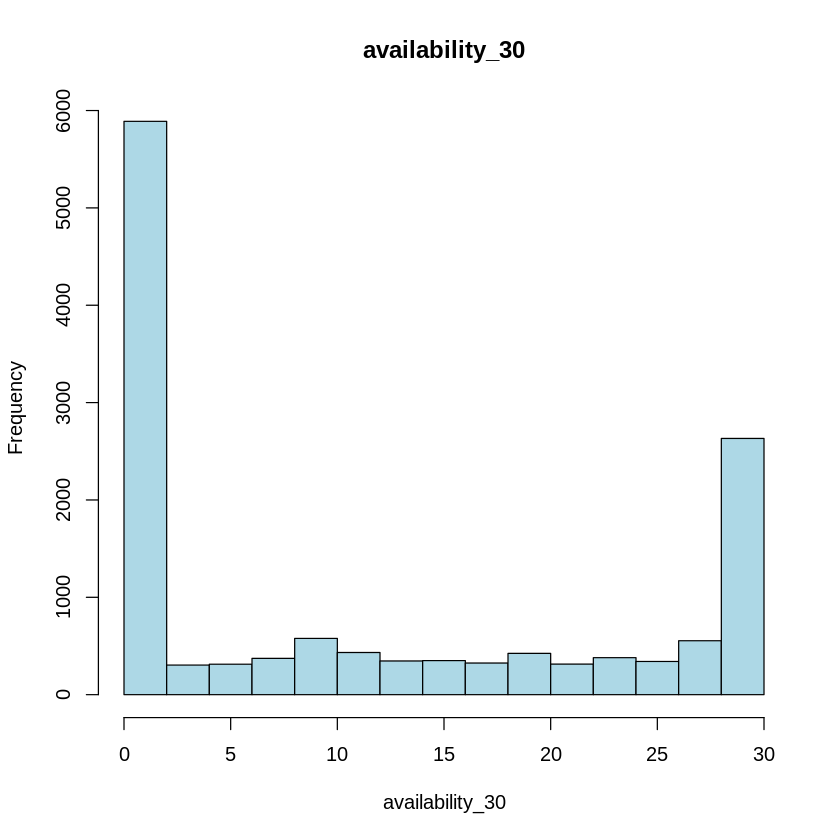

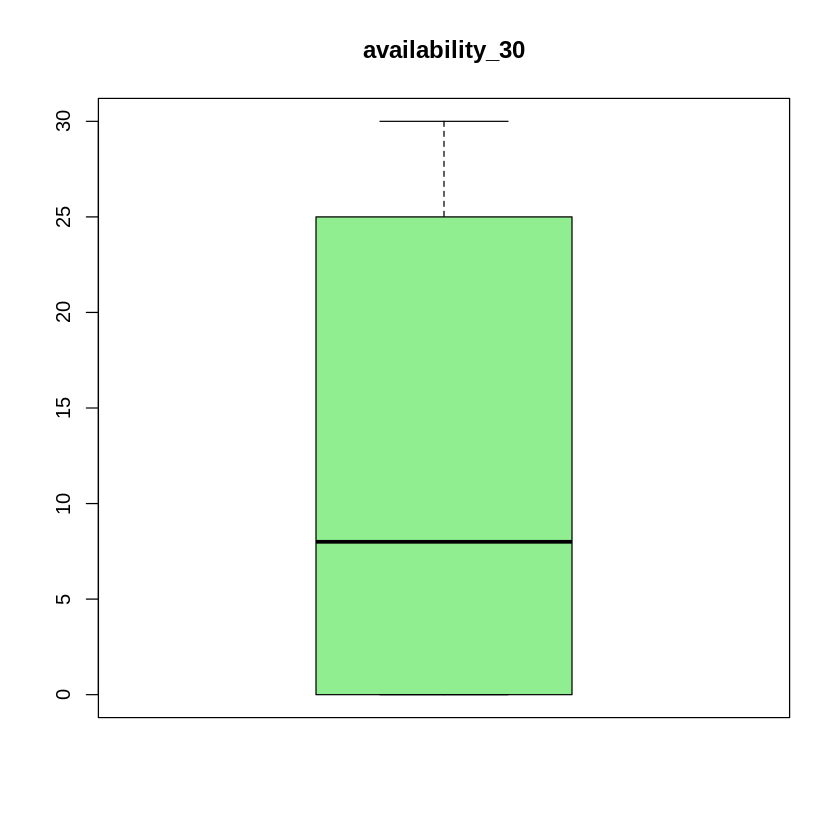

[1] "\n\n"


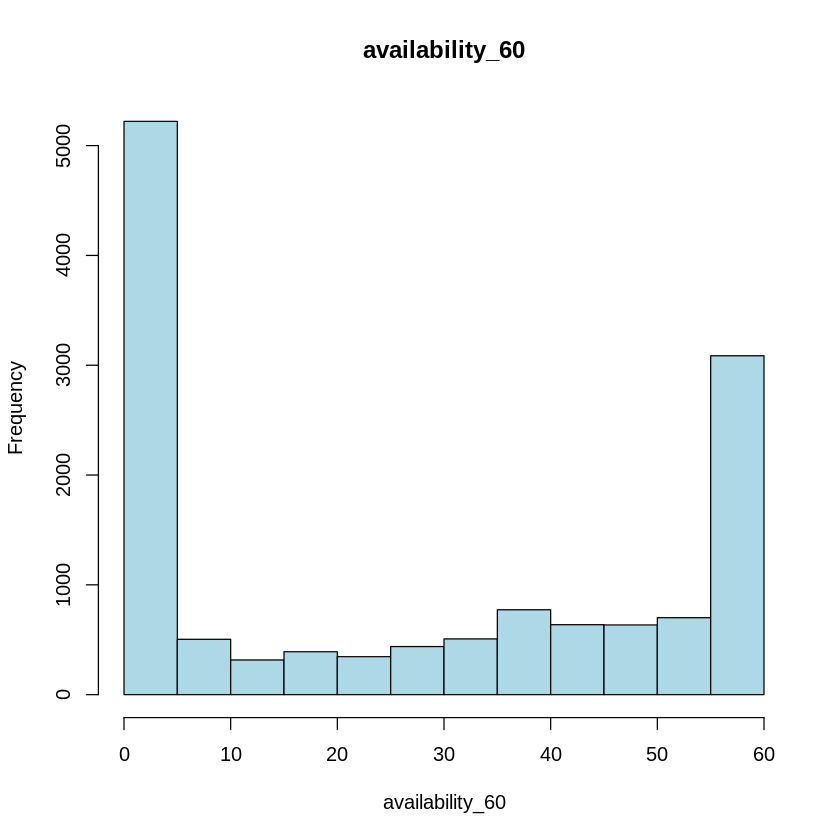

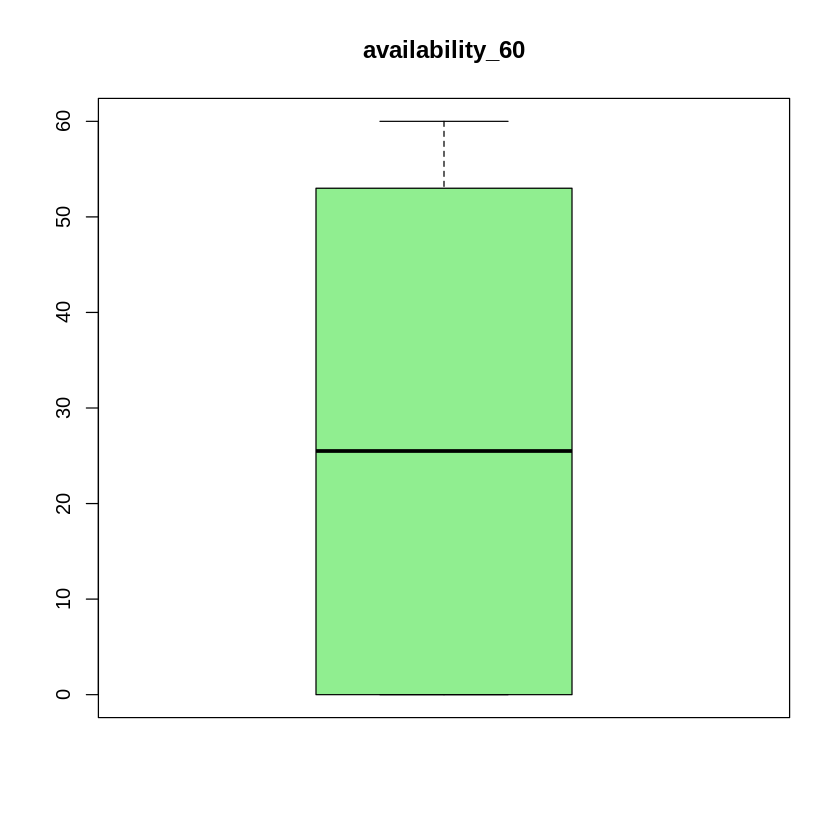

[1] "\n\n"


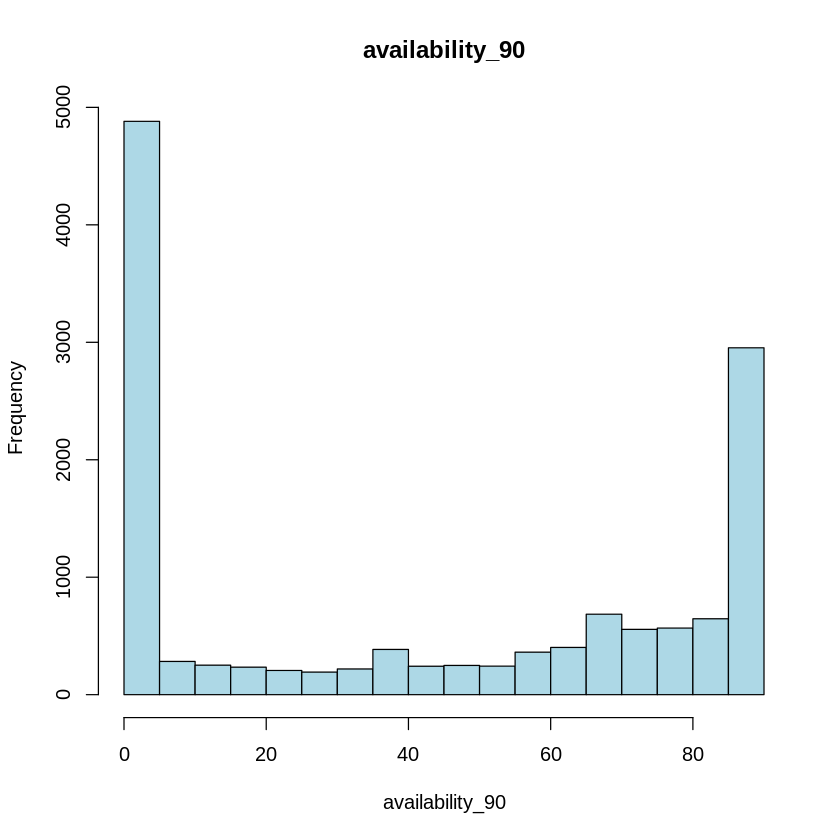

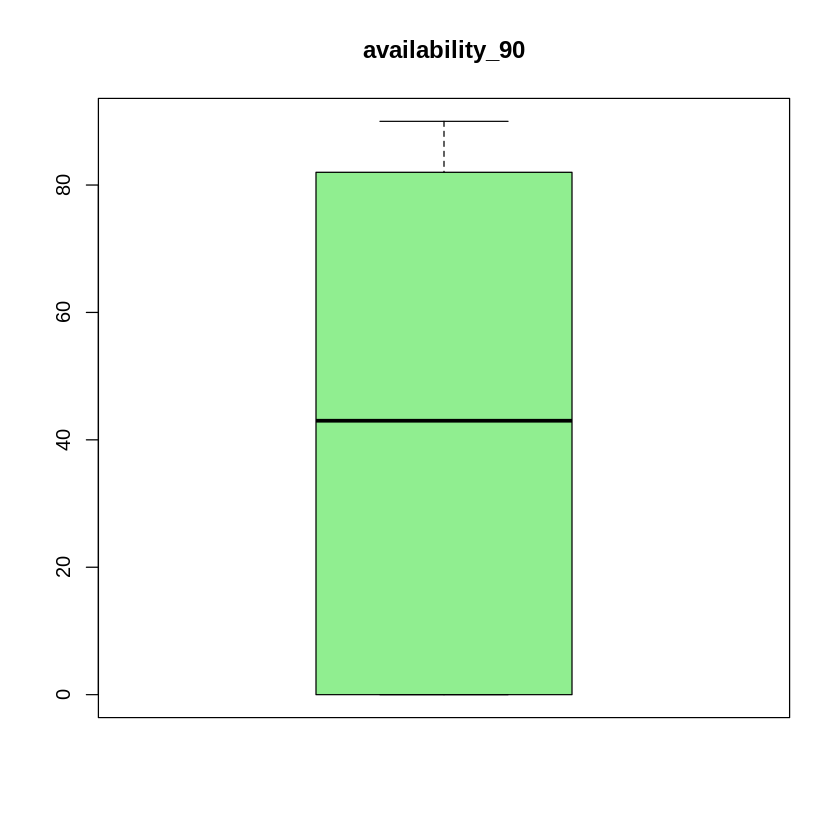

[1] "\n\n"


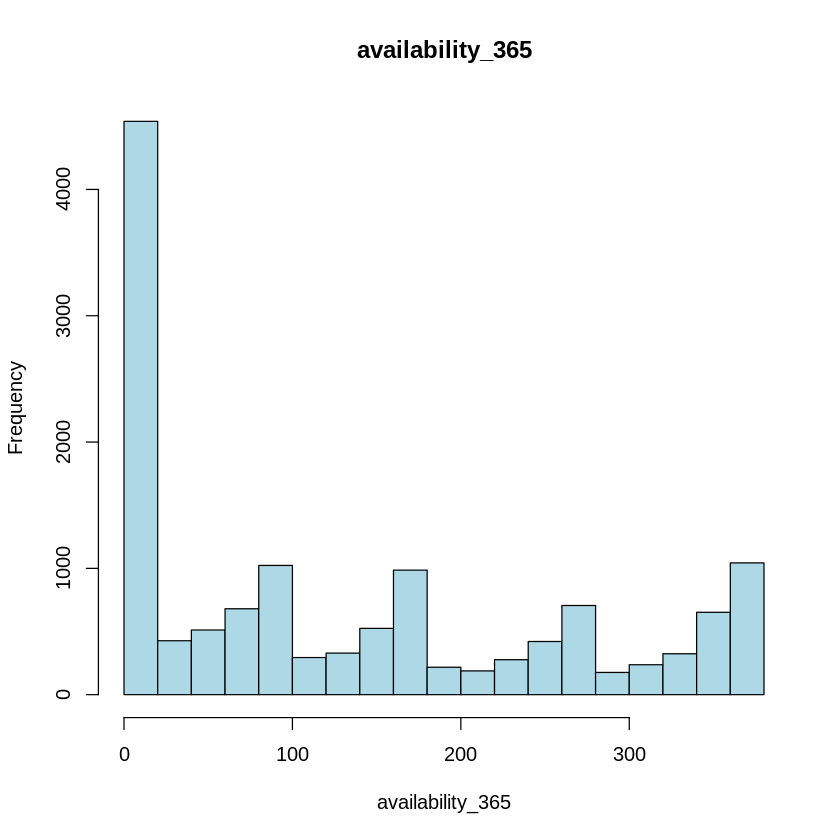

Skipping histogram for column: calendar_last_scraped 
Skipping boxplot for column: calendar_last_scraped 


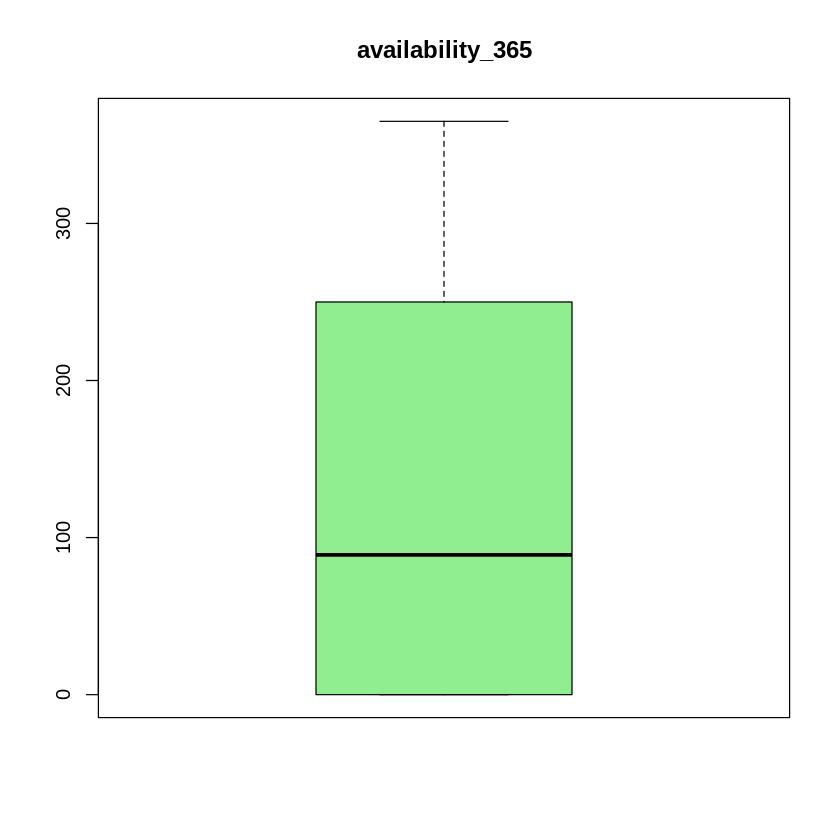

[1] "\n\n"


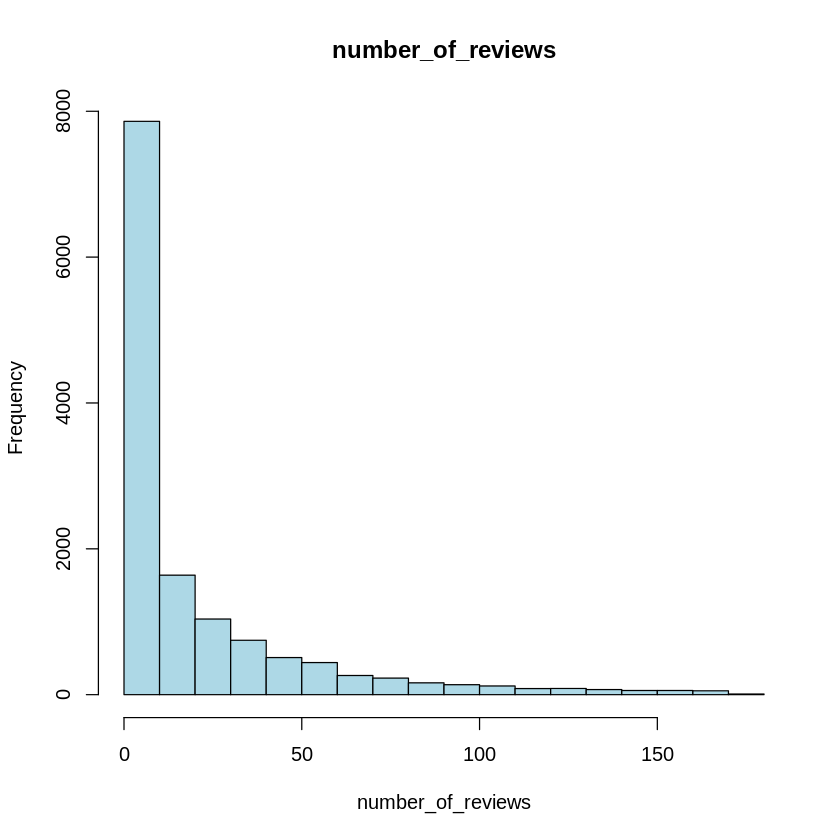

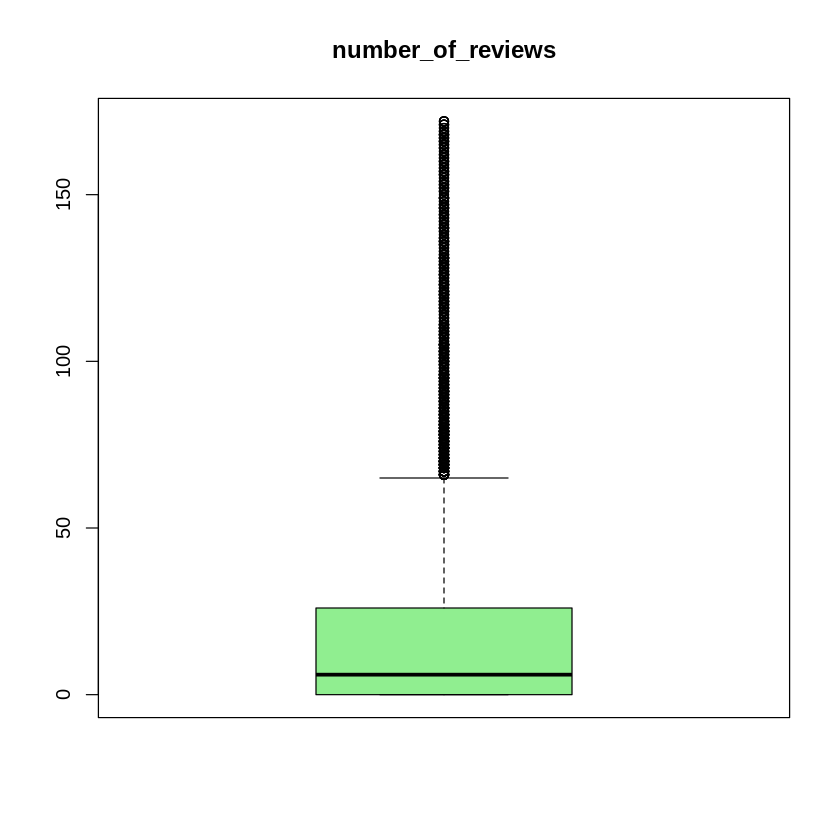

[1] "\n\n"


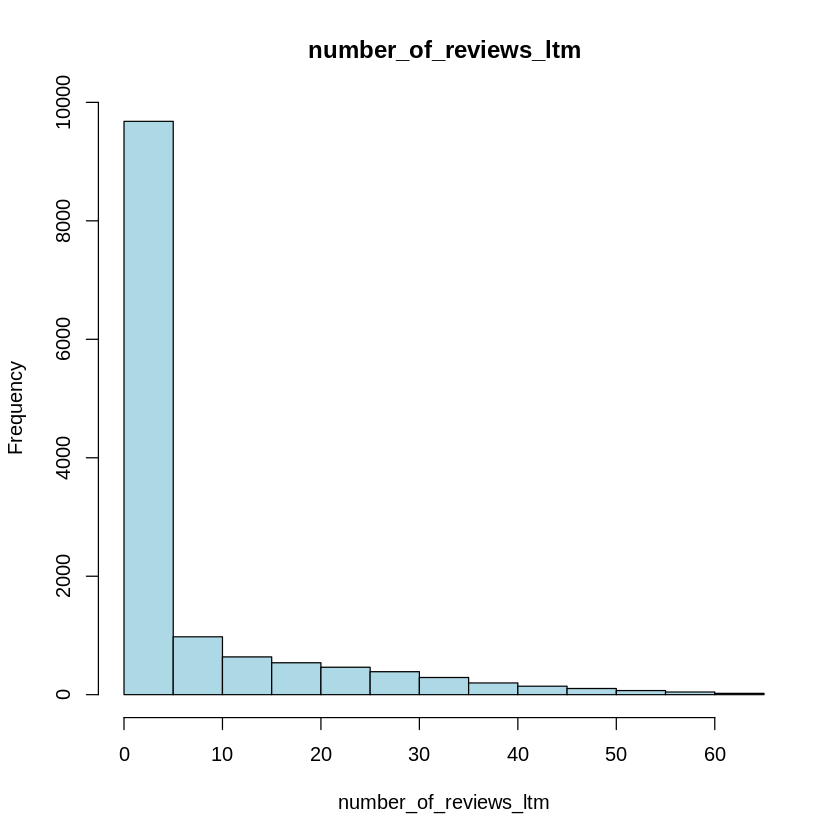

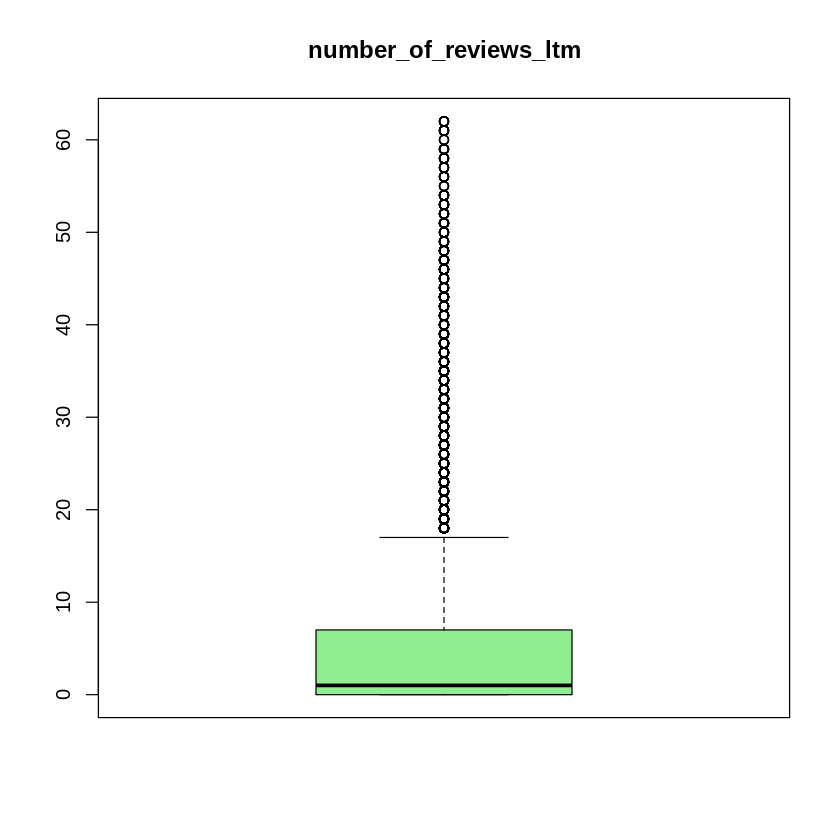

[1] "\n\n"


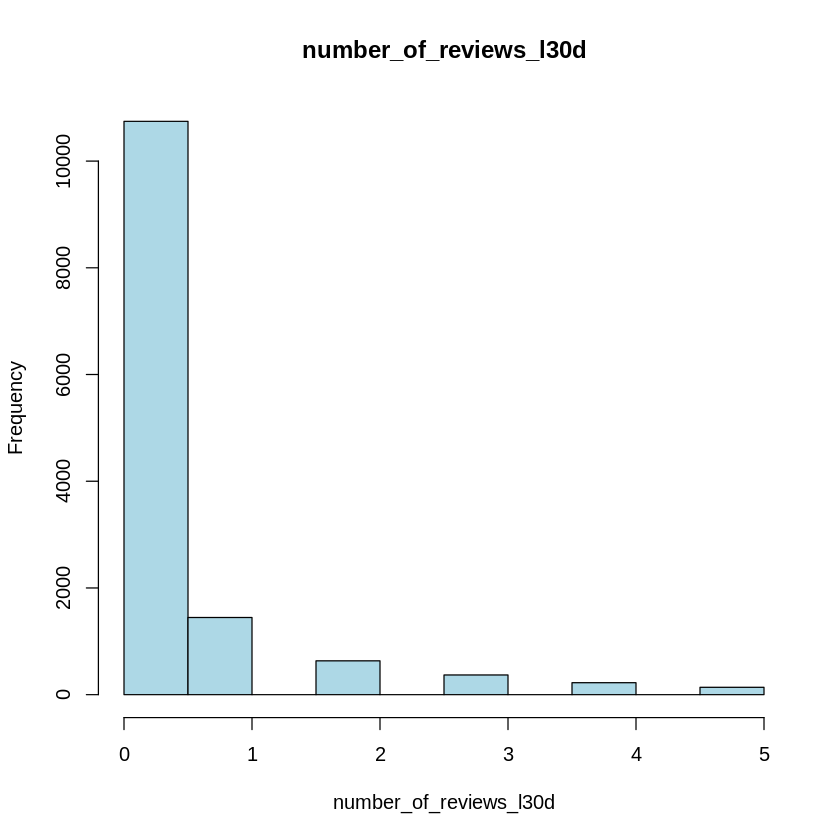

Skipping histogram for column: first_review 


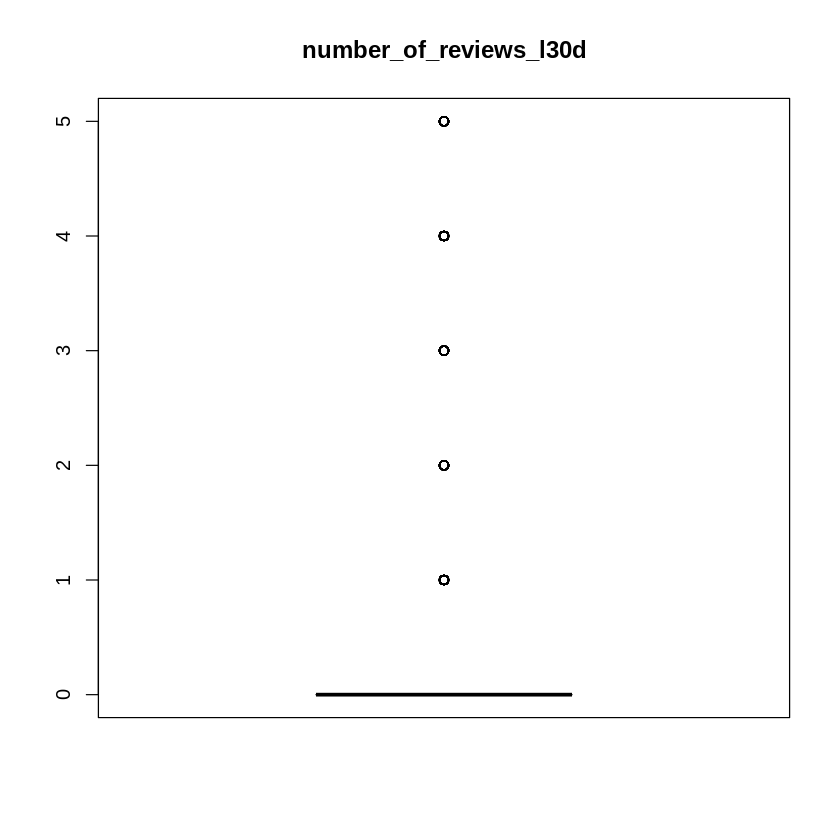

Skipping histogram for column: last_review 


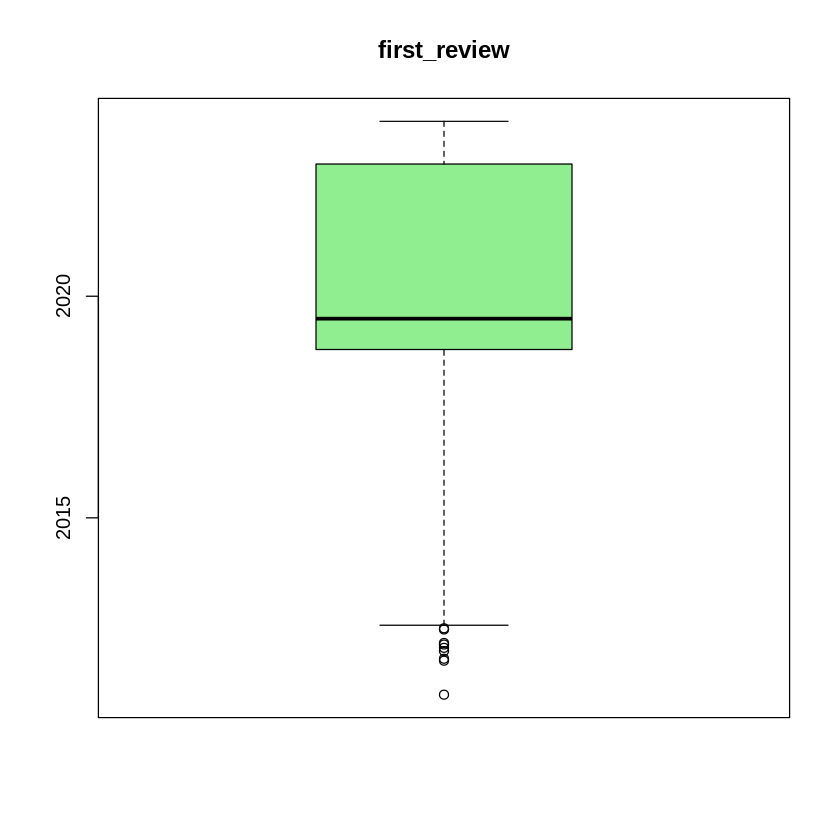

Skipping histogram for column: review_scores_rating 
Skipping boxplot for column: review_scores_rating 


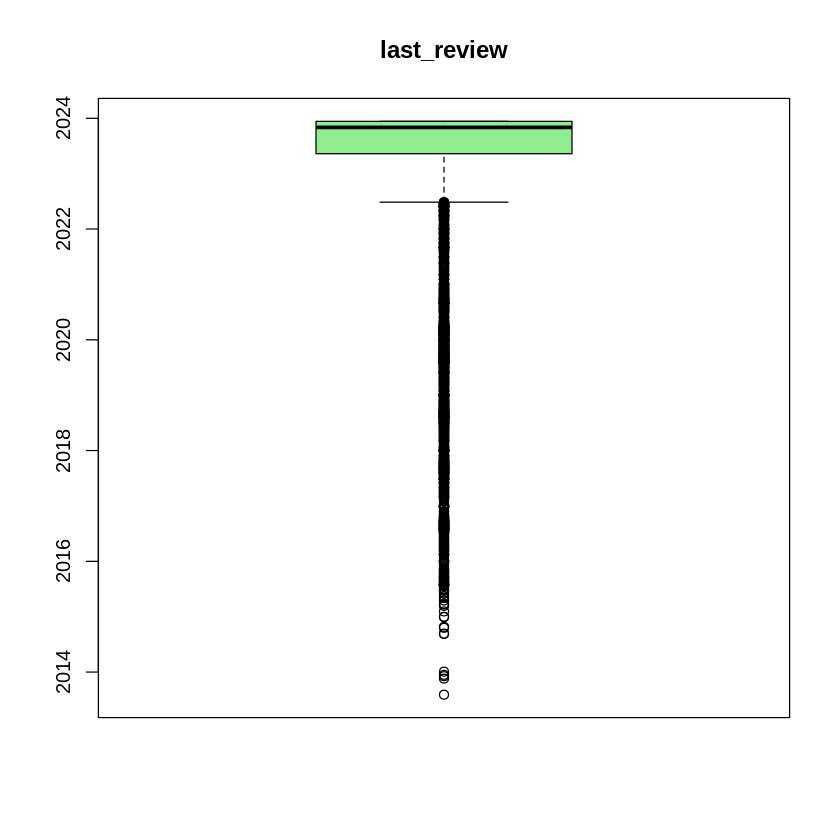

[1] "\n\n"


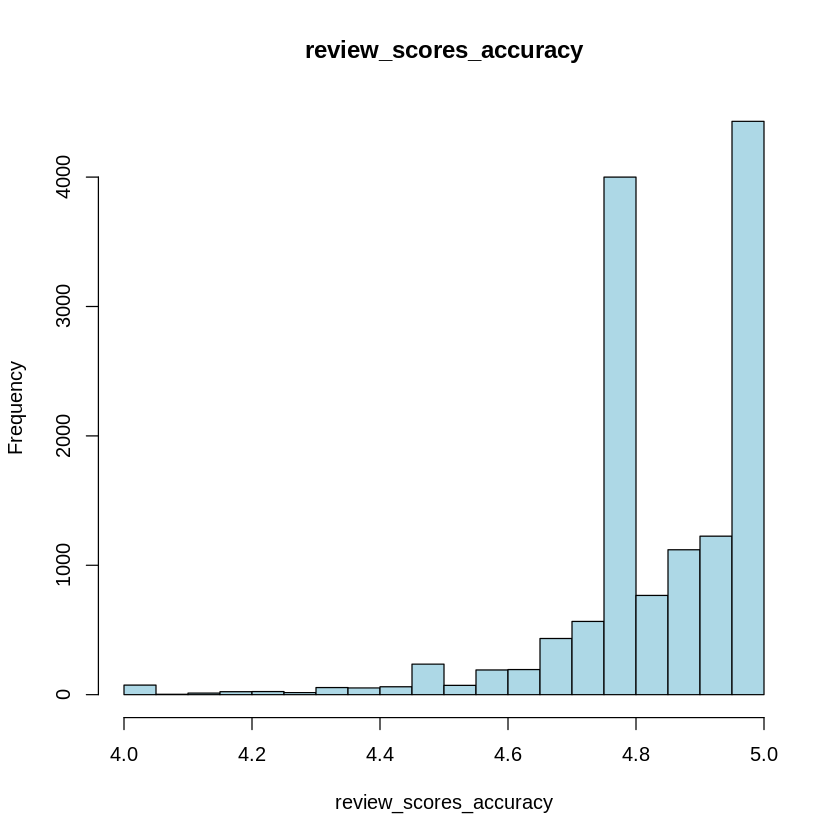

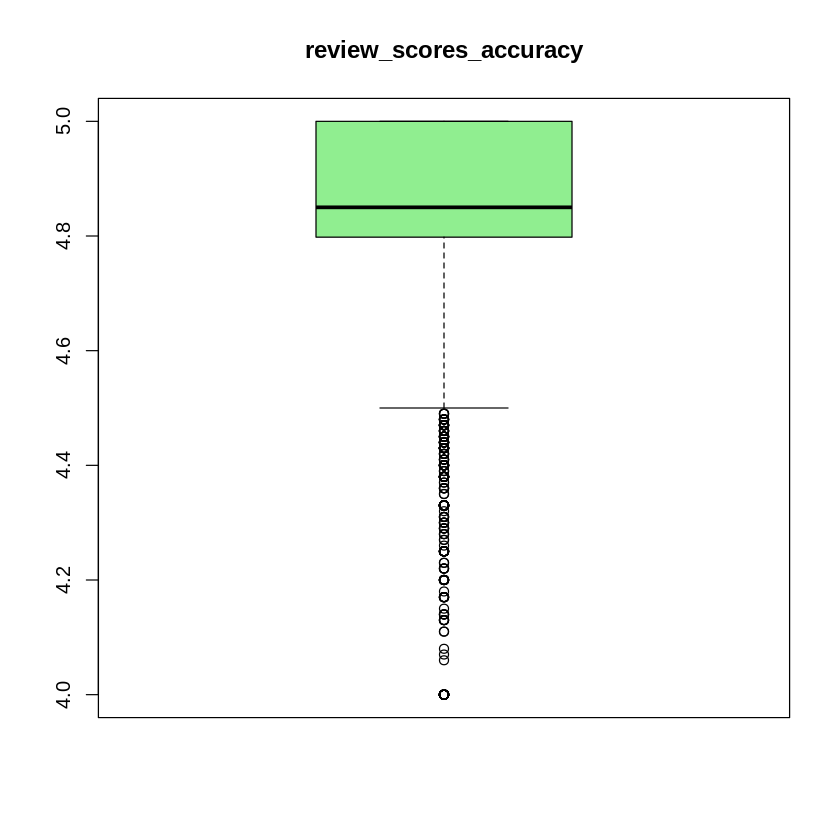

[1] "\n\n"


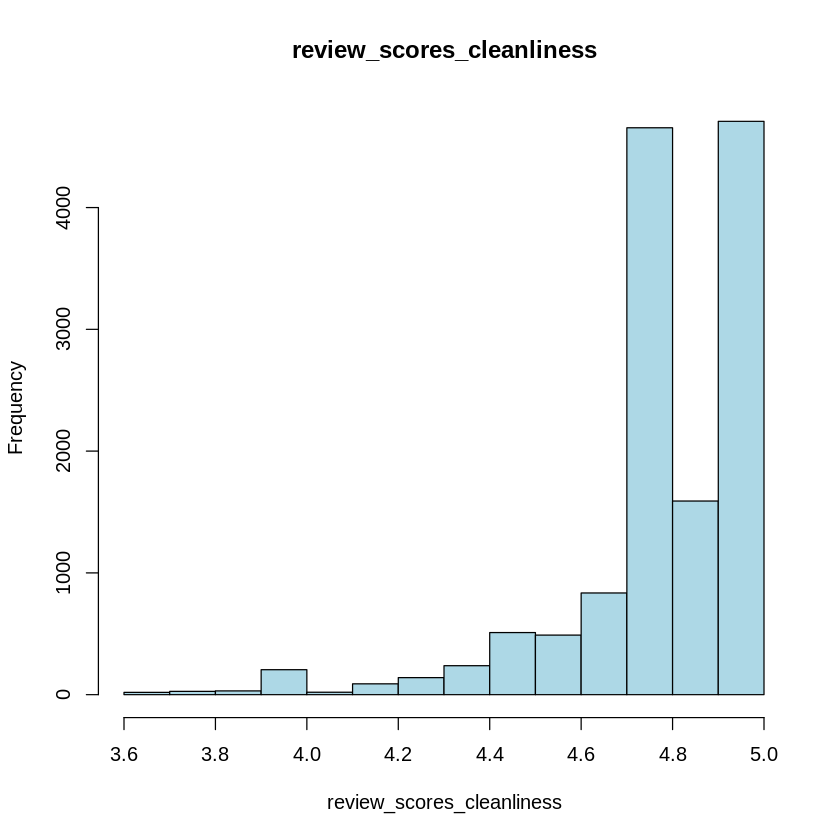

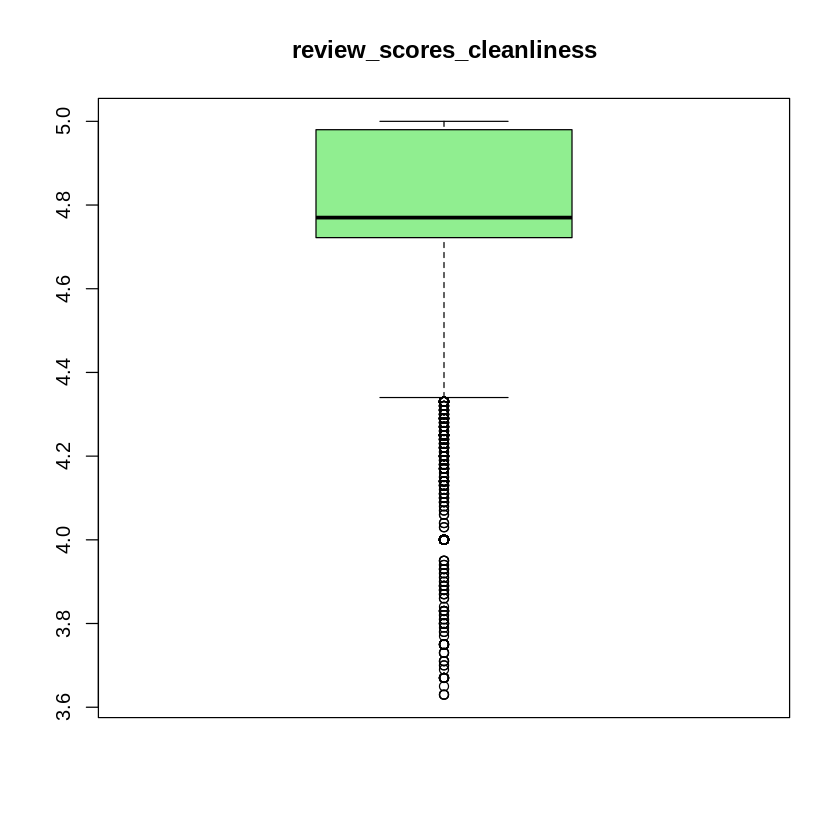

[1] "\n\n"


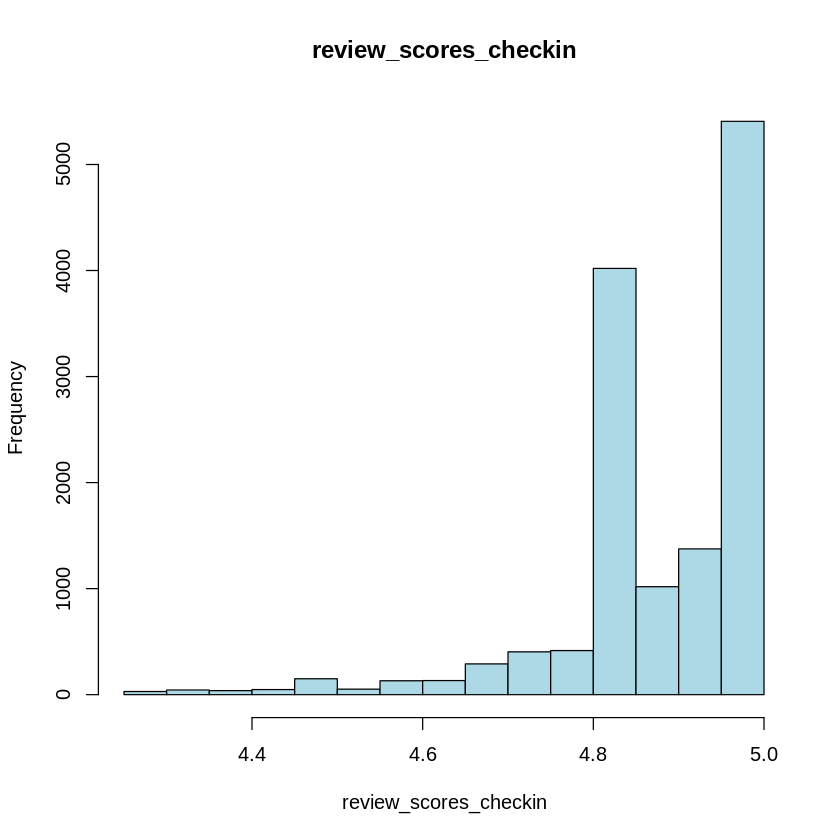

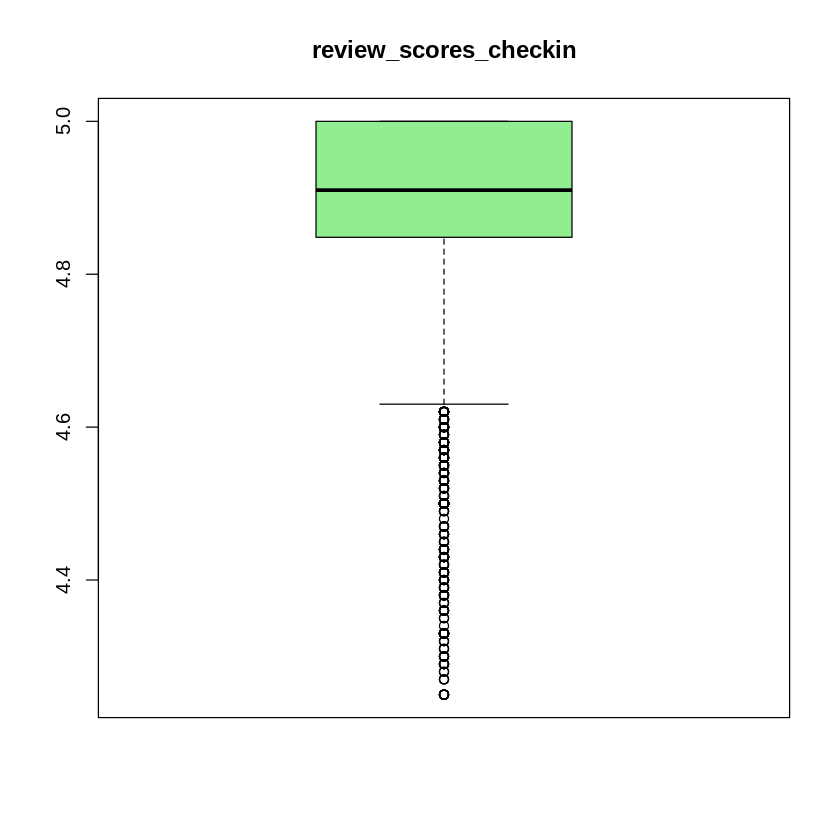

[1] "\n\n"


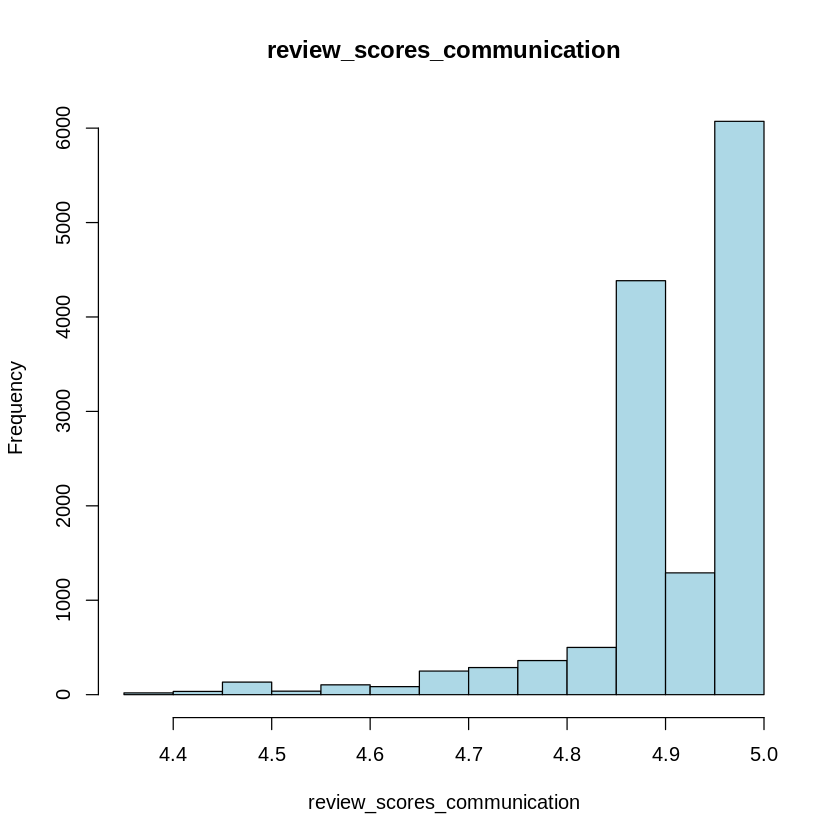

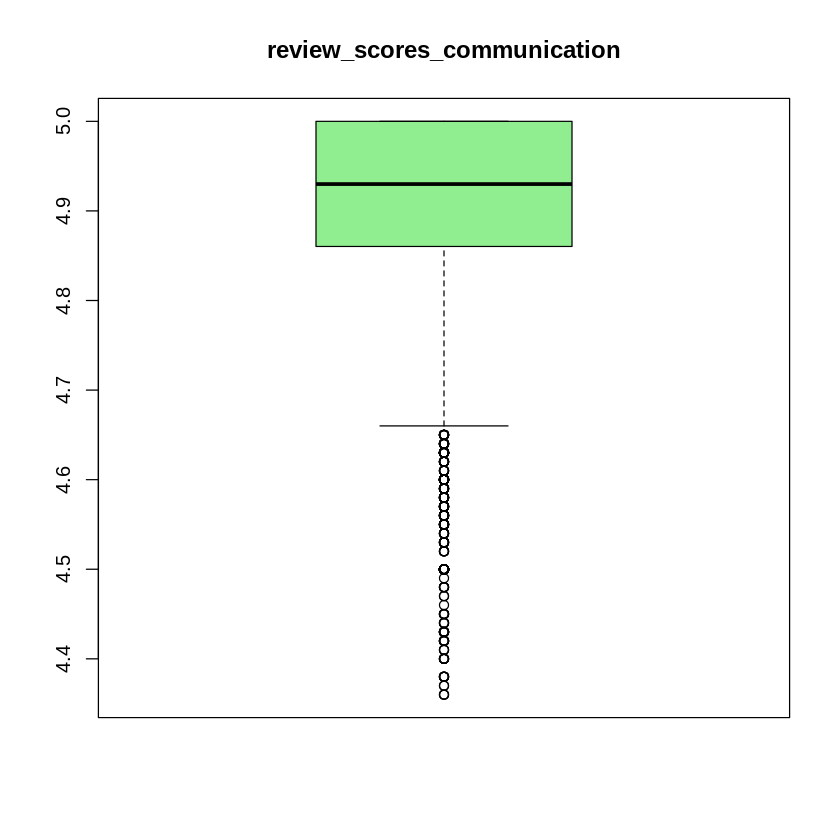

[1] "\n\n"


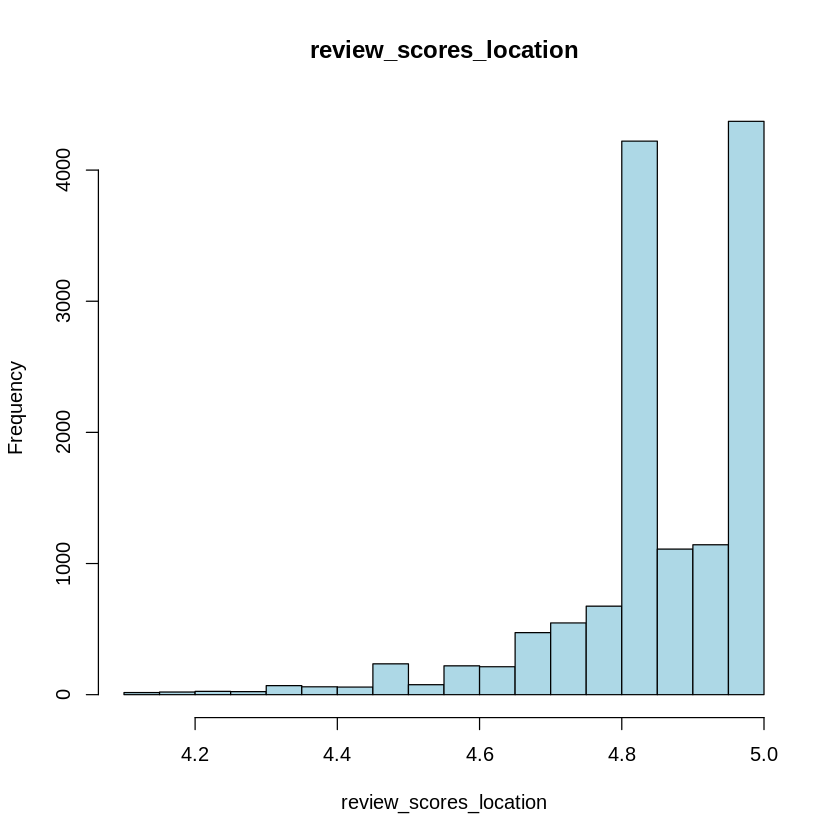

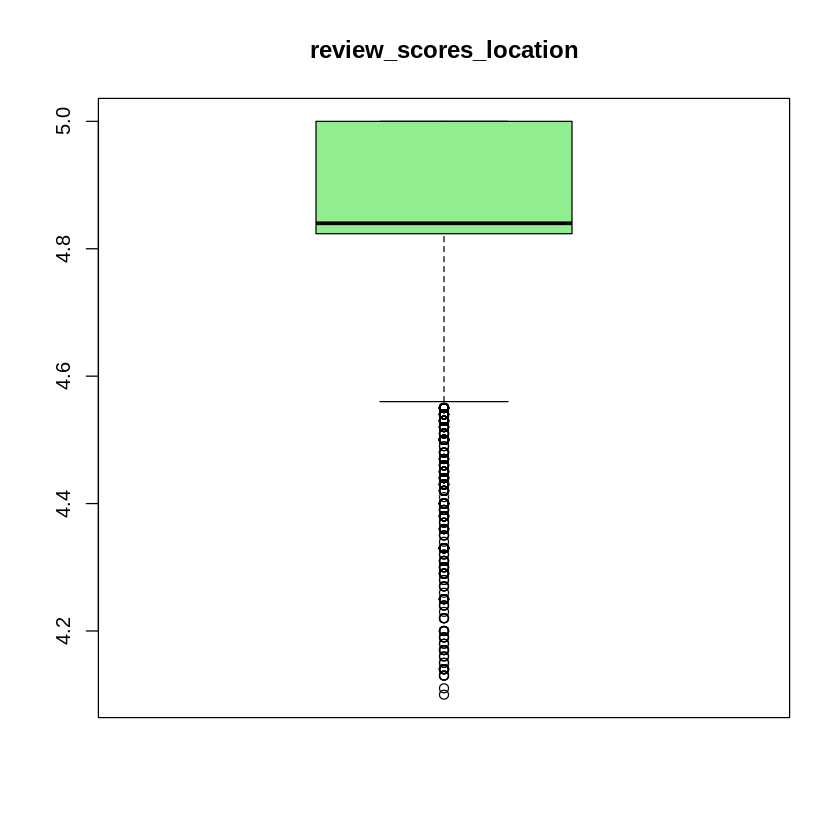

[1] "\n\n"


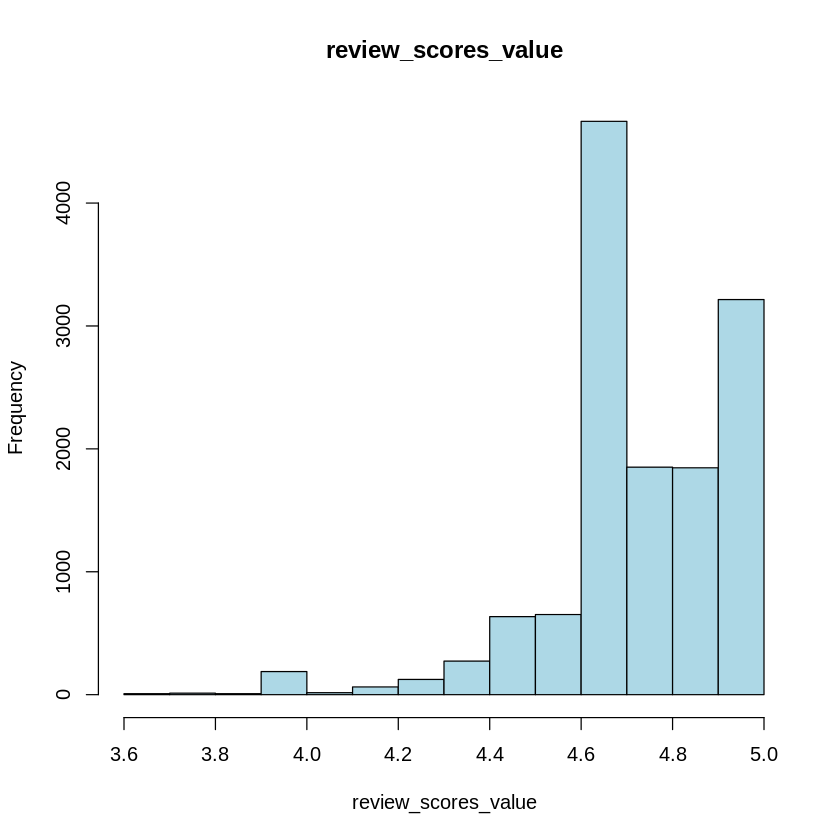

Skipping histogram for column: license 
Skipping boxplot for column: license 
Skipping histogram for column: instant_bookable 


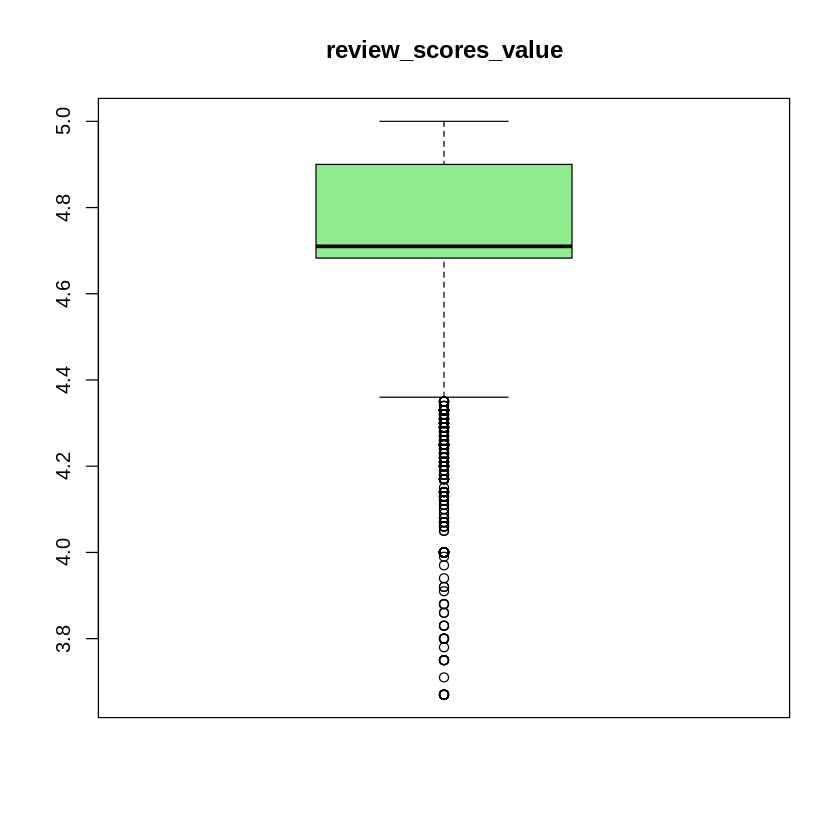

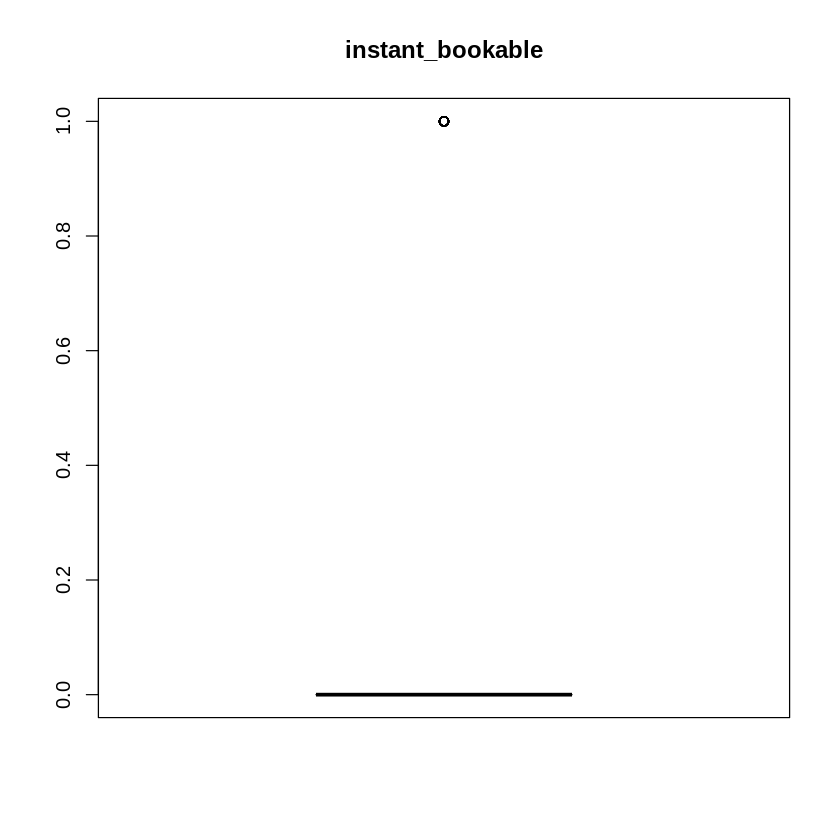

[1] "\n\n"


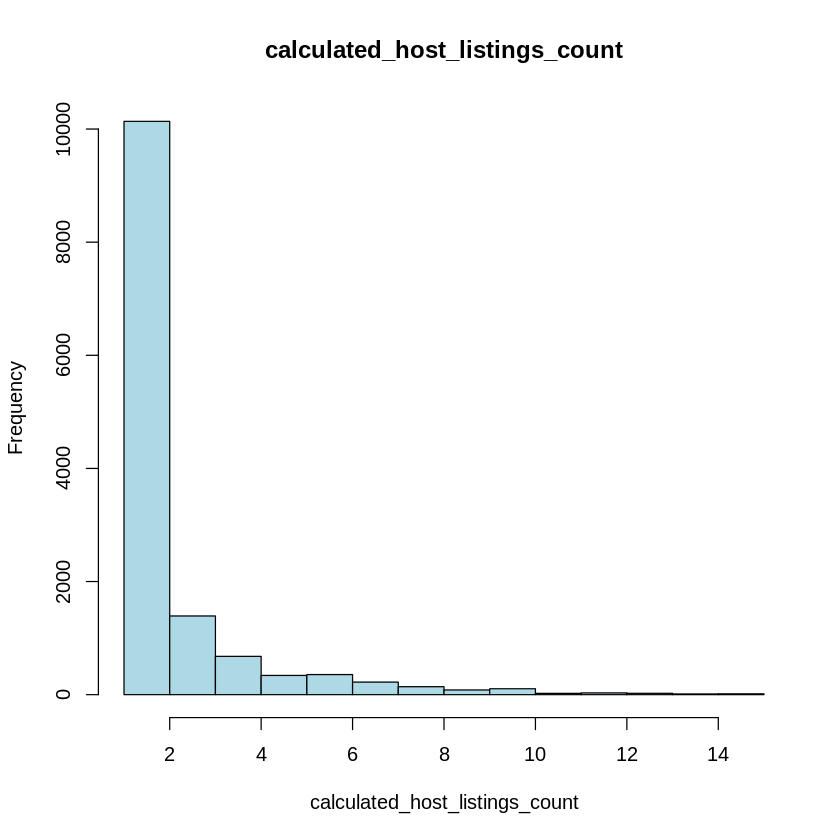

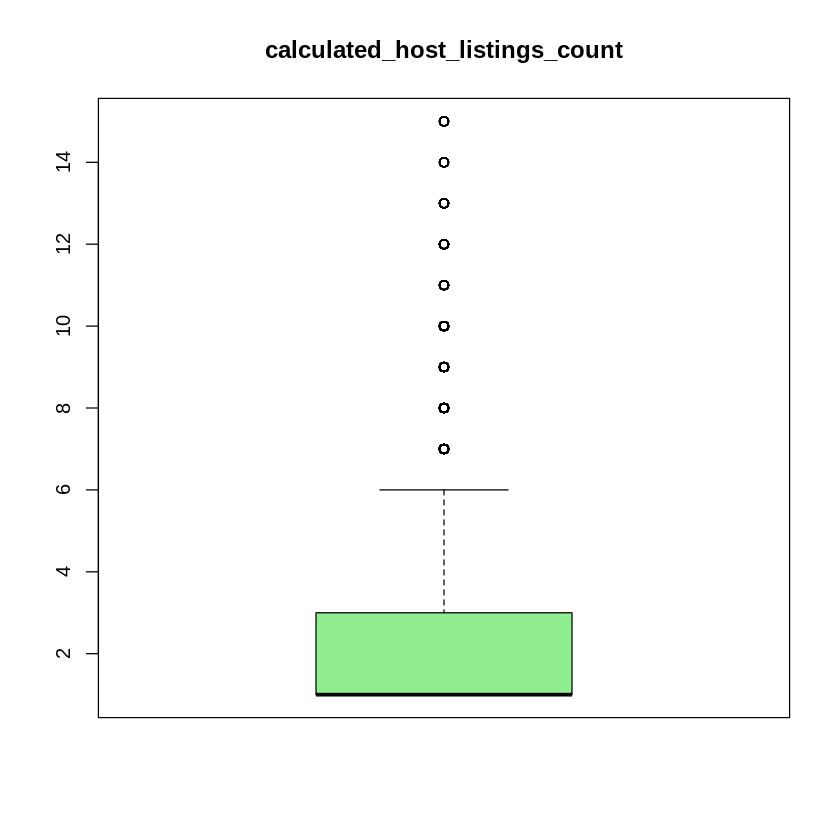

[1] "\n\n"


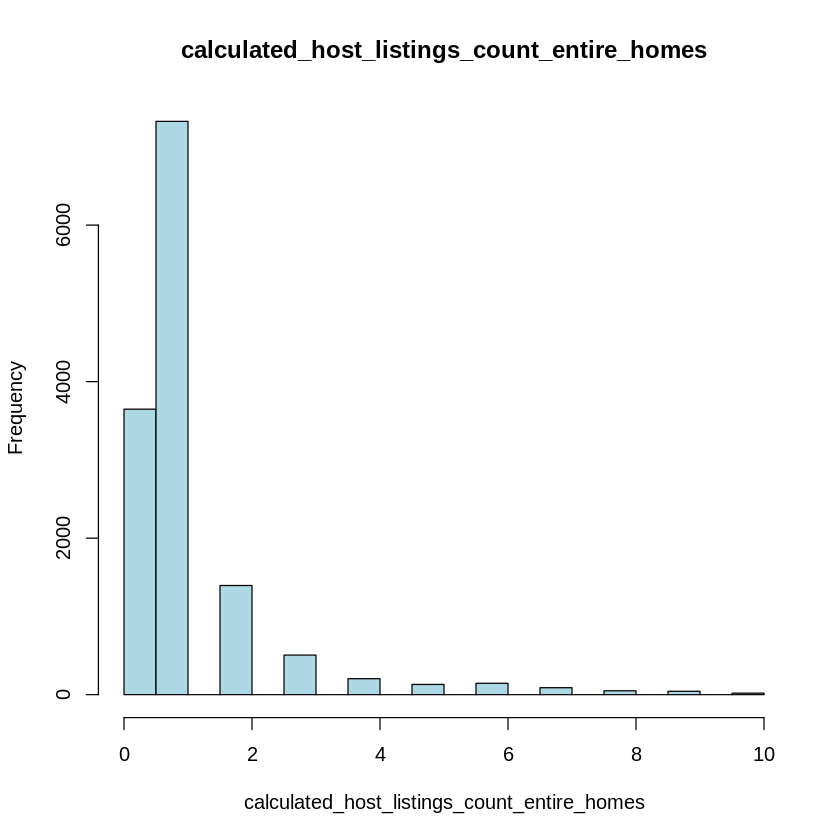

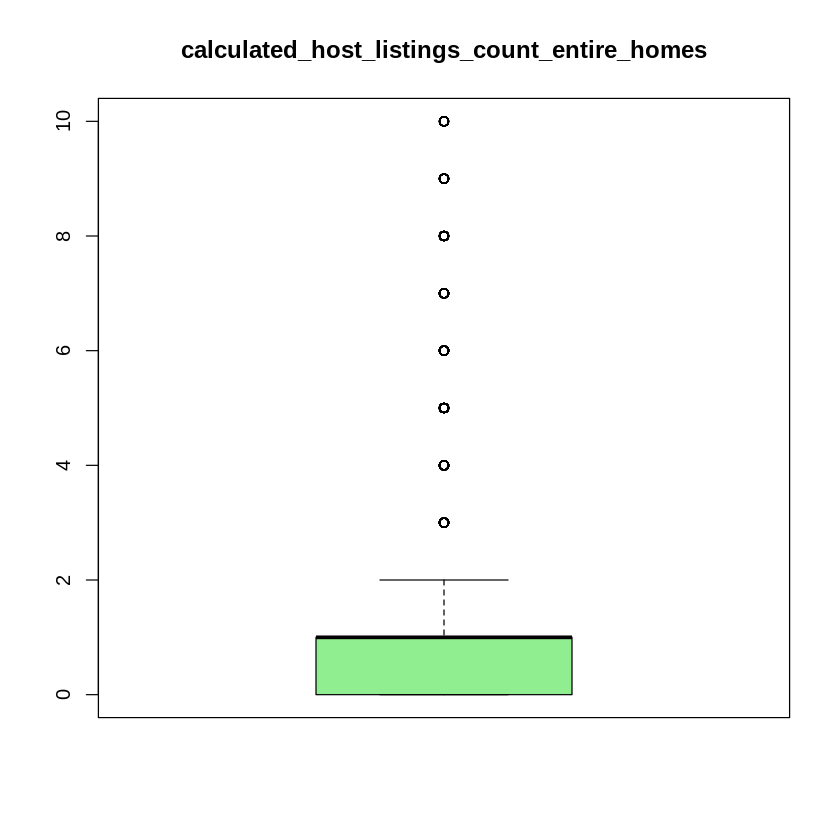

[1] "\n\n"


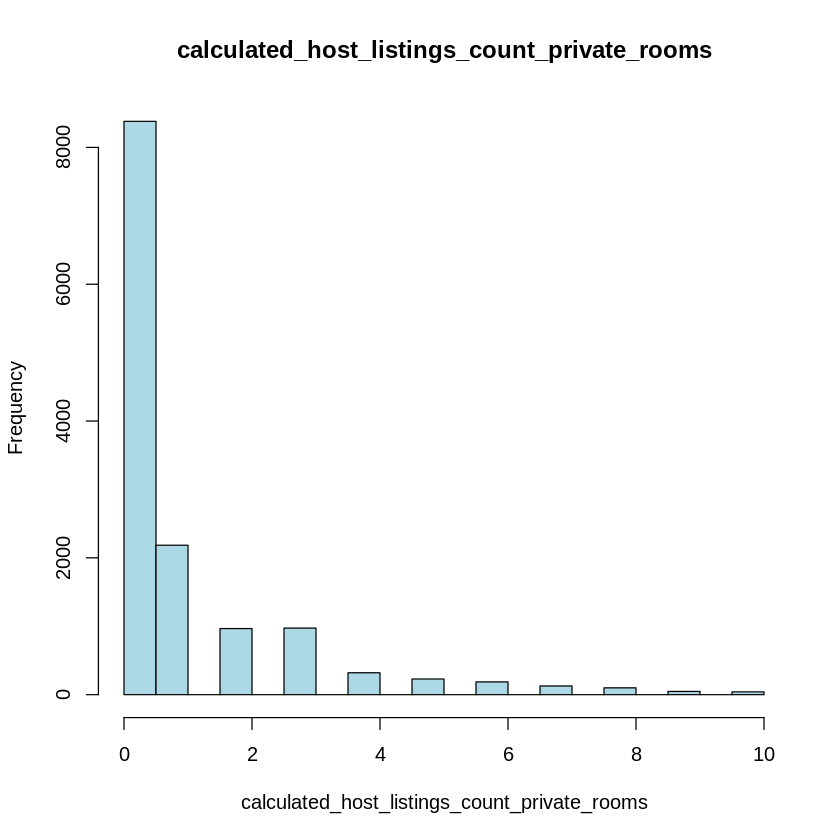

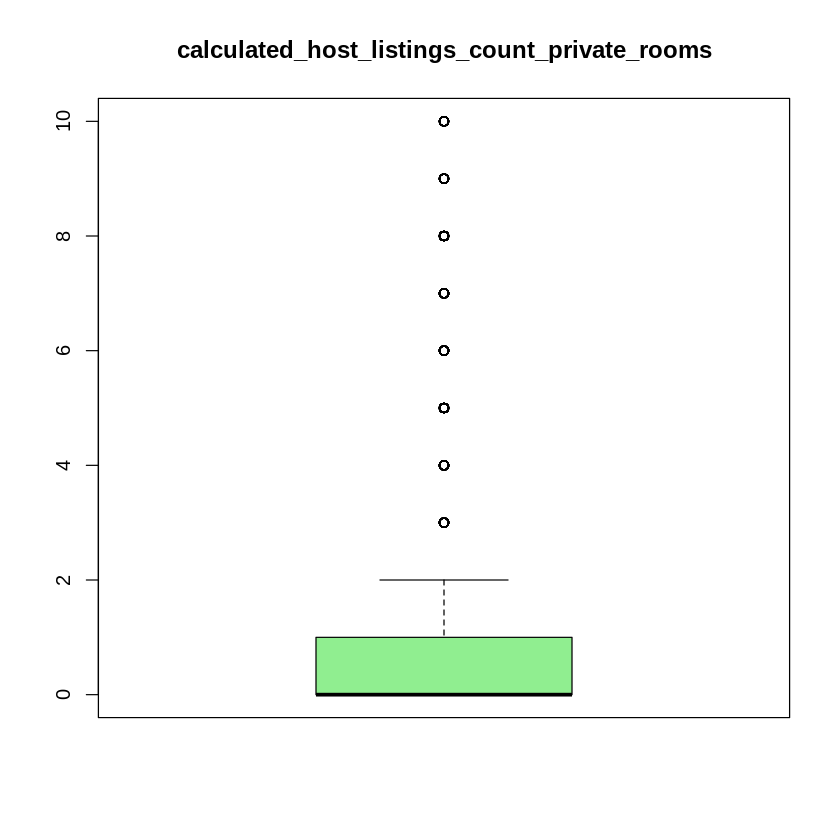

[1] "\n\n"


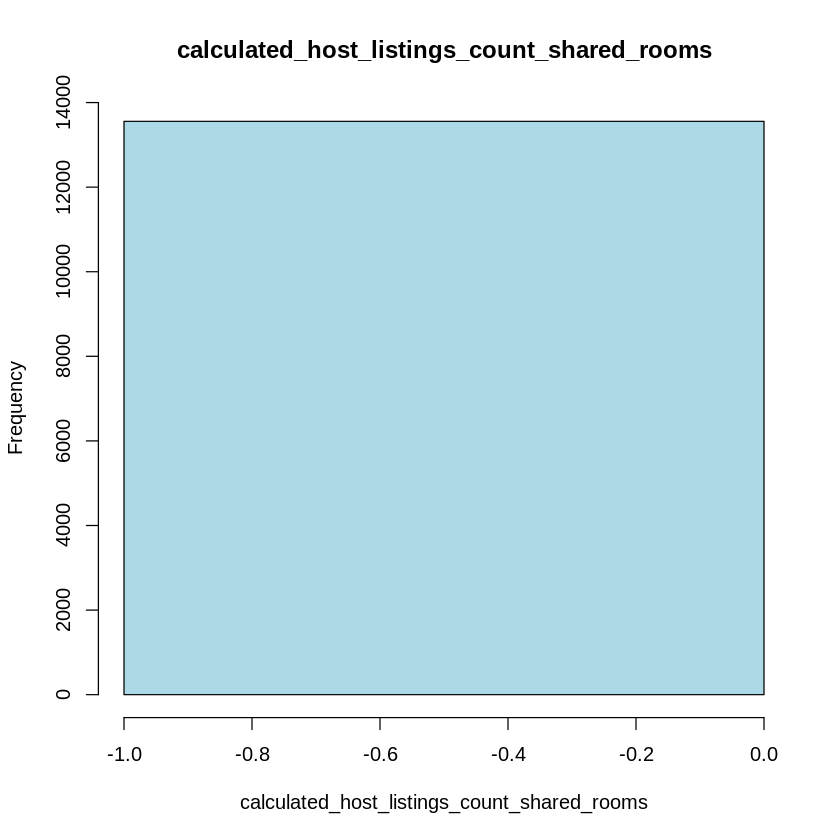

Skipping histogram for column: reviews_per_month 
Skipping boxplot for column: reviews_per_month 
Skipping histogram for column: host_verifications_1 
Skipping boxplot for column: host_verifications_1 


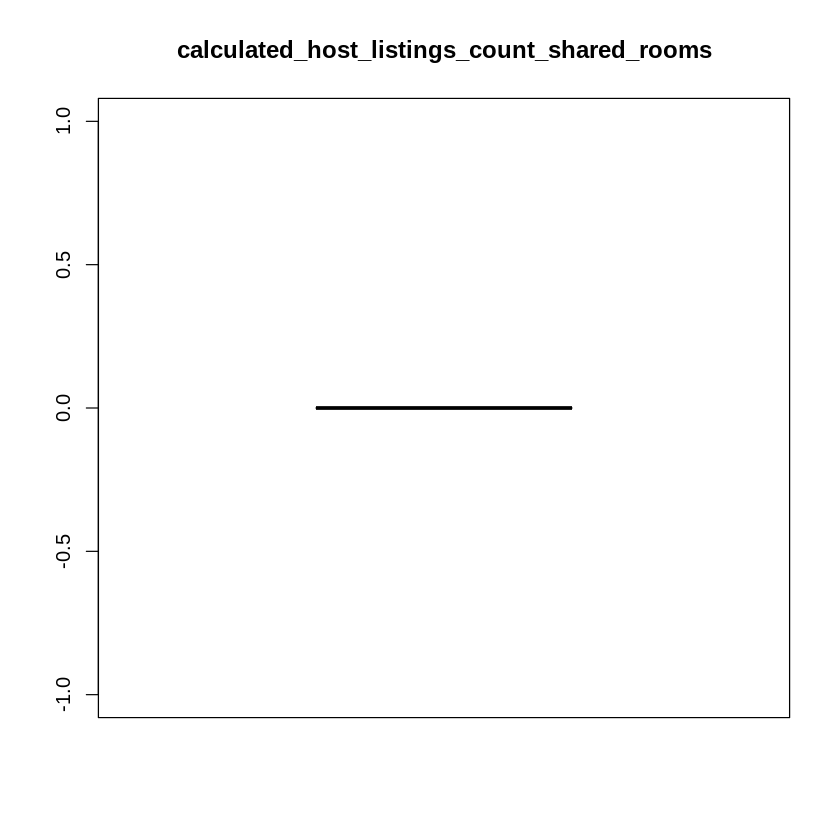

[1] "\n\n"


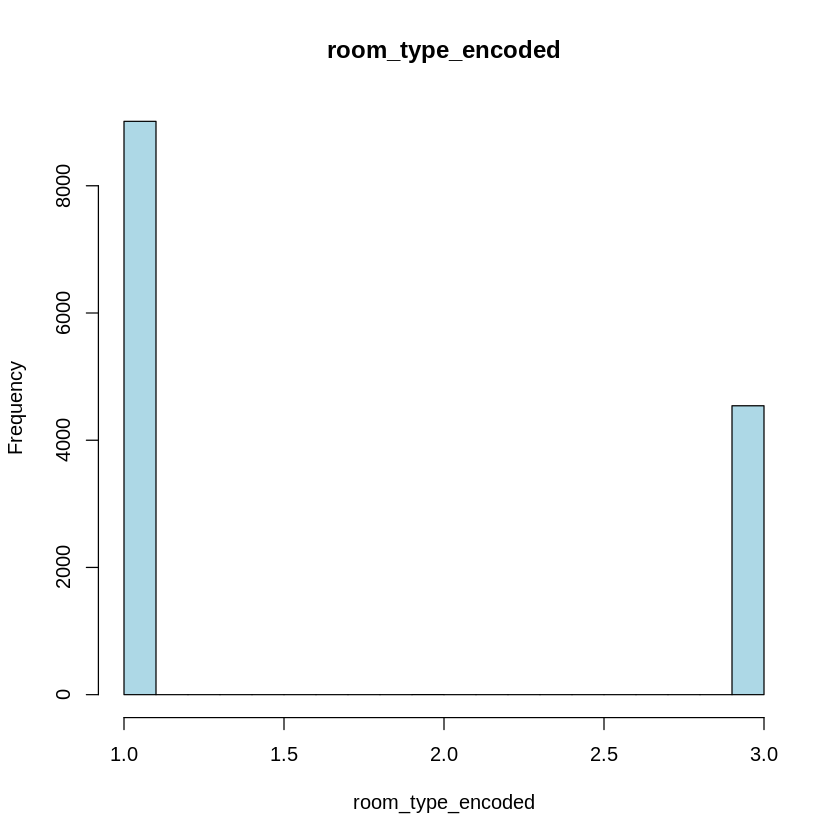

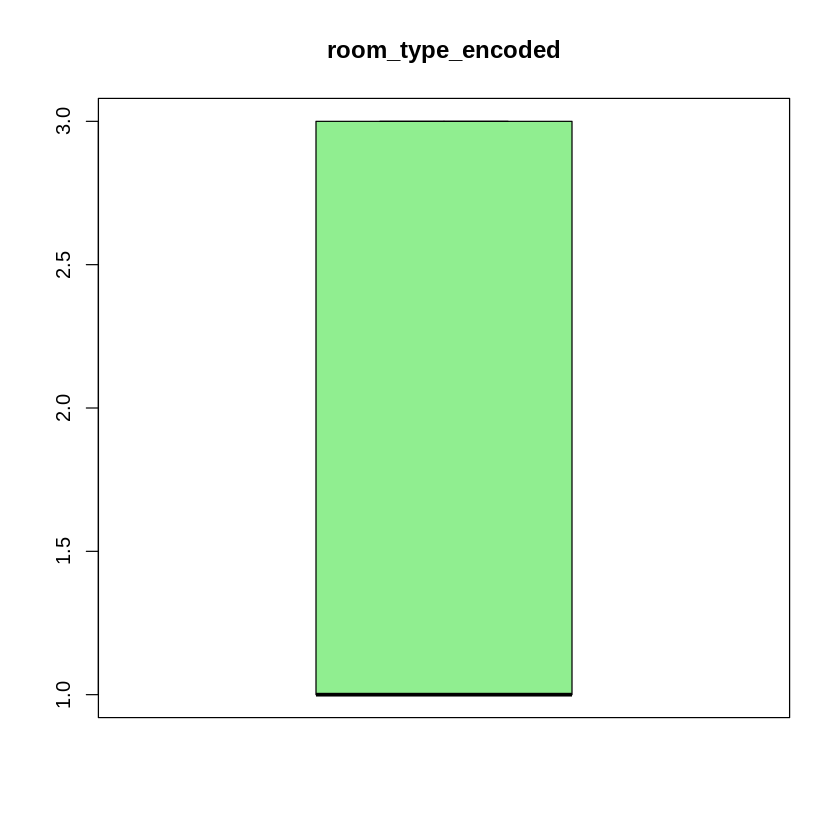

[1] "\n\n"


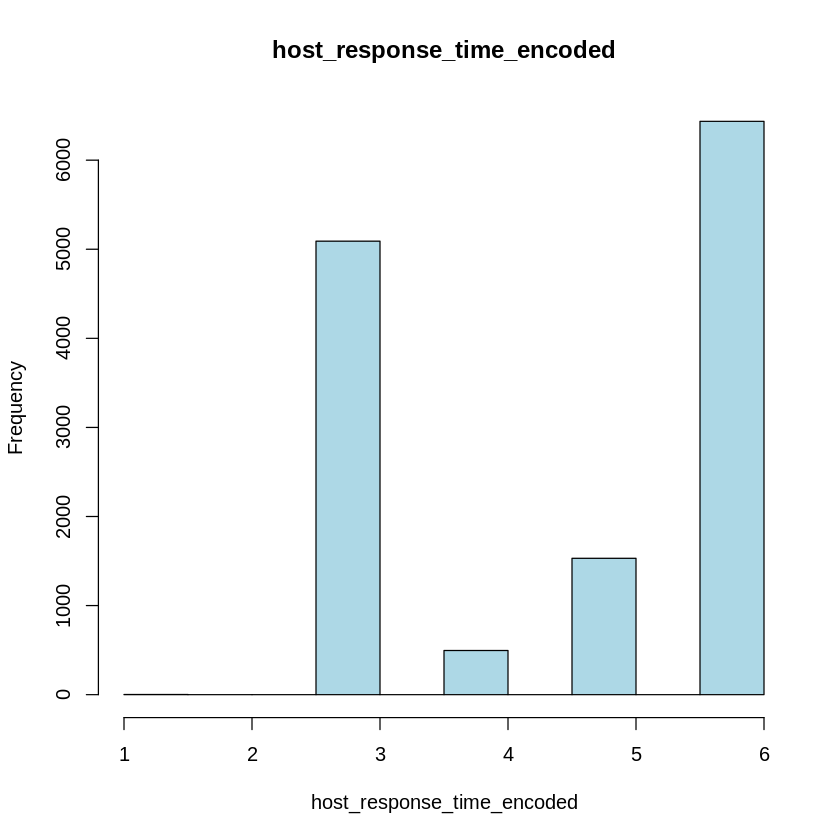

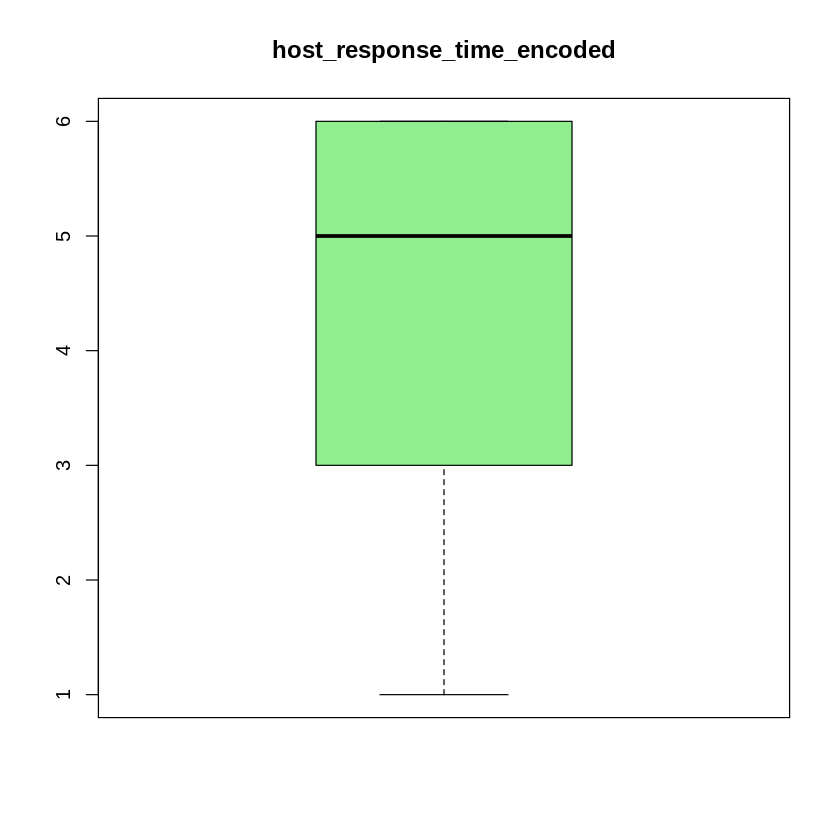

[1] "\n\n"


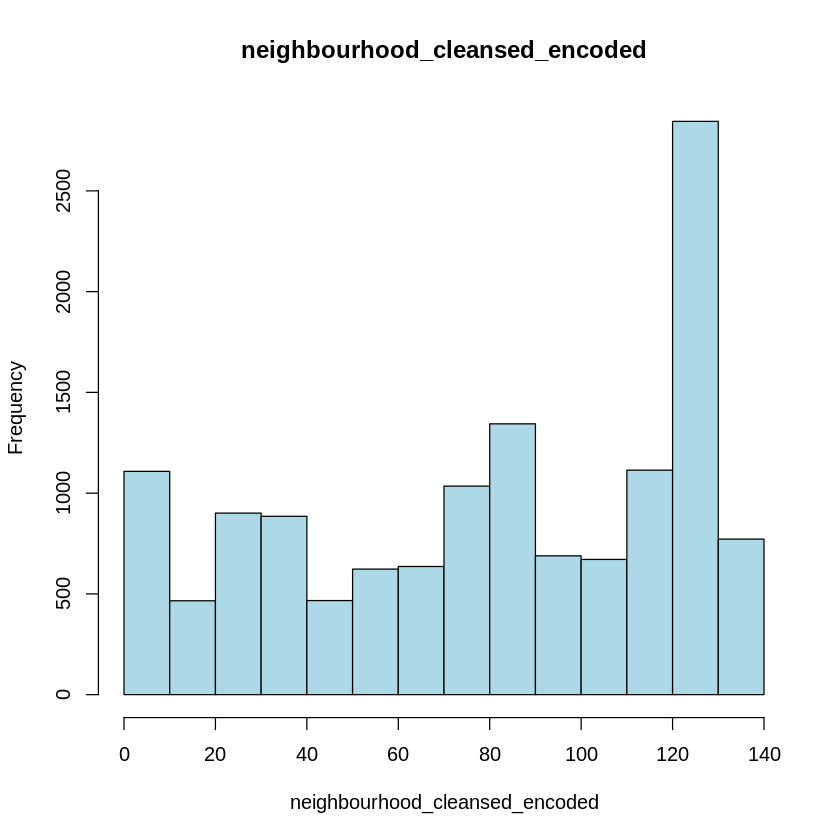

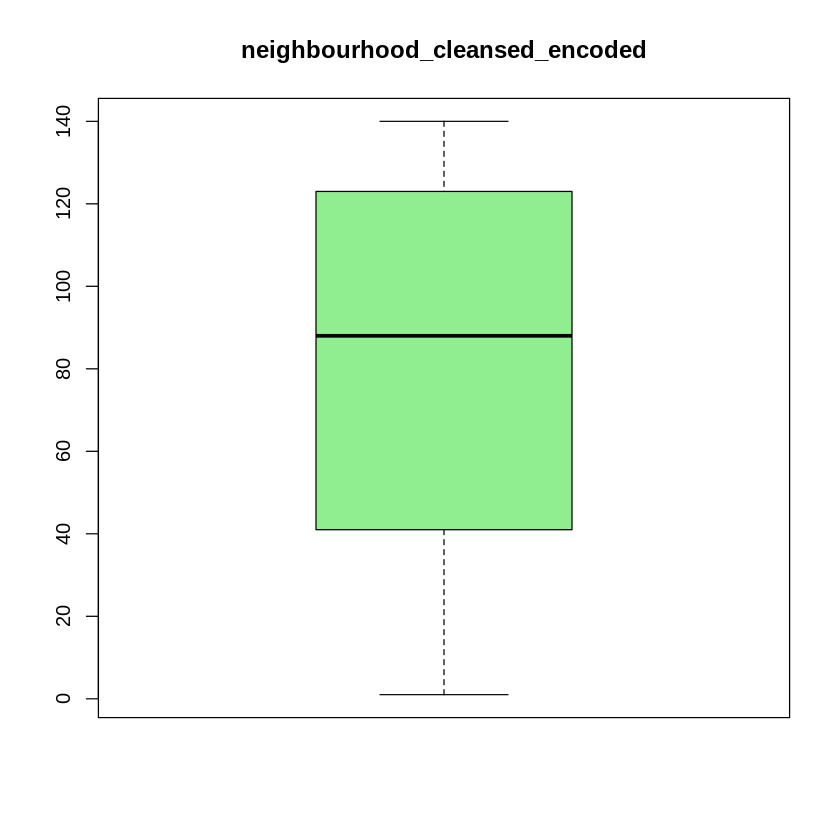

[1] "\n\n"


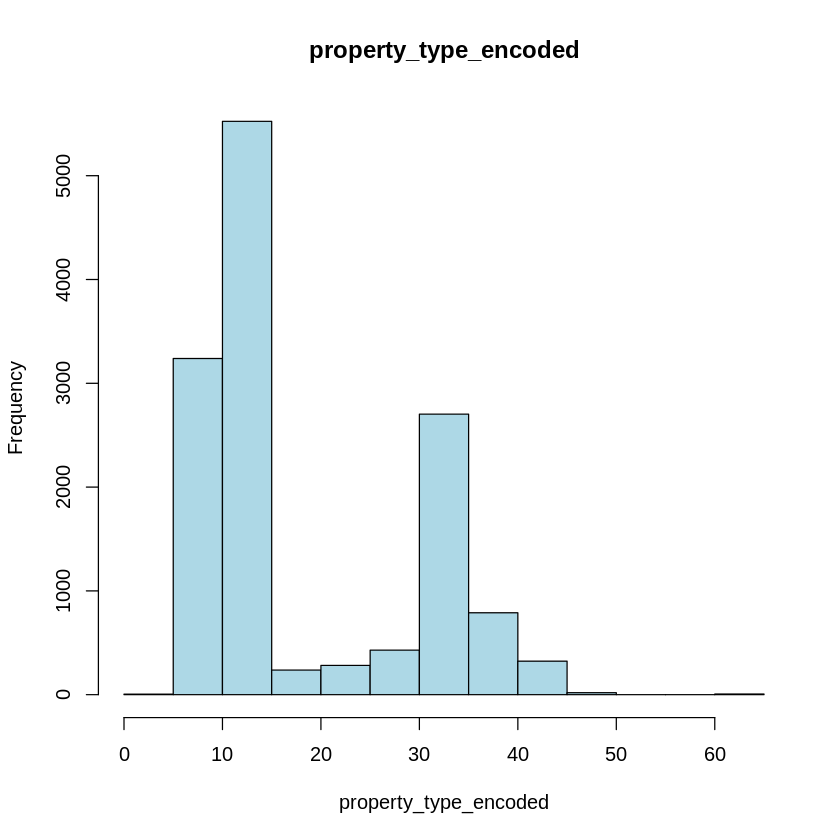

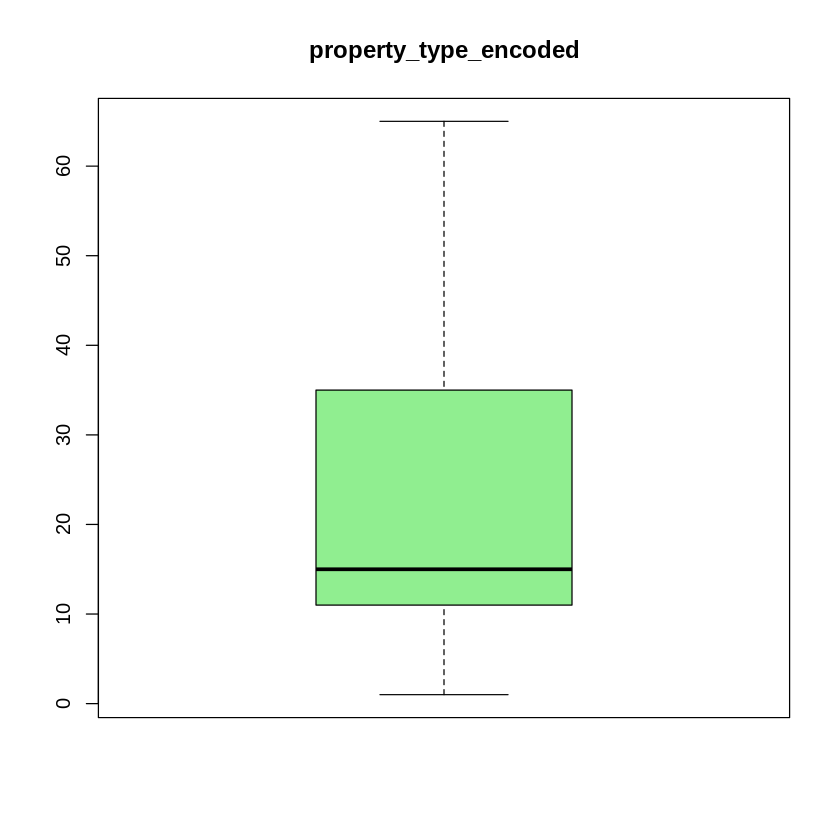

In [ ]:
# Pętla for do tworzenia wykresów
for (column in names(df_cleaned)) {
  tryCatch({
    # Tworzenie wykresu histogramu
    hist(df_cleaned[[column]], main = column, xlab = column, col = "lightblue")
    print("\n\n")
    Sys.sleep(1)  # Pauza dla lepszego rozróżnienia wykresów
  }, error = function(e) {
    # Obsługa błędów (np. gdy kolumna nie jest numeryczna)
    cat(paste("Skipping histogram for column:", column, "\n"))
  })

  tryCatch({
    # Tworzenie wykresu pudełkowego
    boxplot(df_cleaned[[column]], main = column, col = "lightgreen")
    Sys.sleep(1)  # Pauza dla lepszego rozróżnienia wykresów
  }, error = function(e) {
    # Obsługa błędów (np. gdy kolumna nie jest numeryczna)
    cat(paste("Skipping boxplot for column:", column, "\n"))
  })
}

CECHA - 'calculated_host_listings_count_shared_rooms' - JEST STAŁA

In [ ]:
unique_values <- unique(data_frame$calculated_host_listings_count_shared_rooms)
print(unique_values)

[1] 0 8 1 3 2 6 4


KOWARIANCJA MIĘDZY TĄ ZMIENNĄ A INNYMI ZMIENNYCMI POZOSTAJE STAŁA

In [ ]:
library(dplyr)

# Sprawdzenie, czy kolumna 'calculated_host_listings_count_shared_rooms' istnieje
if ("calculated_host_listings_count_shared_rooms" %in% colnames(data_frame)) {
  # Usunięcie kolumny 'calculated_host_listings_count_shared_rooms' za pomocą dplyr
  data_frame <- data_frame %>%
    select(-calculated_host_listings_count_shared_rooms)
} else {
  print("Kolumna 'calculated_host_listings_count_shared_rooms' nie istnieje.")
}

# Wyświetlenie nazw kolumn, aby upewnić się, że operacja się powiodła
print(colnames(data_frame))

 [1] "listing_url"                                  "last_scraped"                                
 [3] "source"                                       "name"                                        
 [5] "picture_url"                                  "host_id"                                     
 [7] "host_url"                                     "host_name"                                   
 [9] "host_since"                                   "host_location"                               
[11] "host_response_time"                           "host_response_rate"                          
[13] "host_acceptance_rate"                         "host_is_superhost"                           
[15] "host_thumbnail_url"                           "host_picture_url"                            
[17] "host_listings_count"                          "host_total_listings_count"                   
[19] "host_verifications"                           "host_has_profile_pic"                        
[21] "host

MACIEŻ KORELACJI

Macież korelacji

In [ ]:
library(dplyr)

# Wybór kolumn numerycznych
numeric_columns <- Filter(is.numeric, data_frame)

# Obliczenie macierzy korelacji
corr <- cor(select_if(data_frame, is.numeric))

# Wyświetlenie macierzy korelacji
print(corr)

                                                 host_id host_response_rate host_acceptance_rate
host_id                                       1.00000000       -0.046916999         0.0145667188
host_response_rate                           -0.04691700        1.000000000         0.2737897097
host_acceptance_rate                          0.01456672        0.273789710         1.0000000000
host_listings_count                                   NA                 NA                   NA
host_total_listings_count                             NA                 NA                   NA
latitude                                      0.10382538       -0.018913794        -0.0434287743
longitude                                     0.01626948       -0.011068708        -0.0280957279
accommodates                                  0.07088305        0.041065208         0.0523637388
bathrooms                                     0.01323797        0.014206632         0.0143479913
beds                          

ZBADANIE ZALEŻNOŚCI POMIĘDZY ZMIENNYMI – KROK TEN POZWOLI ODKRYĆ ZWIĄZKI POMIĘDZY POSZCZEGÓLNYMI ZMIENNYMI

KORELACJA PRZY UZYCIU METODY PEARSON

In [ ]:
install.packages("reshape2")
install.packages("plotly")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [ ]:
library(ggplot2)
library(reshape2)
library(plotly)

# Wybór kolumn numerycznych
numeric_columns <- Filter(is.numeric, data_frame)

# Obliczenie macierzy korelacji
corr_matrix <- cor(numeric_columns, use = "complete.obs")

# Przekształcenie macierzy do formatu odpowiedniego dla ggplot2
corr_matrix_melted <- melt(corr_matrix)

# Utworzenie mapy cieplnej za pomocą ggplot2
heatmap_plot <- ggplot(data = corr_matrix_melted, aes(x = Var1, y = Var2, fill = value)) +
  geom_tile() +
  scale_fill_gradient2(low = "blue", high = "red", mid = "white", midpoint = 0,
                       limits = c(-1, 1), breaks = seq(-1, 1, by = 0.2),
                       name = "Korelacja", labels = scales::number_format(accuracy = 0.1)) +
  labs(title = "Korelacja cech - metoda Pearsona") +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

# Konwersja do interaktywnego wykresu przy użyciu plotly (opcjonalne)
heatmap_plotly <- ggplotly(heatmap_plot)

# Wyświetlenie wykresu
heatmap_plotly


Attaching package: ‘reshape2’


The following object is masked from ‘package:tidyr’:

    smiths



Attaching package: ‘plotly’


The following object is masked from ‘package:ggplot2’:

    last_plot


The following object is masked from ‘package:stats’:

    filter


The following object is masked from ‘package:graphics’:

    layout




HTML widgets cannot be represented in plain text (need html)

In [ ]:
print(head(corr_matrix_melted))

                       Var1    Var2       value
1                   host_id host_id  1.00000000
2        host_response_rate host_id -0.04502262
3      host_acceptance_rate host_id  0.01741215
4       host_listings_count host_id  0.02350076
5 host_total_listings_count host_id  0.01968179
6                  latitude host_id  0.10450147


KORELACJA PRZY UZYCIU METODY SPEARMANA

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)


Attaching package: ‘Hmisc’


The following object is masked from ‘package:plotly’:

    subplot


The following objects are masked from ‘package:DescTools’:

    %nin%, Label, Mean, Quantile


The following object is masked from ‘package:e1071’:

    impute


The following objects are masked from ‘package:dplyr’:

    src, summarize


The following objects are masked from ‘package:base’:

    format.pval, units




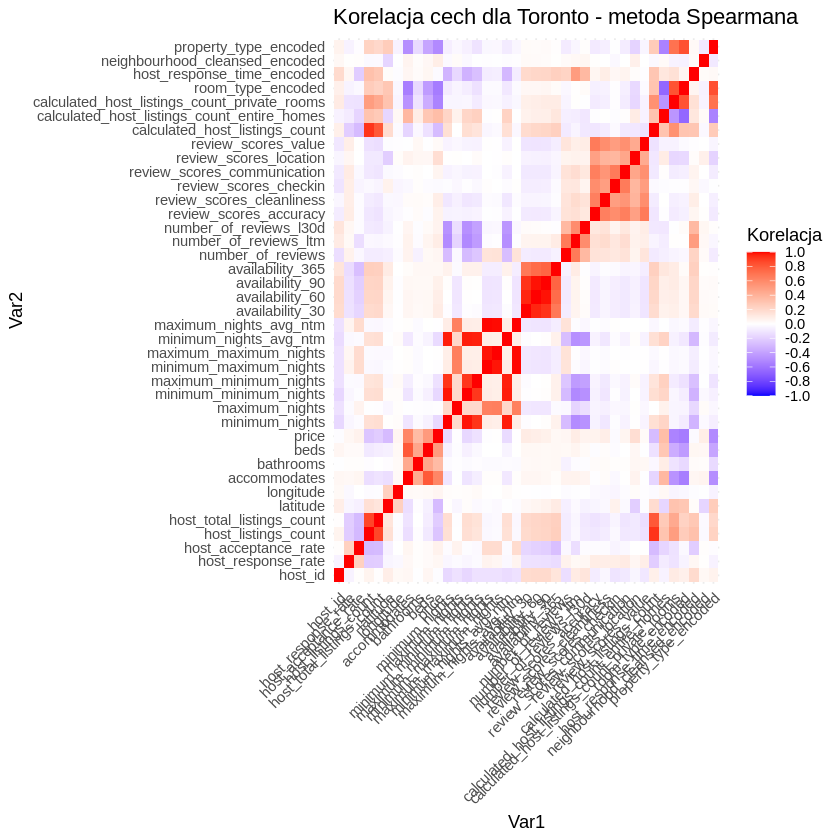

In [ ]:
install.packages("ggplot2")
install.packages("Hmisc")

library(ggplot2)
library(Hmisc)

# Wybór kolumn numerycznych
numeric_columns <- Filter(is.numeric, data_frame)

# Obliczenie macierzy korelacji metodą Spearmana
corr_matrix <- rcorr(as.matrix(numeric_columns), type = "spearman")

# Macierz korelacji Spearmana
corr_spearman <- corr_matrix$r

# Ustawienie nazw wierszy i kolumn
rownames(corr_spearman) <- colnames(numeric_columns)
colnames(corr_spearman) <- colnames(numeric_columns)

# Przekształcenie macierzy do formatu odpowiedniego dla ggplot2
corr_spearman_melted <- melt(corr_spearman)

# Utworzenie mapy cieplnej za pomocą ggplot2
heatmap_plot <- ggplot(data = corr_spearman_melted, aes(x = Var1, y = Var2, fill = value)) +
  geom_tile() +
  scale_fill_gradient2(low = "blue", high = "red", mid = "white", midpoint = 0,
                       limits = c(-1, 1), breaks = seq(-1, 1, by = 0.2),
                       name = "Korelacja", labels = scales::number_format(accuracy = 0.1)) +
  labs(title = "Korelacja cech dla Toronto - metoda Spearmana") +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

# Wyświetlenie wykresu
print(heatmap_plot)

ZBADANIE ZALEŻNOŚCI POMIĘDZY ZMIENNYMI KATEGORYCZNYMI

In [ ]:
data <- data_frame
data2 <- data_frame

In [ ]:
# Przypisanie istniejącej ramki danych do nowej zmiennej 'data'
data_save <- data_frame
data <- data_save

# Załadowanie wymaganych bibliotek
install.packages("vcd")
install.packages("dplyr")
install.packages("gtools")

library(vcd)
library(dplyr)
library(gtools)


# Zamiana kolumn na faktory (kategorie)
data <- data %>%
  mutate(across(c(name, source, room_type, property_type, host_id), ~ as.factor(.)))

# Tworzenie par kombinacji zmiennych
variable_combinations <- combinations(n = 5, r = 2, v = c('name', 'source', 'room_type', 'property_type', 'host_id'), set = TRUE, repeats.allowed = FALSE)

print(variable_combinations)

# Lista do przechowywania wyników V Cramera
vcramer_results <- list()

# Funkcja do obliczenia V Cramera
calculate_vcramer <- function(var1, var2, data) {
  contingency_table <- table(data[[var1]], data[[var2]])
  cramer_v <- assocstats(contingency_table)$cramer
  return(cramer_v)
}

# Iteracja przez kombinacje zmiennych
for (i in 1:nrow(variable_combinations)) {
  var1 <- variable_combinations[i, 1]
  var2 <- variable_combinations[i, 2]
  print(paste('KOMBINACJA ZMIENNYCH:', var1, 'and', var2))
  v_cramer_value <- calculate_vcramer(var1, var2, data)
  vcramer_results[[paste(var1, var2, sep = "_")]] <- v_cramer_value
  print(paste('V Cramer:', v_cramer_value))
}

# Dodatkowe obliczenia V Cramera dla każdej zmiennej z samą sobą
for (x in c('name', 'source', 'room_type', 'property_type', 'host_id')) {
  v_cramer_value <- calculate_vcramer(x, x, data)
  vcramer_results[[paste(x, x, sep = "_")]] <- v_cramer_value
}

# Wyświetlenie wyników
# print(vcramer_results)



Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Loading required package: grid


Attaching package: ‘gtools’


The following object is masked from ‘package:e1071’:

    permutations




      [,1]            [,2]           
 [1,] "host_id"       "name"         
 [2,] "host_id"       "property_type"
 [3,] "host_id"       "room_type"    
 [4,] "host_id"       "source"       
 [5,] "name"          "property_type"
 [6,] "name"          "room_type"    
 [7,] "name"          "source"       
 [8,] "property_type" "room_type"    
 [9,] "property_type" "source"       
[10,] "room_type"     "source"       
[1] "KOMBINACJA ZMIENNYCH: host_id and name"
[1] "V Cramer: 0.824557611408059"
[1] "KOMBINACJA ZMIENNYCH: host_id and property_type"
[1] "V Cramer: 0.862954617360514"
[1] "KOMBINACJA ZMIENNYCH: host_id and room_type"
[1] "V Cramer: 0.838434156278356"
[1] "KOMBINACJA ZMIENNYCH: host_id and source"
[1] "V Cramer: 0.949234830695669"
[1] "KOMBINACJA ZMIENNYCH: name and property_type"
[1] "V Cramer: 0.955151920941008"
[1] "KOMBINACJA ZMIENNYCH: name and room_type"
[1] "V Cramer: 0.716036516023371"
[1] "KOMBINACJA ZMIENNYCH: name and source"
[1] "V Cramer: 0.588723906552025"
[1] "K

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)


Attaching package: ‘tidyr’


The following object is masked from ‘package:reshape2’:

    smiths


Warning message in chisq.test(contingency_table, correct = FALSE):
“Chi-squared approximation may be incorrect”
Warning message in chisq.test(contingency_table, correct = FALSE):
“Chi-squared approximation may be incorrect”
Warning message in chisq.test(contingency_table, correct = FALSE):
“Chi-squared approximation may be incorrect”
Warning message in chisq.test(contingency_table, correct = FALSE):

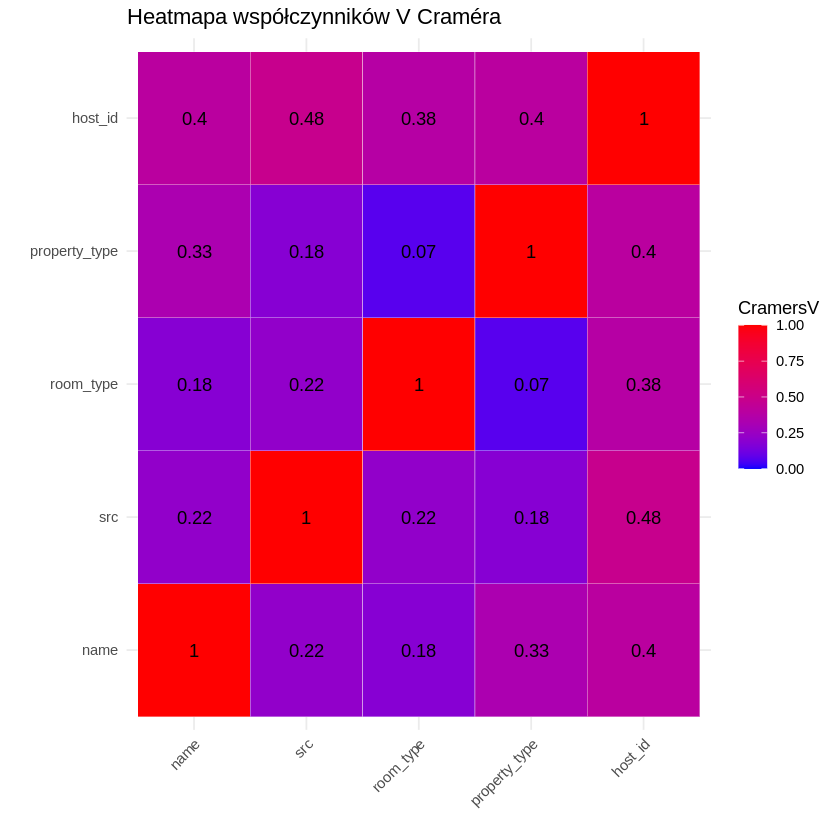

In [ ]:
# Załadowanie wymaganych bibliotek
install.packages("vcd")
install.packages("dplyr")
install.packages("ggplot2")
install.packages("reshape2")
install.packages("combinat")
install.packages("tidyr")
library(vcd)
library(dplyr)
library(ggplot2)
library(reshape2)
library(combinat)
library(tidyr)

# Generowanie przykładowych danych
data <- data.frame(
  name = sample(letters[1:5], 100, replace = TRUE),
  src = sample(LETTERS[1:5], 100, replace = TRUE),
  room_type = sample(c("Private room", "Entire home/apt", "Shared room"), 100, replace = TRUE),
  property_type = sample(c("Apartment", "House", "Condominium"), 100, replace = TRUE),
  host_id = sample(1:20, 100, replace = TRUE),
  num_feature1 = rnorm(100),
  num_feature2 = runif(100)
)

# Usunięcie pustych wartości
data <- data %>%
  drop_na()

# Zamiana na kategorie
data$name <- as.factor(data$name)
data$src <- as.factor(data$src)
data$room_type <- as.factor(data$room_type)
data$property_type <- as.factor(data$property_type)
data$host_id <- as.factor(data$host_id)

# Tworzenie par kombinacji zmiennych
variable_combinations <- combn(c("name", "src", "room_type", "property_type", "host_id"), 2, simplify = FALSE)

# Funkcja do obliczenia V Craméra
cramers_v_matrix <- function(cecha1, cecha2) {
  contingency_table <- table(cecha1, cecha2)
  chi2_result <- chisq.test(contingency_table, correct = FALSE)
  chi2 <- chi2_result$statistic
  n <- sum(contingency_table)
  min_dim <- min(dim(contingency_table)) - 1
  cramers_v <- sqrt(chi2 / (n * min_dim))
  return(cramers_v)
}

# Wyliczenie V Craméra dla wszystkich kombinacji
df_vcramer <- data.frame(matrix(NA, ncol = length(variable_combinations), nrow = 1))
colnames(df_vcramer) <- sapply(variable_combinations, function(x) paste(x, collapse = " and "))

for (i in 1:length(variable_combinations)) {
  var1 <- variable_combinations[[i]][1]
  var2 <- variable_combinations[[i]][2]
  cramers <- cramers_v_matrix(data[[var1]], data[[var2]])
  df_vcramer[1, i] <- round(cramers, 2)
}

# Obliczenie V Craméra dla par danych kategorycznych
df_cat <- data %>%
  select(where(is.factor))
rows <- list()

for (var1 in colnames(df_cat)) {
  col <- numeric(ncol(df_cat))
  for (var2 in colnames(df_cat)) {
    cramers <- cramers_v_matrix(df_cat[[var1]], df_cat[[var2]])
    col[which(colnames(df_cat) == var2)] <- round(cramers, 2)
  }
  rows[[var1]] <- col
}

# Ramka odpowiedzi
cramers_results <- do.call(rbind, rows)
colnames(cramers_results) <- colnames(df_cat)
rownames(cramers_results) <- colnames(df_cat)

# Reshaping danych
melted_cramers_results <- melt(cramers_results, varnames = c("Var1", "Var2"), value.name = "CramersV")

# Utworzenie heatmapy - ggplot2
ggplot(data = melted_cramers_results, aes(x = Var1, y = Var2, fill = CramersV)) +
  geom_tile(color = "white") +
  scale_fill_gradient(low = "blue", high = "red", limits = c(0, 1)) +
  geom_text(aes(label = round(CramersV, 2)), color = "black") +
  theme_minimal() +
  labs(title = "Heatmapa współczynników V Craméra", x = "", y = "") +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

# Wyliczenie R-squared
df_num <- data %>%
  select(where(is.numeric))
r_sq <- matrix(NA, nrow = ncol(df_num), ncol = ncol(df_cat))
rownames(r_sq) <- colnames(df_num)
colnames(r_sq) <- colnames(df_cat)

for (num in colnames(df_num)) {
  for (cat in colnames(df_cat)) {
    formula <- as.formula(paste(num, "~", cat))
    model <- lm(formula, data = data)
    r_sq[num, cat] <- summary(model)$r.squared
  }
}

r_sq <- round(as.data.frame(r_sq), 2)

# Reshaping ramki danych R-squared
melted_r_sq <- melt(r_sq, varnames = c("NumericVar", "CategoricalVar"), value.name = "R_Squared")

# Utworzenie heatmapy - ggplot2
ggplot(data = melted_r_sq, aes(x = CategoricalVar, y = NumericVar, fill = R_Squared)) +
  geom_tile(color = "white") +
  scale_fill_gradient(low = "blue", high = "red", limits = c(0, 1)) +
  geom_text(aes(label = round(R_Squared, 2)), color = "black") +
  theme_minimal() +
  labs(title = "Heatmapa wartości R-Squared zmienne kategoryczne i numeryczne", x = "", y = "") +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))


### WYKRES V CRAMERA

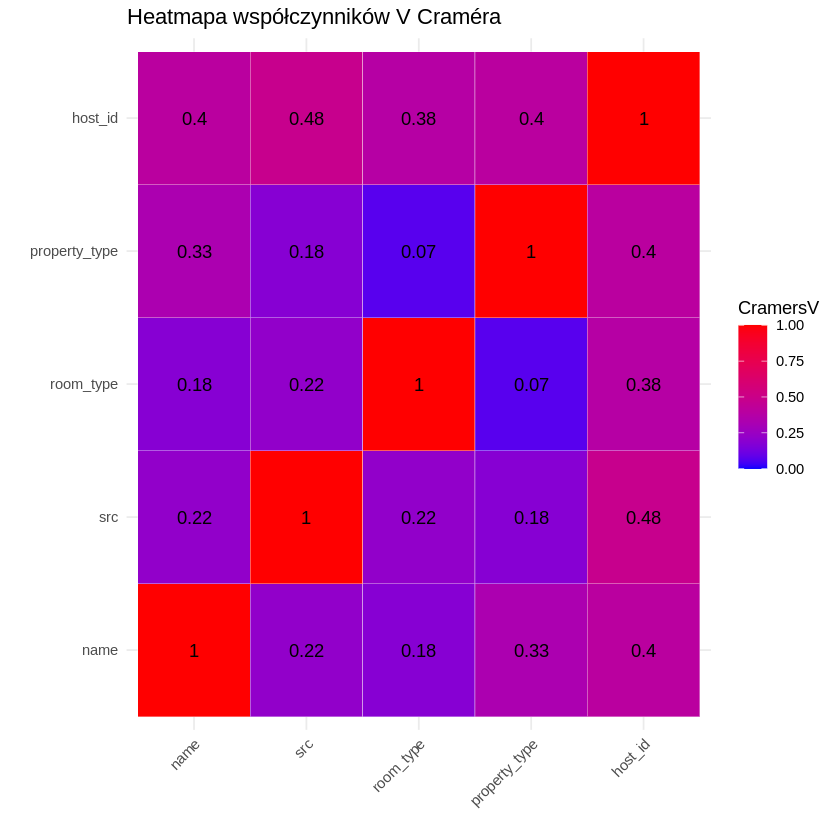

**PODSUMOWANIE**

WYKONANO PRZYGOTOWANIE DANYCH DO DALSZEGO WYKORZYSTANIA. ANALIZA ZAJĘŁA OKOŁO 14 GODZIN. UZUPEŁNIONO BRAKUJĄCE DANE, A GDZIE NIE BYŁO TO MOŻLIWE ZE ZWZGLĘDU NA DUŻE BRAKI USUNIĘTO KOLUNMY JAKO NIEISTOTNE. STOPNIE ZALEŻNOŚCI POMIĘDZY POSZCZEGÓLNYMI DANYMI ZOSTAŁY ZAPREZENTOWANE NA HEATMAPACH (METODA PEARSONA ORAZ METODA SPEARMANA). DOKONANO TAKŻE ANALIZY DLA DANYCH KATEGORYCZNYCH - WYLICZONO WSPÓŁCZYNNIK V CRAMERA.